# Please run this notebook in multi-ants-tracking conda environment!
Import libraries
Tutorial: https://blog.roboflow.com/how-to-train-detectron2/
https://medium.com/@apofeniaco/training-on-detectron2-with-a-validation-set-and-plot-loss-on-it-to-avoid-overfitting-6449418fbf4e

In [1]:
%load_ext autoreload
%autoreload

# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import os
# import some common libraries
import numpy as np
import os, json, cv2, random
import math
#from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

#from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

import sys
import glob
from detectron2.structures import BoxMode

import tqdm


from MyTrainer_valbatch import MyTrainer
from LossEvalHook import LossEvalHook

from detectron2.engine import DefaultTrainer
## make sure that the model validates agaisnt the val dataset, which is not defautl in the defaulttrainer class
class CocoTrainer(DefaultTrainer):
    

    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):

        if output_folder is None:
            os.makedirs("coco_eval", exist_ok=True)
            output_folder = "coco_eval"

        return COCOEvaluator(dataset_name, cfg, False, output_folder)


** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



# load JSON dataset into python dictionary

In [2]:
dataset_dicts ={}
import json
for d in["train","val"]:
    with open('/media/linx123-rtx/Elements/Render/YOLO custom dataset aligned (copy)/'+d+'.json', 'r') as fp:
        dataset_dicts[d] = json.load(fp)

for d in["train","val"]:
    for dic in dataset_dicts[d]:
        for anno in dic["annotations"]:
            if anno["bbox_mode"] == 0:
                anno["bbox_mode"] = BoxModeXYXY_ABS
            if anno["bbox_mode"] == 1:
                anno["bbox_mode"] = BoxMode.XYWH_ABS
            if anno["bbox_mode"] == 2:
                anno["bbox_mode"] = BoxMode.XYXY_REL
            if anno["bbox_mode"] == 3:
                anno["bbox_mode"] = BoxMode.XYWH_REL
            if anno["bbox_mode"] == 4:
                anno["bbox_mode"] = BoxMode.XYWHA_ABS

# Register detectron2 custom dataset

In [3]:
## REGISTER TRAIN DATASET
DatasetCatalog.register("bumblebee_" + "train", lambda d="train": dataset_dicts["train"])
MetadataCatalog.get("bumblebee_" + "train").set(thing_classes=["bumblebee"])

def get_N():
    N = 0
    for img in DatasetCatalog.get("bumblebee_train"):
        N+=len(img["annotations"] )
    return N

# CALCULATE ITERATIONS OUT OF EPOCHS
EPOCHS = 100 #epochs
BS = 16 #128, batch size (between 2...2^n...512, smaller batch sizes are better suited to smaller learning rates)
         ## DELETE OUTPUT BEFORE CHANGE, otherwise you get "Results do not correspond to current coco set" error
N = get_N()
I = 100000 #round((N / BS) * EPOCHS) # iterations


## LOAD CONFIG
cfg = get_cfg()
## batch size for validation purpose only (not training!!)


# validation
# create validation sets refering to batch size, such that val_loss can be computed every iteration on a val set according to batch size
cfg.Test_index = 0
cfg.Test_index_MAX = math.floor(len(dataset_dicts["val"]) /BS)
DatasetCatalog.register("bumblebee_" + "val", lambda d="val": dataset_dicts["val"][BS*cfg.Test_index:BS*cfg.Test_index+BS])
MetadataCatalog.get("bumblebee_" + d).set(thing_classes=["bumblebee"])

    
bumblebee_metadata = MetadataCatalog.get("bumblebee_train")


# visualizing random imgs of registration for validation

In [13]:

for d in random.sample(dataset_dicts["val"], 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=bumblebee_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2.imshow('window',out.get_image()[:, :, ::-1])
    cv2.waitKey()
    cv2.destroyAllWindows()

# prepare config and start training
commands : https://github.com/facebookresearch/Detectron/blob/master/detectron/core/config.py

In [ ]:
# lookup the config file in /home/linx123-rtx/anaconda3/envs/multi-ants-tracking/lib/python3.8/site-packages/detectron2/model_zoo/configs/
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_101_FPN_3x.yaml"))
## DEFINE DATASET IN CONFIG
cfg.DATASETS.TRAIN = ('bumblebee_train',)
cfg.DATASETS.TEST = ('bumblebee_val',)
cfg.DATALOADER.NUM_WORKERS = 4
## MODEL
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_101_FPN_3x.yaml")  # Let training initialize from model zoo

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = BS 
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (bumblebee).

cfg.MODEL.RETINANET.FOCAL_LOSS_GAMMA = 5.0
#cfg.MODEL.RETINANET.FOCAL_LOSS_ALPHA = 0.125
#cfg.MODEL.FPN.OUT_CHANNELS = 256
#cfg.MODEL.ANCHOR_GENERATOR.SIZES = [[32*0.75, 64*0.75, 128*0.75, 256*0.75, 512*0.75]]
## SOLVER
cfg.SOLVER.BASE_LR = 0.000075  # good learning rate is 0.0005 for this case, 0.000015 is to high (common is between 10^-6...1)
cfg.SOLVER.LR_POLICY = 'steps_with_decay' 
cfg.SOLVER.GAMMA = 0.5 #0.01
cfg.SOLVER.STEPS = [20000, 30000,40000,50000,60000]

cfg.SOLVER.WARMUP_ITERS = 1000 #reduce effect of early training examples
# Start the warm up from SOLVER.BASE_LR * SOLVER.WARM_UP_FACTOR
cfg.SOLVER.WARM_UP_FACTOR = 1.0 / 3.0
# WARM_UP_METHOD can be either 'constant' or 'linear' (i.e., gradual)
cfg.SOLVER.WARM_UP_METHOD = 'linear'

cfg.SOLVER.MAX_ITER = I   #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.MOMENTUM = 0.9 # Momentum to use with SGD
cfg.SOLVER.IMS_PER_BATCH = 1 #2 IMS_PER_BATCH = 2 means that in 1 iteration the model sees 2 images ATTENTION: WRONG VALUE CAN LEAD TO LOWER VAL LOSS THEN TRAIN LOSS FOR SOME UNCLEAR REASON 

## TEST CONFIGS
cfg.TEST.EVAL_PERIOD = 10

#cfg.MODEL.BACKBONE.FREEZE_AT = 0


os.makedirs(cfg.OUTPUT_DIR, exist_ok=False)
trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

Loading config /home/linx123-rtx/anaconda3/envs/multi-ants-tracking/lib/python3.8/site-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[01/27 20:08:45 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

[01/27 20:08:45 d2.data.build]: Removed 88 images with no usable annotations. 11359 images left.
[01/27 20:08:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[01/27 20:08:45 d2.data.build]: Using training sampler TrainingSampler
[01/27 20:08:45 d2.data.common]: Serializing 11359 elements to byte tensors and concatenating them all ...
[01/27 20:08:45 d2.data.common]: Serialized dataset takes 4.13 MiB
[01/27 20:08:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[01/27 20:08:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:08:45 d2.data.common]: Serialized dataset takes 0.01 MiB
[01/27 20:08:47 d2.engine.train_loop]: Starting training from i

[01/27 20:08:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:08:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:08:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:08:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:08:56 d2.evaluation.evaluator]: Inference done 11/16. 0.0425 s / img. ETA=0:00:00
[01/27 20:08:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.573642 (0.052149 s / img per device, on 1 devices)
[01/27 20:08:57 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.047939 s / img per device, on 1 devices)
[01/27 20:08:57 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/27 20:08:57 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[01/27 20:08:57 d2.evaluation.coco_evaluation]: Evaluating predicti

[01/27 20:09:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:09:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:09:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:09:02 d2.evaluation.testing]: copypaste: 0.0000,0.0000,0.0000,0.0000,nan,nan
[01/27 20:09:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:09:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:09:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:09:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:09:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:09:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.571819 (0.051984 s / img

[01/27 20:09:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:09:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:09:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:09:11 d2.evaluation.testing]: copypaste: 0.0013,0.0126,0.0000,0.0024,nan,nan
[01/27 20:09:11 d2.utils.events]:  eta: 2:46:09  iter: 79  total_loss: 1.009  loss_cls: 0.3875  loss_box_reg: 0.4201  validation_loss: 2.657  time: 0.1046  data_time: 0.0012  lr: 5.9941e-06  max_mem: 2322M
[01/27 20:09:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:09:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:09:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:09:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated b

[01/27 20:09:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:09:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:09:25 d2.evaluation.testing]: copypaste: 0.0668,0.5572,0.0000,0.1132,nan,nan
[01/27 20:09:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:09:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:09:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:09:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:09:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:09:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.507307 (0.046119 s / img per device, on 1 devices)
[01/27 20:09:27 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.042517 s / img per device, on 1 devices)
[01/27 

[01/27 20:09:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:09:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:09:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:09:32 d2.evaluation.testing]: copypaste: 0.8791,7.6929,0.0000,1.4184,nan,nan
[01/27 20:09:32 d2.utils.events]:  eta: 2:44:09  iter: 159  total_loss: 0.331  loss_cls: 0.07738  loss_box_reg: 0.2092  validation_loss: 2.041  time: 0.1007  data_time: 0.0012  lr: 1.1988e-05  max_mem: 2322M
[01/27 20:09:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:09:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:09:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:09:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated

[01/27 20:09:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.031
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.059
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.030
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:09:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:09:45 d2.evaluation.testing]: copypaste: 4.9054,18.5787,0.1368,12.6910,nan,nan
[01/27 20:09:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:09:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:09:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:09:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:09:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:09:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.442959 (0.040269 s / img per device, on 1 devices)
[01/27 20:09:47 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.036902 s / img per device, on 1 devices)
[01/2

[01/27 20:09:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:09:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:09:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:09:52 d2.evaluation.testing]: copypaste: 5.1508,21.3223,0.1294,14.1076,nan,nan
[01/27 20:09:52 d2.utils.events]:  eta: 2:37:27  iter: 239  total_loss: 0.2008  loss_cls: 0.02896  loss_box_reg: 0.1358  validation_loss: 1.068  time: 0.0969  data_time: 0.0012  lr: 1.7982e-05  max_mem: 2322M
[01/27 20:09:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:09:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:09:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:09:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:10:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.067
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.252
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.159
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.064
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:10:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:10:06 d2.evaluation.testing]: copypaste: 7.8591,27.3549,0.0508,21.1957,nan,nan
[01/27 20:10:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:10:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:10:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:10:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:10:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:10:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.554226 (0.050384 s / img per device, on 1 devices)
[01/27 20:10:09 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.046704 s / img per device, on 1 devices)
[01/2

[01/27 20:10:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:10:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:10:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:10:14 d2.evaluation.testing]: copypaste: 9.7765,37.2517,0.5114,27.1977,nan,nan
[01/27 20:10:14 d2.utils.events]:  eta: 2:35:37  iter: 319  total_loss: 0.104  loss_cls: 0.01963  loss_box_reg: 0.09125  validation_loss: 0.7513  time: 0.0968  data_time: 0.0012  lr: 2.3976e-05  max_mem: 2322M
[01/27 20:10:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:10:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:10:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:10:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:10:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.112
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.420
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.007
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.275
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.082
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:10:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:10:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:10:28 d2.evaluation.testing]: copypaste: 11.9042,40.5476,0.4145,27.5005,nan,nan
[01/27 20:10:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:10:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:10:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:10:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:10:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:10:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.498268 (0.045297 s / img per device, on 1 devices)
[01/27 20:10:31 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:10:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:10:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:10:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:10:37 d2.evaluation.testing]: copypaste: 11.8617,37.4515,0.5149,25.0872,nan,nan
[01/27 20:10:37 d2.utils.events]:  eta: 2:36:46  iter: 399  total_loss: 0.0851  loss_cls: 0.01818  loss_box_reg: 0.06813  validation_loss: 0.6042  time: 0.0976  data_time: 0.0013  lr: 2.997e-05  max_mem: 2322M
[01/27 20:10:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:10:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:10:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:10:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:10:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.137
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.443
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.275
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.106
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:10:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:10:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:10:50 d2.evaluation.testing]: copypaste: 14.2133,44.5942,0.3850,28.9865,nan,nan
[01/27 20:10:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:10:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:10:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:10:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:10:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:10:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.549078 (0.049916 s / img per device, on 1 devices)
[01/27 20:10:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:10:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:10:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:10:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:10:58 d2.evaluation.testing]: copypaste: 14.0285,46.1852,0.4557,27.9092,nan,nan
[01/27 20:10:58 d2.utils.events]:  eta: 2:36:35  iter: 479  total_loss: 0.1081  loss_cls: 0.01606  loss_box_reg: 0.09618  validation_loss: 0.5746  time: 0.0974  data_time: 0.0013  lr: 3.5964e-05  max_mem: 2322M
[01/27 20:11:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:11:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:11:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:11:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:11:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.158
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.559
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.011
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.109
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:11:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:11:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:11:12 d2.evaluation.testing]: copypaste: 17.8639,57.0538,1.2057,33.3464,nan,nan
[01/27 20:11:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:11:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:11:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:11:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:11:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:11:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.449535 (0.040867 s / img per device, on 1 devices)
[01/27 20:11:15 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:11:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:11:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:11:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:11:20 d2.evaluation.testing]: copypaste: 18.9354,57.3771,3.2123,37.7438,nan,nan
[01/27 20:11:20 d2.utils.events]:  eta: 2:36:27  iter: 559  total_loss: 0.09871  loss_cls: 0.0204  loss_box_reg: 0.08552  validation_loss: 0.5473  time: 0.0974  data_time: 0.0013  lr: 4.1958e-05  max_mem: 2322M
[01/27 20:11:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:11:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:11:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:11:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:11:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.187
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.605
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.011
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.115
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:11:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:11:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:11:34 d2.evaluation.testing]: copypaste: 16.4109,60.4078,0.4950,28.7208,nan,nan
[01/27 20:11:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:11:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:11:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:11:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:11:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:11:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.493900 (0.044900 s / img per device, on 1 devices)
[01/27 20:11:37 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:11:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:11:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:11:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:11:42 d2.evaluation.testing]: copypaste: 21.6468,63.2828,4.9470,39.6194,nan,nan
[01/27 20:11:42 d2.utils.events]:  eta: 2:36:44  iter: 639  total_loss: 0.09526  loss_cls: 0.01436  loss_box_reg: 0.07396  validation_loss: 0.4792  time: 0.0974  data_time: 0.0013  lr: 4.7952e-05  max_mem: 2322M
[01/27 20:11:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:11:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:11:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:11:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:11:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.224
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.643
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.044
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.403
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.121
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:11:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:11:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:11:56 d2.evaluation.testing]: copypaste: 18.7833,62.6060,1.2914,33.7150,nan,nan
[01/27 20:11:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:11:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:11:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:11:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:11:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:11:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.453398 (0.041218 s / img per device, on 1 devices)
[01/27 20:11:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:12:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:12:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:12:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:12:04 d2.evaluation.testing]: copypaste: 23.6020,66.7108,4.4846,39.9823,nan,nan
[01/27 20:12:04 d2.utils.events]:  eta: 2:36:36  iter: 719  total_loss: 0.118  loss_cls: 0.01818  loss_box_reg: 0.1028  validation_loss: 0.4047  time: 0.0975  data_time: 0.0013  lr: 5.3946e-05  max_mem: 2322M
[01/27 20:12:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:12:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:12:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:12:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:12:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.222
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.648
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.015
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.382
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:12:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:12:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:12:18 d2.evaluation.testing]: copypaste: 14.5141,62.8182,0.0000,24.5768,nan,nan
[01/27 20:12:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:12:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:12:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:12:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:12:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:12:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.509181 (0.046289 s / img per device, on 1 devices)
[01/27 20:12:21 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:12:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:12:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:12:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:12:26 d2.evaluation.testing]: copypaste: 17.2286,65.3157,0.0000,28.8633,nan,nan
[01/27 20:12:26 d2.utils.events]:  eta: 2:36:17  iter: 799  total_loss: 0.1906  loss_cls: 0.01682  loss_box_reg: 0.1665  validation_loss: 0.4206  time: 0.0973  data_time: 0.0013  lr: 5.994e-05  max_mem: 2322M
[01/27 20:12:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:12:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:12:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:12:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:12:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.227
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.702
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.375
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.121
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:12:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:12:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:12:40 d2.evaluation.testing]: copypaste: 21.8919,72.1538,0.4620,35.0739,nan,nan
[01/27 20:12:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:12:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:12:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:12:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:12:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:12:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.563267 (0.051206 s / img per device, on 1 devices)
[01/27 20:12:43 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:12:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:12:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:12:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:12:49 d2.evaluation.testing]: copypaste: 15.9874,66.4175,0.4332,27.4846,nan,nan
[01/27 20:12:49 d2.utils.events]:  eta: 2:36:48  iter: 879  total_loss: 0.0915  loss_cls: 0.01522  loss_box_reg: 0.07577  validation_loss: 0.4066  time: 0.0978  data_time: 0.0013  lr: 6.5934e-05  max_mem: 2322M
[01/27 20:12:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:12:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:12:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:12:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:12:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.250
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.738
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.023
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.404
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:13:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:13:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:13:04 d2.evaluation.testing]: copypaste: 26.2857,73.6493,3.9149,42.0654,nan,nan
[01/27 20:13:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:13:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:13:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:13:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:13:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:13:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.529476 (0.048134 s / img per device, on 1 devices)
[01/27 20:13:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:13:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:13:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:13:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:13:12 d2.evaluation.testing]: copypaste: 19.5063,72.9967,0.0000,30.1403,nan,nan
[01/27 20:13:12 d2.utils.events]:  eta: 2:37:10  iter: 959  total_loss: 0.09839  loss_cls: 0.01002  loss_box_reg: 0.08982  validation_loss: 0.4041  time: 0.0979  data_time: 0.0012  lr: 7.1928e-05  max_mem: 2322M
[01/27 20:13:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:13:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:13:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:13:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:13:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.264
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.770
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.016
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.408
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:13:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:13:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:13:26 d2.evaluation.testing]: copypaste: 21.6040,77.1999,0.1157,34.1531,nan,nan
[01/27 20:13:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:13:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:13:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:13:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:13:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:13:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.472912 (0.042992 s / img per device, on 1 devices)
[01/27 20:13:29 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:13:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:13:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:13:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:13:35 d2.evaluation.testing]: copypaste: 23.3190,78.2932,1.0719,36.4543,nan,nan
[01/27 20:13:35 d2.utils.events]:  eta: 2:36:31  iter: 1039  total_loss: 0.0859  loss_cls: 0.01145  loss_box_reg: 0.07396  validation_loss: 0.3482  time: 0.0980  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:13:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:13:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:13:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:13:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:13:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.576
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.007
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.211
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.088
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:13:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:13:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:13:49 d2.evaluation.testing]: copypaste: 16.5287,72.8464,0.6027,27.6946,nan,nan
[01/27 20:13:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:13:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:13:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:13:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:13:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:13:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.527030 (0.047912 s / img per device, on 1 devices)
[01/27 20:13:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:13:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:13:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:13:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:13:57 d2.evaluation.testing]: copypaste: 25.4093,81.1638,2.9336,40.1238,nan,nan
[01/27 20:13:57 d2.utils.events]:  eta: 2:36:03  iter: 1119  total_loss: 0.1185  loss_cls: 0.01404  loss_box_reg: 0.1009  validation_loss: 0.4213  time: 0.0979  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:13:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:13:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:13:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:13:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:14:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.207
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.769
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.118
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:14:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:14:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:14:12 d2.evaluation.testing]: copypaste: 23.9673,77.9563,0.2640,33.3749,nan,nan
[01/27 20:14:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:14:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:14:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:14:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:14:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:14:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.461270 (0.041934 s / img per device, on 1 devices)
[01/27 20:14:15 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:14:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:14:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:14:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:14:20 d2.evaluation.testing]: copypaste: 20.5645,76.8281,0.2274,29.6089,nan,nan
[01/27 20:14:20 d2.utils.events]:  eta: 2:36:57  iter: 1199  total_loss: 0.1583  loss_cls: 0.01604  loss_box_reg: 0.139  validation_loss: 0.445  time: 0.0981  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:14:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:14:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:14:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:14:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecate

[01/27 20:14:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.631
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.238
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.100
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:14:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:14:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:14:35 d2.evaluation.testing]: copypaste: 24.5051,77.4822,6.7907,35.0398,nan,nan
[01/27 20:14:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:14:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:14:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:14:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:14:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:14:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.478228 (0.043475 s / img per device, on 1 devices)
[01/27 20:14:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:14:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:14:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:14:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:14:43 d2.evaluation.testing]: copypaste: 25.6247,77.9689,6.7327,37.0275,nan,nan
[01/27 20:14:43 d2.utils.events]:  eta: 2:37:54  iter: 1279  total_loss: 0.1626  loss_cls: 0.01221  loss_box_reg: 0.1476  validation_loss: 0.4551  time: 0.0983  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:14:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:14:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:14:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:14:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:14:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.209
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.787
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.112
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:14:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:14:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:14:58 d2.evaluation.testing]: copypaste: 21.8366,79.8282,0.0173,30.9178,nan,nan
[01/27 20:14:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:14:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:14:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:14:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:15:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:15:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.578476 (0.052589 s / img per device, on 1 devices)
[01/27 20:15:00 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:15:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:15:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:15:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:15:06 d2.evaluation.testing]: copypaste: 25.0854,79.0556,0.1054,34.8398,nan,nan
[01/27 20:15:06 d2.utils.events]:  eta: 2:37:26  iter: 1359  total_loss: 0.1317  loss_cls: 0.01617  loss_box_reg: 0.118  validation_loss: 0.4342  time: 0.0982  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:15:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:15:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:15:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:15:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecat

[01/27 20:15:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.232
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.782
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.115
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:15:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:15:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:15:20 d2.evaluation.testing]: copypaste: 29.4619,79.0298,8.8152,41.2049,nan,nan
[01/27 20:15:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:15:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:15:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:15:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:15:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:15:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.473663 (0.043060 s / img per device, on 1 devices)
[01/27 20:15:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:15:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:15:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:15:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:15:29 d2.evaluation.testing]: copypaste: 19.0838,76.6599,0.0594,27.7930,nan,nan
[01/27 20:15:29 d2.utils.events]:  eta: 2:37:17  iter: 1439  total_loss: 0.1399  loss_cls: 0.01296  loss_box_reg: 0.1318  validation_loss: 0.4259  time: 0.0982  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:15:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:15:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:15:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:15:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:15:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.204
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.766
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.305
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.118
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:15:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:15:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:15:43 d2.evaluation.testing]: copypaste: 29.5945,79.7350,9.7180,42.9919,nan,nan
[01/27 20:15:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:15:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:15:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:15:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:15:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:15:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.533303 (0.048482 s / img per device, on 1 devices)
[01/27 20:15:46 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:15:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:15:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:15:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:15:52 d2.evaluation.testing]: copypaste: 20.6822,77.6706,0.0034,30.5459,nan,nan
[01/27 20:15:52 d2.utils.events]:  eta: 2:37:42  iter: 1519  total_loss: 0.1372  loss_cls: 0.01194  loss_box_reg: 0.1223  validation_loss: 0.43  time: 0.0983  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:15:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:15:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:15:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:15:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecate

[01/27 20:16:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.245
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.003
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.351
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:16:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:16:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:16:06 d2.evaluation.testing]: copypaste: 28.4657,82.1501,8.9449,42.0324,nan,nan
[01/27 20:16:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:16:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:16:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:16:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:16:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:16:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.528371 (0.048034 s / img per device, on 1 devices)
[01/27 20:16:09 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:16:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:16:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:16:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:16:14 d2.evaluation.testing]: copypaste: 15.1935,78.9731,0.0887,22.7165,nan,nan
[01/27 20:16:14 d2.utils.events]:  eta: 2:38:18  iter: 1599  total_loss: 0.1167  loss_cls: 0.0144  loss_box_reg: 0.107  validation_loss: 0.4171  time: 0.0984  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:16:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:16:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:16:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:16:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecate

[01/27 20:16:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.251
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.349
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:16:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:16:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:16:29 d2.evaluation.testing]: copypaste: 26.8378,82.4855,0.6027,37.7478,nan,nan
[01/27 20:16:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:16:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:16:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:16:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:16:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:16:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.483485 (0.043953 s / img per device, on 1 devices)
[01/27 20:16:32 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:16:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:16:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:16:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:16:37 d2.evaluation.testing]: copypaste: 22.7768,80.0769,0.0040,31.1652,nan,nan
[01/27 20:16:37 d2.utils.events]:  eta: 2:38:40  iter: 1679  total_loss: 0.06914  loss_cls: 0.01062  loss_box_reg: 0.06227  validation_loss: 0.4235  time: 0.0985  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:16:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:16:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:16:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:16:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:16:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.006
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.361
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:16:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:16:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:16:52 d2.evaluation.testing]: copypaste: 22.5660,82.3363,0.0038,32.2869,nan,nan
[01/27 20:16:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:16:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:16:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:16:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:16:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:16:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.482620 (0.043875 s / img per device, on 1 devices)
[01/27 20:16:54 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:17:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:17:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:17:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:17:00 d2.evaluation.testing]: copypaste: 23.4871,83.3668,0.0184,33.9893,nan,nan
[01/27 20:17:00 d2.utils.events]:  eta: 2:39:08  iter: 1759  total_loss: 0.09145  loss_cls: 0.00808  loss_box_reg: 0.0754  validation_loss: 0.408  time: 0.0986  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:17:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:17:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:17:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:17:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:17:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.177
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.252
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.088
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:17:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:17:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:17:14 d2.evaluation.testing]: copypaste: 18.3044,84.1489,0.0409,26.2064,nan,nan
[01/27 20:17:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:17:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:17:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:17:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:17:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:17:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.529067 (0.048097 s / img per device, on 1 devices)
[01/27 20:17:17 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:17:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:17:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:17:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:17:23 d2.evaluation.testing]: copypaste: 22.6279,83.1655,0.0040,33.0645,nan,nan
[01/27 20:17:23 d2.utils.events]:  eta: 2:39:42  iter: 1839  total_loss: 0.05652  loss_cls: 0.006828  loss_box_reg: 0.05156  validation_loss: 0.4191  time: 0.0987  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:17:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:17:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:17:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:17:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:17:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.344
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.115
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:17:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:17:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:17:37 d2.evaluation.testing]: copypaste: 19.6579,84.6397,0.0283,28.9013,nan,nan
[01/27 20:17:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:17:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:17:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:17:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:17:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:17:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.539306 (0.049028 s / img per device, on 1 devices)
[01/27 20:17:40 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:17:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:17:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:17:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:17:46 d2.evaluation.testing]: copypaste: 18.8317,85.1328,0.0034,25.5617,nan,nan
[01/27 20:17:46 d2.utils.events]:  eta: 2:38:21  iter: 1919  total_loss: 0.1162  loss_cls: 0.009762  loss_box_reg: 0.1083  validation_loss: 0.4363  time: 0.0987  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:17:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:17:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:17:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:17:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:17:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.225
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.109
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:18:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:18:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:18:00 d2.evaluation.testing]: copypaste: 21.9146,83.1556,0.0344,31.3206,nan,nan
[01/27 20:18:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:18:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:18:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:18:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:18:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:18:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.462304 (0.042028 s / img per device, on 1 devices)
[01/27 20:18:03 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:18:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:18:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:18:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:18:09 d2.evaluation.testing]: copypaste: 25.3091,84.6215,0.3574,35.2602,nan,nan
[01/27 20:18:09 d2.utils.events]:  eta: 2:38:51  iter: 1999  total_loss: 0.1175  loss_cls: 0.01147  loss_box_reg: 0.1064  validation_loss: 0.4231  time: 0.0988  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:18:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:18:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:18:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:18:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:18:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.238
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.118
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:18:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:18:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:18:23 d2.evaluation.testing]: copypaste: 26.3603,85.3578,0.6931,36.8472,nan,nan
[01/27 20:18:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:18:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:18:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:18:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:18:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:18:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.516495 (0.046954 s / img per device, on 1 devices)
[01/27 20:18:26 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:18:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:18:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:18:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:18:31 d2.evaluation.testing]: copypaste: 27.0899,84.6110,0.7363,39.3327,nan,nan
[01/27 20:18:31 d2.utils.events]:  eta: 2:39:00  iter: 2079  total_loss: 0.1808  loss_cls: 0.0145  loss_box_reg: 0.1462  validation_loss: 0.4243  time: 0.0988  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:18:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:18:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:18:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:18:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecat

[01/27 20:18:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.213
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.299
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.112
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:18:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:18:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:18:46 d2.evaluation.testing]: copypaste: 26.2789,85.3728,0.2672,35.5557,nan,nan
[01/27 20:18:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:18:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:18:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:18:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:18:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:18:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.550434 (0.050039 s / img per device, on 1 devices)
[01/27 20:18:49 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:18:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:18:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:18:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:18:54 d2.evaluation.testing]: copypaste: 22.2265,85.8954,0.1052,32.4314,nan,nan
[01/27 20:18:54 d2.utils.events]:  eta: 2:39:00  iter: 2159  total_loss: 0.09943  loss_cls: 0.01165  loss_box_reg: 0.08437  validation_loss: 0.3808  time: 0.0989  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:18:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:18:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:18:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:18:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:19:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.247
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.100
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:19:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:19:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:19:09 d2.evaluation.testing]: copypaste: 22.9455,85.4551,0.2782,32.5784,nan,nan
[01/27 20:19:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:19:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:19:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:19:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:19:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:19:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.475142 (0.043195 s / img per device, on 1 devices)
[01/27 20:19:12 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:19:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:19:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:19:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:19:17 d2.evaluation.testing]: copypaste: 30.0250,85.5662,6.1252,41.8118,nan,nan
[01/27 20:19:17 d2.utils.events]:  eta: 2:38:30  iter: 2239  total_loss: 0.06928  loss_cls: 0.0075  loss_box_reg: 0.06365  validation_loss: 0.3641  time: 0.0989  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:19:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:19:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:19:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:19:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:19:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.699
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.010
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.221
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.064
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:19:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:19:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:19:31 d2.evaluation.testing]: copypaste: 20.8175,80.7130,0.0791,31.5425,nan,nan
[01/27 20:19:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:19:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:19:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:19:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:19:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:19:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.521056 (0.047369 s / img per device, on 1 devices)
[01/27 20:19:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:19:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:19:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:19:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:19:40 d2.evaluation.testing]: copypaste: 26.9582,85.0866,0.1875,37.6572,nan,nan
[01/27 20:19:40 d2.utils.events]:  eta: 2:38:12  iter: 2319  total_loss: 0.1308  loss_cls: 0.007756  loss_box_reg: 0.124  validation_loss: 0.3775  time: 0.0989  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:19:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:19:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:19:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:19:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:19:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.390
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.127
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:19:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:19:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:19:54 d2.evaluation.testing]: copypaste: 24.3182,82.2818,0.1216,34.8061,nan,nan
[01/27 20:19:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:19:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:19:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:19:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:19:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:19:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.473756 (0.043069 s / img per device, on 1 devices)
[01/27 20:19:57 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:20:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:20:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:20:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:20:03 d2.evaluation.testing]: copypaste: 23.1575,83.3589,0.1075,32.0075,nan,nan
[01/27 20:20:03 d2.utils.events]:  eta: 2:39:21  iter: 2399  total_loss: 0.08965  loss_cls: 0.01001  loss_box_reg: 0.07971  validation_loss: 0.3671  time: 0.0990  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:20:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:20:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:20:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:20:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:20:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.195
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.103
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:20:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:20:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:20:17 d2.evaluation.testing]: copypaste: 21.7513,85.6763,0.0964,31.5476,nan,nan
[01/27 20:20:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:20:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:20:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:20:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:20:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:20:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.522584 (0.047508 s / img per device, on 1 devices)
[01/27 20:20:20 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:20:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:20:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:20:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:20:26 d2.evaluation.testing]: copypaste: 22.5297,83.3368,0.0981,31.1057,nan,nan
[01/27 20:20:26 d2.utils.events]:  eta: 2:39:03  iter: 2479  total_loss: 0.0665  loss_cls: 0.008958  loss_box_reg: 0.05378  validation_loss: 0.3671  time: 0.0989  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:20:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:20:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:20:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:20:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:20:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.260
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.351
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:20:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:20:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:20:40 d2.evaluation.testing]: copypaste: 26.0568,84.8824,0.0061,35.5035,nan,nan
[01/27 20:20:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:20:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:20:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:20:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:20:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:20:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.572937 (0.052085 s / img per device, on 1 devices)
[01/27 20:20:43 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:20:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:20:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:20:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:20:48 d2.evaluation.testing]: copypaste: 23.2719,82.4615,0.0290,31.7846,nan,nan
[01/27 20:20:48 d2.utils.events]:  eta: 2:38:22  iter: 2559  total_loss: 0.1238  loss_cls: 0.01293  loss_box_reg: 0.1117  validation_loss: 0.3801  time: 0.0990  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:20:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:20:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:20:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:20:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:20:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.253
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:21:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:21:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:21:03 d2.evaluation.testing]: copypaste: 25.3354,83.1382,0.0381,34.1789,nan,nan
[01/27 20:21:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:21:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:21:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:21:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:21:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:21:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.477369 (0.043397 s / img per device, on 1 devices)
[01/27 20:21:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:21:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:21:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:21:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:21:12 d2.evaluation.testing]: copypaste: 27.7483,86.1740,5.3623,39.4395,nan,nan
[01/27 20:21:12 d2.utils.events]:  eta: 2:37:52  iter: 2639  total_loss: 0.08198  loss_cls: 0.00903  loss_box_reg: 0.06925  validation_loss: 0.3952  time: 0.0990  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:21:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:21:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:21:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:21:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:21:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.248
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:21:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:21:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:21:26 d2.evaluation.testing]: copypaste: 24.7299,82.4895,0.0617,34.0124,nan,nan
[01/27 20:21:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:21:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:21:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:21:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:21:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:21:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.506073 (0.046007 s / img per device, on 1 devices)
[01/27 20:21:29 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:21:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:21:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:21:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:21:34 d2.evaluation.testing]: copypaste: 19.4267,77.4854,0.1554,26.9547,nan,nan
[01/27 20:21:34 d2.utils.events]:  eta: 2:37:40  iter: 2719  total_loss: 0.1482  loss_cls: 0.01051  loss_box_reg: 0.1339  validation_loss: 0.3898  time: 0.0990  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:21:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:21:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:21:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:21:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:21:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.186
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.764
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.262
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.112
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:21:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:21:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:21:48 d2.evaluation.testing]: copypaste: 26.9222,81.7375,3.4780,37.0567,nan,nan
[01/27 20:21:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:21:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:21:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:21:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:21:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:21:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.586800 (0.053345 s / img per device, on 1 devices)
[01/27 20:21:51 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:21:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:21:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:21:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:21:57 d2.evaluation.testing]: copypaste: 25.5576,82.1849,0.0103,34.0918,nan,nan
[01/27 20:21:57 d2.utils.events]:  eta: 2:37:23  iter: 2799  total_loss: 0.1123  loss_cls: 0.00973  loss_box_reg: 0.09857  validation_loss: 0.3937  time: 0.0990  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:21:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:21:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:21:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:21:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:22:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.240
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:22:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:22:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:22:11 d2.evaluation.testing]: copypaste: 19.1941,82.6818,0.0447,25.8710,nan,nan
[01/27 20:22:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:22:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:22:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:22:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:22:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:22:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.580715 (0.052792 s / img per device, on 1 devices)
[01/27 20:22:14 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:22:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:22:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:22:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:22:20 d2.evaluation.testing]: copypaste: 20.9058,82.8024,0.0568,27.9526,nan,nan
[01/27 20:22:20 d2.utils.events]:  eta: 2:37:25  iter: 2879  total_loss: 0.1039  loss_cls: 0.009627  loss_box_reg: 0.09101  validation_loss: 0.4437  time: 0.0990  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:22:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:22:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:22:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:22:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:22:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.406
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:22:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:22:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:22:34 d2.evaluation.testing]: copypaste: 30.1682,85.2628,8.4373,41.7171,nan,nan
[01/27 20:22:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:22:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:22:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:22:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:22:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:22:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.460243 (0.041840 s / img per device, on 1 devices)
[01/27 20:22:37 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:22:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:22:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:22:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:22:43 d2.evaluation.testing]: copypaste: 27.5230,85.5307,2.4012,37.6759,nan,nan
[01/27 20:22:43 d2.utils.events]:  eta: 2:37:45  iter: 2959  total_loss: 0.1257  loss_cls: 0.01105  loss_box_reg: 0.1054  validation_loss: 0.4413  time: 0.0991  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:22:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:22:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:22:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:22:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:22:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.271
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.368
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:22:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:22:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:22:57 d2.evaluation.testing]: copypaste: 24.8223,84.8732,0.0130,34.1715,nan,nan
[01/27 20:22:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:22:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:22:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:22:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:22:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:22:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.476707 (0.043337 s / img per device, on 1 devices)
[01/27 20:22:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:23:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:23:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:23:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:23:05 d2.evaluation.testing]: copypaste: 21.2417,79.0152,0.1023,29.6299,nan,nan
[01/27 20:23:05 d2.utils.events]:  eta: 2:37:09  iter: 3039  total_loss: 0.1231  loss_cls: 0.0119  loss_box_reg: 0.1121  validation_loss: 0.4582  time: 0.0990  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:23:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:23:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:23:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:23:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecat

[01/27 20:23:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.284
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.027
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.378
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:23:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:23:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:23:19 d2.evaluation.testing]: copypaste: 28.1253,85.5662,2.7330,37.2173,nan,nan
[01/27 20:23:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:23:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:23:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:23:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:23:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:23:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.538481 (0.048953 s / img per device, on 1 devices)
[01/27 20:23:22 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:23:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:23:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:23:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:23:28 d2.evaluation.testing]: copypaste: 26.0535,83.8125,1.3169,36.2918,nan,nan
[01/27 20:23:28 d2.utils.events]:  eta: 2:37:07  iter: 3119  total_loss: 0.06893  loss_cls: 0.00738  loss_box_reg: 0.06393  validation_loss: 0.4335  time: 0.0990  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:23:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:23:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:23:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:23:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:23:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.279
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.041
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.380
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:23:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:23:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:23:42 d2.evaluation.testing]: copypaste: 25.2920,84.0998,0.2240,35.5684,nan,nan
[01/27 20:23:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:23:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:23:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:23:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:23:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:23:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.580810 (0.052801 s / img per device, on 1 devices)
[01/27 20:23:45 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:23:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:23:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:23:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:23:51 d2.evaluation.testing]: copypaste: 22.7112,79.0882,0.2120,31.1007,nan,nan
[01/27 20:23:51 d2.utils.events]:  eta: 2:37:40  iter: 3199  total_loss: 0.07546  loss_cls: 0.008696  loss_box_reg: 0.06404  validation_loss: 0.4578  time: 0.0991  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:23:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:23:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:23:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:23:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:24:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:24:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:24:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:24:05 d2.evaluation.testing]: copypaste: 19.5742,80.8742,0.0844,27.8692,nan,nan
[01/27 20:24:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:24:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:24:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:24:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:24:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:24:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.521947 (0.047450 s / img per device, on 1 devices)
[01/27 20:24:08 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:24:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:24:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:24:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:24:14 d2.evaluation.testing]: copypaste: 26.8356,84.6483,2.5113,36.2833,nan,nan
[01/27 20:24:14 d2.utils.events]:  eta: 2:37:49  iter: 3279  total_loss: 0.08894  loss_cls: 0.009434  loss_box_reg: 0.08095  validation_loss: 0.3973  time: 0.0991  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:24:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:24:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:24:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:24:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:24:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.176
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.790
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.252
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.103
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:24:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:24:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:24:28 d2.evaluation.testing]: copypaste: 27.1009,79.6304,3.0622,38.1011,nan,nan
[01/27 20:24:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:24:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:24:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:24:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:24:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:24:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.569991 (0.051817 s / img per device, on 1 devices)
[01/27 20:24:31 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:24:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:24:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:24:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:24:37 d2.evaluation.testing]: copypaste: 31.1134,85.7829,3.5574,42.1020,nan,nan
[01/27 20:24:37 d2.utils.events]:  eta: 2:36:58  iter: 3359  total_loss: 0.05775  loss_cls: 0.008293  loss_box_reg: 0.04965  validation_loss: 0.4095  time: 0.0991  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:24:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:24:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:24:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:24:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:24:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.305
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.030
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:24:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:24:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:24:51 d2.evaluation.testing]: copypaste: 30.6369,83.4065,9.9487,41.9499,nan,nan
[01/27 20:24:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:24:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:24:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:24:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:24:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:24:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.521257 (0.047387 s / img per device, on 1 devices)
[01/27 20:24:54 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:24:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:24:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:24:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:24:59 d2.evaluation.testing]: copypaste: 31.9729,86.2293,9.3812,43.6537,nan,nan
[01/27 20:24:59 d2.utils.events]:  eta: 2:36:44  iter: 3439  total_loss: 0.1134  loss_cls: 0.009332  loss_box_reg: 0.1018  validation_loss: 0.386  time: 0.0991  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:25:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:25:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:25:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:25:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:25:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.261
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:25:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:25:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:25:14 d2.evaluation.testing]: copypaste: 19.8809,79.6764,0.0250,27.1459,nan,nan
[01/27 20:25:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:25:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:25:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:25:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:25:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:25:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.459827 (0.041802 s / img per device, on 1 devices)
[01/27 20:25:17 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:25:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:25:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:25:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:25:23 d2.evaluation.testing]: copypaste: 23.8371,80.0968,0.0861,33.4467,nan,nan
[01/27 20:25:23 d2.utils.events]:  eta: 2:37:34  iter: 3519  total_loss: 0.1043  loss_cls: 0.00932  loss_box_reg: 0.08923  validation_loss: 0.3729  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:25:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:25:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:25:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:25:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:25:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.251
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.038
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.359
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.152
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:25:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:25:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:25:37 d2.evaluation.testing]: copypaste: 25.4345,83.9045,2.5039,34.8932,nan,nan
[01/27 20:25:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:25:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:25:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:25:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:25:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:25:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.528205 (0.048019 s / img per device, on 1 devices)
[01/27 20:25:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:25:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:25:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:25:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:25:45 d2.evaluation.testing]: copypaste: 21.2565,78.3268,0.1628,29.6786,nan,nan
[01/27 20:25:45 d2.utils.events]:  eta: 2:36:45  iter: 3599  total_loss: 0.1029  loss_cls: 0.009292  loss_box_reg: 0.09337  validation_loss: 0.4335  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:25:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:25:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:25:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:25:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:25:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.217
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:25:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:25:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:25:59 d2.evaluation.testing]: copypaste: 16.4462,77.6412,0.0451,23.1754,nan,nan
[01/27 20:26:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:26:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:26:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:26:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:26:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:26:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.501193 (0.045563 s / img per device, on 1 devices)
[01/27 20:26:02 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:26:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:26:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:26:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:26:08 d2.evaluation.testing]: copypaste: 31.0324,86.3874,8.7674,41.2703,nan,nan
[01/27 20:26:08 d2.utils.events]:  eta: 2:36:26  iter: 3679  total_loss: 0.0713  loss_cls: 0.006872  loss_box_reg: 0.06339  validation_loss: 0.4775  time: 0.0992  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:26:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:26:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:26:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:26:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:26:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.221
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.795
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.127
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:26:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:26:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:26:22 d2.evaluation.testing]: copypaste: 14.8042,79.6551,0.0208,22.5718,nan,nan
[01/27 20:26:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:26:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:26:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:26:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:26:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:26:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.579389 (0.052672 s / img per device, on 1 devices)
[01/27 20:26:25 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:26:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:26:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:26:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:26:31 d2.evaluation.testing]: copypaste: 24.7189,84.1025,0.4034,33.6764,nan,nan
[01/27 20:26:31 d2.utils.events]:  eta: 2:36:43  iter: 3759  total_loss: 0.1077  loss_cls: 0.007391  loss_box_reg: 0.09816  validation_loss: 0.4646  time: 0.0992  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:26:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:26:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:26:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:26:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:26:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.296
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.054
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.394
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:26:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:26:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:26:45 d2.evaluation.testing]: copypaste: 24.0091,81.0299,0.3080,33.4796,nan,nan
[01/27 20:26:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:26:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:26:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:26:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:26:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:26:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.477841 (0.043440 s / img per device, on 1 devices)
[01/27 20:26:48 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:26:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:26:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:26:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:26:54 d2.evaluation.testing]: copypaste: 31.5420,87.7647,11.5685,43.2661,nan,nan
[01/27 20:26:54 d2.utils.events]:  eta: 2:36:10  iter: 3839  total_loss: 0.06722  loss_cls: 0.006945  loss_box_reg: 0.0609  validation_loss: 0.4358  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:26:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:26:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:26:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:26:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:27:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.126
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:27:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:27:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:27:08 d2.evaluation.testing]: copypaste: 29.2890,86.8633,6.4929,39.8718,nan,nan
[01/27 20:27:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:27:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:27:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:27:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:27:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:27:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.487728 (0.044339 s / img per device, on 1 devices)
[01/27 20:27:11 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:27:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:27:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:27:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:27:17 d2.evaluation.testing]: copypaste: 23.0072,80.1653,0.0030,31.5829,nan,nan
[01/27 20:27:17 d2.utils.events]:  eta: 2:35:48  iter: 3919  total_loss: 0.06914  loss_cls: 0.008044  loss_box_reg: 0.06289  validation_loss: 0.4015  time: 0.0992  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:27:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:27:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:27:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:27:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:27:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.278
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.034
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.371
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:27:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:27:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:27:31 d2.evaluation.testing]: copypaste: 26.2665,83.8976,2.7771,36.2831,nan,nan
[01/27 20:27:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:27:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:27:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:27:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:27:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:27:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.532916 (0.048447 s / img per device, on 1 devices)
[01/27 20:27:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:27:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:27:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:27:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:27:39 d2.evaluation.testing]: copypaste: 26.9338,83.6566,3.8151,38.9780,nan,nan
[01/27 20:27:39 d2.utils.events]:  eta: 2:35:38  iter: 3999  total_loss: 0.06687  loss_cls: 0.007658  loss_box_reg: 0.06174  validation_loss: 0.3819  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:27:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:27:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:27:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:27:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:27:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.227
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.030
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:27:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:27:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:27:54 d2.evaluation.testing]: copypaste: 27.7248,83.4324,4.3447,39.6700,nan,nan
[01/27 20:27:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:27:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:27:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:27:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:27:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:27:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.534914 (0.048629 s / img per device, on 1 devices)
[01/27 20:27:57 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:28:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:28:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:28:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:28:03 d2.evaluation.testing]: copypaste: 25.8389,83.0065,2.9998,37.0743,nan,nan
[01/27 20:28:03 d2.utils.events]:  eta: 2:35:37  iter: 4079  total_loss: 0.06571  loss_cls: 0.006144  loss_box_reg: 0.05918  validation_loss: 0.3907  time: 0.0992  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:28:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:28:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:28:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:28:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:28:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.218
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.296
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.118
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:28:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:28:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:28:17 d2.evaluation.testing]: copypaste: 22.6628,82.7926,0.0105,30.3419,nan,nan
[01/27 20:28:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:28:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:28:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:28:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:28:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:28:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.531572 (0.048325 s / img per device, on 1 devices)
[01/27 20:28:20 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:28:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:28:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:28:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:28:25 d2.evaluation.testing]: copypaste: 26.1621,83.6001,4.1132,36.5027,nan,nan
[01/27 20:28:25 d2.utils.events]:  eta: 2:35:45  iter: 4159  total_loss: 0.04727  loss_cls: 0.007018  loss_box_reg: 0.04041  validation_loss: 0.3971  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:28:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:28:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:28:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:28:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:28:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.192
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.118
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:28:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:28:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:28:40 d2.evaluation.testing]: copypaste: 20.1366,83.0807,0.0314,28.6726,nan,nan
[01/27 20:28:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:28:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:28:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:28:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:28:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:28:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.514443 (0.046768 s / img per device, on 1 devices)
[01/27 20:28:42 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:28:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:28:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:28:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:28:48 d2.evaluation.testing]: copypaste: 28.1692,83.3912,4.1363,39.1884,nan,nan
[01/27 20:28:48 d2.utils.events]:  eta: 2:34:59  iter: 4239  total_loss: 0.06191  loss_cls: 0.005762  loss_box_reg: 0.05172  validation_loss: 0.4359  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:28:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:28:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:28:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:28:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:28:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.274
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.031
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.377
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:29:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:29:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:29:02 d2.evaluation.testing]: copypaste: 25.0304,81.5354,0.1238,33.7770,nan,nan
[01/27 20:29:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:29:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:29:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:29:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:29:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:29:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.581442 (0.052858 s / img per device, on 1 devices)
[01/27 20:29:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:29:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:29:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:29:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:29:11 d2.evaluation.testing]: copypaste: 32.8359,84.4564,12.1264,44.5148,nan,nan
[01/27 20:29:11 d2.utils.events]:  eta: 2:35:04  iter: 4319  total_loss: 0.07924  loss_cls: 0.007132  loss_box_reg: 0.06991  validation_loss: 0.4302  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:29:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:29:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:29:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:29:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:29:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.290
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.036
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.391
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:29:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:29:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:29:25 d2.evaluation.testing]: copypaste: 23.8377,80.9917,0.0969,33.9482,nan,nan
[01/27 20:29:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:29:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:29:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:29:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:29:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:29:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.483049 (0.043914 s / img per device, on 1 devices)
[01/27 20:29:28 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:29:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:29:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:29:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:29:33 d2.evaluation.testing]: copypaste: 21.6029,81.0420,0.1144,31.8359,nan,nan
[01/27 20:29:33 d2.utils.events]:  eta: 2:34:30  iter: 4399  total_loss: 0.1477  loss_cls: 0.01672  loss_box_reg: 0.1277  validation_loss: 0.4143  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:29:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:29:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:29:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:29:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:29:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.229
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:29:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:29:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:29:48 d2.evaluation.testing]: copypaste: 29.8632,84.4890,4.1773,41.0580,nan,nan
[01/27 20:29:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:29:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:29:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:29:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:29:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:29:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.519216 (0.047201 s / img per device, on 1 devices)
[01/27 20:29:50 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:29:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:29:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:29:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:29:56 d2.evaluation.testing]: copypaste: 27.1806,85.0157,3.1845,38.3170,nan,nan
[01/27 20:29:56 d2.utils.events]:  eta: 2:34:28  iter: 4479  total_loss: 0.09815  loss_cls: 0.007542  loss_box_reg: 0.08681  validation_loss: 0.3947  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:29:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:29:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:29:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:29:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:30:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.286
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.036
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.402
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:30:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:30:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:30:10 d2.evaluation.testing]: copypaste: 24.9226,80.1553,3.6456,36.0161,nan,nan
[01/27 20:30:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:30:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:30:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:30:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:30:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:30:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.466874 (0.042443 s / img per device, on 1 devices)
[01/27 20:30:13 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:30:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:30:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:30:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:30:19 d2.evaluation.testing]: copypaste: 23.6529,82.5562,3.8173,33.7626,nan,nan
[01/27 20:30:19 d2.utils.events]:  eta: 2:33:47  iter: 4559  total_loss: 0.087  loss_cls: 0.00778  loss_box_reg: 0.06931  validation_loss: 0.4092  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:30:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:30:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:30:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:30:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:30:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.060
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.390
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:30:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:30:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:30:33 d2.evaluation.testing]: copypaste: 24.7590,84.9613,3.7755,34.6814,nan,nan
[01/27 20:30:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:30:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:30:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:30:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:30:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:30:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.483989 (0.043999 s / img per device, on 1 devices)
[01/27 20:30:36 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:30:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:30:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:30:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:30:42 d2.evaluation.testing]: copypaste: 33.0314,85.4190,13.2435,45.6508,nan,nan
[01/27 20:30:42 d2.utils.events]:  eta: 2:34:13  iter: 4639  total_loss: 0.09235  loss_cls: 0.01144  loss_box_reg: 0.08092  validation_loss: 0.3999  time: 0.0992  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:30:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:30:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:30:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:30:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:30:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.172
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.771
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.253
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.112
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:30:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:30:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:30:56 d2.evaluation.testing]: copypaste: 29.4964,82.7460,5.7360,41.6394,nan,nan
[01/27 20:30:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:30:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:30:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:30:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:30:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:30:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.543271 (0.049388 s / img per device, on 1 devices)
[01/27 20:30:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:31:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:31:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:31:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:31:04 d2.evaluation.testing]: copypaste: 26.0215,80.3172,3.5462,36.0193,nan,nan
[01/27 20:31:04 d2.utils.events]:  eta: 2:34:07  iter: 4719  total_loss: 0.1111  loss_cls: 0.009903  loss_box_reg: 0.0987  validation_loss: 0.4379  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:31:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:31:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:31:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:31:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:31:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.205
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.790
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.121
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:31:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:31:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:31:19 d2.evaluation.testing]: copypaste: 31.4681,83.1620,10.3531,42.8692,nan,nan
[01/27 20:31:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:31:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:31:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:31:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:31:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:31:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.488878 (0.044443 s / img per device, on 1 devices)
[01/27 20:31:22 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:31:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:31:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:31:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:31:27 d2.evaluation.testing]: copypaste: 24.3015,82.9406,4.1044,34.4292,nan,nan
[01/27 20:31:27 d2.utils.events]:  eta: 2:34:18  iter: 4799  total_loss: 0.09485  loss_cls: 0.007528  loss_box_reg: 0.08722  validation_loss: 0.4119  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:31:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:31:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:31:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:31:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:31:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.265
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.047
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.370
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:31:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:31:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:31:42 d2.evaluation.testing]: copypaste: 29.3339,82.3704,11.6347,42.0120,nan,nan
[01/27 20:31:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:31:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:31:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:31:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:31:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:31:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.502780 (0.045707 s / img per device, on 1 devices)
[01/27 20:31:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:31:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:31:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:31:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:31:50 d2.evaluation.testing]: copypaste: 18.4023,75.7729,0.0632,25.9407,nan,nan
[01/27 20:31:50 d2.utils.events]:  eta: 2:33:34  iter: 4879  total_loss: 0.1025  loss_cls: 0.00856  loss_box_reg: 0.09317  validation_loss: 0.4076  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:31:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:31:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:31:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:31:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:31:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.248
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.787
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.025
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:32:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:32:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:32:05 d2.evaluation.testing]: copypaste: 21.7126,78.5946,2.0055,30.8347,nan,nan
[01/27 20:32:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:32:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:32:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:32:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:32:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:32:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.500677 (0.045516 s / img per device, on 1 devices)
[01/27 20:32:08 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:32:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:32:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:32:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:32:13 d2.evaluation.testing]: copypaste: 13.4732,71.7938,0.0423,20.6091,nan,nan
[01/27 20:32:13 d2.utils.events]:  eta: 2:33:17  iter: 4959  total_loss: 0.1084  loss_cls: 0.01151  loss_box_reg: 0.08655  validation_loss: 0.4076  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:32:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:32:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:32:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:32:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:32:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.262
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.037
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.360
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:32:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:32:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:32:28 d2.evaluation.testing]: copypaste: 29.1606,80.5281,10.5211,40.6959,nan,nan
[01/27 20:32:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:32:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:32:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:32:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:32:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:32:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.470192 (0.042745 s / img per device, on 1 devices)
[01/27 20:32:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:32:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:32:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:32:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:32:37 d2.evaluation.testing]: copypaste: 29.1368,78.2404,9.2092,39.9411,nan,nan
[01/27 20:32:37 d2.utils.events]:  eta: 2:33:32  iter: 5039  total_loss: 0.07364  loss_cls: 0.008205  loss_box_reg: 0.06864  validation_loss: 0.4323  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:32:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:32:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:32:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:32:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:32:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.410
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:32:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:32:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:32:51 d2.evaluation.testing]: copypaste: 25.2303,78.6174,2.6083,35.6439,nan,nan
[01/27 20:32:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:32:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:32:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:32:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:32:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:32:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.482538 (0.043867 s / img per device, on 1 devices)
[01/27 20:32:54 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:33:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:33:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:33:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:33:00 d2.evaluation.testing]: copypaste: 24.8909,77.8998,3.3986,36.1060,nan,nan
[01/27 20:33:00 d2.utils.events]:  eta: 2:33:11  iter: 5119  total_loss: 0.127  loss_cls: 0.009685  loss_box_reg: 0.1179  validation_loss: 0.4323  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:33:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:33:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:33:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:33:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:33:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.259
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.798
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.031
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.360
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.148
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:33:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:33:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:33:14 d2.evaluation.testing]: copypaste: 24.8346,77.3502,1.9995,33.9007,nan,nan
[01/27 20:33:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:33:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:33:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:33:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:33:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:33:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.569266 (0.051751 s / img per device, on 1 devices)
[01/27 20:33:17 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:33:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:33:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:33:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:33:22 d2.evaluation.testing]: copypaste: 24.0719,77.6503,2.2364,33.5605,nan,nan
[01/27 20:33:22 d2.utils.events]:  eta: 2:33:27  iter: 5199  total_loss: 0.07281  loss_cls: 0.00721  loss_box_reg: 0.06068  validation_loss: 0.4706  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:33:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:33:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:33:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:33:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:33:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.225
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.788
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.002
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:33:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:33:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:33:37 d2.evaluation.testing]: copypaste: 25.1966,80.5182,2.1850,34.4675,nan,nan
[01/27 20:33:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:33:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:33:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:33:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:33:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:33:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.481343 (0.043758 s / img per device, on 1 devices)
[01/27 20:33:40 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:33:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:33:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:33:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:33:45 d2.evaluation.testing]: copypaste: 25.7393,80.2598,2.1850,36.3341,nan,nan
[01/27 20:33:45 d2.utils.events]:  eta: 2:33:30  iter: 5279  total_loss: 0.09634  loss_cls: 0.01138  loss_box_reg: 0.08319  validation_loss: 0.4767  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:33:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:33:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:33:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:33:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:33:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.258
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.032
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.372
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:34:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:34:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:34:00 d2.evaluation.testing]: copypaste: 25.9693,80.8451,2.1946,36.5695,nan,nan
[01/27 20:34:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:34:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:34:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:34:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:34:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:34:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.518563 (0.047142 s / img per device, on 1 devices)
[01/27 20:34:03 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:34:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:34:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:34:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:34:08 d2.evaluation.testing]: copypaste: 20.2499,78.7863,0.0145,29.6114,nan,nan
[01/27 20:34:08 d2.utils.events]:  eta: 2:33:31  iter: 5359  total_loss: 0.1125  loss_cls: 0.009065  loss_box_reg: 0.1026  validation_loss: 0.4889  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:34:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:34:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:34:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:34:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:34:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.032
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.402
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:34:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:34:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:34:23 d2.evaluation.testing]: copypaste: 26.5851,80.6350,3.2381,38.6120,nan,nan
[01/27 20:34:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:34:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:34:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:34:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:34:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:34:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.471058 (0.042823 s / img per device, on 1 devices)
[01/27 20:34:25 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:34:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:34:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:34:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:34:31 d2.evaluation.testing]: copypaste: 19.4023,78.7876,0.0284,30.1628,nan,nan
[01/27 20:34:31 d2.utils.events]:  eta: 2:33:55  iter: 5439  total_loss: 0.08218  loss_cls: 0.009442  loss_box_reg: 0.07218  validation_loss: 0.4539  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:34:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:34:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:34:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:34:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:34:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.250
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.015
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.365
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:34:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:34:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:34:46 d2.evaluation.testing]: copypaste: 25.6247,77.2634,2.2215,37.2754,nan,nan
[01/27 20:34:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:34:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:34:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:34:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:34:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:34:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.556613 (0.050601 s / img per device, on 1 devices)
[01/27 20:34:49 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:34:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:34:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:34:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:34:54 d2.evaluation.testing]: copypaste: 21.0964,77.2591,0.2024,33.1086,nan,nan
[01/27 20:34:54 d2.utils.events]:  eta: 2:33:09  iter: 5519  total_loss: 0.09557  loss_cls: 0.01122  loss_box_reg: 0.08731  validation_loss: 0.4209  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:34:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:34:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:34:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:34:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:35:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.238
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.765
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.020
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.355
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:35:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:35:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:35:09 d2.evaluation.testing]: copypaste: 27.0344,77.5613,3.6862,38.9292,nan,nan
[01/27 20:35:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:35:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:35:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:35:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:35:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:35:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.523847 (0.047622 s / img per device, on 1 devices)
[01/27 20:35:12 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:35:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:35:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:35:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:35:17 d2.evaluation.testing]: copypaste: 20.2074,76.7657,0.0570,31.1561,nan,nan
[01/27 20:35:17 d2.utils.events]:  eta: 2:33:01  iter: 5599  total_loss: 0.07254  loss_cls: 0.009078  loss_box_reg: 0.06638  validation_loss: 0.4151  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:35:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:35:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:35:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:35:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:35:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.279
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.039
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.429
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:35:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:35:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:35:31 d2.evaluation.testing]: copypaste: 18.5401,77.2574,0.1802,29.3013,nan,nan
[01/27 20:35:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:35:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:35:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:35:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:35:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:35:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.558666 (0.050788 s / img per device, on 1 devices)
[01/27 20:35:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:35:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:35:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:35:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:35:40 d2.evaluation.testing]: copypaste: 23.5989,78.7189,2.3779,34.5208,nan,nan
[01/27 20:35:40 d2.utils.events]:  eta: 2:32:53  iter: 5679  total_loss: 0.09807  loss_cls: 0.00802  loss_box_reg: 0.09033  validation_loss: 0.4244  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:35:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:35:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:35:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:35:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:35:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.290
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.038
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.400
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:35:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:35:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:35:54 d2.evaluation.testing]: copypaste: 27.7252,80.6933,3.6547,39.1067,nan,nan
[01/27 20:35:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:35:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:35:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:35:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:35:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:35:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.466524 (0.042411 s / img per device, on 1 devices)
[01/27 20:35:57 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:36:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:36:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:36:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:36:03 d2.evaluation.testing]: copypaste: 26.2869,79.9354,3.6000,38.6060,nan,nan
[01/27 20:36:03 d2.utils.events]:  eta: 2:33:04  iter: 5759  total_loss: 0.1244  loss_cls: 0.01134  loss_box_reg: 0.1081  validation_loss: 0.4221  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:36:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:36:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:36:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:36:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:36:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.265
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.776
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.038
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.375
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:36:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:36:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:36:17 d2.evaluation.testing]: copypaste: 25.3439,78.1913,2.6657,36.2749,nan,nan
[01/27 20:36:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:36:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:36:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:36:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:36:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:36:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.565515 (0.051410 s / img per device, on 1 devices)
[01/27 20:36:20 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:36:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:36:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:36:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:36:26 d2.evaluation.testing]: copypaste: 27.9052,80.6056,3.6987,39.3408,nan,nan
[01/27 20:36:26 d2.utils.events]:  eta: 2:33:10  iter: 5839  total_loss: 0.1  loss_cls: 0.01042  loss_box_reg: 0.08879  validation_loss: 0.419  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:36:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:36:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:36:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:36:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated

[01/27 20:36:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.774
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.033
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.371
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:36:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:36:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:36:40 d2.evaluation.testing]: copypaste: 25.3957,77.7763,3.3511,36.6835,nan,nan
[01/27 20:36:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:36:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:36:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:36:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:36:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:36:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.535604 (0.048691 s / img per device, on 1 devices)
[01/27 20:36:43 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:36:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:36:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:36:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:36:49 d2.evaluation.testing]: copypaste: 21.9073,77.1207,2.5947,33.0493,nan,nan
[01/27 20:36:49 d2.utils.events]:  eta: 2:33:10  iter: 5919  total_loss: 0.08647  loss_cls: 0.009252  loss_box_reg: 0.07894  validation_loss: 0.4148  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:36:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:36:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:36:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:36:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:36:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.211
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.028
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:37:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:37:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:37:03 d2.evaluation.testing]: copypaste: 22.5173,80.2579,0.6601,35.7491,nan,nan
[01/27 20:37:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:37:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:37:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:37:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:37:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:37:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.579128 (0.052648 s / img per device, on 1 devices)
[01/27 20:37:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:37:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:37:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:37:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:37:12 d2.evaluation.testing]: copypaste: 21.7917,78.9499,3.5265,35.6805,nan,nan
[01/27 20:37:12 d2.utils.events]:  eta: 2:33:11  iter: 5999  total_loss: 0.08508  loss_cls: 0.009993  loss_box_reg: 0.08092  validation_loss: 0.4592  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:37:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:37:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:37:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:37:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:37:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.198
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.779
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.118
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:37:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:37:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:37:26 d2.evaluation.testing]: copypaste: 28.5205,82.4908,10.4229,40.5056,nan,nan
[01/27 20:37:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:37:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:37:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:37:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:37:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:37:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.484036 (0.044003 s / img per device, on 1 devices)
[01/27 20:37:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:37:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:37:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:37:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:37:35 d2.evaluation.testing]: copypaste: 29.5977,82.3133,11.3019,42.1821,nan,nan
[01/27 20:37:35 d2.utils.events]:  eta: 2:32:44  iter: 6079  total_loss: 0.09994  loss_cls: 0.008711  loss_box_reg: 0.09272  validation_loss: 0.4429  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:37:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:37:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:37:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:37:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:37:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.750
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.229
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.085
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:37:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:37:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:37:49 d2.evaluation.testing]: copypaste: 26.0331,80.1303,5.6602,37.3249,nan,nan
[01/27 20:37:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:37:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:37:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:37:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:37:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:37:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.536790 (0.048799 s / img per device, on 1 devices)
[01/27 20:37:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:37:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:37:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:37:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:37:58 d2.evaluation.testing]: copypaste: 28.4440,80.8101,3.6046,40.6795,nan,nan
[01/27 20:37:58 d2.utils.events]:  eta: 2:31:59  iter: 6159  total_loss: 0.1142  loss_cls: 0.006282  loss_box_reg: 0.1019  validation_loss: 0.455  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:38:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:38:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:38:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:38:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:38:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.442
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:38:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:38:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:38:12 d2.evaluation.testing]: copypaste: 28.3068,80.8603,3.6353,40.7913,nan,nan
[01/27 20:38:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:38:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:38:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:38:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:38:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:38:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.471607 (0.042873 s / img per device, on 1 devices)
[01/27 20:38:15 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:38:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:38:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:38:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:38:21 d2.evaluation.testing]: copypaste: 25.0941,80.9689,3.6566,39.4552,nan,nan
[01/27 20:38:21 d2.utils.events]:  eta: 2:32:13  iter: 6239  total_loss: 0.09217  loss_cls: 0.006375  loss_box_reg: 0.08431  validation_loss: 0.3986  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:38:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:38:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:38:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:38:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:38:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.298
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.436
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:38:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:38:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:38:35 d2.evaluation.testing]: copypaste: 24.6871,81.5328,5.7195,38.5442,nan,nan
[01/27 20:38:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:38:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:38:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:38:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:38:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:38:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.528062 (0.048006 s / img per device, on 1 devices)
[01/27 20:38:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:38:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:38:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:38:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:38:44 d2.evaluation.testing]: copypaste: 24.9931,81.5396,5.6898,37.7616,nan,nan
[01/27 20:38:44 d2.utils.events]:  eta: 2:32:17  iter: 6319  total_loss: 0.108  loss_cls: 0.01073  loss_box_reg: 0.09234  validation_loss: 0.3928  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:38:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:38:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:38:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:38:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:38:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.218
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.043
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.124
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:38:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:38:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:38:58 d2.evaluation.testing]: copypaste: 24.1574,81.2844,2.3515,34.2166,nan,nan
[01/27 20:39:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:39:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:39:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:39:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:39:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:39:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.465730 (0.042339 s / img per device, on 1 devices)
[01/27 20:39:01 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:39:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:39:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:39:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:39:06 d2.evaluation.testing]: copypaste: 30.0458,84.8827,5.7992,41.1451,nan,nan
[01/27 20:39:06 d2.utils.events]:  eta: 2:32:07  iter: 6399  total_loss: 0.06891  loss_cls: 0.007977  loss_box_reg: 0.06157  validation_loss: 0.3988  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:39:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:39:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:39:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:39:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:39:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.275
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.391
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.142
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:39:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:39:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:39:21 d2.evaluation.testing]: copypaste: 22.5528,81.2623,4.9684,34.3940,nan,nan
[01/27 20:39:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:39:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:39:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:39:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:39:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:39:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.494470 (0.044952 s / img per device, on 1 devices)
[01/27 20:39:24 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:39:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:39:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:39:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:39:29 d2.evaluation.testing]: copypaste: 33.4491,83.7565,13.6021,45.3113,nan,nan
[01/27 20:39:30 d2.utils.events]:  eta: 2:31:59  iter: 6479  total_loss: 0.064  loss_cls: 0.008518  loss_box_reg: 0.05222  validation_loss: 0.4504  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:39:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:39:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:39:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:39:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:39:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.123
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.438
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:39:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:39:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:39:44 d2.evaluation.testing]: copypaste: 31.1156,85.3601,12.3118,45.3618,nan,nan
[01/27 20:39:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:39:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:39:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:39:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:39:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:39:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.461571 (0.041961 s / img per device, on 1 devices)
[01/27 20:39:47 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:39:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:39:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:39:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:39:53 d2.evaluation.testing]: copypaste: 26.0927,81.8681,6.4866,39.7232,nan,nan
[01/27 20:39:53 d2.utils.events]:  eta: 2:31:52  iter: 6559  total_loss: 0.1056  loss_cls: 0.0113  loss_box_reg: 0.1004  validation_loss: 0.4128  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:39:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:39:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:39:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:39:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecat

[01/27 20:40:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:40:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:40:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:40:07 d2.evaluation.testing]: copypaste: 23.8154,82.6454,5.6995,37.2816,nan,nan
[01/27 20:40:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:40:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:40:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:40:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:40:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:40:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.470901 (0.042809 s / img per device, on 1 devices)
[01/27 20:40:10 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:40:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:40:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:40:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:40:15 d2.evaluation.testing]: copypaste: 25.2966,81.1696,5.6413,38.8445,nan,nan
[01/27 20:40:15 d2.utils.events]:  eta: 2:31:39  iter: 6639  total_loss: 0.05837  loss_cls: 0.0078  loss_box_reg: 0.05255  validation_loss: 0.3672  time: 0.0993  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:40:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:40:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:40:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:40:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:40:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.251
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.807
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.057
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.384
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:40:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:40:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:40:30 d2.evaluation.testing]: copypaste: 33.4500,83.3481,16.5124,50.0999,nan,nan
[01/27 20:40:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:40:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:40:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:40:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:40:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:40:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.602175 (0.054743 s / img per device, on 1 devices)
[01/27 20:40:33 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:40:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:40:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:40:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:40:38 d2.evaluation.testing]: copypaste: 22.5960,79.6556,3.5892,36.7922,nan,nan
[01/27 20:40:38 d2.utils.events]:  eta: 2:31:37  iter: 6719  total_loss: 0.08481  loss_cls: 0.009256  loss_box_reg: 0.07453  validation_loss: 0.3779  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:40:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:40:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:40:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:40:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:40:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.245
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.035
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.365
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:40:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:40:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:40:53 d2.evaluation.testing]: copypaste: 20.5419,79.4266,2.8509,33.1710,nan,nan
[01/27 20:40:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:40:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:40:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:40:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:40:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:40:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.494068 (0.044915 s / img per device, on 1 devices)
[01/27 20:40:56 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:41:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:41:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:41:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:41:01 d2.evaluation.testing]: copypaste: 26.4143,79.9837,4.3924,40.2766,nan,nan
[01/27 20:41:01 d2.utils.events]:  eta: 2:31:15  iter: 6799  total_loss: 0.08577  loss_cls: 0.0081  loss_box_reg: 0.07766  validation_loss: 0.4089  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:41:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:41:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:41:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:41:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:41:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.228
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.810
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.356
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.136
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:41:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:41:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:41:16 d2.evaluation.testing]: copypaste: 27.0868,81.4803,3.6775,39.7325,nan,nan
[01/27 20:41:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:41:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:41:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:41:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:41:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:41:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.503233 (0.045748 s / img per device, on 1 devices)
[01/27 20:41:18 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:41:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:41:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:41:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:41:24 d2.evaluation.testing]: copypaste: 22.8681,81.6013,0.3850,34.5118,nan,nan
[01/27 20:41:24 d2.utils.events]:  eta: 2:31:11  iter: 6879  total_loss: 0.07293  loss_cls: 0.008715  loss_box_reg: 0.06335  validation_loss: 0.4157  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:41:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:41:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:41:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:41:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:41:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.296
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.427
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:41:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:41:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:41:38 d2.evaluation.testing]: copypaste: 28.2640,81.6269,3.5875,41.5545,nan,nan
[01/27 20:41:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:41:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:41:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:41:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:41:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:41:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.497806 (0.045255 s / img per device, on 1 devices)
[01/27 20:41:41 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:41:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:41:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:41:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:41:47 d2.evaluation.testing]: copypaste: 26.8416,82.7382,3.5361,40.0592,nan,nan
[01/27 20:41:47 d2.utils.events]:  eta: 2:30:51  iter: 6959  total_loss: 0.07842  loss_cls: 0.007286  loss_box_reg: 0.07068  validation_loss: 0.3994  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:41:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:41:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:41:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:41:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:41:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.241
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.007
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.378
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.139
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:42:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:42:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:42:02 d2.evaluation.testing]: copypaste: 20.3528,79.3700,0.1132,32.4790,nan,nan
[01/27 20:42:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:42:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:42:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:42:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:42:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:42:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.517753 (0.047068 s / img per device, on 1 devices)
[01/27 20:42:04 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:42:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:42:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:42:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:42:10 d2.evaluation.testing]: copypaste: 22.9648,81.9954,2.8455,36.6019,nan,nan
[01/27 20:42:10 d2.utils.events]:  eta: 2:30:34  iter: 7039  total_loss: 0.07127  loss_cls: 0.00714  loss_box_reg: 0.06189  validation_loss: 0.4297  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:42:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:42:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:42:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:42:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:42:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.224
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.789
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.007
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.359
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.139
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:42:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:42:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:42:24 d2.evaluation.testing]: copypaste: 28.0165,82.2616,4.5202,41.7608,nan,nan
[01/27 20:42:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:42:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:42:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:42:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:42:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:42:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.468792 (0.042617 s / img per device, on 1 devices)
[01/27 20:42:27 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:42:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:42:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:42:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:42:33 d2.evaluation.testing]: copypaste: 32.6676,83.6609,13.0702,46.4856,nan,nan
[01/27 20:42:33 d2.utils.events]:  eta: 2:30:57  iter: 7119  total_loss: 0.08445  loss_cls: 0.009098  loss_box_reg: 0.07634  validation_loss: 0.4021  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:42:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:42:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:42:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:42:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:42:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.244
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.812
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.036
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.398
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.152
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:42:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:42:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:42:47 d2.evaluation.testing]: copypaste: 30.9447,86.5514,5.5082,43.8634,nan,nan
[01/27 20:42:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:42:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:42:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:42:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:42:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:42:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.491586 (0.044690 s / img per device, on 1 devices)
[01/27 20:42:50 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:42:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:42:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:42:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:42:56 d2.evaluation.testing]: copypaste: 21.7246,80.8365,0.3943,35.3086,nan,nan
[01/27 20:42:56 d2.utils.events]:  eta: 2:30:46  iter: 7199  total_loss: 0.05008  loss_cls: 0.006228  loss_box_reg: 0.04472  validation_loss: 0.4132  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:42:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:42:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:42:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:42:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:43:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.287
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.036
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.425
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:43:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:43:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:43:10 d2.evaluation.testing]: copypaste: 29.1723,80.3989,9.1269,41.5047,nan,nan
[01/27 20:43:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:43:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:43:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:43:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:43:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:43:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.517203 (0.047018 s / img per device, on 1 devices)
[01/27 20:43:13 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:43:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:43:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:43:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:43:19 d2.evaluation.testing]: copypaste: 29.0553,83.7249,9.1269,41.5003,nan,nan
[01/27 20:43:19 d2.utils.events]:  eta: 2:30:41  iter: 7279  total_loss: 0.07759  loss_cls: 0.006174  loss_box_reg: 0.07137  validation_loss: 0.3718  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:43:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:43:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:43:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:43:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:43:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:43:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:43:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:43:33 d2.evaluation.testing]: copypaste: 25.4047,82.0836,3.3364,37.1524,nan,nan
[01/27 20:43:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:43:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:43:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:43:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:43:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:43:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.579999 (0.052727 s / img per device, on 1 devices)
[01/27 20:43:36 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:43:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:43:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:43:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:43:42 d2.evaluation.testing]: copypaste: 29.1258,81.1678,3.6587,41.6146,nan,nan
[01/27 20:43:42 d2.utils.events]:  eta: 2:30:34  iter: 7359  total_loss: 0.105  loss_cls: 0.009315  loss_box_reg: 0.09134  validation_loss: 0.4003  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:43:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:43:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:43:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:43:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:43:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.036
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.429
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:43:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:43:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:43:56 d2.evaluation.testing]: copypaste: 23.9523,80.5796,3.5023,40.6362,nan,nan
[01/27 20:43:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:43:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:43:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:43:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:43:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:43:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.472057 (0.042914 s / img per device, on 1 devices)
[01/27 20:43:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:44:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:44:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:44:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:44:05 d2.evaluation.testing]: copypaste: 30.9537,81.0761,10.0742,45.2879,nan,nan
[01/27 20:44:05 d2.utils.events]:  eta: 2:30:23  iter: 7439  total_loss: 0.04225  loss_cls: 0.005  loss_box_reg: 0.03068  validation_loss: 0.4003  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:44:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:44:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:44:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:44:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:44:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.232
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.025
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.385
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:44:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:44:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:44:19 d2.evaluation.testing]: copypaste: 19.7951,79.4134,0.1445,34.2666,nan,nan
[01/27 20:44:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:44:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:44:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:44:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:44:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:44:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.514957 (0.046814 s / img per device, on 1 devices)
[01/27 20:44:22 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:44:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:44:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:44:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:44:27 d2.evaluation.testing]: copypaste: 25.5524,80.1102,6.3374,41.7531,nan,nan
[01/27 20:44:27 d2.utils.events]:  eta: 2:30:05  iter: 7519  total_loss: 0.06768  loss_cls: 0.009855  loss_box_reg: 0.05851  validation_loss: 0.475  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:44:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:44:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:44:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:44:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:44:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.209
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.342
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.121
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:44:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:44:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:44:41 d2.evaluation.testing]: copypaste: 26.1947,80.3334,5.5049,39.2207,nan,nan
[01/27 20:44:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:44:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:44:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:44:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:44:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:44:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.577672 (0.052516 s / img per device, on 1 devices)
[01/27 20:44:44 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:44:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:44:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:44:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:44:50 d2.evaluation.testing]: copypaste: 24.6966,80.7866,5.8699,38.4403,nan,nan
[01/27 20:44:50 d2.utils.events]:  eta: 2:30:08  iter: 7599  total_loss: 0.1078  loss_cls: 0.01184  loss_box_reg: 0.09496  validation_loss: 0.4902  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:44:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:44:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:44:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:44:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:44:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.053
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.155
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:45:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:45:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:45:04 d2.evaluation.testing]: copypaste: 29.9048,81.4802,5.5693,42.9397,nan,nan
[01/27 20:45:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:45:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:45:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:45:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:45:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:45:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.472015 (0.042910 s / img per device, on 1 devices)
[01/27 20:45:07 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:45:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:45:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:45:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:45:13 d2.evaluation.testing]: copypaste: 24.2335,80.6141,5.1755,37.4298,nan,nan
[01/27 20:45:13 d2.utils.events]:  eta: 2:29:31  iter: 7679  total_loss: 0.0671  loss_cls: 0.007127  loss_box_reg: 0.05978  validation_loss: 0.4839  time: 0.0993  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:45:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:45:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:45:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:45:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:45:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.299
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.056
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.428
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:45:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:45:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:45:27 d2.evaluation.testing]: copypaste: 24.5100,80.6122,5.4209,38.5635,nan,nan
[01/27 20:45:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:45:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:45:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:45:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:45:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:45:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.550833 (0.050076 s / img per device, on 1 devices)
[01/27 20:45:30 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:45:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:45:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:45:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:45:36 d2.evaluation.testing]: copypaste: 28.0777,83.2741,9.5089,42.7805,nan,nan
[01/27 20:45:36 d2.utils.events]:  eta: 2:29:18  iter: 7759  total_loss: 0.09358  loss_cls: 0.009472  loss_box_reg: 0.08587  validation_loss: 0.4274  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:45:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:45:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:45:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:45:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:45:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.222
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.055
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.367
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:45:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:45:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:45:50 d2.evaluation.testing]: copypaste: 21.3284,80.2735,5.4281,34.0240,nan,nan
[01/27 20:45:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:45:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:45:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:45:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:45:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:45:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.467504 (0.042500 s / img per device, on 1 devices)
[01/27 20:45:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:45:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:45:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:45:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:45:59 d2.evaluation.testing]: copypaste: 22.5162,81.5948,5.1602,35.6563,nan,nan
[01/27 20:45:59 d2.utils.events]:  eta: 2:29:18  iter: 7839  total_loss: 0.1423  loss_cls: 0.01074  loss_box_reg: 0.1334  validation_loss: 0.4437  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:46:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:46:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:46:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:46:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:46:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.231
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.051
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.371
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.127
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:46:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:46:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:46:13 d2.evaluation.testing]: copypaste: 29.3257,84.4684,5.5016,43.4541,nan,nan
[01/27 20:46:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:46:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:46:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:46:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:46:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:46:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.528903 (0.048082 s / img per device, on 1 devices)
[01/27 20:46:16 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:46:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:46:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:46:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:46:21 d2.evaluation.testing]: copypaste: 27.8534,84.2012,5.5574,42.3978,nan,nan
[01/27 20:46:21 d2.utils.events]:  eta: 2:29:30  iter: 7919  total_loss: 0.05796  loss_cls: 0.006421  loss_box_reg: 0.05325  validation_loss: 0.4596  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:46:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:46:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:46:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:46:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:46:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.244
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.056
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.392
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:46:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:46:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:46:36 d2.evaluation.testing]: copypaste: 23.9299,81.3481,4.5307,37.7169,nan,nan
[01/27 20:46:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:46:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:46:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:46:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:46:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:46:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.455906 (0.041446 s / img per device, on 1 devices)
[01/27 20:46:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:46:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:46:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:46:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:46:44 d2.evaluation.testing]: copypaste: 27.8509,83.8558,6.6063,41.2850,nan,nan
[01/27 20:46:44 d2.utils.events]:  eta: 2:29:11  iter: 7999  total_loss: 0.08156  loss_cls: 0.007263  loss_box_reg: 0.07591  validation_loss: 0.4527  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:46:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:46:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:46:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:46:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:46:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.120
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.456
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:46:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:46:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:46:59 d2.evaluation.testing]: copypaste: 31.2087,85.1785,10.1635,44.1340,nan,nan
[01/27 20:47:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:47:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:47:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:47:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:47:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:47:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.547508 (0.049773 s / img per device, on 1 devices)
[01/27 20:47:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:47:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:47:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:47:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:47:07 d2.evaluation.testing]: copypaste: 27.1307,84.2288,5.5751,41.3515,nan,nan
[01/27 20:47:07 d2.utils.events]:  eta: 2:29:50  iter: 8079  total_loss: 0.0872  loss_cls: 0.008497  loss_box_reg: 0.0802  validation_loss: 0.3977  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:47:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:47:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:47:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:47:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:47:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.232
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.005
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.366
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.133
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:47:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:47:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:47:22 d2.evaluation.testing]: copypaste: 31.0872,86.1252,10.2678,44.7497,nan,nan
[01/27 20:47:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:47:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:47:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:47:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:47:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:47:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.512874 (0.046625 s / img per device, on 1 devices)
[01/27 20:47:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:47:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:47:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:47:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:47:30 d2.evaluation.testing]: copypaste: 26.7271,82.4924,5.3322,39.2384,nan,nan
[01/27 20:47:30 d2.utils.events]:  eta: 2:29:18  iter: 8159  total_loss: 0.07778  loss_cls: 0.007977  loss_box_reg: 0.06586  validation_loss: 0.3858  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:47:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:47:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:47:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:47:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:47:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.267
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.053
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.403
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:47:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:47:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:47:45 d2.evaluation.testing]: copypaste: 27.2837,83.3499,5.2534,40.2853,nan,nan
[01/27 20:47:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:47:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:47:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:47:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:47:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:47:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.477119 (0.043374 s / img per device, on 1 devices)
[01/27 20:47:47 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:47:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:47:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:47:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:47:53 d2.evaluation.testing]: copypaste: 29.7803,85.2313,6.6337,43.1655,nan,nan
[01/27 20:47:53 d2.utils.events]:  eta: 2:28:48  iter: 8239  total_loss: 0.1439  loss_cls: 0.009141  loss_box_reg: 0.1303  validation_loss: 0.3744  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:47:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:47:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:47:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:47:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:48:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.276
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.065
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.407
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:48:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:48:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:48:07 d2.evaluation.testing]: copypaste: 28.1262,81.4428,5.6762,40.8539,nan,nan
[01/27 20:48:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:48:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:48:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:48:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:48:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:48:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.568853 (0.051714 s / img per device, on 1 devices)
[01/27 20:48:10 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:48:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:48:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:48:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:48:16 d2.evaluation.testing]: copypaste: 28.8954,81.9202,5.6407,42.6611,nan,nan
[01/27 20:48:16 d2.utils.events]:  eta: 2:28:26  iter: 8319  total_loss: 0.1024  loss_cls: 0.008616  loss_box_reg: 0.09093  validation_loss: 0.3925  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:48:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:48:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:48:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:48:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:48:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.054
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.407
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:48:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:48:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:48:31 d2.evaluation.testing]: copypaste: 27.4418,83.9591,5.4545,39.8988,nan,nan
[01/27 20:48:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:48:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:48:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:48:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:48:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:48:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.471091 (0.042826 s / img per device, on 1 devices)
[01/27 20:48:33 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:48:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:48:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:48:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:48:39 d2.evaluation.testing]: copypaste: 27.9495,83.8844,6.8760,39.8732,nan,nan
[01/27 20:48:39 d2.utils.events]:  eta: 2:28:32  iter: 8399  total_loss: 0.1034  loss_cls: 0.007489  loss_box_reg: 0.08831  validation_loss: 0.4223  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:48:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:48:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:48:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:48:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:48:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.141
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:48:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:48:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:48:53 d2.evaluation.testing]: copypaste: 29.3943,82.2063,5.4631,42.1352,nan,nan
[01/27 20:48:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:48:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:48:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:48:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:48:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:48:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.492410 (0.044765 s / img per device, on 1 devices)
[01/27 20:48:56 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:49:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:49:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:49:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:49:02 d2.evaluation.testing]: copypaste: 32.8588,82.0102,12.1564,45.3459,nan,nan
[01/27 20:49:02 d2.utils.events]:  eta: 2:28:31  iter: 8479  total_loss: 0.08203  loss_cls: 0.00629  loss_box_reg: 0.07367  validation_loss: 0.4068  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:49:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:49:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:49:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:49:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:49:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.418
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:49:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:49:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:49:17 d2.evaluation.testing]: copypaste: 29.3411,82.1836,5.4966,42.0319,nan,nan
[01/27 20:49:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:49:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:49:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:49:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:49:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:49:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.486203 (0.044200 s / img per device, on 1 devices)
[01/27 20:49:19 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:49:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:49:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:49:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:49:25 d2.evaluation.testing]: copypaste: 28.2446,83.4491,5.4242,41.0715,nan,nan
[01/27 20:49:25 d2.utils.events]:  eta: 2:28:30  iter: 8559  total_loss: 0.08435  loss_cls: 0.00855  loss_box_reg: 0.07305  validation_loss: 0.4068  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:49:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:49:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:49:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:49:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:49:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.094
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.425
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:49:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:49:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:49:40 d2.evaluation.testing]: copypaste: 26.7443,82.5779,5.3954,39.0054,nan,nan
[01/27 20:49:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:49:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:49:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:49:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:49:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:49:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.520856 (0.047351 s / img per device, on 1 devices)
[01/27 20:49:43 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:49:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:49:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:49:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:49:48 d2.evaluation.testing]: copypaste: 29.9842,82.9830,9.2038,42.4867,nan,nan
[01/27 20:49:48 d2.utils.events]:  eta: 2:28:22  iter: 8639  total_loss: 0.1191  loss_cls: 0.01123  loss_box_reg: 0.1078  validation_loss: 0.4061  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:49:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:49:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:49:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:49:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:49:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.057
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.432
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:50:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:50:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:50:03 d2.evaluation.testing]: copypaste: 29.1418,83.7613,5.8005,41.1855,nan,nan
[01/27 20:50:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:50:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:50:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:50:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:50:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:50:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.470966 (0.042815 s / img per device, on 1 devices)
[01/27 20:50:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:50:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:50:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:50:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:50:11 d2.evaluation.testing]: copypaste: 24.2761,81.1634,5.4620,36.8003,nan,nan
[01/27 20:50:11 d2.utils.events]:  eta: 2:28:47  iter: 8719  total_loss: 0.0712  loss_cls: 0.007358  loss_box_reg: 0.06515  validation_loss: 0.4043  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:50:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:50:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:50:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:50:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:50:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.093
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.438
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:50:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:50:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:50:25 d2.evaluation.testing]: copypaste: 27.8510,84.0506,5.7250,41.5717,nan,nan
[01/27 20:50:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:50:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:50:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:50:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:50:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:50:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.561615 (0.051056 s / img per device, on 1 devices)
[01/27 20:50:28 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:50:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:50:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:50:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:50:34 d2.evaluation.testing]: copypaste: 26.1998,84.4213,5.2506,40.5469,nan,nan
[01/27 20:50:34 d2.utils.events]:  eta: 2:27:51  iter: 8799  total_loss: 0.05373  loss_cls: 0.006103  loss_box_reg: 0.04802  validation_loss: 0.4033  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:50:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:50:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:50:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:50:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:50:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.231
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.005
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.364
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.139
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:50:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:50:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:50:48 d2.evaluation.testing]: copypaste: 25.9846,81.9616,5.6175,38.6107,nan,nan
[01/27 20:50:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:50:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:50:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:50:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:50:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:50:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.491954 (0.044723 s / img per device, on 1 devices)
[01/27 20:50:51 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:50:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:50:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:50:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:50:57 d2.evaluation.testing]: copypaste: 32.2799,85.4491,11.7751,45.7202,nan,nan
[01/27 20:50:57 d2.utils.events]:  eta: 2:27:28  iter: 8879  total_loss: 0.08389  loss_cls: 0.006355  loss_box_reg: 0.07822  validation_loss: 0.4448  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:50:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:50:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:50:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:50:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:51:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.198
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.297
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.121
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:51:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:51:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:51:11 d2.evaluation.testing]: copypaste: 33.8927,85.0412,13.7640,45.8702,nan,nan
[01/27 20:51:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:51:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:51:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:51:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:51:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:51:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.519970 (0.047270 s / img per device, on 1 devices)
[01/27 20:51:14 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:51:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:51:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:51:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:51:20 d2.evaluation.testing]: copypaste: 22.5229,80.7680,0.1459,32.6738,nan,nan
[01/27 20:51:20 d2.utils.events]:  eta: 2:27:18  iter: 8959  total_loss: 0.1357  loss_cls: 0.008235  loss_box_reg: 0.1291  validation_loss: 0.461  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:51:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:51:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:51:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:51:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:51:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.290
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.064
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:51:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:51:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:51:34 d2.evaluation.testing]: copypaste: 29.5651,84.8003,6.8317,41.2572,nan,nan
[01/27 20:51:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:51:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:51:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:51:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:51:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:51:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.490309 (0.044574 s / img per device, on 1 devices)
[01/27 20:51:37 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:51:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:51:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:51:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:51:43 d2.evaluation.testing]: copypaste: 33.2535,84.3016,12.2642,45.0771,nan,nan
[01/27 20:51:43 d2.utils.events]:  eta: 2:26:20  iter: 9039  total_loss: 0.06622  loss_cls: 0.006345  loss_box_reg: 0.06203  validation_loss: 0.4384  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:51:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:51:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:51:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:51:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:51:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.203
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.121
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:51:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:51:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:51:57 d2.evaluation.testing]: copypaste: 31.0642,85.4067,9.0922,43.1794,nan,nan
[01/27 20:51:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:51:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:51:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:51:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:51:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:52:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.521700 (0.047427 s / img per device, on 1 devices)
[01/27 20:52:00 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:52:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:52:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:52:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:52:05 d2.evaluation.testing]: copypaste: 24.0819,82.1665,5.2686,35.6161,nan,nan
[01/27 20:52:05 d2.utils.events]:  eta: 2:25:53  iter: 9119  total_loss: 0.1089  loss_cls: 0.008673  loss_box_reg: 0.09712  validation_loss: 0.4205  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:52:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:52:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:52:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:52:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:52:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.053
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.399
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:52:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:52:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:52:20 d2.evaluation.testing]: copypaste: 28.2597,84.1536,5.2475,39.4950,nan,nan
[01/27 20:52:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:52:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:52:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:52:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:52:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:52:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.490238 (0.044567 s / img per device, on 1 devices)
[01/27 20:52:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:52:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:52:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:52:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:52:28 d2.evaluation.testing]: copypaste: 29.3723,83.1522,5.7263,42.0718,nan,nan
[01/27 20:52:28 d2.utils.events]:  eta: 2:26:32  iter: 9199  total_loss: 0.09766  loss_cls: 0.00563  loss_box_reg: 0.0893  validation_loss: 0.4111  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:52:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:52:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:52:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:52:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:52:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.057
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.406
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:52:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:52:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:52:43 d2.evaluation.testing]: copypaste: 29.4678,81.7939,5.7179,40.9859,nan,nan
[01/27 20:52:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:52:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:52:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:52:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:52:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:52:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.581020 (0.052820 s / img per device, on 1 devices)
[01/27 20:52:45 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:52:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:52:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:52:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:52:51 d2.evaluation.testing]: copypaste: 29.6217,82.3051,5.7659,40.9778,nan,nan
[01/27 20:52:51 d2.utils.events]:  eta: 2:26:13  iter: 9279  total_loss: 0.09743  loss_cls: 0.00841  loss_box_reg: 0.08902  validation_loss: 0.406  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:52:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:52:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:52:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:52:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:53:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.253
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.053
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.373
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:53:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:53:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:53:05 d2.evaluation.testing]: copypaste: 33.8085,82.9248,14.8226,45.7501,nan,nan
[01/27 20:53:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:53:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:53:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:53:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:53:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:53:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.586017 (0.053274 s / img per device, on 1 devices)
[01/27 20:53:08 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:53:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:53:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:53:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:53:14 d2.evaluation.testing]: copypaste: 19.3870,79.5073,0.2074,30.3107,nan,nan
[01/27 20:53:14 d2.utils.events]:  eta: 2:26:22  iter: 9359  total_loss: 0.06787  loss_cls: 0.005256  loss_box_reg: 0.06362  validation_loss: 0.439  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:53:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:53:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:53:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:53:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:53:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.369
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.162
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.502
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.209
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:53:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:53:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:53:28 d2.evaluation.testing]: copypaste: 29.1564,82.2795,6.7044,41.7064,nan,nan
[01/27 20:53:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:53:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:53:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:53:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:53:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:53:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.485846 (0.044168 s / img per device, on 1 devices)
[01/27 20:53:31 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:53:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:53:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:53:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:53:37 d2.evaluation.testing]: copypaste: 25.4614,81.0300,0.1467,38.1247,nan,nan
[01/27 20:53:37 d2.utils.events]:  eta: 2:25:48  iter: 9439  total_loss: 0.09387  loss_cls: 0.009728  loss_box_reg: 0.08043  validation_loss: 0.4313  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:53:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:53:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:53:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:53:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:53:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.265
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.054
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.390
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:53:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:53:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:53:51 d2.evaluation.testing]: copypaste: 27.8009,82.1713,5.8367,41.4459,nan,nan
[01/27 20:53:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:53:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:53:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:53:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:53:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:53:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.568876 (0.051716 s / img per device, on 1 devices)
[01/27 20:53:54 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:54:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:54:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:54:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:54:00 d2.evaluation.testing]: copypaste: 33.0543,82.7910,11.8213,45.6820,nan,nan
[01/27 20:54:00 d2.utils.events]:  eta: 2:25:28  iter: 9519  total_loss: 0.06475  loss_cls: 0.007671  loss_box_reg: 0.05023  validation_loss: 0.4344  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:54:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:54:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:54:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:54:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:54:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.067
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.424
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:54:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:54:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:54:14 d2.evaluation.testing]: copypaste: 28.9666,82.6936,6.6832,42.6882,nan,nan
[01/27 20:54:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:54:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:54:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:54:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:54:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:54:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.485156 (0.044105 s / img per device, on 1 devices)
[01/27 20:54:17 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:54:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:54:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:54:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:54:23 d2.evaluation.testing]: copypaste: 23.2431,81.6470,4.5961,38.6607,nan,nan
[01/27 20:54:23 d2.utils.events]:  eta: 2:25:05  iter: 9599  total_loss: 0.05453  loss_cls: 0.00809  loss_box_reg: 0.04926  validation_loss: 0.4462  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:54:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:54:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:54:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:54:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 20:54:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.056
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.415
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:54:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:54:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:54:37 d2.evaluation.testing]: copypaste: 27.2463,82.0073,5.2612,41.2456,nan,nan
[01/27 20:54:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:54:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:54:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:54:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:54:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:54:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.578200 (0.052564 s / img per device, on 1 devices)
[01/27 20:54:40 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:54:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:54:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:54:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:54:46 d2.evaluation.testing]: copypaste: 24.8327,82.4422,5.2612,39.3661,nan,nan
[01/27 20:54:46 d2.utils.events]:  eta: 2:24:55  iter: 9679  total_loss: 0.07853  loss_cls: 0.007673  loss_box_reg: 0.06875  validation_loss: 0.4246  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:54:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:54:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:54:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:54:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:54:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.10 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.065
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.421
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:55:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:55:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:55:00 d2.evaluation.testing]: copypaste: 27.7263,82.3018,6.4734,41.2144,nan,nan
[01/27 20:55:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:55:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:55:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:55:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:55:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:55:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.473786 (0.043071 s / img per device, on 1 devices)
[01/27 20:55:03 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:55:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:55:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:55:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:55:09 d2.evaluation.testing]: copypaste: 28.2852,82.1800,6.5269,41.9021,nan,nan
[01/27 20:55:09 d2.utils.events]:  eta: 2:24:29  iter: 9759  total_loss: 0.07082  loss_cls: 0.006785  loss_box_reg: 0.06307  validation_loss: 0.4208  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:55:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:55:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:55:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:55:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:55:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.298
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.077
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.441
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:55:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:55:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:55:23 d2.evaluation.testing]: copypaste: 22.6840,81.5174,4.6381,37.3843,nan,nan
[01/27 20:55:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:55:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:55:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:55:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:55:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:55:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.469076 (0.042643 s / img per device, on 1 devices)
[01/27 20:55:26 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:55:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:55:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:55:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:55:32 d2.evaluation.testing]: copypaste: 23.2428,80.6912,4.5981,38.5578,nan,nan
[01/27 20:55:32 d2.utils.events]:  eta: 2:25:05  iter: 9839  total_loss: 0.06268  loss_cls: 0.006858  loss_box_reg: 0.05645  validation_loss: 0.4303  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:55:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:55:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:55:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:55:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:55:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.351
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:55:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:55:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:55:46 d2.evaluation.testing]: copypaste: 32.0898,80.8985,11.1454,46.2989,nan,nan
[01/27 20:55:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:55:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:55:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:55:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:55:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:55:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.519636 (0.047240 s / img per device, on 1 devices)
[01/27 20:55:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:55:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:55:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:55:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:55:55 d2.evaluation.testing]: copypaste: 28.8310,81.5098,6.3366,44.0402,nan,nan
[01/27 20:55:55 d2.utils.events]:  eta: 2:24:41  iter: 9919  total_loss: 0.1092  loss_cls: 0.007133  loss_box_reg: 0.1041  validation_loss: 0.3999  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 20:55:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:55:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:55:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:55:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 20:56:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:56:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:56:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:56:09 d2.evaluation.testing]: copypaste: 33.5415,82.1996,14.1400,47.8880,nan,nan
[01/27 20:56:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:56:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:56:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:56:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:56:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:56:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.517840 (0.047076 s / img per device, on 1 devices)
[01/27 20:56:12 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:56:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:56:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:56:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:56:18 d2.evaluation.testing]: copypaste: 31.6940,82.4699,7.6095,44.1276,nan,nan
[01/27 20:56:18 d2.utils.events]:  eta: 2:24:53  iter: 9999  total_loss: 0.09174  loss_cls: 0.008516  loss_box_reg: 0.08502  validation_loss: 0.3859  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:56:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:56:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:56:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:56:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:56:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.064
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.436
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:56:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:56:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:56:33 d2.evaluation.testing]: copypaste: 30.8188,82.3071,7.6200,45.3180,nan,nan
[01/27 20:56:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:56:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:56:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:56:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:56:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:56:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.582701 (0.052973 s / img per device, on 1 devices)
[01/27 20:56:36 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:56:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:56:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:56:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:56:41 d2.evaluation.testing]: copypaste: 27.6602,81.5211,6.7822,42.0880,nan,nan
[01/27 20:56:41 d2.utils.events]:  eta: 2:25:21  iter: 10079  total_loss: 0.0796  loss_cls: 0.008018  loss_box_reg: 0.06924  validation_loss: 0.3859  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:56:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:56:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:56:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:56:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:56:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.363
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.159
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.500
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:56:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:56:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:56:56 d2.evaluation.testing]: copypaste: 23.5632,81.0239,5.8909,37.7953,nan,nan
[01/27 20:56:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:56:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:56:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:56:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:56:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:56:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.464574 (0.042234 s / img per device, on 1 devices)
[01/27 20:56:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:57:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:57:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:57:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:57:04 d2.evaluation.testing]: copypaste: 24.5902,80.9381,5.3313,38.5652,nan,nan
[01/27 20:57:04 d2.utils.events]:  eta: 2:25:09  iter: 10159  total_loss: 0.09809  loss_cls: 0.007673  loss_box_reg: 0.0931  validation_loss: 0.3877  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:57:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:57:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:57:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:57:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:57:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:57:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:57:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:57:18 d2.evaluation.testing]: copypaste: 28.7142,81.7654,6.0596,43.4392,nan,nan
[01/27 20:57:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:57:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:57:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:57:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:57:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:57:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.467460 (0.042496 s / img per device, on 1 devices)
[01/27 20:57:21 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:57:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:57:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:57:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:57:27 d2.evaluation.testing]: copypaste: 26.2126,81.3521,5.2673,42.4974,nan,nan
[01/27 20:57:27 d2.utils.events]:  eta: 2:24:28  iter: 10239  total_loss: 0.06252  loss_cls: 0.007174  loss_box_reg: 0.05041  validation_loss: 0.4024  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:57:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:57:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:57:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:57:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:57:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.258
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.053
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:57:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:57:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:57:41 d2.evaluation.testing]: copypaste: 29.7741,82.0529,7.6776,44.5673,nan,nan
[01/27 20:57:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:57:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:57:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:57:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:57:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:57:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.465890 (0.042354 s / img per device, on 1 devices)
[01/27 20:57:44 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:57:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:57:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:57:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:57:50 d2.evaluation.testing]: copypaste: 22.0990,81.4701,4.3082,38.4492,nan,nan
[01/27 20:57:50 d2.utils.events]:  eta: 2:24:28  iter: 10319  total_loss: 0.07158  loss_cls: 0.005884  loss_box_reg: 0.06569  validation_loss: 0.4024  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:57:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:57:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:57:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:57:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 20:57:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.349
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.492
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:58:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:58:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:58:04 d2.evaluation.testing]: copypaste: 26.8911,81.6151,5.3554,42.5433,nan,nan
[01/27 20:58:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:58:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:58:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:58:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:58:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:58:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.532616 (0.048420 s / img per device, on 1 devices)
[01/27 20:58:07 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:58:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:58:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:58:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:58:13 d2.evaluation.testing]: copypaste: 31.5123,82.2467,9.7380,45.4294,nan,nan
[01/27 20:58:13 d2.utils.events]:  eta: 2:24:50  iter: 10399  total_loss: 0.0776  loss_cls: 0.008343  loss_box_reg: 0.06922  validation_loss: 0.3903  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:58:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:58:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:58:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:58:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:58:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.241
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.054
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.406
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.148
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:58:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:58:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:58:27 d2.evaluation.testing]: copypaste: 20.3259,79.9170,0.0000,32.5604,nan,nan
[01/27 20:58:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:58:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:58:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:58:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:58:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:58:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.577114 (0.052465 s / img per device, on 1 devices)
[01/27 20:58:30 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:58:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:58:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:58:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:58:36 d2.evaluation.testing]: copypaste: 27.9955,82.2326,5.3465,42.9822,nan,nan
[01/27 20:58:36 d2.utils.events]:  eta: 2:24:57  iter: 10479  total_loss: 0.07518  loss_cls: 0.008003  loss_box_reg: 0.0672  validation_loss: 0.4007  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:58:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:58:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:58:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:58:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:58:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.068
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:58:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:58:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:58:50 d2.evaluation.testing]: copypaste: 32.4208,85.2044,11.5307,45.8147,nan,nan
[01/27 20:58:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:58:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:58:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:58:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:58:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:58:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.472082 (0.042917 s / img per device, on 1 devices)
[01/27 20:58:53 d2.evaluation.evaluator]: Total inference pure compute

[01/27 20:58:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:58:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:58:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:58:59 d2.evaluation.testing]: copypaste: 33.3579,82.4654,11.4407,46.5006,nan,nan
[01/27 20:58:59 d2.utils.events]:  eta: 2:25:23  iter: 10559  total_loss: 0.08064  loss_cls: 0.006817  loss_box_reg: 0.07467  validation_loss: 0.3658  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:59:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:59:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:59:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:59:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 20:59:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.206
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.054
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.344
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.130
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:59:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:59:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:59:13 d2.evaluation.testing]: copypaste: 28.3110,82.0852,6.7936,42.6067,nan,nan
[01/27 20:59:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:59:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:59:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:59:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:59:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:59:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.478119 (0.043465 s / img per device, on 1 devices)
[01/27 20:59:16 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:59:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:59:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:59:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:59:22 d2.evaluation.testing]: copypaste: 27.4549,82.8713,6.8634,41.5741,nan,nan
[01/27 20:59:22 d2.utils.events]:  eta: 2:25:05  iter: 10639  total_loss: 0.1198  loss_cls: 0.0103  loss_box_reg: 0.1108  validation_loss: 0.3613  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:59:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:59:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:59:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:59:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 20:59:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.084
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.445
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:59:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:59:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:59:36 d2.evaluation.testing]: copypaste: 32.9196,83.6039,9.5906,47.0236,nan,nan
[01/27 20:59:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:59:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:59:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:59:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 20:59:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 20:59:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.575436 (0.052312 s / img per device, on 1 devices)
[01/27 20:59:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 20:59:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 20:59:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:59:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:59:45 d2.evaluation.testing]: copypaste: 25.9187,82.0977,7.1082,41.9910,nan,nan
[01/27 20:59:45 d2.utils.events]:  eta: 2:25:19  iter: 10719  total_loss: 0.05977  loss_cls: 0.006827  loss_box_reg: 0.0466  validation_loss: 0.3597  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 20:59:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 20:59:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 20:59:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 20:59:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 20:59:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.086
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 20:59:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 20:59:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 20:59:59 d2.evaluation.testing]: copypaste: 24.9630,81.6718,5.9167,40.6607,nan,nan
[01/27 21:00:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:00:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:00:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:00:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:00:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:00:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.530008 (0.048183 s / img per device, on 1 devices)
[01/27 21:00:02 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:00:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:00:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:00:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:00:08 d2.evaluation.testing]: copypaste: 31.5499,82.2466,8.4084,45.3518,nan,nan
[01/27 21:00:08 d2.utils.events]:  eta: 2:25:18  iter: 10799  total_loss: 0.07839  loss_cls: 0.007347  loss_box_reg: 0.07374  validation_loss: 0.394  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:00:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:00:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:00:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:00:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:00:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.258
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.060
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.155
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:00:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:00:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:00:22 d2.evaluation.testing]: copypaste: 26.4484,81.9376,11.5034,45.2921,nan,nan
[01/27 21:00:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:00:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:00:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:00:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:00:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:00:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.479099 (0.043554 s / img per device, on 1 devices)
[01/27 21:00:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:00:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:00:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:00:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:00:31 d2.evaluation.testing]: copypaste: 26.5154,83.1148,7.1419,45.4554,nan,nan
[01/27 21:00:31 d2.utils.events]:  eta: 2:25:13  iter: 10879  total_loss: 0.05051  loss_cls: 0.006301  loss_box_reg: 0.04421  validation_loss: 0.4251  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:00:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:00:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:00:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:00:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:00:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.305
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.088
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:00:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:00:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:00:45 d2.evaluation.testing]: copypaste: 35.3090,84.9191,15.9912,49.8049,nan,nan
[01/27 21:00:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:00:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:00:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:00:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:00:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:00:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.476292 (0.043299 s / img per device, on 1 devices)
[01/27 21:00:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:00:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:00:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:00:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:00:54 d2.evaluation.testing]: copypaste: 27.8997,83.6995,5.8944,43.0820,nan,nan
[01/27 21:00:54 d2.utils.events]:  eta: 2:25:08  iter: 10959  total_loss: 0.08816  loss_cls: 0.008503  loss_box_reg: 0.07926  validation_loss: 0.4134  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:00:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:00:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:00:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:00:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:01:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.269
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.060
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.425
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:01:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:01:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:01:08 d2.evaluation.testing]: copypaste: 21.9102,80.4437,5.6350,34.1750,nan,nan
[01/27 21:01:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:01:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:01:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:01:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:01:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:01:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.543713 (0.049428 s / img per device, on 1 devices)
[01/27 21:01:11 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:01:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:01:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:01:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:01:17 d2.evaluation.testing]: copypaste: 29.8104,82.8086,6.9677,43.8793,nan,nan
[01/27 21:01:17 d2.utils.events]:  eta: 2:24:56  iter: 11039  total_loss: 0.1047  loss_cls: 0.009264  loss_box_reg: 0.07259  validation_loss: 0.404  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:01:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:01:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:01:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:01:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:01:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.231
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.049
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.397
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.142
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:01:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:01:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:01:31 d2.evaluation.testing]: copypaste: 23.0264,80.6050,1.2856,38.7094,nan,nan
[01/27 21:01:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:01:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:01:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:01:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:01:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:01:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.504006 (0.045819 s / img per device, on 1 devices)
[01/27 21:01:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:01:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:01:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:01:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:01:40 d2.evaluation.testing]: copypaste: 31.6123,84.2083,8.3403,46.7160,nan,nan
[01/27 21:01:40 d2.utils.events]:  eta: 2:24:32  iter: 11119  total_loss: 0.1026  loss_cls: 0.008351  loss_box_reg: 0.09308  validation_loss: 0.4183  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:01:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:01:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:01:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:01:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:01:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.068
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:01:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:01:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:01:54 d2.evaluation.testing]: copypaste: 22.4923,82.8921,0.2961,40.6253,nan,nan
[01/27 21:01:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:01:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:01:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:01:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:01:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:01:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.478608 (0.043510 s / img per device, on 1 devices)
[01/27 21:01:57 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:02:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:02:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:02:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:02:03 d2.evaluation.testing]: copypaste: 28.7077,84.0658,5.8139,44.0036,nan,nan
[01/27 21:02:03 d2.utils.events]:  eta: 2:24:38  iter: 11199  total_loss: 0.0811  loss_cls: 0.008302  loss_box_reg: 0.07278  validation_loss: 0.3661  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:02:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:02:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:02:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:02:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:02:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.268
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.058
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.428
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.155
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:02:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:02:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:02:17 d2.evaluation.testing]: copypaste: 31.9422,83.2971,14.2404,47.1631,nan,nan
[01/27 21:02:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:02:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:02:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:02:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:02:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:02:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.587313 (0.053392 s / img per device, on 1 devices)
[01/27 21:02:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:02:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:02:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:02:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:02:26 d2.evaluation.testing]: copypaste: 19.6115,80.6869,4.0423,31.9794,nan,nan
[01/27 21:02:26 d2.utils.events]:  eta: 2:24:33  iter: 11279  total_loss: 0.07252  loss_cls: 0.004609  loss_box_reg: 0.05944  validation_loss: 0.3516  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:02:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:02:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:02:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:02:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:02:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:02:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:02:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:02:40 d2.evaluation.testing]: copypaste: 31.9561,83.3316,14.2868,45.2149,nan,nan
[01/27 21:02:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:02:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:02:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:02:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:02:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:02:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.464591 (0.042236 s / img per device, on 1 devices)
[01/27 21:02:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:02:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:02:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:02:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:02:48 d2.evaluation.testing]: copypaste: 27.3629,83.2295,5.8132,43.7826,nan,nan
[01/27 21:02:48 d2.utils.events]:  eta: 2:24:19  iter: 11359  total_loss: 0.08921  loss_cls: 0.007845  loss_box_reg: 0.08307  validation_loss: 0.3915  time: 0.0994  data_time: 0.0018  lr: 7.5e-05  max_mem: 2322M
[01/27 21:02:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:02:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:02:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:02:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:02:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.267
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.058
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:03:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:03:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:03:03 d2.evaluation.testing]: copypaste: 31.2206,83.7446,8.4141,47.0376,nan,nan
[01/27 21:03:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:03:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:03:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:03:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:03:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:03:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.479713 (0.043610 s / img per device, on 1 devices)
[01/27 21:03:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:03:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:03:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:03:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:03:12 d2.evaluation.testing]: copypaste: 31.8754,83.9041,11.9389,46.7938,nan,nan
[01/27 21:03:12 d2.utils.events]:  eta: 2:24:14  iter: 11439  total_loss: 0.08207  loss_cls: 0.008599  loss_box_reg: 0.07358  validation_loss: 0.3469  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:03:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:03:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:03:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:03:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:03:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.286
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.067
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.422
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:03:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:03:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:03:26 d2.evaluation.testing]: copypaste: 26.7330,82.5784,6.7554,42.5103,nan,nan
[01/27 21:03:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:03:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:03:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:03:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:03:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:03:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.475426 (0.043221 s / img per device, on 1 devices)
[01/27 21:03:29 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:03:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:03:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:03:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:03:35 d2.evaluation.testing]: copypaste: 29.4222,81.4659,8.2716,42.9255,nan,nan
[01/27 21:03:35 d2.utils.events]:  eta: 2:24:01  iter: 11519  total_loss: 0.07316  loss_cls: 0.005583  loss_box_reg: 0.0671  validation_loss: 0.3911  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:03:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:03:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:03:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:03:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:03:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.250
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.059
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.386
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.148
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:03:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:03:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:03:49 d2.evaluation.testing]: copypaste: 28.1743,82.1275,6.7891,42.3396,nan,nan
[01/27 21:03:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:03:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:03:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:03:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:03:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:03:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.554469 (0.050406 s / img per device, on 1 devices)
[01/27 21:03:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:03:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:03:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:03:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:03:58 d2.evaluation.testing]: copypaste: 28.2105,81.6515,8.1425,42.0361,nan,nan
[01/27 21:03:58 d2.utils.events]:  eta: 2:23:46  iter: 11599  total_loss: 0.05772  loss_cls: 0.006875  loss_box_reg: 0.04475  validation_loss: 0.4098  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:04:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:04:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:04:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:04:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:04:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.356
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:04:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:04:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:04:12 d2.evaluation.testing]: copypaste: 32.5248,82.0640,11.7702,46.7855,nan,nan
[01/27 21:04:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:04:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:04:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:04:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:04:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:04:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.499925 (0.045448 s / img per device, on 1 devices)
[01/27 21:04:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:04:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:04:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:04:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:04:21 d2.evaluation.testing]: copypaste: 28.2373,82.0399,8.3663,42.5395,nan,nan
[01/27 21:04:21 d2.utils.events]:  eta: 2:23:41  iter: 11679  total_loss: 0.09119  loss_cls: 0.007613  loss_box_reg: 0.07921  validation_loss: 0.4395  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:04:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:04:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:04:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:04:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:04:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.087
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.426
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:04:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:04:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:04:35 d2.evaluation.testing]: copypaste: 30.0834,82.1523,8.4819,43.7109,nan,nan
[01/27 21:04:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:04:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:04:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:04:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:04:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:04:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.519450 (0.047223 s / img per device, on 1 devices)
[01/27 21:04:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:04:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:04:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:04:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:04:44 d2.evaluation.testing]: copypaste: 30.9271,82.3468,9.6597,44.7026,nan,nan
[01/27 21:04:44 d2.utils.events]:  eta: 2:23:13  iter: 11759  total_loss: 0.05131  loss_cls: 0.008236  loss_box_reg: 0.04462  validation_loss: 0.4323  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:04:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:04:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:04:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:04:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:04:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.081
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.438
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:04:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:04:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:04:58 d2.evaluation.testing]: copypaste: 31.6297,85.2929,11.9935,44.6825,nan,nan
[01/27 21:05:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:05:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:05:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:05:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:05:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:05:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.484992 (0.044090 s / img per device, on 1 devices)
[01/27 21:05:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:05:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:05:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:05:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:05:07 d2.evaluation.testing]: copypaste: 34.6871,85.3756,13.7071,47.1979,nan,nan
[01/27 21:05:07 d2.utils.events]:  eta: 2:22:57  iter: 11839  total_loss: 0.06548  loss_cls: 0.005951  loss_box_reg: 0.06023  validation_loss: 0.4294  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:05:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:05:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:05:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:05:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:05:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.088
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:05:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:05:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:05:21 d2.evaluation.testing]: copypaste: 30.9304,83.4178,8.6737,44.1376,nan,nan
[01/27 21:05:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:05:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:05:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:05:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:05:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:05:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.527089 (0.047917 s / img per device, on 1 devices)
[01/27 21:05:24 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:05:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:05:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:05:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:05:30 d2.evaluation.testing]: copypaste: 31.2534,83.5080,10.1908,45.1501,nan,nan
[01/27 21:05:30 d2.utils.events]:  eta: 2:22:54  iter: 11919  total_loss: 0.0823  loss_cls: 0.008967  loss_box_reg: 0.07637  validation_loss: 0.3896  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:05:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:05:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:05:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:05:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:05:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.297
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.083
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:05:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:05:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:05:44 d2.evaluation.testing]: copypaste: 33.6366,85.9709,12.3117,47.4559,nan,nan
[01/27 21:05:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:05:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:05:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:05:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:05:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:05:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.590396 (0.053672 s / img per device, on 1 devices)
[01/27 21:05:47 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:05:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:05:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:05:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:05:53 d2.evaluation.testing]: copypaste: 27.1795,82.7936,7.3433,43.1659,nan,nan
[01/27 21:05:53 d2.utils.events]:  eta: 2:22:44  iter: 11999  total_loss: 0.07077  loss_cls: 0.007391  loss_box_reg: 0.06761  validation_loss: 0.382  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:05:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:05:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:05:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:05:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:06:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.083
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:06:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:06:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:06:07 d2.evaluation.testing]: copypaste: 30.1624,83.6619,7.7453,43.8035,nan,nan
[01/27 21:06:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:06:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:06:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:06:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:06:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:06:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.472464 (0.042951 s / img per device, on 1 devices)
[01/27 21:06:10 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:06:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:06:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:06:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:06:16 d2.evaluation.testing]: copypaste: 32.9886,86.2097,13.6207,46.0233,nan,nan
[01/27 21:06:16 d2.utils.events]:  eta: 2:23:04  iter: 12079  total_loss: 0.08146  loss_cls: 0.009086  loss_box_reg: 0.07329  validation_loss: 0.3775  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:06:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:06:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:06:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:06:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:06:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.127
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.456
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:06:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:06:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:06:30 d2.evaluation.testing]: copypaste: 27.4859,83.9951,6.3673,41.3111,nan,nan
[01/27 21:06:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:06:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:06:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:06:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:06:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:06:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.485885 (0.044171 s / img per device, on 1 devices)
[01/27 21:06:33 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:06:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:06:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:06:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:06:39 d2.evaluation.testing]: copypaste: 32.4702,84.4702,13.0117,45.3308,nan,nan
[01/27 21:06:39 d2.utils.events]:  eta: 2:23:07  iter: 12159  total_loss: 0.04951  loss_cls: 0.007405  loss_box_reg: 0.04148  validation_loss: 0.3717  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:06:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:06:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:06:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:06:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:06:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.171
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:06:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:06:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:06:53 d2.evaluation.testing]: copypaste: 29.4537,83.8959,9.3251,43.2717,nan,nan
[01/27 21:06:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:06:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:06:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:06:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:06:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:06:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.581411 (0.052856 s / img per device, on 1 devices)
[01/27 21:06:56 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:07:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:07:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:07:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:07:02 d2.evaluation.testing]: copypaste: 32.5259,84.3075,10.1926,45.4902,nan,nan
[01/27 21:07:02 d2.utils.events]:  eta: 2:22:59  iter: 12239  total_loss: 0.05105  loss_cls: 0.007278  loss_box_reg: 0.04391  validation_loss: 0.3717  time: 0.0994  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:07:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:07:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:07:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:07:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:07:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.362
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.501
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:07:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:07:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:07:16 d2.evaluation.testing]: copypaste: 26.0853,82.3093,6.1331,39.1268,nan,nan
[01/27 21:07:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:07:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:07:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:07:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:07:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:07:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.538264 (0.048933 s / img per device, on 1 devices)
[01/27 21:07:19 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:07:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:07:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:07:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:07:25 d2.evaluation.testing]: copypaste: 26.4113,81.4934,7.1789,40.3785,nan,nan
[01/27 21:07:25 d2.utils.events]:  eta: 2:22:35  iter: 12319  total_loss: 0.2095  loss_cls: 0.02257  loss_box_reg: 0.1812  validation_loss: 0.3696  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:07:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:07:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:07:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:07:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 21:07:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.279
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.071
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.419
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:07:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:07:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:07:39 d2.evaluation.testing]: copypaste: 29.3669,82.1495,6.9502,42.5251,nan,nan
[01/27 21:07:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:07:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:07:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:07:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:07:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:07:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.574917 (0.052265 s / img per device, on 1 devices)
[01/27 21:07:42 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:07:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:07:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:07:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:07:48 d2.evaluation.testing]: copypaste: 31.2236,82.3480,14.4602,46.0683,nan,nan
[01/27 21:07:48 d2.utils.events]:  eta: 2:22:58  iter: 12399  total_loss: 0.07783  loss_cls: 0.006217  loss_box_reg: 0.0695  validation_loss: 0.3821  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:07:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:07:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:07:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:07:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:07:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.060
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.393
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.152
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:08:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:08:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:08:02 d2.evaluation.testing]: copypaste: 31.3122,82.2029,8.5355,45.2521,nan,nan
[01/27 21:08:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:08:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:08:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:08:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:08:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:08:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.521496 (0.047409 s / img per device, on 1 devices)
[01/27 21:08:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:08:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:08:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:08:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:08:11 d2.evaluation.testing]: copypaste: 27.8885,83.9808,5.8264,42.5358,nan,nan
[01/27 21:08:11 d2.utils.events]:  eta: 2:22:12  iter: 12479  total_loss: 0.06781  loss_cls: 0.006426  loss_box_reg: 0.06151  validation_loss: 0.4131  time: 0.0994  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:08:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:08:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:08:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:08:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:08:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.301
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.058
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.446
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:08:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:08:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:08:25 d2.evaluation.testing]: copypaste: 28.8561,83.7307,7.0249,43.3649,nan,nan
[01/27 21:08:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:08:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:08:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:08:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:08:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:08:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.571769 (0.051979 s / img per device, on 1 devices)
[01/27 21:08:28 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:08:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:08:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:08:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:08:34 d2.evaluation.testing]: copypaste: 29.3134,81.4549,9.5011,42.6029,nan,nan
[01/27 21:08:34 d2.utils.events]:  eta: 2:22:28  iter: 12559  total_loss: 0.112  loss_cls: 0.008544  loss_box_reg: 0.1077  validation_loss: 0.4268  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:08:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:08:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:08:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:08:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 21:08:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.410
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:08:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:08:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:08:48 d2.evaluation.testing]: copypaste: 30.8754,83.6142,8.9490,43.0141,nan,nan
[01/27 21:08:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:08:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:08:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:08:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:08:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:08:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.580535 (0.052776 s / img per device, on 1 devices)
[01/27 21:08:51 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:08:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:08:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:08:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:08:57 d2.evaluation.testing]: copypaste: 26.4774,83.7970,5.8833,39.1238,nan,nan
[01/27 21:08:57 d2.utils.events]:  eta: 2:21:59  iter: 12639  total_loss: 0.05071  loss_cls: 0.008032  loss_box_reg: 0.03852  validation_loss: 0.4395  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:08:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:08:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:08:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:08:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:09:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.368
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:09:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:09:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:09:12 d2.evaluation.testing]: copypaste: 31.2649,83.8715,9.0523,44.4068,nan,nan
[01/27 21:09:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:09:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:09:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:09:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:09:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:09:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.574882 (0.052262 s / img per device, on 1 devices)
[01/27 21:09:15 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:09:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:09:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:09:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:09:20 d2.evaluation.testing]: copypaste: 31.7844,85.2655,7.1297,45.3192,nan,nan
[01/27 21:09:20 d2.utils.events]:  eta: 2:22:12  iter: 12719  total_loss: 0.0745  loss_cls: 0.009777  loss_box_reg: 0.06615  validation_loss: 0.4012  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:09:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:09:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:09:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:09:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:09:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.071
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.447
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:09:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:09:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:09:35 d2.evaluation.testing]: copypaste: 16.1663,80.9566,0.0383,29.0140,nan,nan
[01/27 21:09:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:09:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:09:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:09:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:09:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:09:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.483029 (0.043912 s / img per device, on 1 devices)
[01/27 21:09:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:09:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:09:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:09:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:09:43 d2.evaluation.testing]: copypaste: 29.8621,83.9667,5.9115,44.2306,nan,nan
[01/27 21:09:43 d2.utils.events]:  eta: 2:22:00  iter: 12799  total_loss: 0.07878  loss_cls: 0.008811  loss_box_reg: 0.07067  validation_loss: 0.3883  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:09:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:09:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:09:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:09:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:09:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.072
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:09:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:09:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:09:58 d2.evaluation.testing]: copypaste: 34.5032,86.6213,15.3838,47.8334,nan,nan
[01/27 21:10:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:10:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:10:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:10:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:10:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:10:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.473331 (0.043030 s / img per device, on 1 devices)
[01/27 21:10:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:10:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:10:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:10:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:10:06 d2.evaluation.testing]: copypaste: 30.1911,82.5521,7.0050,42.6879,nan,nan
[01/27 21:10:06 d2.utils.events]:  eta: 2:22:04  iter: 12879  total_loss: 0.09092  loss_cls: 0.006593  loss_box_reg: 0.07557  validation_loss: 0.3876  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:10:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:10:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:10:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:10:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:10:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:10:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:10:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:10:21 d2.evaluation.testing]: copypaste: 31.3961,81.9442,11.5222,45.8705,nan,nan
[01/27 21:10:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:10:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:10:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:10:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:10:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:10:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.575575 (0.052325 s / img per device, on 1 devices)
[01/27 21:10:24 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:10:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:10:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:10:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:10:29 d2.evaluation.testing]: copypaste: 29.9722,82.4089,6.9934,43.5004,nan,nan
[01/27 21:10:29 d2.utils.events]:  eta: 2:22:22  iter: 12959  total_loss: 0.0811  loss_cls: 0.01105  loss_box_reg: 0.06844  validation_loss: 0.3843  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:10:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:10:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:10:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:10:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:10:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:10:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:10:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:10:44 d2.evaluation.testing]: copypaste: 30.2411,84.3650,10.2637,42.4719,nan,nan
[01/27 21:10:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:10:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:10:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:10:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:10:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:10:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.458242 (0.041658 s / img per device, on 1 devices)
[01/27 21:10:46 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:10:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:10:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:10:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:10:52 d2.evaluation.testing]: copypaste: 38.5285,86.3089,15.7107,51.7316,nan,nan
[01/27 21:10:52 d2.utils.events]:  eta: 2:22:13  iter: 13039  total_loss: 0.1262  loss_cls: 0.01117  loss_box_reg: 0.1125  validation_loss: 0.3838  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:10:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:10:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:10:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:10:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:11:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.136
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:11:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:11:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:11:07 d2.evaluation.testing]: copypaste: 26.8099,83.4245,7.2882,41.4759,nan,nan
[01/27 21:11:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:11:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:11:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:11:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:11:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:11:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.490037 (0.044549 s / img per device, on 1 devices)
[01/27 21:11:09 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:11:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:11:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:11:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:11:15 d2.evaluation.testing]: copypaste: 28.2070,82.0082,7.5201,42.7195,nan,nan
[01/27 21:11:15 d2.utils.events]:  eta: 2:21:23  iter: 13119  total_loss: 0.08867  loss_cls: 0.01101  loss_box_reg: 0.07318  validation_loss: 0.3831  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:11:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:11:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:11:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:11:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:11:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.176
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:11:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:11:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:11:30 d2.evaluation.testing]: copypaste: 30.2418,83.3057,8.6177,43.8873,nan,nan
[01/27 21:11:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:11:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:11:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:11:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:11:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:11:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.529390 (0.048126 s / img per device, on 1 devices)
[01/27 21:11:33 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:11:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:11:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:11:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:11:38 d2.evaluation.testing]: copypaste: 24.0176,80.7600,5.0000,36.3050,nan,nan
[01/27 21:11:38 d2.utils.events]:  eta: 2:20:49  iter: 13199  total_loss: 0.05779  loss_cls: 0.007007  loss_box_reg: 0.05221  validation_loss: 0.4034  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:11:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:11:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:11:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:11:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:11:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.123
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:11:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:11:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:11:53 d2.evaluation.testing]: copypaste: 29.7937,80.6451,10.9417,43.3688,nan,nan
[01/27 21:11:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:11:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:11:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:11:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:11:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:11:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.475641 (0.043240 s / img per device, on 1 devices)
[01/27 21:11:55 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:12:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:12:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:12:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:12:01 d2.evaluation.testing]: copypaste: 27.5669,77.2918,9.2380,40.3399,nan,nan
[01/27 21:12:01 d2.utils.events]:  eta: 2:20:46  iter: 13279  total_loss: 0.06661  loss_cls: 0.005702  loss_box_reg: 0.06323  validation_loss: 0.4211  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:12:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:12:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:12:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:12:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:12:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.109
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.391
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:12:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:12:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:12:16 d2.evaluation.testing]: copypaste: 33.2229,81.3500,11.7892,45.0882,nan,nan
[01/27 21:12:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:12:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:12:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:12:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:12:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:12:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.568772 (0.051707 s / img per device, on 1 devices)
[01/27 21:12:19 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:12:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:12:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:12:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:12:25 d2.evaluation.testing]: copypaste: 32.4844,80.5485,11.6345,44.8063,nan,nan
[01/27 21:12:25 d2.utils.events]:  eta: 2:20:25  iter: 13359  total_loss: 0.07689  loss_cls: 0.009008  loss_box_reg: 0.07018  validation_loss: 0.4017  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:12:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:12:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:12:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:12:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:12:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.789
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.093
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.416
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:12:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:12:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:12:39 d2.evaluation.testing]: copypaste: 30.6713,79.2751,11.6832,42.3937,nan,nan
[01/27 21:12:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:12:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:12:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:12:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:12:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:12:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.518179 (0.047107 s / img per device, on 1 devices)
[01/27 21:12:42 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:12:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:12:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:12:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:12:48 d2.evaluation.testing]: copypaste: 21.0068,78.6483,4.8326,29.5068,nan,nan
[01/27 21:12:48 d2.utils.events]:  eta: 2:20:17  iter: 13439  total_loss: 0.1828  loss_cls: 0.009504  loss_box_reg: 0.1745  validation_loss: 0.3732  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:12:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:12:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:12:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:12:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:12:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.788
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.389
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:13:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:13:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:13:02 d2.evaluation.testing]: copypaste: 34.0267,81.8346,13.8532,44.6860,nan,nan
[01/27 21:13:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:13:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:13:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:13:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:13:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:13:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.467004 (0.042455 s / img per device, on 1 devices)
[01/27 21:13:05 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:13:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:13:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:13:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:13:11 d2.evaluation.testing]: copypaste: 28.8023,80.6695,10.7041,41.1786,nan,nan
[01/27 21:13:11 d2.utils.events]:  eta: 2:20:13  iter: 13519  total_loss: 0.07664  loss_cls: 0.008425  loss_box_reg: 0.06894  validation_loss: 0.3736  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:13:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:13:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:13:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:13:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:13:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.347
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:13:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:13:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:13:25 d2.evaluation.testing]: copypaste: 30.0167,80.8208,12.0427,40.9546,nan,nan
[01/27 21:13:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:13:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:13:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:13:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:13:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:13:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.582992 (0.052999 s / img per device, on 1 devices)
[01/27 21:13:28 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:13:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:13:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:13:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:13:34 d2.evaluation.testing]: copypaste: 27.8027,80.7823,5.5802,38.1526,nan,nan
[01/27 21:13:34 d2.utils.events]:  eta: 2:20:42  iter: 13599  total_loss: 0.09865  loss_cls: 0.01328  loss_box_reg: 0.09016  validation_loss: 0.386  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:13:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:13:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:13:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:13:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:13:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:13:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:13:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:13:49 d2.evaluation.testing]: copypaste: 30.0729,83.3546,10.8272,42.0953,nan,nan
[01/27 21:13:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:13:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:13:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:13:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:13:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:13:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.584666 (0.053151 s / img per device, on 1 devices)
[01/27 21:13:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:13:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:13:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:13:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:13:58 d2.evaluation.testing]: copypaste: 32.7498,81.2265,13.4468,45.6179,nan,nan
[01/27 21:13:58 d2.utils.events]:  eta: 2:20:32  iter: 13679  total_loss: 0.07198  loss_cls: 0.006618  loss_box_reg: 0.0651  validation_loss: 0.386  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:14:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:14:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:14:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:14:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:14:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.171
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:14:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:14:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:14:12 d2.evaluation.testing]: copypaste: 34.6423,82.4154,14.6011,48.5675,nan,nan
[01/27 21:14:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:14:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:14:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:14:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:14:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:14:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.468713 (0.042610 s / img per device, on 1 devices)
[01/27 21:14:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:14:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:14:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:14:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:14:21 d2.evaluation.testing]: copypaste: 27.2264,83.0190,6.6393,42.0414,nan,nan
[01/27 21:14:21 d2.utils.events]:  eta: 2:21:06  iter: 13759  total_loss: 0.08629  loss_cls: 0.007083  loss_box_reg: 0.07095  validation_loss: 0.3598  time: 0.0995  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:14:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:14:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:14:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:14:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:14:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.066
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.427
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:14:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:14:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:14:36 d2.evaluation.testing]: copypaste: 32.7350,82.5065,13.8887,45.5409,nan,nan
[01/27 21:14:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:14:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:14:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:14:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:14:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:14:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.524254 (0.047659 s / img per device, on 1 devices)
[01/27 21:14:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:14:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:14:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:14:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:14:44 d2.evaluation.testing]: copypaste: 29.7259,82.9631,6.5804,42.9903,nan,nan
[01/27 21:14:44 d2.utils.events]:  eta: 2:21:09  iter: 13839  total_loss: 0.05479  loss_cls: 0.006674  loss_box_reg: 0.0496  validation_loss: 0.3527  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:14:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:14:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:14:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:14:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:14:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.146
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.209
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:14:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:14:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:14:59 d2.evaluation.testing]: copypaste: 23.4592,80.1375,5.4059,37.6330,nan,nan
[01/27 21:15:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:15:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:15:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:15:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:15:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:15:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.470821 (0.042802 s / img per device, on 1 devices)
[01/27 21:15:02 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:15:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:15:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:15:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:15:07 d2.evaluation.testing]: copypaste: 31.0681,82.9955,9.9093,44.8808,nan,nan
[01/27 21:15:07 d2.utils.events]:  eta: 2:20:52  iter: 13919  total_loss: 0.08126  loss_cls: 0.01133  loss_box_reg: 0.07516  validation_loss: 0.3907  time: 0.0995  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:15:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:15:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:15:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:15:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:15:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:15:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:15:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:15:22 d2.evaluation.testing]: copypaste: 27.8559,83.2106,7.5929,42.0029,nan,nan
[01/27 21:15:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:15:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:15:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:15:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:15:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:15:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.617503 (0.056137 s / img per device, on 1 devices)
[01/27 21:15:25 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:15:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:15:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:15:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:15:31 d2.evaluation.testing]: copypaste: 34.5000,83.7278,17.4444,47.3973,nan,nan
[01/27 21:15:31 d2.utils.events]:  eta: 2:21:32  iter: 13999  total_loss: 0.1062  loss_cls: 0.009439  loss_box_reg: 0.09637  validation_loss: 0.3731  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:15:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:15:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:15:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:15:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:15:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:15:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:15:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:15:46 d2.evaluation.testing]: copypaste: 27.1915,80.8532,6.0943,43.1074,nan,nan
[01/27 21:15:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:15:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:15:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:15:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:15:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:15:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.476057 (0.043278 s / img per device, on 1 devices)
[01/27 21:15:49 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:15:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:15:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:15:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:15:55 d2.evaluation.testing]: copypaste: 30.3925,81.4413,8.5315,45.2472,nan,nan
[01/27 21:15:55 d2.utils.events]:  eta: 2:21:43  iter: 14079  total_loss: 0.06274  loss_cls: 0.007611  loss_box_reg: 0.05825  validation_loss: 0.3523  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:15:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:15:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:15:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:15:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:16:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.257
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.060
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.419
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:16:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:16:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:16:09 d2.evaluation.testing]: copypaste: 34.2414,82.6926,16.5261,49.5471,nan,nan
[01/27 21:16:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:16:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:16:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:16:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:16:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:16:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.518084 (0.047099 s / img per device, on 1 devices)
[01/27 21:16:12 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:16:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:16:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:16:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:16:18 d2.evaluation.testing]: copypaste: 31.7325,82.3396,10.1568,47.3469,nan,nan
[01/27 21:16:18 d2.utils.events]:  eta: 2:21:31  iter: 14159  total_loss: 0.07201  loss_cls: 0.006337  loss_box_reg: 0.06491  validation_loss: 0.3596  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:16:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:16:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:16:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:16:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:16:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.247
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.811
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.062
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.402
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:16:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:16:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:16:32 d2.evaluation.testing]: copypaste: 29.7517,81.3269,7.3305,45.4280,nan,nan
[01/27 21:16:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:16:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:16:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:16:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:16:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:16:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.471093 (0.042827 s / img per device, on 1 devices)
[01/27 21:16:35 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:16:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:16:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:16:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:16:41 d2.evaluation.testing]: copypaste: 32.9702,81.6884,15.4666,49.1754,nan,nan
[01/27 21:16:41 d2.utils.events]:  eta: 2:22:11  iter: 14239  total_loss: 0.05936  loss_cls: 0.006928  loss_box_reg: 0.04849  validation_loss: 0.3866  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:16:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:16:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:16:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:16:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:16:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.265
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.809
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.404
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:16:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:16:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:16:55 d2.evaluation.testing]: copypaste: 33.5650,83.8961,16.1078,48.1241,nan,nan
[01/27 21:16:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:16:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:16:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:16:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:16:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:16:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.478662 (0.043515 s / img per device, on 1 devices)
[01/27 21:16:58 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:17:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:17:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:17:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:17:04 d2.evaluation.testing]: copypaste: 27.0437,83.8507,6.2477,41.9213,nan,nan
[01/27 21:17:04 d2.utils.events]:  eta: 2:21:21  iter: 14319  total_loss: 0.05081  loss_cls: 0.007296  loss_box_reg: 0.04641  validation_loss: 0.3824  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:17:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:17:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:17:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:17:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:17:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.437
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:17:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:17:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:17:18 d2.evaluation.testing]: copypaste: 31.3195,85.1264,8.6227,45.2975,nan,nan
[01/27 21:17:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:17:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:17:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:17:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:17:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:17:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.510083 (0.046371 s / img per device, on 1 devices)
[01/27 21:17:21 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:17:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:17:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:17:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:17:26 d2.evaluation.testing]: copypaste: 33.6144,86.1517,14.4509,47.5057,nan,nan
[01/27 21:17:26 d2.utils.events]:  eta: 2:21:23  iter: 14399  total_loss: 0.06928  loss_cls: 0.007595  loss_box_reg: 0.06169  validation_loss: 0.3834  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:17:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:17:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:17:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:17:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:17:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:17:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:17:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:17:41 d2.evaluation.testing]: copypaste: 33.7185,85.0073,15.2399,46.4224,nan,nan
[01/27 21:17:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:17:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:17:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:17:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:17:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:17:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.553738 (0.050340 s / img per device, on 1 devices)
[01/27 21:17:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:17:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:17:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:17:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:17:49 d2.evaluation.testing]: copypaste: 31.2642,84.3583,13.4482,45.8385,nan,nan
[01/27 21:17:49 d2.utils.events]:  eta: 2:21:29  iter: 14479  total_loss: 0.06449  loss_cls: 0.006615  loss_box_reg: 0.05752  validation_loss: 0.3906  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:17:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:17:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:17:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:17:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:17:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.856
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.204
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.512
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.215
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:18:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:18:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:18:04 d2.evaluation.testing]: copypaste: 29.3416,84.7451,8.5644,43.9868,nan,nan
[01/27 21:18:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:18:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:18:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:18:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:18:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:18:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.525503 (0.047773 s / img per device, on 1 devices)
[01/27 21:18:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:18:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:18:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:18:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:18:12 d2.evaluation.testing]: copypaste: 34.1673,86.7461,15.2643,49.0871,nan,nan
[01/27 21:18:12 d2.utils.events]:  eta: 2:20:57  iter: 14559  total_loss: 0.06863  loss_cls: 0.007283  loss_box_reg: 0.05405  validation_loss: 0.3497  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:18:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:18:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:18:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:18:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:18:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.270
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.068
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.422
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:18:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:18:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:18:26 d2.evaluation.testing]: copypaste: 31.1631,84.7569,11.5568,46.0778,nan,nan
[01/27 21:18:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:18:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:18:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:18:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:18:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:18:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.562071 (0.051097 s / img per device, on 1 devices)
[01/27 21:18:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:18:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:18:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:18:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:18:35 d2.evaluation.testing]: copypaste: 30.5932,83.9900,10.7178,44.7573,nan,nan
[01/27 21:18:35 d2.utils.events]:  eta: 2:20:54  iter: 14639  total_loss: 0.09841  loss_cls: 0.008864  loss_box_reg: 0.08455  validation_loss: 0.3491  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:18:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:18:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:18:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:18:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:18:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.120
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:18:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:18:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:18:49 d2.evaluation.testing]: copypaste: 28.6567,84.5123,7.2624,42.6297,nan,nan
[01/27 21:18:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:18:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:18:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:18:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:18:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:18:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.480785 (0.043708 s / img per device, on 1 devices)
[01/27 21:18:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:18:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:18:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:18:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:18:58 d2.evaluation.testing]: copypaste: 32.3645,84.3197,17.2772,46.5861,nan,nan
[01/27 21:18:58 d2.utils.events]:  eta: 2:19:35  iter: 14719  total_loss: 0.07023  loss_cls: 0.009736  loss_box_reg: 0.06045  validation_loss: 0.3654  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:19:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:19:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:19:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:19:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:19:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.084
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:19:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:19:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:19:12 d2.evaluation.testing]: copypaste: 31.5285,86.1081,10.2689,44.0524,nan,nan
[01/27 21:19:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:19:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:19:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:19:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:19:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:19:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.531826 (0.048348 s / img per device, on 1 devices)
[01/27 21:19:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:19:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:19:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:19:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:19:21 d2.evaluation.testing]: copypaste: 29.4781,84.6496,6.7673,44.0110,nan,nan
[01/27 21:19:21 d2.utils.events]:  eta: 2:19:33  iter: 14799  total_loss: 0.06983  loss_cls: 0.006629  loss_box_reg: 0.0642  validation_loss: 0.3535  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:19:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:19:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:19:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:19:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:19:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.068
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.437
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:19:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:19:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:19:35 d2.evaluation.testing]: copypaste: 30.3145,83.2874,10.3784,44.8931,nan,nan
[01/27 21:19:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:19:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:19:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:19:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:19:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:19:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.489787 (0.044526 s / img per device, on 1 devices)
[01/27 21:19:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:19:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:19:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:19:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:19:44 d2.evaluation.testing]: copypaste: 29.3000,85.9807,9.4401,44.1374,nan,nan
[01/27 21:19:44 d2.utils.events]:  eta: 2:19:36  iter: 14879  total_loss: 0.06761  loss_cls: 0.007925  loss_box_reg: 0.06173  validation_loss: 0.3742  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:19:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:19:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:19:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:19:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:19:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.448
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:19:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:19:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:19:58 d2.evaluation.testing]: copypaste: 22.7320,80.8213,5.6384,39.0699,nan,nan
[01/27 21:20:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:20:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:20:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:20:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:20:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:20:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.534144 (0.048559 s / img per device, on 1 devices)
[01/27 21:20:01 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:20:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:20:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:20:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:20:07 d2.evaluation.testing]: copypaste: 29.6876,84.1287,7.1978,45.2853,nan,nan
[01/27 21:20:07 d2.utils.events]:  eta: 2:18:50  iter: 14959  total_loss: 0.05871  loss_cls: 0.006274  loss_box_reg: 0.04475  validation_loss: 0.4209  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:20:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:20:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:20:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:20:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:20:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.344
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.157
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.209
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:20:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:20:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:20:21 d2.evaluation.testing]: copypaste: 30.4527,85.1165,9.2857,44.6603,nan,nan
[01/27 21:20:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:20:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:20:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:20:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:20:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:20:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.472502 (0.042955 s / img per device, on 1 devices)
[01/27 21:20:24 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:20:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:20:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:20:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:20:30 d2.evaluation.testing]: copypaste: 32.2284,84.0049,9.3806,45.6304,nan,nan
[01/27 21:20:30 d2.utils.events]:  eta: 2:17:31  iter: 15039  total_loss: 0.04572  loss_cls: 0.004937  loss_box_reg: 0.0419  validation_loss: 0.4172  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:20:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:20:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:20:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:20:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:20:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.126
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:20:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:20:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:20:44 d2.evaluation.testing]: copypaste: 24.3975,81.7571,5.4684,38.3282,nan,nan
[01/27 21:20:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:20:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:20:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:20:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:20:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:20:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.532352 (0.048396 s / img per device, on 1 devices)
[01/27 21:20:47 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:20:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:20:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:20:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:20:53 d2.evaluation.testing]: copypaste: 25.4757,81.6102,5.4144,38.9724,nan,nan
[01/27 21:20:53 d2.utils.events]:  eta: 2:18:05  iter: 15119  total_loss: 0.06657  loss_cls: 0.006284  loss_box_reg: 0.0619  validation_loss: 0.422  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:20:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:20:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:20:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:20:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:21:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.271
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.058
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.413
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:21:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:21:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:21:07 d2.evaluation.testing]: copypaste: 29.6807,83.8750,9.7800,45.2398,nan,nan
[01/27 21:21:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:21:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:21:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:21:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:21:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:21:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.578771 (0.052616 s / img per device, on 1 devices)
[01/27 21:21:10 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:21:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:21:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:21:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:21:16 d2.evaluation.testing]: copypaste: 30.0096,85.3858,12.1187,45.9460,nan,nan
[01/27 21:21:16 d2.utils.events]:  eta: 2:17:57  iter: 15199  total_loss: 0.05483  loss_cls: 0.007054  loss_box_reg: 0.04783  validation_loss: 0.4186  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:21:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:21:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:21:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:21:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:21:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.136
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:21:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:21:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:21:30 d2.evaluation.testing]: copypaste: 28.9322,85.8569,8.2498,43.8469,nan,nan
[01/27 21:21:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:21:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:21:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:21:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:21:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:21:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.473291 (0.043026 s / img per device, on 1 devices)
[01/27 21:21:33 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:21:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:21:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:21:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:21:39 d2.evaluation.testing]: copypaste: 33.2515,85.9313,15.7069,47.6190,nan,nan
[01/27 21:21:39 d2.utils.events]:  eta: 2:17:18  iter: 15279  total_loss: 0.06198  loss_cls: 0.004925  loss_box_reg: 0.0586  validation_loss: 0.4599  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:21:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:21:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:21:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:21:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:21:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.239
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.051
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.386
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.148
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:21:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:21:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:21:53 d2.evaluation.testing]: copypaste: 33.0221,86.9244,12.9046,47.7458,nan,nan
[01/27 21:21:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:21:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:21:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:21:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:21:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:21:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.580834 (0.052803 s / img per device, on 1 devices)
[01/27 21:21:56 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:22:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:22:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:22:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:22:02 d2.evaluation.testing]: copypaste: 29.7122,85.3981,7.0857,45.3865,nan,nan
[01/27 21:22:02 d2.utils.events]:  eta: 2:17:53  iter: 15359  total_loss: 0.06822  loss_cls: 0.006096  loss_box_reg: 0.0628  validation_loss: 0.4314  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:22:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:22:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:22:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:22:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:22:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.277
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.084
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.420
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:22:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:22:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:22:16 d2.evaluation.testing]: copypaste: 34.6145,87.6363,15.6924,48.9135,nan,nan
[01/27 21:22:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:22:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:22:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:22:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:22:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:22:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.584121 (0.053102 s / img per device, on 1 devices)
[01/27 21:22:19 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:22:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:22:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:22:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:22:25 d2.evaluation.testing]: copypaste: 33.5757,86.7399,16.7846,48.7758,nan,nan
[01/27 21:22:25 d2.utils.events]:  eta: 2:18:12  iter: 15439  total_loss: 0.1301  loss_cls: 0.009249  loss_box_reg: 0.117  validation_loss: 0.3925  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:22:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:22:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:22:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:22:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:22:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.868
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.121
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:22:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:22:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:22:39 d2.evaluation.testing]: copypaste: 22.4510,82.9611,5.9264,38.1223,nan,nan
[01/27 21:22:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:22:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:22:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:22:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:22:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:22:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.469932 (0.042721 s / img per device, on 1 devices)
[01/27 21:22:42 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:22:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:22:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:22:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:22:47 d2.evaluation.testing]: copypaste: 30.5368,86.6611,10.4930,45.9151,nan,nan
[01/27 21:22:47 d2.utils.events]:  eta: 2:18:11  iter: 15519  total_loss: 0.1836  loss_cls: 0.01187  loss_box_reg: 0.1574  validation_loss: 0.3647  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:22:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:22:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:22:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:22:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:22:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.301
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.083
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:23:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:23:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:23:02 d2.evaluation.testing]: copypaste: 26.9797,86.4695,5.6763,41.6083,nan,nan
[01/27 21:23:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:23:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:23:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:23:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:23:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:23:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.456272 (0.041479 s / img per device, on 1 devices)
[01/27 21:23:04 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:23:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:23:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:23:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:23:10 d2.evaluation.testing]: copypaste: 31.7171,86.5617,14.6788,46.8538,nan,nan
[01/27 21:23:10 d2.utils.events]:  eta: 2:18:18  iter: 15599  total_loss: 0.05355  loss_cls: 0.004914  loss_box_reg: 0.04615  validation_loss: 0.3543  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:23:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:23:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:23:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:23:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:23:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.057
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:23:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:23:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:23:25 d2.evaluation.testing]: copypaste: 32.2286,86.1440,10.6456,46.4880,nan,nan
[01/27 21:23:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:23:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:23:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:23:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:23:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:23:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.573526 (0.052139 s / img per device, on 1 devices)
[01/27 21:23:28 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:23:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:23:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:23:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:23:34 d2.evaluation.testing]: copypaste: 27.6452,86.2830,8.7259,42.5119,nan,nan
[01/27 21:23:34 d2.utils.events]:  eta: 2:18:05  iter: 15679  total_loss: 0.06125  loss_cls: 0.006648  loss_box_reg: 0.05396  validation_loss: 0.389  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:23:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:23:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:23:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:23:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:23:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:23:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:23:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:23:48 d2.evaluation.testing]: copypaste: 35.8234,86.2134,17.3618,50.3960,nan,nan
[01/27 21:23:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:23:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:23:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:23:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:23:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:23:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.605145 (0.055013 s / img per device, on 1 devices)
[01/27 21:23:51 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:23:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:23:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:23:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:23:57 d2.evaluation.testing]: copypaste: 32.7816,87.6333,9.0868,47.2376,nan,nan
[01/27 21:23:57 d2.utils.events]:  eta: 2:17:53  iter: 15759  total_loss: 0.0667  loss_cls: 0.008381  loss_box_reg: 0.05972  validation_loss: 0.3841  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:23:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:23:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:23:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:23:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:24:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.880
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:24:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:24:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:24:12 d2.evaluation.testing]: copypaste: 23.6620,85.4257,4.9010,37.1666,nan,nan
[01/27 21:24:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:24:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:24:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:24:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:24:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:24:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.550136 (0.050012 s / img per device, on 1 devices)
[01/27 21:24:14 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:24:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:24:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:24:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:24:20 d2.evaluation.testing]: copypaste: 34.4574,87.7235,10.6881,47.3111,nan,nan
[01/27 21:24:20 d2.utils.events]:  eta: 2:17:59  iter: 15839  total_loss: 0.1067  loss_cls: 0.011  loss_box_reg: 0.09385  validation_loss: 0.3948  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:24:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:24:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:24:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:24:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprec

[01/27 21:24:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:24:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:24:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:24:34 d2.evaluation.testing]: copypaste: 32.9101,86.9970,11.3717,46.8231,nan,nan
[01/27 21:24:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:24:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:24:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:24:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:24:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:24:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.537499 (0.048864 s / img per device, on 1 devices)
[01/27 21:24:37 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:24:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:24:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:24:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:24:43 d2.evaluation.testing]: copypaste: 28.6563,86.3690,8.0921,42.9602,nan,nan
[01/27 21:24:43 d2.utils.events]:  eta: 2:17:24  iter: 15919  total_loss: 0.09541  loss_cls: 0.01386  loss_box_reg: 0.07987  validation_loss: 0.3999  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:24:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:24:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:24:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:24:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:24:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.057
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.433
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:24:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:24:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:24:57 d2.evaluation.testing]: copypaste: 34.0864,88.4036,11.1062,46.8241,nan,nan
[01/27 21:24:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:24:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:24:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:24:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:24:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:25:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.568179 (0.051653 s / img per device, on 1 devices)
[01/27 21:25:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:25:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:25:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:25:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:25:06 d2.evaluation.testing]: copypaste: 31.7470,88.1784,9.5159,46.3644,nan,nan
[01/27 21:25:06 d2.utils.events]:  eta: 2:17:05  iter: 15999  total_loss: 0.09195  loss_cls: 0.009366  loss_box_reg: 0.08113  validation_loss: 0.3915  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:25:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:25:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:25:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:25:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:25:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.287
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.063
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:25:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:25:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:25:20 d2.evaluation.testing]: copypaste: 25.9038,85.3381,5.3602,41.8854,nan,nan
[01/27 21:25:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:25:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:25:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:25:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:25:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:25:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.530894 (0.048263 s / img per device, on 1 devices)
[01/27 21:25:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:25:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:25:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:25:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:25:28 d2.evaluation.testing]: copypaste: 30.8457,86.1012,11.1280,46.4325,nan,nan
[01/27 21:25:28 d2.utils.events]:  eta: 2:16:18  iter: 16079  total_loss: 0.09341  loss_cls: 0.007972  loss_box_reg: 0.0849  validation_loss: 0.3829  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:25:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:25:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:25:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:25:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:25:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.108
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.454
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:25:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:25:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:25:43 d2.evaluation.testing]: copypaste: 34.4946,86.3099,18.0149,48.7216,nan,nan
[01/27 21:25:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:25:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:25:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:25:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:25:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:25:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.466783 (0.042435 s / img per device, on 1 devices)
[01/27 21:25:45 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:25:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:25:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:25:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:25:51 d2.evaluation.testing]: copypaste: 27.6324,85.5673,5.8204,43.8997,nan,nan
[01/27 21:25:51 d2.utils.events]:  eta: 2:16:00  iter: 16159  total_loss: 0.06432  loss_cls: 0.007851  loss_box_reg: 0.05641  validation_loss: 0.3956  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:25:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:25:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:25:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:25:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:26:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.255
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.056
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.422
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:26:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:26:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:26:06 d2.evaluation.testing]: copypaste: 32.9891,86.1930,16.5126,46.8726,nan,nan
[01/27 21:26:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:26:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:26:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:26:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:26:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:26:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.488849 (0.044441 s / img per device, on 1 devices)
[01/27 21:26:08 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:26:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:26:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:26:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:26:14 d2.evaluation.testing]: copypaste: 35.5481,86.8475,18.1619,49.6818,nan,nan
[01/27 21:26:14 d2.utils.events]:  eta: 2:15:52  iter: 16239  total_loss: 0.1199  loss_cls: 0.008173  loss_box_reg: 0.1023  validation_loss: 0.3956  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:26:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:26:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:26:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:26:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:26:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.869
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.070
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.456
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:26:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:26:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:26:29 d2.evaluation.testing]: copypaste: 29.8877,86.2195,6.9935,45.2905,nan,nan
[01/27 21:26:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:26:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:26:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:26:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:26:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:26:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.557931 (0.050721 s / img per device, on 1 devices)
[01/27 21:26:31 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:26:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:26:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:26:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:26:37 d2.evaluation.testing]: copypaste: 25.5357,82.2784,5.7079,42.4593,nan,nan
[01/27 21:26:37 d2.utils.events]:  eta: 2:15:49  iter: 16319  total_loss: 0.0661  loss_cls: 0.006442  loss_box_reg: 0.05889  validation_loss: 0.3395  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:26:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:26:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:26:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:26:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:26:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:26:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:26:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:26:51 d2.evaluation.testing]: copypaste: 28.1758,84.8945,7.0531,42.8801,nan,nan
[01/27 21:26:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:26:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:26:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:26:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:26:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:26:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.533196 (0.048472 s / img per device, on 1 devices)
[01/27 21:26:54 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:27:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:27:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:27:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:27:00 d2.evaluation.testing]: copypaste: 30.2863,83.5690,8.0905,43.8736,nan,nan
[01/27 21:27:00 d2.utils.events]:  eta: 2:15:24  iter: 16399  total_loss: 0.06969  loss_cls: 0.00811  loss_box_reg: 0.05776  validation_loss: 0.3534  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:27:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:27:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:27:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:27:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:27:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.870
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:27:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:27:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:27:15 d2.evaluation.testing]: copypaste: 28.8311,86.8631,6.3963,43.7833,nan,nan
[01/27 21:27:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:27:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:27:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:27:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:27:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:27:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.522898 (0.047536 s / img per device, on 1 devices)
[01/27 21:27:18 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:27:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:27:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:27:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:27:24 d2.evaluation.testing]: copypaste: 32.6418,86.8218,9.1622,46.5953,nan,nan
[01/27 21:27:24 d2.utils.events]:  eta: 2:15:40  iter: 16479  total_loss: 0.07952  loss_cls: 0.008776  loss_box_reg: 0.07176  validation_loss: 0.393  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:27:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:27:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:27:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:27:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:27:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.276
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.422
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:27:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:27:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:27:39 d2.evaluation.testing]: copypaste: 31.3021,85.4658,8.5977,46.0609,nan,nan
[01/27 21:27:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:27:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:27:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:27:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:27:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:27:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.525802 (0.047800 s / img per device, on 1 devices)
[01/27 21:27:42 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:27:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:27:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:27:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:27:47 d2.evaluation.testing]: copypaste: 30.2876,85.8446,8.8262,45.1600,nan,nan
[01/27 21:27:47 d2.utils.events]:  eta: 2:15:27  iter: 16559  total_loss: 0.07738  loss_cls: 0.008344  loss_box_reg: 0.07145  validation_loss: 0.4045  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:27:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:27:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:27:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:27:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:27:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.126
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:28:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:28:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:28:02 d2.evaluation.testing]: copypaste: 31.0640,85.7697,6.0003,43.4685,nan,nan
[01/27 21:28:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:28:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:28:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:28:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:28:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:28:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.494256 (0.044932 s / img per device, on 1 devices)
[01/27 21:28:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:28:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:28:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:28:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:28:11 d2.evaluation.testing]: copypaste: 34.2498,86.5357,13.5163,48.0524,nan,nan
[01/27 21:28:11 d2.utils.events]:  eta: 2:15:28  iter: 16639  total_loss: 0.08564  loss_cls: 0.007459  loss_box_reg: 0.07427  validation_loss: 0.3642  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:28:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:28:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:28:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:28:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:28:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.084
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:28:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:28:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:28:25 d2.evaluation.testing]: copypaste: 26.3521,84.4694,5.3069,41.4063,nan,nan
[01/27 21:28:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:28:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:28:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:28:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:28:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:28:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.486079 (0.044189 s / img per device, on 1 devices)
[01/27 21:28:28 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:28:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:28:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:28:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:28:34 d2.evaluation.testing]: copypaste: 37.3807,85.8590,16.3708,52.4403,nan,nan
[01/27 21:28:34 d2.utils.events]:  eta: 2:15:22  iter: 16719  total_loss: 0.08389  loss_cls: 0.006971  loss_box_reg: 0.07147  validation_loss: 0.3617  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:28:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:28:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:28:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:28:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:28:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.242
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.376
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.145
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:28:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:28:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:28:48 d2.evaluation.testing]: copypaste: 32.6733,84.4488,16.5238,45.2061,nan,nan
[01/27 21:28:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:28:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:28:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:28:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:28:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:28:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.461588 (0.041963 s / img per device, on 1 devices)
[01/27 21:28:51 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:28:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:28:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:28:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:28:57 d2.evaluation.testing]: copypaste: 28.4433,84.2154,7.0629,43.3546,nan,nan
[01/27 21:28:57 d2.utils.events]:  eta: 2:15:09  iter: 16799  total_loss: 0.06866  loss_cls: 0.007346  loss_box_reg: 0.0572  validation_loss: 0.3883  time: 0.0996  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:28:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:28:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:28:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:28:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:29:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:29:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:29:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:29:11 d2.evaluation.testing]: copypaste: 30.6436,84.1963,10.5845,44.6735,nan,nan
[01/27 21:29:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:29:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:29:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:29:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:29:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:29:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.471862 (0.042897 s / img per device, on 1 devices)
[01/27 21:29:14 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:29:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:29:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:29:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:29:20 d2.evaluation.testing]: copypaste: 23.8178,82.1758,5.1726,40.0078,nan,nan
[01/27 21:29:20 d2.utils.events]:  eta: 2:15:10  iter: 16879  total_loss: 0.05802  loss_cls: 0.00634  loss_box_reg: 0.04766  validation_loss: 0.3912  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:29:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:29:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:29:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:29:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:29:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.345
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:29:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:29:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:29:35 d2.evaluation.testing]: copypaste: 32.1126,85.7792,11.1386,44.9785,nan,nan
[01/27 21:29:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:29:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:29:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:29:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:29:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:29:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.485041 (0.044095 s / img per device, on 1 devices)
[01/27 21:29:37 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:29:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:29:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:29:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:29:43 d2.evaluation.testing]: copypaste: 29.3103,85.0740,9.8085,44.3595,nan,nan
[01/27 21:29:43 d2.utils.events]:  eta: 2:15:28  iter: 16959  total_loss: 0.07401  loss_cls: 0.006188  loss_box_reg: 0.06532  validation_loss: 0.422  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:29:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:29:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:29:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:29:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:29:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:29:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:29:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:29:58 d2.evaluation.testing]: copypaste: 33.1204,85.4453,13.8168,46.1056,nan,nan
[01/27 21:30:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:30:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:30:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:30:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:30:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:30:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.482517 (0.043865 s / img per device, on 1 devices)
[01/27 21:30:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:30:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:30:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:30:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:30:06 d2.evaluation.testing]: copypaste: 26.9273,85.7746,7.0830,40.8896,nan,nan
[01/27 21:30:06 d2.utils.events]:  eta: 2:15:10  iter: 17039  total_loss: 0.0682  loss_cls: 0.004898  loss_box_reg: 0.0646  validation_loss: 0.3997  time: 0.0996  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:30:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:30:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:30:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:30:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:30:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.347
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.198
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:30:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:30:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:30:21 d2.evaluation.testing]: copypaste: 31.5172,85.7692,16.4331,44.7368,nan,nan
[01/27 21:30:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:30:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:30:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:30:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:30:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:30:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.488177 (0.044380 s / img per device, on 1 devices)
[01/27 21:30:24 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:30:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:30:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:30:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:30:30 d2.evaluation.testing]: copypaste: 34.1078,85.8119,18.5203,46.3724,nan,nan
[01/27 21:30:30 d2.utils.events]:  eta: 2:15:30  iter: 17119  total_loss: 0.2064  loss_cls: 0.01404  loss_box_reg: 0.1929  validation_loss: 0.4009  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:30:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:30:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:30:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:30:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:30:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.434
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:30:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:30:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:30:45 d2.evaluation.testing]: copypaste: 27.1333,82.2248,10.0762,40.2981,nan,nan
[01/27 21:30:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:30:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:30:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:30:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:30:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:30:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.573585 (0.052144 s / img per device, on 1 devices)
[01/27 21:30:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:30:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:30:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:30:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:30:54 d2.evaluation.testing]: copypaste: 31.6755,84.5383,14.2465,44.7379,nan,nan
[01/27 21:30:54 d2.utils.events]:  eta: 2:15:52  iter: 17199  total_loss: 0.06331  loss_cls: 0.007218  loss_box_reg: 0.05494  validation_loss: 0.4004  time: 0.0997  data_time: 0.0014  lr: 7.5e-05  max_mem: 2322M
[01/27 21:30:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:30:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:30:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:30:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:31:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.442
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:31:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:31:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:31:08 d2.evaluation.testing]: copypaste: 30.3572,83.0181,11.6232,43.6095,nan,nan
[01/27 21:31:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:31:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:31:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:31:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:31:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:31:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.537132 (0.048830 s / img per device, on 1 devices)
[01/27 21:31:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:31:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:31:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:31:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:31:16 d2.evaluation.testing]: copypaste: 27.1486,81.5888,7.6300,42.4841,nan,nan
[01/27 21:31:16 d2.utils.events]:  eta: 2:15:25  iter: 17279  total_loss: 0.08097  loss_cls: 0.006032  loss_box_reg: 0.06814  validation_loss: 0.4049  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:31:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:31:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:31:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:31:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:31:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:31:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:31:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:31:31 d2.evaluation.testing]: copypaste: 27.0788,84.4835,7.7290,40.3461,nan,nan
[01/27 21:31:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:31:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:31:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:31:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:31:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:31:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.467919 (0.042538 s / img per device, on 1 devices)
[01/27 21:31:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:31:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:31:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:31:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:31:39 d2.evaluation.testing]: copypaste: 34.7645,84.9499,15.9156,49.5285,nan,nan
[01/27 21:31:39 d2.utils.events]:  eta: 2:15:24  iter: 17359  total_loss: 0.1398  loss_cls: 0.009002  loss_box_reg: 0.1282  validation_loss: 0.4004  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:31:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:31:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:31:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:31:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:31:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:31:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:31:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:31:54 d2.evaluation.testing]: copypaste: 32.0446,85.4228,10.3611,45.5281,nan,nan
[01/27 21:31:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:31:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:31:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:31:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:31:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:31:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.582045 (0.052913 s / img per device, on 1 devices)
[01/27 21:31:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:32:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:32:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:32:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:32:03 d2.evaluation.testing]: copypaste: 27.1631,84.4396,5.2475,39.8461,nan,nan
[01/27 21:32:03 d2.utils.events]:  eta: 2:15:20  iter: 17439  total_loss: 0.07958  loss_cls: 0.005745  loss_box_reg: 0.07024  validation_loss: 0.393  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:32:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:32:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:32:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:32:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:32:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.137
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:32:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:32:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:32:17 d2.evaluation.testing]: copypaste: 34.8310,86.0022,14.1997,47.6114,nan,nan
[01/27 21:32:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:32:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:32:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:32:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:32:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:32:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.528975 (0.048089 s / img per device, on 1 devices)
[01/27 21:32:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:32:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:32:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:32:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:32:26 d2.evaluation.testing]: copypaste: 27.1354,82.5215,5.4102,42.5958,nan,nan
[01/27 21:32:26 d2.utils.events]:  eta: 2:15:01  iter: 17519  total_loss: 0.07657  loss_cls: 0.005627  loss_box_reg: 0.06917  validation_loss: 0.3797  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:32:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:32:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:32:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:32:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:32:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.072
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.442
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:32:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:32:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:32:40 d2.evaluation.testing]: copypaste: 31.6327,86.6914,11.0159,44.1589,nan,nan
[01/27 21:32:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:32:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:32:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:32:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:32:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:32:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.573197 (0.052109 s / img per device, on 1 devices)
[01/27 21:32:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:32:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:32:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:32:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:32:49 d2.evaluation.testing]: copypaste: 25.9026,84.5196,5.4195,38.4681,nan,nan
[01/27 21:32:49 d2.utils.events]:  eta: 2:14:51  iter: 17599  total_loss: 0.07878  loss_cls: 0.006689  loss_box_reg: 0.0674  validation_loss: 0.3769  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:32:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:32:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:32:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:32:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:32:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.355
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.209
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:33:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:33:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:33:04 d2.evaluation.testing]: copypaste: 28.4436,83.3556,7.3526,43.8862,nan,nan
[01/27 21:33:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:33:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:33:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:33:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:33:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:33:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.548303 (0.049846 s / img per device, on 1 devices)
[01/27 21:33:07 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:33:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:33:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:33:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:33:12 d2.evaluation.testing]: copypaste: 34.2992,86.8899,15.3492,47.1928,nan,nan
[01/27 21:33:12 d2.utils.events]:  eta: 2:14:28  iter: 17679  total_loss: 0.07921  loss_cls: 0.007188  loss_box_reg: 0.07234  validation_loss: 0.4029  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:33:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:33:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:33:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:33:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:33:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.135
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:33:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:33:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:33:27 d2.evaluation.testing]: copypaste: 31.4883,87.1586,7.5194,44.8837,nan,nan
[01/27 21:33:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:33:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:33:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:33:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:33:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:33:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.482738 (0.043885 s / img per device, on 1 devices)
[01/27 21:33:30 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:33:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:33:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:33:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:33:36 d2.evaluation.testing]: copypaste: 34.1493,85.9185,14.2114,49.7446,nan,nan
[01/27 21:33:36 d2.utils.events]:  eta: 2:14:12  iter: 17759  total_loss: 0.05732  loss_cls: 0.008092  loss_box_reg: 0.04991  validation_loss: 0.3836  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:33:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:33:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:33:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:33:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:33:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.129
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:33:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:33:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:33:50 d2.evaluation.testing]: copypaste: 33.1242,87.0347,12.9183,45.5579,nan,nan
[01/27 21:33:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:33:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:33:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:33:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:33:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:33:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.467441 (0.042495 s / img per device, on 1 devices)
[01/27 21:33:53 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:33:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:33:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:33:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:33:58 d2.evaluation.testing]: copypaste: 32.7646,86.1418,13.7711,44.7860,nan,nan
[01/27 21:33:58 d2.utils.events]:  eta: 2:13:44  iter: 17839  total_loss: 0.06724  loss_cls: 0.005154  loss_box_reg: 0.06029  validation_loss: 0.3613  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:34:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:34:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:34:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:34:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:34:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.298
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.063
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.441
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:34:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:34:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:34:13 d2.evaluation.testing]: copypaste: 34.6163,84.9938,15.8388,47.4554,nan,nan
[01/27 21:34:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:34:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:34:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:34:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:34:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:34:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.471612 (0.042874 s / img per device, on 1 devices)
[01/27 21:34:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:34:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:34:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:34:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:34:21 d2.evaluation.testing]: copypaste: 29.6813,83.0248,10.3685,40.9534,nan,nan
[01/27 21:34:21 d2.utils.events]:  eta: 2:13:46  iter: 17919  total_loss: 0.07533  loss_cls: 0.006448  loss_box_reg: 0.06693  validation_loss: 0.3668  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:34:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:34:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:34:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:34:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:34:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.113
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.442
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:34:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:34:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:34:36 d2.evaluation.testing]: copypaste: 30.6419,81.5101,12.9880,44.1124,nan,nan
[01/27 21:34:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:34:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:34:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:34:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:34:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:34:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.567978 (0.051634 s / img per device, on 1 devices)
[01/27 21:34:39 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:34:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:34:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:34:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:34:45 d2.evaluation.testing]: copypaste: 33.5356,84.8056,15.0483,46.4537,nan,nan
[01/27 21:34:45 d2.utils.events]:  eta: 2:13:57  iter: 17999  total_loss: 0.08513  loss_cls: 0.01014  loss_box_reg: 0.0764  validation_loss: 0.3828  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:34:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:34:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:34:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:34:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:34:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.129
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:34:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:34:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:34:59 d2.evaluation.testing]: copypaste: 31.4866,82.7191,12.7799,46.6730,nan,nan
[01/27 21:35:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:35:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:35:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:35:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:35:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:35:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.532832 (0.048439 s / img per device, on 1 devices)
[01/27 21:35:02 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:35:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:35:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:35:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:35:08 d2.evaluation.testing]: copypaste: 28.3282,82.6752,6.0554,43.6796,nan,nan
[01/27 21:35:08 d2.utils.events]:  eta: 2:14:03  iter: 18079  total_loss: 0.08647  loss_cls: 0.008932  loss_box_reg: 0.07788  validation_loss: 0.3849  time: 0.0997  data_time: 0.0014  lr: 7.5e-05  max_mem: 2322M
[01/27 21:35:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:35:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:35:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:35:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:35:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:35:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:35:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:35:22 d2.evaluation.testing]: copypaste: 29.1942,81.1619,8.9610,43.9078,nan,nan
[01/27 21:35:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:35:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:35:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:35:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:35:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:35:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.492653 (0.044787 s / img per device, on 1 devices)
[01/27 21:35:25 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:35:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:35:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:35:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:35:31 d2.evaluation.testing]: copypaste: 34.2395,85.6969,15.6265,47.0668,nan,nan
[01/27 21:35:31 d2.utils.events]:  eta: 2:13:30  iter: 18159  total_loss: 0.06477  loss_cls: 0.005774  loss_box_reg: 0.05992  validation_loss: 0.3811  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:35:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:35:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:35:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:35:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:35:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:35:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:35:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:35:45 d2.evaluation.testing]: copypaste: 32.9775,84.2461,18.3795,44.9129,nan,nan
[01/27 21:35:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:35:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:35:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:35:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:35:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:35:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.485527 (0.044139 s / img per device, on 1 devices)
[01/27 21:35:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:35:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:35:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:35:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:35:54 d2.evaluation.testing]: copypaste: 33.7874,84.7187,12.7092,47.1859,nan,nan
[01/27 21:35:54 d2.utils.events]:  eta: 2:13:11  iter: 18239  total_loss: 0.07427  loss_cls: 0.006939  loss_box_reg: 0.06594  validation_loss: 0.3658  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:35:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:35:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:35:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:35:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:36:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.275
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.417
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:36:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:36:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:36:08 d2.evaluation.testing]: copypaste: 35.1829,86.0346,13.5084,49.2609,nan,nan
[01/27 21:36:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:36:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:36:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:36:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:36:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:36:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.479515 (0.043592 s / img per device, on 1 devices)
[01/27 21:36:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:36:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:36:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:36:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:36:17 d2.evaluation.testing]: copypaste: 29.5196,82.0734,10.7202,43.5565,nan,nan
[01/27 21:36:17 d2.utils.events]:  eta: 2:13:41  iter: 18319  total_loss: 0.1238  loss_cls: 0.00855  loss_box_reg: 0.1165  validation_loss: 0.3857  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:36:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:36:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:36:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:36:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:36:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.083
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.439
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:36:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:36:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:36:32 d2.evaluation.testing]: copypaste: 33.5719,86.0258,14.0237,48.9065,nan,nan
[01/27 21:36:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:36:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:36:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:36:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:36:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:36:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.567783 (0.051617 s / img per device, on 1 devices)
[01/27 21:36:35 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:36:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:36:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:36:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:36:40 d2.evaluation.testing]: copypaste: 32.7513,84.8180,15.0232,46.2478,nan,nan
[01/27 21:36:40 d2.utils.events]:  eta: 2:13:23  iter: 18399  total_loss: 0.07117  loss_cls: 0.00619  loss_box_reg: 0.063  validation_loss: 0.4163  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:36:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:36:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:36:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:36:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 21:36:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.303
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.097
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:36:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:36:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:36:55 d2.evaluation.testing]: copypaste: 35.9211,85.8707,16.8352,50.6931,nan,nan
[01/27 21:36:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:36:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:36:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:36:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:36:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:36:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.541144 (0.049195 s / img per device, on 1 devices)
[01/27 21:36:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:37:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:37:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:37:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:37:03 d2.evaluation.testing]: copypaste: 31.5140,85.7622,8.9059,46.5255,nan,nan
[01/27 21:37:03 d2.utils.events]:  eta: 2:13:04  iter: 18479  total_loss: 0.0774  loss_cls: 0.009741  loss_box_reg: 0.06766  validation_loss: 0.3683  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:37:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:37:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:37:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:37:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:37:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.361
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.176
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.520
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:37:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:37:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:37:18 d2.evaluation.testing]: copypaste: 28.9225,84.8216,7.4845,44.7491,nan,nan
[01/27 21:37:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:37:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:37:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:37:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:37:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:37:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.481041 (0.043731 s / img per device, on 1 devices)
[01/27 21:37:21 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:37:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:37:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:37:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:37:27 d2.evaluation.testing]: copypaste: 34.3405,86.2326,15.9445,49.9204,nan,nan
[01/27 21:37:27 d2.utils.events]:  eta: 2:12:40  iter: 18559  total_loss: 0.05575  loss_cls: 0.005468  loss_box_reg: 0.04617  validation_loss: 0.3436  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:37:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:37:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:37:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:37:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:37:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:37:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:37:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:37:41 d2.evaluation.testing]: copypaste: 32.4582,86.0654,8.9679,45.9742,nan,nan
[01/27 21:37:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:37:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:37:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:37:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:37:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:37:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.487534 (0.044321 s / img per device, on 1 devices)
[01/27 21:37:44 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:37:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:37:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:37:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:37:50 d2.evaluation.testing]: copypaste: 26.5095,82.5874,5.7520,40.5554,nan,nan
[01/27 21:37:50 d2.utils.events]:  eta: 2:13:06  iter: 18639  total_loss: 0.08356  loss_cls: 0.00512  loss_box_reg: 0.07766  validation_loss: 0.3298  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:37:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:37:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:37:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:37:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:37:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.257
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.057
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.399
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:38:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:38:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:38:05 d2.evaluation.testing]: copypaste: 30.2568,82.7280,6.0719,42.7698,nan,nan
[01/27 21:38:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:38:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:38:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:38:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:38:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:38:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.499703 (0.045428 s / img per device, on 1 devices)
[01/27 21:38:08 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:38:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:38:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:38:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:38:13 d2.evaluation.testing]: copypaste: 32.5961,85.4116,11.5004,46.4575,nan,nan
[01/27 21:38:13 d2.utils.events]:  eta: 2:13:12  iter: 18719  total_loss: 0.05755  loss_cls: 0.00566  loss_box_reg: 0.05137  validation_loss: 0.3764  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:38:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:38:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:38:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:38:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:38:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.263
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.423
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:38:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:38:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:38:28 d2.evaluation.testing]: copypaste: 37.1179,86.0094,16.9085,50.0990,nan,nan
[01/27 21:38:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:38:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:38:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:38:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:38:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:38:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.473197 (0.043018 s / img per device, on 1 devices)
[01/27 21:38:30 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:38:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:38:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:38:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:38:36 d2.evaluation.testing]: copypaste: 24.6878,83.3299,0.8989,41.1248,nan,nan
[01/27 21:38:36 d2.utils.events]:  eta: 2:12:44  iter: 18799  total_loss: 0.08435  loss_cls: 0.009363  loss_box_reg: 0.07874  validation_loss: 0.4325  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:38:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:38:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:38:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:38:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:38:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:38:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:38:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:38:50 d2.evaluation.testing]: copypaste: 29.2431,82.3410,7.3762,45.1497,nan,nan
[01/27 21:38:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:38:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:38:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:38:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:38:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:38:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.572326 (0.052030 s / img per device, on 1 devices)
[01/27 21:38:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:38:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:38:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:38:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:38:59 d2.evaluation.testing]: copypaste: 27.2001,81.0869,6.0249,43.3893,nan,nan
[01/27 21:38:59 d2.utils.events]:  eta: 2:12:51  iter: 18879  total_loss: 0.06591  loss_cls: 0.00634  loss_box_reg: 0.05921  validation_loss: 0.4179  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:39:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:39:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:39:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:39:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:39:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.157
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:39:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:39:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:39:14 d2.evaluation.testing]: copypaste: 33.8293,85.9071,15.6452,47.0065,nan,nan
[01/27 21:39:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:39:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:39:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:39:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:39:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:39:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.550532 (0.050048 s / img per device, on 1 devices)
[01/27 21:39:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:39:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:39:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:39:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:39:23 d2.evaluation.testing]: copypaste: 30.2859,84.8828,6.1704,44.8508,nan,nan
[01/27 21:39:23 d2.utils.events]:  eta: 2:12:36  iter: 18959  total_loss: 0.05512  loss_cls: 0.005497  loss_box_reg: 0.04635  validation_loss: 0.3677  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:39:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:39:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:39:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:39:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:39:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.431
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:39:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:39:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:39:37 d2.evaluation.testing]: copypaste: 21.3906,79.0676,0.1907,35.9551,nan,nan
[01/27 21:39:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:39:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:39:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:39:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:39:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:39:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.526953 (0.047905 s / img per device, on 1 devices)
[01/27 21:39:40 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:39:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:39:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:39:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:39:46 d2.evaluation.testing]: copypaste: 29.8089,81.5502,8.8295,44.1619,nan,nan
[01/27 21:39:46 d2.utils.events]:  eta: 2:12:41  iter: 19039  total_loss: 0.08192  loss_cls: 0.007864  loss_box_reg: 0.07301  validation_loss: 0.4092  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:39:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:39:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:39:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:39:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:39:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.352
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:40:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:40:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:40:00 d2.evaluation.testing]: copypaste: 27.5219,80.6870,6.1453,41.7406,nan,nan
[01/27 21:40:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:40:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:40:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:40:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:40:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:40:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.532704 (0.048428 s / img per device, on 1 devices)
[01/27 21:40:03 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:40:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:40:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:40:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:40:09 d2.evaluation.testing]: copypaste: 34.0567,85.0913,15.4133,48.7789,nan,nan
[01/27 21:40:09 d2.utils.events]:  eta: 2:12:25  iter: 19119  total_loss: 0.05031  loss_cls: 0.004437  loss_box_reg: 0.04571  validation_loss: 0.4083  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:40:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:40:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:40:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:40:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:40:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.110
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.460
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:40:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:40:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:40:23 d2.evaluation.testing]: copypaste: 33.1501,85.5680,13.2688,46.7674,nan,nan
[01/27 21:40:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:40:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:40:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:40:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:40:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:40:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.484025 (0.044002 s / img per device, on 1 devices)
[01/27 21:40:26 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:40:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:40:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:40:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:40:32 d2.evaluation.testing]: copypaste: 34.9913,85.8140,13.4212,47.4027,nan,nan
[01/27 21:40:32 d2.utils.events]:  eta: 2:12:12  iter: 19199  total_loss: 0.06426  loss_cls: 0.006204  loss_box_reg: 0.05701  validation_loss: 0.3961  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:40:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:40:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:40:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:40:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:40:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.136
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.456
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:40:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:40:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:40:46 d2.evaluation.testing]: copypaste: 35.5127,85.7163,14.0594,48.0581,nan,nan
[01/27 21:40:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:40:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:40:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:40:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:40:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:40:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.459633 (0.041785 s / img per device, on 1 devices)
[01/27 21:40:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:40:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:40:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:40:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:40:55 d2.evaluation.testing]: copypaste: 32.8688,85.3756,13.0236,44.6519,nan,nan
[01/27 21:40:55 d2.utils.events]:  eta: 2:11:55  iter: 19279  total_loss: 0.09422  loss_cls: 0.007663  loss_box_reg: 0.08534  validation_loss: 0.3799  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:40:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:40:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:40:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:40:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:41:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.351
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.142
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:41:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:41:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:41:09 d2.evaluation.testing]: copypaste: 28.4798,82.5880,6.1893,39.9321,nan,nan
[01/27 21:41:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:41:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:41:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:41:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:41:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:41:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.526251 (0.047841 s / img per device, on 1 devices)
[01/27 21:41:12 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:41:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:41:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:41:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:41:17 d2.evaluation.testing]: copypaste: 29.4231,83.9212,7.3326,41.4617,nan,nan
[01/27 21:41:17 d2.utils.events]:  eta: 2:11:09  iter: 19359  total_loss: 0.07642  loss_cls: 0.007807  loss_box_reg: 0.06557  validation_loss: 0.3956  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:41:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:41:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:41:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:41:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:41:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.185
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:41:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:41:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:41:32 d2.evaluation.testing]: copypaste: 30.5122,84.9911,13.3409,43.5909,nan,nan
[01/27 21:41:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:41:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:41:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:41:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:41:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:41:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.469385 (0.042671 s / img per device, on 1 devices)
[01/27 21:41:35 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:41:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:41:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:41:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:41:41 d2.evaluation.testing]: copypaste: 34.6410,86.6712,15.0809,48.5808,nan,nan
[01/27 21:41:41 d2.utils.events]:  eta: 2:11:11  iter: 19439  total_loss: 0.06662  loss_cls: 0.005422  loss_box_reg: 0.0534  validation_loss: 0.4131  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:41:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:41:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:41:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:41:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:41:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.460
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:41:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:41:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:41:56 d2.evaluation.testing]: copypaste: 31.8516,85.0725,8.9929,43.7382,nan,nan
[01/27 21:41:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:41:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:41:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:41:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:41:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:41:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.528868 (0.048079 s / img per device, on 1 devices)
[01/27 21:41:58 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:42:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:42:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:42:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:42:04 d2.evaluation.testing]: copypaste: 31.2546,85.1125,6.1913,43.2018,nan,nan
[01/27 21:42:04 d2.utils.events]:  eta: 2:11:20  iter: 19519  total_loss: 0.07792  loss_cls: 0.007438  loss_box_reg: 0.07183  validation_loss: 0.4106  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:42:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:42:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:42:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:42:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:42:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.873
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.442
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:42:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:42:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:42:19 d2.evaluation.testing]: copypaste: 30.7848,85.5688,7.7558,43.4146,nan,nan
[01/27 21:42:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:42:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:42:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:42:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:42:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:42:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.478888 (0.043535 s / img per device, on 1 devices)
[01/27 21:42:21 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:42:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:42:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:42:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:42:27 d2.evaluation.testing]: copypaste: 33.7709,86.0424,13.5149,45.6225,nan,nan
[01/27 21:42:27 d2.utils.events]:  eta: 2:11:02  iter: 19599  total_loss: 0.04682  loss_cls: 0.004124  loss_box_reg: 0.04152  validation_loss: 0.4074  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:42:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:42:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:42:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:42:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:42:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.437
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:42:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:42:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:42:41 d2.evaluation.testing]: copypaste: 32.6103,86.6187,14.3144,44.5084,nan,nan
[01/27 21:42:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:42:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:42:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:42:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:42:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:42:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.481648 (0.043786 s / img per device, on 1 devices)
[01/27 21:42:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:42:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:42:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:42:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:42:50 d2.evaluation.testing]: copypaste: 33.3659,86.1612,12.8656,45.9660,nan,nan
[01/27 21:42:50 d2.utils.events]:  eta: 2:09:59  iter: 19679  total_loss: 0.06042  loss_cls: 0.005031  loss_box_reg: 0.05555  validation_loss: 0.3938  time: 0.0997  data_time: 0.0014  lr: 7.5e-05  max_mem: 2322M
[01/27 21:42:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:42:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:42:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:42:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:42:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.072
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:43:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:43:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:43:04 d2.evaluation.testing]: copypaste: 32.7627,86.0510,12.8465,46.8320,nan,nan
[01/27 21:43:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:43:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:43:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:43:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:43:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:43:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.550834 (0.050076 s / img per device, on 1 devices)
[01/27 21:43:07 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:43:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:43:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:43:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:43:13 d2.evaluation.testing]: copypaste: 34.2006,86.4505,15.4931,46.2253,nan,nan
[01/27 21:43:13 d2.utils.events]:  eta: 2:10:44  iter: 19759  total_loss: 0.09083  loss_cls: 0.007368  loss_box_reg: 0.07784  validation_loss: 0.3848  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:43:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:43:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:43:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:43:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:43:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.190
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.492
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:43:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:43:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:43:27 d2.evaluation.testing]: copypaste: 31.8085,87.1481,8.1362,43.5969,nan,nan
[01/27 21:43:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:43:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:43:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:43:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:43:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:43:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.583421 (0.053038 s / img per device, on 1 devices)
[01/27 21:43:30 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:43:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:43:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:43:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:43:36 d2.evaluation.testing]: copypaste: 33.6295,86.4612,13.5059,46.1859,nan,nan
[01/27 21:43:36 d2.utils.events]:  eta: 2:10:41  iter: 19839  total_loss: 0.06291  loss_cls: 0.005427  loss_box_reg: 0.06024  validation_loss: 0.3648  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:43:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:43:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:43:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:43:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:43:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.858
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.427
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:43:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:43:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:43:51 d2.evaluation.testing]: copypaste: 30.5617,83.4275,9.1729,42.6280,nan,nan
[01/27 21:43:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:43:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:43:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:43:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:43:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:43:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.578518 (0.052593 s / img per device, on 1 devices)
[01/27 21:43:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:43:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:43:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:43:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:43:59 d2.evaluation.testing]: copypaste: 36.3416,86.2389,15.4500,47.8218,nan,nan
[01/27 21:43:59 d2.utils.events]:  eta: 2:09:58  iter: 19919  total_loss: 0.09453  loss_cls: 0.009551  loss_box_reg: 0.07182  validation_loss: 0.3693  time: 0.0997  data_time: 0.0013  lr: 7.5e-05  max_mem: 2322M
[01/27 21:44:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:44:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:44:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:44:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:44:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.434
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:44:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:44:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:44:13 d2.evaluation.testing]: copypaste: 29.1078,82.1040,12.8765,42.0238,nan,nan
[01/27 21:44:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:44:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:44:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:44:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:44:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:44:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.509384 (0.046308 s / img per device, on 1 devices)
[01/27 21:44:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:44:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:44:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:44:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:44:23 d2.evaluation.testing]: copypaste: 32.4700,84.7811,15.1287,44.1793,nan,nan
[01/27 21:44:23 d2.utils.events]:  eta: 2:09:59  iter: 19999  total_loss: 0.07537  loss_cls: 0.008772  loss_box_reg: 0.06785  validation_loss: 0.3668  time: 0.0997  data_time: 0.0012  lr: 7.5e-05  max_mem: 2322M
[01/27 21:44:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:44:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:44:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:44:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:44:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.299
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.423
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:44:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:44:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:44:37 d2.evaluation.testing]: copypaste: 37.7610,86.2800,18.0550,50.4844,nan,nan
[01/27 21:44:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:44:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:44:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:44:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:44:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:44:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.494686 (0.044971 s / img per device, on 1 devices)
[01/27 21:44:40 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:44:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:44:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:44:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:44:46 d2.evaluation.testing]: copypaste: 32.6708,84.9213,14.1470,45.3453,nan,nan
[01/27 21:44:46 d2.utils.events]:  eta: 2:10:02  iter: 20079  total_loss: 0.04614  loss_cls: 0.004897  loss_box_reg: 0.04062  validation_loss: 0.35  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:44:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:44:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:44:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:44:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:44:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.287
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.056
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.417
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:45:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:45:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:45:00 d2.evaluation.testing]: copypaste: 33.6203,86.7204,13.5744,45.9478,nan,nan
[01/27 21:45:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:45:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:45:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:45:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:45:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:45:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.572272 (0.052025 s / img per device, on 1 devices)
[01/27 21:45:03 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:45:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:45:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:45:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:45:09 d2.evaluation.testing]: copypaste: 31.6970,84.7280,11.9295,44.0677,nan,nan
[01/27 21:45:09 d2.utils.events]:  eta: 2:10:09  iter: 20159  total_loss: 0.09326  loss_cls: 0.009288  loss_box_reg: 0.08067  validation_loss: 0.3452  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:45:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:45:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:45:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:45:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:45:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:45:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:45:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:45:23 d2.evaluation.testing]: copypaste: 33.0535,84.0142,13.1642,46.1748,nan,nan
[01/27 21:45:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:45:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:45:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:45:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:45:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:45:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.534054 (0.048550 s / img per device, on 1 devices)
[01/27 21:45:26 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:45:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:45:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:45:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:45:32 d2.evaluation.testing]: copypaste: 32.3823,83.5237,15.2474,45.3178,nan,nan
[01/27 21:45:32 d2.utils.events]:  eta: 2:10:03  iter: 20239  total_loss: 0.08028  loss_cls: 0.006357  loss_box_reg: 0.06996  validation_loss: 0.3415  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:45:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:45:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:45:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:45:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:45:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.448
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:45:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:45:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:45:46 d2.evaluation.testing]: copypaste: 32.5054,84.3092,15.0057,45.0899,nan,nan
[01/27 21:45:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:45:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:45:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:45:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:45:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:45:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.463916 (0.042174 s / img per device, on 1 devices)
[01/27 21:45:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:45:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:45:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:45:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:45:55 d2.evaluation.testing]: copypaste: 36.3332,86.1004,16.5314,50.5851,nan,nan
[01/27 21:45:55 d2.utils.events]:  eta: 2:10:18  iter: 20319  total_loss: 0.06977  loss_cls: 0.008855  loss_box_reg: 0.06064  validation_loss: 0.3661  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:45:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:45:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:45:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:45:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:46:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.456
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:46:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:46:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:46:09 d2.evaluation.testing]: copypaste: 32.8311,84.8785,16.9324,47.4413,nan,nan
[01/27 21:46:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:46:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:46:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:46:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:46:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:46:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.523897 (0.047627 s / img per device, on 1 devices)
[01/27 21:46:12 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:46:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:46:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:46:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:46:18 d2.evaluation.testing]: copypaste: 28.8399,82.7971,6.1506,42.7481,nan,nan
[01/27 21:46:18 d2.utils.events]:  eta: 2:09:47  iter: 20399  total_loss: 0.08626  loss_cls: 0.008594  loss_box_reg: 0.07869  validation_loss: 0.3688  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:46:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:46:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:46:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:46:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:46:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.142
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:46:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:46:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:46:32 d2.evaluation.testing]: copypaste: 30.2997,82.9499,6.9693,43.0213,nan,nan
[01/27 21:46:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:46:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:46:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:46:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:46:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:46:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.465924 (0.042357 s / img per device, on 1 devices)
[01/27 21:46:35 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:46:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:46:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:46:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:46:41 d2.evaluation.testing]: copypaste: 30.7755,83.5848,8.7414,43.5555,nan,nan
[01/27 21:46:41 d2.utils.events]:  eta: 2:09:16  iter: 20479  total_loss: 0.06545  loss_cls: 0.00534  loss_box_reg: 0.05532  validation_loss: 0.3752  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:46:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:46:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:46:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:46:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:46:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.132
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:46:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:46:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:46:55 d2.evaluation.testing]: copypaste: 31.9652,84.2062,10.6976,45.8828,nan,nan
[01/27 21:46:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:46:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:46:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:46:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:46:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:46:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.468357 (0.042578 s / img per device, on 1 devices)
[01/27 21:46:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:47:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:47:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:47:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:47:03 d2.evaluation.testing]: copypaste: 31.6198,84.1823,10.6976,45.8112,nan,nan
[01/27 21:47:03 d2.utils.events]:  eta: 2:09:13  iter: 20559  total_loss: 0.07423  loss_cls: 0.008121  loss_box_reg: 0.0653  validation_loss: 0.3912  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:47:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:47:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:47:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:47:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:47:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.145
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:47:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:47:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:47:18 d2.evaluation.testing]: copypaste: 33.8016,83.9490,14.5761,48.9019,nan,nan
[01/27 21:47:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:47:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:47:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:47:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:47:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:47:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.569489 (0.051772 s / img per device, on 1 devices)
[01/27 21:47:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:47:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:47:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:47:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:47:26 d2.evaluation.testing]: copypaste: 31.7421,83.8413,13.8686,45.6845,nan,nan
[01/27 21:47:26 d2.utils.events]:  eta: 2:09:09  iter: 20639  total_loss: 0.06309  loss_cls: 0.006899  loss_box_reg: 0.05532  validation_loss: 0.3857  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:47:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:47:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:47:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:47:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:47:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.139
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:47:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:47:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:47:41 d2.evaluation.testing]: copypaste: 32.1610,84.0396,13.9457,46.9959,nan,nan
[01/27 21:47:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:47:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:47:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:47:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:47:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:47:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.583275 (0.053025 s / img per device, on 1 devices)
[01/27 21:47:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:47:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:47:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:47:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:47:49 d2.evaluation.testing]: copypaste: 32.9547,83.9184,13.3230,47.0479,nan,nan
[01/27 21:47:49 d2.utils.events]:  eta: 2:08:41  iter: 20719  total_loss: 0.05701  loss_cls: 0.004939  loss_box_reg: 0.04995  validation_loss: 0.3727  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:47:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:47:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:47:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:47:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:47:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:48:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:48:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:48:04 d2.evaluation.testing]: copypaste: 31.0428,83.5891,10.6422,45.3819,nan,nan
[01/27 21:48:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:48:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:48:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:48:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:48:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:48:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.570139 (0.051831 s / img per device, on 1 devices)
[01/27 21:48:07 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:48:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:48:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:48:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:48:13 d2.evaluation.testing]: copypaste: 30.9497,83.5015,8.3680,45.3713,nan,nan
[01/27 21:48:13 d2.utils.events]:  eta: 2:08:26  iter: 20799  total_loss: 0.06981  loss_cls: 0.006393  loss_box_reg: 0.06211  validation_loss: 0.3745  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:48:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:48:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:48:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:48:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:48:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.160
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:48:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:48:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:48:27 d2.evaluation.testing]: copypaste: 34.8763,85.9805,14.4955,48.1098,nan,nan
[01/27 21:48:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:48:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:48:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:48:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:48:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:48:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.493261 (0.044842 s / img per device, on 1 devices)
[01/27 21:48:30 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:48:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:48:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:48:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:48:36 d2.evaluation.testing]: copypaste: 31.6701,83.4412,8.7539,45.1425,nan,nan
[01/27 21:48:36 d2.utils.events]:  eta: 2:08:04  iter: 20879  total_loss: 0.08914  loss_cls: 0.006363  loss_box_reg: 0.08316  validation_loss: 0.3855  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:48:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:48:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:48:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:48:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:48:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.305
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.087
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.443
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:48:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:48:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:48:50 d2.evaluation.testing]: copypaste: 31.1840,84.8573,10.6397,45.2439,nan,nan
[01/27 21:48:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:48:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:48:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:48:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:48:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:48:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.539595 (0.049054 s / img per device, on 1 devices)
[01/27 21:48:53 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:48:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:48:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:48:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:48:58 d2.evaluation.testing]: copypaste: 32.7869,84.0153,11.4127,46.4080,nan,nan
[01/27 21:48:58 d2.utils.events]:  eta: 2:07:42  iter: 20959  total_loss: 0.07749  loss_cls: 0.005457  loss_box_reg: 0.07199  validation_loss: 0.3648  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:49:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:49:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:49:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:49:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:49:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.442
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:49:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:49:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:49:13 d2.evaluation.testing]: copypaste: 30.9190,83.3521,8.8900,45.2431,nan,nan
[01/27 21:49:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:49:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:49:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:49:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:49:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:49:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.581858 (0.052896 s / img per device, on 1 devices)
[01/27 21:49:16 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:49:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:49:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:49:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:49:21 d2.evaluation.testing]: copypaste: 33.6811,85.9082,13.8812,48.3683,nan,nan
[01/27 21:49:21 d2.utils.events]:  eta: 2:07:44  iter: 21039  total_loss: 0.05947  loss_cls: 0.005887  loss_box_reg: 0.05433  validation_loss: 0.3497  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:49:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:49:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:49:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:49:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:49:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.087
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:49:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:49:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:49:36 d2.evaluation.testing]: copypaste: 33.4713,84.3287,13.5593,47.7303,nan,nan
[01/27 21:49:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:49:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:49:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:49:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:49:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:49:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.542158 (0.049287 s / img per device, on 1 devices)
[01/27 21:49:39 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:49:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:49:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:49:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:49:45 d2.evaluation.testing]: copypaste: 32.8356,84.2267,10.9251,47.8121,nan,nan
[01/27 21:49:45 d2.utils.events]:  eta: 2:07:26  iter: 21119  total_loss: 0.07821  loss_cls: 0.008029  loss_box_reg: 0.0679  validation_loss: 0.372  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:49:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:49:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:49:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:49:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:49:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:49:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:49:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:49:59 d2.evaluation.testing]: copypaste: 28.2815,84.6418,8.7978,44.2493,nan,nan
[01/27 21:50:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:50:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:50:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:50:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:50:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:50:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.482124 (0.043829 s / img per device, on 1 devices)
[01/27 21:50:02 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:50:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:50:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:50:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:50:08 d2.evaluation.testing]: copypaste: 32.6540,84.4416,10.9547,46.4234,nan,nan
[01/27 21:50:08 d2.utils.events]:  eta: 2:07:23  iter: 21199  total_loss: 0.0641  loss_cls: 0.008257  loss_box_reg: 0.05295  validation_loss: 0.372  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:50:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:50:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:50:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:50:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:50:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.277
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.063
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.439
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:50:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:50:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:50:22 d2.evaluation.testing]: copypaste: 32.8400,84.5063,10.9547,47.1928,nan,nan
[01/27 21:50:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:50:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:50:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:50:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:50:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:50:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.470215 (0.042747 s / img per device, on 1 devices)
[01/27 21:50:24 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:50:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:50:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:50:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:50:30 d2.evaluation.testing]: copypaste: 32.7764,84.3742,12.9406,47.8804,nan,nan
[01/27 21:50:30 d2.utils.events]:  eta: 2:06:42  iter: 21279  total_loss: 0.103  loss_cls: 0.01193  loss_box_reg: 0.09439  validation_loss: 0.3865  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:50:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:50:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:50:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:50:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:50:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.301
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.111
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:50:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:50:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:50:45 d2.evaluation.testing]: copypaste: 31.9369,85.3628,11.0129,46.3599,nan,nan
[01/27 21:50:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:50:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:50:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:50:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:50:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:50:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.537415 (0.048856 s / img per device, on 1 devices)
[01/27 21:50:47 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:50:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:50:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:50:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:50:53 d2.evaluation.testing]: copypaste: 32.6284,84.5618,13.8428,46.6969,nan,nan
[01/27 21:50:53 d2.utils.events]:  eta: 2:06:21  iter: 21359  total_loss: 0.06257  loss_cls: 0.007449  loss_box_reg: 0.05055  validation_loss: 0.4099  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:50:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:50:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:50:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:50:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:51:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.138
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:51:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:51:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:51:08 d2.evaluation.testing]: copypaste: 31.9129,84.5847,10.9091,45.9760,nan,nan
[01/27 21:51:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:51:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:51:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:51:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:51:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:51:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.483173 (0.043925 s / img per device, on 1 devices)
[01/27 21:51:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:51:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:51:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:51:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:51:16 d2.evaluation.testing]: copypaste: 29.3228,83.5862,6.3016,44.3835,nan,nan
[01/27 21:51:16 d2.utils.events]:  eta: 2:06:15  iter: 21439  total_loss: 0.0491  loss_cls: 0.00593  loss_box_reg: 0.04468  validation_loss: 0.4102  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:51:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:51:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:51:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:51:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:51:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.109
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:51:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:51:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:51:31 d2.evaluation.testing]: copypaste: 27.8568,82.3856,8.5774,44.0899,nan,nan
[01/27 21:51:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:51:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:51:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:51:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:51:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:51:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.485228 (0.044112 s / img per device, on 1 devices)
[01/27 21:51:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:51:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:51:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:51:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:51:40 d2.evaluation.testing]: copypaste: 30.4034,83.9508,8.7009,45.4945,nan,nan
[01/27 21:51:40 d2.utils.events]:  eta: 2:06:05  iter: 21519  total_loss: 0.04844  loss_cls: 0.005894  loss_box_reg: 0.04141  validation_loss: 0.4068  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:51:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:51:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:51:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:51:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:51:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.086
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:51:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:51:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:51:54 d2.evaluation.testing]: copypaste: 33.7557,86.0269,13.4430,48.4968,nan,nan
[01/27 21:51:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:51:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:51:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:51:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:51:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:51:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.457222 (0.041566 s / img per device, on 1 devices)
[01/27 21:51:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:52:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:52:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:52:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:52:03 d2.evaluation.testing]: copypaste: 33.1657,85.9749,12.9406,47.5248,nan,nan
[01/27 21:52:03 d2.utils.events]:  eta: 2:06:22  iter: 21599  total_loss: 0.08065  loss_cls: 0.00701  loss_box_reg: 0.07168  validation_loss: 0.3906  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:52:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:52:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:52:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:52:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:52:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:52:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:52:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:52:17 d2.evaluation.testing]: copypaste: 30.4343,83.9404,7.1688,44.8921,nan,nan
[01/27 21:52:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:52:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:52:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:52:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:52:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:52:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.574791 (0.052254 s / img per device, on 1 devices)
[01/27 21:52:20 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:52:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:52:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:52:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:52:26 d2.evaluation.testing]: copypaste: 30.9593,84.7547,10.5522,46.0653,nan,nan
[01/27 21:52:26 d2.utils.events]:  eta: 2:06:32  iter: 21679  total_loss: 0.08201  loss_cls: 0.008407  loss_box_reg: 0.07005  validation_loss: 0.3889  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:52:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:52:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:52:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:52:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:52:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.137
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:52:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:52:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:52:41 d2.evaluation.testing]: copypaste: 31.9663,84.8695,10.6422,46.6759,nan,nan
[01/27 21:52:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:52:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:52:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:52:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:52:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:52:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.587052 (0.053368 s / img per device, on 1 devices)
[01/27 21:52:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:52:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:52:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:52:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:52:49 d2.evaluation.testing]: copypaste: 32.6117,85.5342,13.8802,48.0751,nan,nan
[01/27 21:52:49 d2.utils.events]:  eta: 2:06:06  iter: 21759  total_loss: 0.08566  loss_cls: 0.00599  loss_box_reg: 0.07633  validation_loss: 0.3752  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:52:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:52:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:52:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:52:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:52:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.299
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.075
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.449
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:53:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:53:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:53:03 d2.evaluation.testing]: copypaste: 32.4114,84.5109,12.7351,45.8416,nan,nan
[01/27 21:53:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:53:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:53:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:53:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:53:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:53:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.523377 (0.047580 s / img per device, on 1 devices)
[01/27 21:53:06 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:53:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:53:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:53:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:53:12 d2.evaluation.testing]: copypaste: 34.6827,86.2499,13.7957,47.2773,nan,nan
[01/27 21:53:12 d2.utils.events]:  eta: 2:06:29  iter: 21839  total_loss: 0.05762  loss_cls: 0.007505  loss_box_reg: 0.05024  validation_loss: 0.3778  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:53:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:53:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:53:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:53:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:53:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.346
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.146
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:53:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:53:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:53:26 d2.evaluation.testing]: copypaste: 32.5526,85.6129,8.8087,48.0659,nan,nan
[01/27 21:53:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:53:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:53:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:53:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:53:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:53:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.485753 (0.044159 s / img per device, on 1 devices)
[01/27 21:53:29 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:53:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:53:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:53:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:53:35 d2.evaluation.testing]: copypaste: 32.1747,83.3259,8.8087,46.8670,nan,nan
[01/27 21:53:35 d2.utils.events]:  eta: 2:06:25  iter: 21919  total_loss: 0.0636  loss_cls: 0.01435  loss_box_reg: 0.05196  validation_loss: 0.3596  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:53:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:53:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:53:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:53:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 21:53:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.107
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:53:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:53:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:53:49 d2.evaluation.testing]: copypaste: 33.3113,86.1754,14.8587,49.3069,nan,nan
[01/27 21:53:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:53:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:53:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:53:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:53:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:53:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.540496 (0.049136 s / img per device, on 1 devices)
[01/27 21:53:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:53:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:53:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:53:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:53:58 d2.evaluation.testing]: copypaste: 28.6918,81.5639,7.1927,44.8178,nan,nan
[01/27 21:53:58 d2.utils.events]:  eta: 2:06:34  iter: 21999  total_loss: 0.07704  loss_cls: 0.008161  loss_box_reg: 0.06862  validation_loss: 0.3746  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:54:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:54:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:54:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:54:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:54:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.137
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:54:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:54:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:54:12 d2.evaluation.testing]: copypaste: 37.0960,86.6721,16.1794,51.1881,nan,nan
[01/27 21:54:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:54:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:54:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:54:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:54:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:54:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.589641 (0.053604 s / img per device, on 1 devices)
[01/27 21:54:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:54:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:54:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:54:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:54:21 d2.evaluation.testing]: copypaste: 29.0809,82.5487,7.2493,44.4008,nan,nan
[01/27 21:54:21 d2.utils.events]:  eta: 2:06:18  iter: 22079  total_loss: 0.0927  loss_cls: 0.007489  loss_box_reg: 0.07886  validation_loss: 0.3742  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:54:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:54:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:54:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:54:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:54:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.867
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.143
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:54:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:54:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:54:36 d2.evaluation.testing]: copypaste: 32.7035,86.4368,15.3691,46.9307,nan,nan
[01/27 21:54:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:54:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:54:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:54:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:54:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:54:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.470245 (0.042750 s / img per device, on 1 devices)
[01/27 21:54:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:54:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:54:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:54:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:54:44 d2.evaluation.testing]: copypaste: 31.9927,84.2857,10.2475,45.9949,nan,nan
[01/27 21:54:44 d2.utils.events]:  eta: 2:06:22  iter: 22159  total_loss: 0.04842  loss_cls: 0.005788  loss_box_reg: 0.03661  validation_loss: 0.3652  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:54:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:54:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:54:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:54:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:54:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:54:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:54:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:54:59 d2.evaluation.testing]: copypaste: 31.0705,84.1510,11.4037,46.3570,nan,nan
[01/27 21:55:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:55:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:55:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:55:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:55:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:55:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.570023 (0.051820 s / img per device, on 1 devices)
[01/27 21:55:02 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:55:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:55:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:55:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:55:08 d2.evaluation.testing]: copypaste: 30.1117,84.9198,11.0282,45.9406,nan,nan
[01/27 21:55:08 d2.utils.events]:  eta: 2:06:24  iter: 22239  total_loss: 0.07503  loss_cls: 0.007576  loss_box_reg: 0.0698  validation_loss: 0.3744  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:55:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:55:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:55:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:55:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:55:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.132
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:55:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:55:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:55:22 d2.evaluation.testing]: copypaste: 28.7321,84.9573,11.2925,45.3011,nan,nan
[01/27 21:55:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:55:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:55:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:55:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:55:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:55:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.541918 (0.049265 s / img per device, on 1 devices)
[01/27 21:55:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:55:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:55:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:55:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:55:31 d2.evaluation.testing]: copypaste: 32.5066,86.0278,13.0389,47.3786,nan,nan
[01/27 21:55:31 d2.utils.events]:  eta: 2:07:06  iter: 22319  total_loss: 0.07562  loss_cls: 0.005568  loss_box_reg: 0.07012  validation_loss: 0.3799  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:55:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:55:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:55:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:55:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:55:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.860
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.127
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:55:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:55:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:55:45 d2.evaluation.testing]: copypaste: 31.9184,83.9966,13.6716,46.9596,nan,nan
[01/27 21:55:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:55:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:55:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:55:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:55:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:55:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.510419 (0.046402 s / img per device, on 1 devices)
[01/27 21:55:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:55:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:55:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:55:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:55:54 d2.evaluation.testing]: copypaste: 32.3111,83.9774,12.8270,47.2688,nan,nan
[01/27 21:55:54 d2.utils.events]:  eta: 2:07:32  iter: 22399  total_loss: 0.06408  loss_cls: 0.006056  loss_box_reg: 0.05782  validation_loss: 0.3724  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:55:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:55:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:55:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:55:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:56:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.291
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.070
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.449
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:56:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:56:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:56:09 d2.evaluation.testing]: copypaste: 31.5367,83.8259,11.1659,46.7808,nan,nan
[01/27 21:56:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:56:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:56:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:56:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:56:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:56:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.481517 (0.043774 s / img per device, on 1 devices)
[01/27 21:56:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:56:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:56:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:56:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:56:17 d2.evaluation.testing]: copypaste: 34.3131,85.8456,13.5803,48.1188,nan,nan
[01/27 21:56:17 d2.utils.events]:  eta: 2:07:24  iter: 22479  total_loss: 0.0693  loss_cls: 0.00674  loss_box_reg: 0.05182  validation_loss: 0.3602  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:56:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:56:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:56:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:56:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:56:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:56:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:56:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:56:32 d2.evaluation.testing]: copypaste: 33.2768,86.1653,13.6057,49.2581,nan,nan
[01/27 21:56:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:56:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:56:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:56:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:56:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:56:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.467512 (0.042501 s / img per device, on 1 devices)
[01/27 21:56:35 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:56:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:56:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:56:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:56:40 d2.evaluation.testing]: copypaste: 33.0217,86.0925,12.3102,48.4894,nan,nan
[01/27 21:56:40 d2.utils.events]:  eta: 2:06:53  iter: 22559  total_loss: 0.08759  loss_cls: 0.006337  loss_box_reg: 0.07236  validation_loss: 0.3613  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:56:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:56:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:56:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:56:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:56:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.127
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:56:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:56:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:56:55 d2.evaluation.testing]: copypaste: 31.3190,84.0438,8.4507,46.1716,nan,nan
[01/27 21:56:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:56:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:56:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:56:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:56:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:56:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.474254 (0.043114 s / img per device, on 1 devices)
[01/27 21:56:58 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:57:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:57:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:57:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:57:03 d2.evaluation.testing]: copypaste: 34.6626,86.0690,12.9681,49.0914,nan,nan
[01/27 21:57:03 d2.utils.events]:  eta: 2:06:31  iter: 22639  total_loss: 0.07279  loss_cls: 0.009272  loss_box_reg: 0.06466  validation_loss: 0.3613  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:57:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:57:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:57:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:57:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:57:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.134
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:57:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:57:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:57:18 d2.evaluation.testing]: copypaste: 29.5127,83.8334,7.1323,44.5192,nan,nan
[01/27 21:57:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:57:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:57:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:57:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:57:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:57:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.513832 (0.046712 s / img per device, on 1 devices)
[01/27 21:57:21 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:57:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:57:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:57:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:57:26 d2.evaluation.testing]: copypaste: 31.5429,85.4338,10.8494,45.8692,nan,nan
[01/27 21:57:26 d2.utils.events]:  eta: 2:06:40  iter: 22719  total_loss: 0.08002  loss_cls: 0.009148  loss_box_reg: 0.06686  validation_loss: 0.3709  time: 0.0997  data_time: 0.0062  lr: 3.75e-05  max_mem: 2322M
[01/27 21:57:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:57:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:57:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:57:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:57:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:57:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:57:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:57:41 d2.evaluation.testing]: copypaste: 31.8913,85.5977,11.9383,45.9076,nan,nan
[01/27 21:57:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:57:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:57:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:57:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:57:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:57:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.490172 (0.044561 s / img per device, on 1 devices)
[01/27 21:57:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:57:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:57:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:57:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:57:50 d2.evaluation.testing]: copypaste: 34.3195,86.2115,14.5205,47.4583,nan,nan
[01/27 21:57:50 d2.utils.events]:  eta: 2:06:20  iter: 22799  total_loss: 0.06215  loss_cls: 0.004837  loss_box_reg: 0.05851  validation_loss: 0.3859  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:57:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:57:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:57:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:57:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:57:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.086
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:58:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:58:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:58:04 d2.evaluation.testing]: copypaste: 32.6596,85.9901,14.5499,47.4084,nan,nan
[01/27 21:58:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:58:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:58:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:58:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:58:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:58:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.511363 (0.046488 s / img per device, on 1 devices)
[01/27 21:58:07 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:58:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:58:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:58:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:58:12 d2.evaluation.testing]: copypaste: 31.4070,85.6183,14.7378,46.9218,nan,nan
[01/27 21:58:12 d2.utils.events]:  eta: 2:06:14  iter: 22879  total_loss: 0.0552  loss_cls: 0.005145  loss_box_reg: 0.04887  validation_loss: 0.3924  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:58:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:58:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:58:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:58:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:58:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.439
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:58:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:58:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:58:27 d2.evaluation.testing]: copypaste: 29.1719,84.9846,10.0083,44.5026,nan,nan
[01/27 21:58:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:58:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:58:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:58:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:58:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:58:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.533206 (0.048473 s / img per device, on 1 devices)
[01/27 21:58:30 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:58:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:58:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:58:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:58:36 d2.evaluation.testing]: copypaste: 30.6095,84.7030,10.4208,45.1587,nan,nan
[01/27 21:58:36 d2.utils.events]:  eta: 2:06:10  iter: 22959  total_loss: 0.05805  loss_cls: 0.009251  loss_box_reg: 0.05467  validation_loss: 0.4029  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:58:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:58:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:58:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:58:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 21:58:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:58:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:58:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:58:50 d2.evaluation.testing]: copypaste: 29.6568,84.8123,9.2057,45.0517,nan,nan
[01/27 21:58:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:58:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:58:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:58:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:58:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:58:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.497823 (0.045257 s / img per device, on 1 devices)
[01/27 21:58:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:58:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:58:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:58:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:58:58 d2.evaluation.testing]: copypaste: 26.4596,83.6328,5.9663,42.2103,nan,nan
[01/27 21:58:58 d2.utils.events]:  eta: 2:05:52  iter: 23039  total_loss: 0.06627  loss_cls: 0.007505  loss_box_reg: 0.05515  validation_loss: 0.3934  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:59:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:59:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:59:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:59:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:59:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.135
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:59:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:59:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:59:13 d2.evaluation.testing]: copypaste: 32.0157,84.9718,14.8689,46.0029,nan,nan
[01/27 21:59:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:59:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:59:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:59:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:59:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:59:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.482425 (0.043857 s / img per device, on 1 devices)
[01/27 21:59:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 21:59:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:59:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:59:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:59:21 d2.evaluation.testing]: copypaste: 34.4920,85.1332,13.9926,48.3457,nan,nan
[01/27 21:59:21 d2.utils.events]:  eta: 2:05:35  iter: 23119  total_loss: 0.05231  loss_cls: 0.006343  loss_box_reg: 0.04701  validation_loss: 0.39  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 21:59:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:59:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:59:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:59:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 21:59:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.448
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:59:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:59:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:59:36 d2.evaluation.testing]: copypaste: 30.1972,83.7470,7.4830,44.6387,nan,nan
[01/27 21:59:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:59:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:59:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:59:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 21:59:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 21:59:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.479763 (0.043615 s / img per device, on 1 devices)
[01/27 21:59:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 21:59:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 21:59:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:59:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:59:45 d2.evaluation.testing]: copypaste: 33.6410,83.5867,15.5456,46.8443,nan,nan
[01/27 21:59:45 d2.utils.events]:  eta: 2:05:27  iter: 23199  total_loss: 0.0599  loss_cls: 0.007308  loss_box_reg: 0.05264  validation_loss: 0.3971  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 21:59:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 21:59:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 21:59:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 21:59:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 21:59:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.121
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 21:59:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 21:59:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 21:59:59 d2.evaluation.testing]: copypaste: 30.0456,82.7164,8.9119,44.0467,nan,nan
[01/27 22:00:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:00:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:00:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:00:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:00:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:00:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.587015 (0.053365 s / img per device, on 1 devices)
[01/27 22:00:02 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:00:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:00:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:00:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:00:08 d2.evaluation.testing]: copypaste: 33.2744,83.6333,11.9340,47.1513,nan,nan
[01/27 22:00:08 d2.utils.events]:  eta: 2:05:11  iter: 23279  total_loss: 0.05269  loss_cls: 0.006129  loss_box_reg: 0.04888  validation_loss: 0.3908  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:00:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:00:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:00:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:00:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:00:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.345
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.155
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:00:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:00:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:00:22 d2.evaluation.testing]: copypaste: 34.0095,84.4395,11.8133,47.9801,nan,nan
[01/27 22:00:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:00:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:00:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:00:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:00:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:00:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.522380 (0.047489 s / img per device, on 1 devices)
[01/27 22:00:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:00:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:00:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:00:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:00:31 d2.evaluation.testing]: copypaste: 31.5621,83.9540,8.6480,45.7080,nan,nan
[01/27 22:00:31 d2.utils.events]:  eta: 2:04:46  iter: 23359  total_loss: 0.03388  loss_cls: 0.006102  loss_box_reg: 0.02791  validation_loss: 0.3795  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:00:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:00:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:00:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:00:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:00:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.342
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:00:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:00:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:00:45 d2.evaluation.testing]: copypaste: 35.4343,84.9806,16.0706,50.5130,nan,nan
[01/27 22:00:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:00:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:00:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:00:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:00:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:00:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.480804 (0.043709 s / img per device, on 1 devices)
[01/27 22:00:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:00:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:00:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:00:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:00:54 d2.evaluation.testing]: copypaste: 31.3724,80.6690,9.1040,45.2673,nan,nan
[01/27 22:00:54 d2.utils.events]:  eta: 2:04:41  iter: 23439  total_loss: 0.06251  loss_cls: 0.006153  loss_box_reg: 0.05726  validation_loss: 0.3532  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:00:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:00:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:00:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:00:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:01:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.807
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:01:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:01:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:01:08 d2.evaluation.testing]: copypaste: 34.4945,84.6816,16.3712,47.6563,nan,nan
[01/27 22:01:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:01:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:01:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:01:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:01:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:01:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.454618 (0.041329 s / img per device, on 1 devices)
[01/27 22:01:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:01:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:01:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:01:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:01:16 d2.evaluation.testing]: copypaste: 31.3877,83.0945,9.4605,45.0749,nan,nan
[01/27 22:01:16 d2.utils.events]:  eta: 2:04:27  iter: 23519  total_loss: 0.1061  loss_cls: 0.01044  loss_box_reg: 0.0924  validation_loss: 0.38  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:01:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:01:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:01:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:01:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depreca

[01/27 22:01:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.261
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.063
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.422
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.158
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:01:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:01:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:01:31 d2.evaluation.testing]: copypaste: 35.7686,86.2468,15.9528,48.3304,nan,nan
[01/27 22:01:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:01:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:01:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:01:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:01:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:01:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.471092 (0.042827 s / img per device, on 1 devices)
[01/27 22:01:33 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:01:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:01:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:01:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:01:39 d2.evaluation.testing]: copypaste: 32.9994,84.2804,15.2954,46.6339,nan,nan
[01/27 22:01:39 d2.utils.events]:  eta: 2:04:25  iter: 23599  total_loss: 0.07101  loss_cls: 0.008599  loss_box_reg: 0.05852  validation_loss: 0.3604  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:01:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:01:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:01:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:01:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:01:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:01:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:01:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:01:54 d2.evaluation.testing]: copypaste: 31.7877,82.6915,11.7901,47.3619,nan,nan
[01/27 22:01:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:01:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:01:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:01:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:01:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:01:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.571543 (0.051958 s / img per device, on 1 devices)
[01/27 22:01:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:02:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:02:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:02:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:02:03 d2.evaluation.testing]: copypaste: 31.8863,84.0807,12.0267,46.7735,nan,nan
[01/27 22:02:03 d2.utils.events]:  eta: 2:04:13  iter: 23679  total_loss: 0.06157  loss_cls: 0.006728  loss_box_reg: 0.04698  validation_loss: 0.3604  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:02:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:02:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:02:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:02:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:02:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.377
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.866
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.176
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.519
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.212
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:02:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:02:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:02:17 d2.evaluation.testing]: copypaste: 34.5942,85.0750,15.8367,47.2277,nan,nan
[01/27 22:02:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:02:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:02:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:02:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:02:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:02:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.579431 (0.052676 s / img per device, on 1 devices)
[01/27 22:02:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:02:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:02:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:02:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:02:26 d2.evaluation.testing]: copypaste: 30.7149,85.1446,6.0555,44.3712,nan,nan
[01/27 22:02:26 d2.utils.events]:  eta: 2:04:04  iter: 23759  total_loss: 0.07262  loss_cls: 0.007409  loss_box_reg: 0.06049  validation_loss: 0.3604  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:02:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:02:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:02:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:02:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:02:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.112
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:02:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:02:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:02:40 d2.evaluation.testing]: copypaste: 32.2367,84.0716,11.2120,45.8881,nan,nan
[01/27 22:02:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:02:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:02:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:02:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:02:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:02:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.464756 (0.042251 s / img per device, on 1 devices)
[01/27 22:02:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:02:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:02:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:02:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:02:49 d2.evaluation.testing]: copypaste: 30.9835,83.9885,6.0081,44.4369,nan,nan
[01/27 22:02:49 d2.utils.events]:  eta: 2:03:45  iter: 23839  total_loss: 0.05238  loss_cls: 0.006554  loss_box_reg: 0.0463  validation_loss: 0.3716  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:02:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:02:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:02:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:02:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:02:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.087
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.466
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:03:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:03:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:03:03 d2.evaluation.testing]: copypaste: 32.3187,83.5873,8.8355,46.5376,nan,nan
[01/27 22:03:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:03:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:03:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:03:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:03:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:03:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.503680 (0.045789 s / img per device, on 1 devices)
[01/27 22:03:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:03:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:03:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:03:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:03:12 d2.evaluation.testing]: copypaste: 33.0343,84.2103,8.6375,46.9214,nan,nan
[01/27 22:03:12 d2.utils.events]:  eta: 2:03:37  iter: 23919  total_loss: 0.06654  loss_cls: 0.01129  loss_box_reg: 0.05809  validation_loss: 0.3695  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:03:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:03:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:03:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:03:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:03:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:03:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:03:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:03:26 d2.evaluation.testing]: copypaste: 34.6110,86.2022,10.7794,49.2790,nan,nan
[01/27 22:03:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:03:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:03:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:03:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:03:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:03:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.568110 (0.051646 s / img per device, on 1 devices)
[01/27 22:03:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:03:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:03:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:03:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:03:35 d2.evaluation.testing]: copypaste: 32.5305,84.1006,9.9288,46.1031,nan,nan
[01/27 22:03:35 d2.utils.events]:  eta: 2:03:38  iter: 23999  total_loss: 0.05143  loss_cls: 0.006535  loss_box_reg: 0.04494  validation_loss: 0.3617  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:03:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:03:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:03:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:03:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:03:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:03:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:03:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:03:49 d2.evaluation.testing]: copypaste: 31.5926,85.5042,9.5430,46.2078,nan,nan
[01/27 22:03:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:03:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:03:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:03:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:03:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:03:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.526869 (0.047897 s / img per device, on 1 devices)
[01/27 22:03:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:03:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:03:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:03:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:03:58 d2.evaluation.testing]: copypaste: 34.3697,85.3941,18.7670,48.6459,nan,nan
[01/27 22:03:58 d2.utils.events]:  eta: 2:03:03  iter: 24079  total_loss: 0.07631  loss_cls: 0.006819  loss_box_reg: 0.06204  validation_loss: 0.3694  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:04:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:04:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:04:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:04:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:04:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.348
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.183
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.496
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:04:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:04:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:04:12 d2.evaluation.testing]: copypaste: 31.1486,85.5105,9.0229,45.2029,nan,nan
[01/27 22:04:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:04:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:04:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:04:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:04:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:04:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.478143 (0.043468 s / img per device, on 1 devices)
[01/27 22:04:15 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:04:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:04:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:04:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:04:21 d2.evaluation.testing]: copypaste: 31.2643,85.2622,10.6892,46.1816,nan,nan
[01/27 22:04:21 d2.utils.events]:  eta: 2:02:53  iter: 24159  total_loss: 0.07971  loss_cls: 0.009537  loss_box_reg: 0.06699  validation_loss: 0.3724  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:04:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:04:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:04:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:04:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:04:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.358
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.183
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.494
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:04:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:04:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:04:35 d2.evaluation.testing]: copypaste: 34.5491,86.6005,17.1552,48.7759,nan,nan
[01/27 22:04:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:04:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:04:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:04:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:04:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:04:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.470017 (0.042729 s / img per device, on 1 devices)
[01/27 22:04:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:04:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:04:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:04:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:04:44 d2.evaluation.testing]: copypaste: 33.1900,85.3725,17.1865,47.8853,nan,nan
[01/27 22:04:44 d2.utils.events]:  eta: 2:03:14  iter: 24239  total_loss: 0.05329  loss_cls: 0.006884  loss_box_reg: 0.04417  validation_loss: 0.3724  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:04:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:04:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:04:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:04:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:04:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:04:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:04:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:04:58 d2.evaluation.testing]: copypaste: 32.0314,80.6414,16.9420,45.8535,nan,nan
[01/27 22:05:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:05:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:05:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:05:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:05:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:05:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.581149 (0.052832 s / img per device, on 1 devices)
[01/27 22:05:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:05:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:05:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:05:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:05:07 d2.evaluation.testing]: copypaste: 33.4838,83.5502,17.0300,47.9429,nan,nan
[01/27 22:05:07 d2.utils.events]:  eta: 2:03:20  iter: 24319  total_loss: 0.07273  loss_cls: 0.007249  loss_box_reg: 0.05932  validation_loss: 0.3802  time: 0.0997  data_time: 0.0014  lr: 3.75e-05  max_mem: 2322M
[01/27 22:05:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:05:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:05:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:05:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:05:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.454
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:05:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:05:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:05:21 d2.evaluation.testing]: copypaste: 33.1242,83.6091,14.0526,46.2504,nan,nan
[01/27 22:05:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:05:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:05:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:05:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:05:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:05:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.443162 (0.040287 s / img per device, on 1 devices)
[01/27 22:05:23 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:05:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:05:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:05:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:05:28 d2.evaluation.testing]: copypaste: 34.0072,84.0360,18.1917,48.7129,nan,nan
[01/27 22:05:28 d2.utils.events]:  eta: 2:02:07  iter: 24399  total_loss: 0.05487  loss_cls: 0.006731  loss_box_reg: 0.0487  validation_loss: 0.3828  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:05:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:05:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:05:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:05:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:05:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:05:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:05:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:05:41 d2.evaluation.testing]: copypaste: 26.6000,81.8898,7.2129,44.0119,nan,nan
[01/27 22:05:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:05:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:05:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:05:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:05:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:05:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.444321 (0.040393 s / img per device, on 1 devices)
[01/27 22:05:43 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:05:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:05:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:05:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:05:49 d2.evaluation.testing]: copypaste: 33.8157,83.8792,17.1384,47.3773,nan,nan
[01/27 22:05:49 d2.utils.events]:  eta: 2:01:31  iter: 24479  total_loss: 0.07039  loss_cls: 0.007993  loss_box_reg: 0.06256  validation_loss: 0.3928  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:05:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:05:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:05:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:05:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:05:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.113
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:06:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:06:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:06:02 d2.evaluation.testing]: copypaste: 24.5531,79.8621,6.2901,42.0567,nan,nan
[01/27 22:06:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:06:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:06:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:06:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:06:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:06:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.520238 (0.047294 s / img per device, on 1 devices)
[01/27 22:06:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:06:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:06:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:06:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:06:10 d2.evaluation.testing]: copypaste: 31.4561,82.5239,13.0488,46.8139,nan,nan
[01/27 22:06:10 d2.utils.events]:  eta: 2:00:34  iter: 24559  total_loss: 0.05888  loss_cls: 0.004893  loss_box_reg: 0.04875  validation_loss: 0.4029  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:06:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:06:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:06:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:06:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:06:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.315
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.111
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:06:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:06:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:06:24 d2.evaluation.testing]: copypaste: 32.0374,82.2932,11.3835,46.5369,nan,nan
[01/27 22:06:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:06:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:06:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:06:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:06:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:06:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.498250 (0.045295 s / img per device, on 1 devices)
[01/27 22:06:27 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:06:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:06:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:06:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:06:33 d2.evaluation.testing]: copypaste: 32.2419,82.6041,12.9073,47.1933,nan,nan
[01/27 22:06:33 d2.utils.events]:  eta: 2:00:26  iter: 24639  total_loss: 0.0661  loss_cls: 0.00734  loss_box_reg: 0.05161  validation_loss: 0.4241  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:06:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:06:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:06:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:06:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:06:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:06:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:06:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:06:48 d2.evaluation.testing]: copypaste: 34.1036,85.8249,15.0565,48.1998,nan,nan
[01/27 22:06:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:06:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:06:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:06:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:06:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:06:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.554616 (0.050420 s / img per device, on 1 devices)
[01/27 22:06:51 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:06:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:06:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:06:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:06:56 d2.evaluation.testing]: copypaste: 32.9824,85.7975,11.3605,48.1527,nan,nan
[01/27 22:06:56 d2.utils.events]:  eta: 2:00:41  iter: 24719  total_loss: 0.08005  loss_cls: 0.006659  loss_box_reg: 0.07602  validation_loss: 0.398  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:06:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:06:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:06:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:06:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:07:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:07:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:07:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:07:11 d2.evaluation.testing]: copypaste: 33.1554,85.8746,11.3643,47.0939,nan,nan
[01/27 22:07:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:07:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:07:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:07:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:07:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:07:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.562552 (0.051141 s / img per device, on 1 devices)
[01/27 22:07:14 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:07:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:07:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:07:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:07:20 d2.evaluation.testing]: copypaste: 33.9222,85.8924,17.8690,48.5564,nan,nan
[01/27 22:07:20 d2.utils.events]:  eta: 2:00:52  iter: 24799  total_loss: 0.05758  loss_cls: 0.006301  loss_box_reg: 0.05227  validation_loss: 0.3596  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:07:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:07:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:07:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:07:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:07:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.859
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.182
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:07:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:07:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:07:34 d2.evaluation.testing]: copypaste: 28.7940,82.6906,8.5292,44.0715,nan,nan
[01/27 22:07:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:07:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:07:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:07:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:07:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:07:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.528141 (0.048013 s / img per device, on 1 devices)
[01/27 22:07:37 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:07:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:07:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:07:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:07:43 d2.evaluation.testing]: copypaste: 33.7556,85.4462,19.3057,48.5629,nan,nan
[01/27 22:07:43 d2.utils.events]:  eta: 2:01:00  iter: 24879  total_loss: 0.07988  loss_cls: 0.008651  loss_box_reg: 0.06501  validation_loss: 0.3584  time: 0.0996  data_time: 0.0014  lr: 3.75e-05  max_mem: 2322M
[01/27 22:07:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:07:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:07:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:07:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:07:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.315
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.087
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:07:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:07:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:07:57 d2.evaluation.testing]: copypaste: 31.8245,83.1610,13.0989,45.4805,nan,nan
[01/27 22:07:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:07:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:07:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:07:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:07:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:08:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.475721 (0.043247 s / img per device, on 1 devices)
[01/27 22:08:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:08:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:08:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:08:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:08:06 d2.evaluation.testing]: copypaste: 33.4822,84.0869,15.9377,47.0778,nan,nan
[01/27 22:08:06 d2.utils.events]:  eta: 2:00:51  iter: 24959  total_loss: 0.11  loss_cls: 0.007156  loss_box_reg: 0.1002  validation_loss: 0.3966  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:08:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:08:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:08:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:08:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 22:08:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.143
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:08:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:08:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:08:21 d2.evaluation.testing]: copypaste: 34.8001,85.8978,16.2620,49.3122,nan,nan
[01/27 22:08:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:08:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:08:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:08:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:08:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:08:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.500047 (0.045459 s / img per device, on 1 devices)
[01/27 22:08:24 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:08:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:08:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:08:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:08:30 d2.evaluation.testing]: copypaste: 27.6644,80.7337,10.9173,44.4808,nan,nan
[01/27 22:08:30 d2.utils.events]:  eta: 2:01:09  iter: 25039  total_loss: 0.06222  loss_cls: 0.009278  loss_box_reg: 0.0551  validation_loss: 0.4081  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:08:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:08:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:08:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:08:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:08:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.864
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.198
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:08:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:08:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:08:44 d2.evaluation.testing]: copypaste: 32.9505,86.2819,17.0029,47.3870,nan,nan
[01/27 22:08:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:08:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:08:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:08:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:08:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:08:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.479517 (0.043592 s / img per device, on 1 devices)
[01/27 22:08:47 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:08:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:08:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:08:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:08:53 d2.evaluation.testing]: copypaste: 33.9385,86.1604,17.5225,49.0677,nan,nan
[01/27 22:08:53 d2.utils.events]:  eta: 2:01:00  iter: 25119  total_loss: 0.0554  loss_cls: 0.005796  loss_box_reg: 0.04731  validation_loss: 0.3828  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:08:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:08:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:08:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:08:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:09:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:09:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:09:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:09:07 d2.evaluation.testing]: copypaste: 33.4075,84.4230,18.1347,46.1530,nan,nan
[01/27 22:09:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:09:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:09:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:09:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:09:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:09:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.491471 (0.044679 s / img per device, on 1 devices)
[01/27 22:09:10 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:09:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:09:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:09:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:09:16 d2.evaluation.testing]: copypaste: 32.8308,84.1412,18.5695,47.6633,nan,nan
[01/27 22:09:16 d2.utils.events]:  eta: 2:00:29  iter: 25199  total_loss: 0.08432  loss_cls: 0.006482  loss_box_reg: 0.07415  validation_loss: 0.3828  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:09:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:09:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:09:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:09:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:09:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.089
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.443
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:09:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:09:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:09:30 d2.evaluation.testing]: copypaste: 33.4913,83.8349,16.7726,47.4738,nan,nan
[01/27 22:09:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:09:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:09:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:09:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:09:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:09:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.475087 (0.043190 s / img per device, on 1 devices)
[01/27 22:09:33 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:09:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:09:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:09:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:09:39 d2.evaluation.testing]: copypaste: 31.9828,83.2910,11.5046,46.8317,nan,nan
[01/27 22:09:39 d2.utils.events]:  eta: 2:00:21  iter: 25279  total_loss: 0.04505  loss_cls: 0.005556  loss_box_reg: 0.0402  validation_loss: 0.3953  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:09:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:09:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:09:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:09:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:09:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.13s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:09:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:09:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:09:54 d2.evaluation.testing]: copypaste: 32.1359,82.7605,13.2204,47.3089,nan,nan
[01/27 22:09:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:09:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:09:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:09:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:09:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:09:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.446785 (0.040617 s / img per device, on 1 devices)
[01/27 22:09:56 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:10:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:10:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:10:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:10:01 d2.evaluation.testing]: copypaste: 30.1986,81.5996,7.3405,44.1418,nan,nan
[01/27 22:10:01 d2.utils.events]:  eta: 1:59:58  iter: 25359  total_loss: 0.04017  loss_cls: 0.008181  loss_box_reg: 0.03498  validation_loss: 0.3991  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:10:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:10:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:10:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:10:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:10:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.270
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.072
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.427
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:10:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:10:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:10:14 d2.evaluation.testing]: copypaste: 28.4931,81.8347,10.5789,43.6733,nan,nan
[01/27 22:10:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:10:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:10:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:10:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:10:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:10:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.477616 (0.043420 s / img per device, on 1 devices)
[01/27 22:10:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:10:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:10:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:10:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:10:22 d2.evaluation.testing]: copypaste: 30.3203,81.5391,15.2876,45.2720,nan,nan
[01/27 22:10:22 d2.utils.events]:  eta: 1:59:55  iter: 25439  total_loss: 0.08468  loss_cls: 0.006131  loss_box_reg: 0.07994  validation_loss: 0.4272  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:10:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:10:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:10:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:10:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:10:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.197
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:10:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:10:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:10:36 d2.evaluation.testing]: copypaste: 32.9813,80.9378,20.5797,47.7275,nan,nan
[01/27 22:10:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:10:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:10:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:10:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:10:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:10:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.531536 (0.048321 s / img per device, on 1 devices)
[01/27 22:10:39 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:10:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:10:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:10:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:10:45 d2.evaluation.testing]: copypaste: 31.1065,80.5409,16.1199,45.4595,nan,nan
[01/27 22:10:45 d2.utils.events]:  eta: 2:00:45  iter: 25519  total_loss: 0.09539  loss_cls: 0.007994  loss_box_reg: 0.08305  validation_loss: 0.4453  time: 0.0996  data_time: 0.0014  lr: 3.75e-05  max_mem: 2322M
[01/27 22:10:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:10:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:10:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:10:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:10:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.196
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.496
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:10:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:10:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:10:59 d2.evaluation.testing]: copypaste: 32.5375,82.5886,18.9925,47.6605,nan,nan
[01/27 22:11:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:11:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:11:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:11:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:11:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:11:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.494535 (0.044958 s / img per device, on 1 devices)
[01/27 22:11:02 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:11:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:11:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:11:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:11:08 d2.evaluation.testing]: copypaste: 31.5977,82.2503,18.5595,45.7883,nan,nan
[01/27 22:11:08 d2.utils.events]:  eta: 2:00:52  iter: 25599  total_loss: 0.05157  loss_cls: 0.004127  loss_box_reg: 0.04887  validation_loss: 0.4161  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:11:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:11:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:11:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:11:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:11:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.085
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.427
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:11:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:11:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:11:22 d2.evaluation.testing]: copypaste: 26.7914,80.7157,8.4877,42.2066,nan,nan
[01/27 22:11:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:11:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:11:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:11:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:11:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:11:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.474164 (0.043106 s / img per device, on 1 devices)
[01/27 22:11:25 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:11:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:11:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:11:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:11:31 d2.evaluation.testing]: copypaste: 31.8115,81.4152,18.2131,45.9779,nan,nan
[01/27 22:11:31 d2.utils.events]:  eta: 1:59:56  iter: 25679  total_loss: 0.06842  loss_cls: 0.009109  loss_box_reg: 0.0577  validation_loss: 0.4382  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:11:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:11:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:11:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:11:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:11:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.180
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.466
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:11:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:11:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:11:45 d2.evaluation.testing]: copypaste: 30.2297,83.1914,8.6347,43.8293,nan,nan
[01/27 22:11:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:11:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:11:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:11:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:11:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:11:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.490814 (0.044619 s / img per device, on 1 devices)
[01/27 22:11:48 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:11:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:11:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:11:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:11:54 d2.evaluation.testing]: copypaste: 33.0930,84.0421,15.1623,47.0719,nan,nan
[01/27 22:11:54 d2.utils.events]:  eta: 1:59:38  iter: 25759  total_loss: 0.05201  loss_cls: 0.006216  loss_box_reg: 0.04712  validation_loss: 0.4262  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:11:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:11:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:11:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:11:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:12:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.178
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:12:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:12:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:12:08 d2.evaluation.testing]: copypaste: 32.2134,84.1960,13.8110,45.3154,nan,nan
[01/27 22:12:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:12:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:12:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:12:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:12:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:12:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.569918 (0.051811 s / img per device, on 1 devices)
[01/27 22:12:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:12:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:12:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:12:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:12:17 d2.evaluation.testing]: copypaste: 29.4102,84.8827,9.1152,43.6720,nan,nan
[01/27 22:12:17 d2.utils.events]:  eta: 1:59:23  iter: 25839  total_loss: 0.05182  loss_cls: 0.009383  loss_box_reg: 0.04386  validation_loss: 0.3927  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:12:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:12:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:12:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:12:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:12:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.196
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:12:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:12:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:12:31 d2.evaluation.testing]: copypaste: 34.9847,85.0457,20.1115,48.5774,nan,nan
[01/27 22:12:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:12:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:12:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:12:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:12:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:12:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.610000 (0.055455 s / img per device, on 1 devices)
[01/27 22:12:34 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:12:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:12:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:12:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:12:40 d2.evaluation.testing]: copypaste: 30.1976,83.1040,8.8844,43.8972,nan,nan
[01/27 22:12:40 d2.utils.events]:  eta: 1:58:59  iter: 25919  total_loss: 0.06098  loss_cls: 0.005572  loss_box_reg: 0.05438  validation_loss: 0.37  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:12:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:12:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:12:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:12:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:12:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.141
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:12:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:12:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:12:55 d2.evaluation.testing]: copypaste: 33.2289,83.9697,14.2721,46.4631,nan,nan
[01/27 22:12:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:12:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:12:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:12:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:12:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:12:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.578231 (0.052566 s / img per device, on 1 devices)
[01/27 22:12:58 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:13:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:13:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:13:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:13:04 d2.evaluation.testing]: copypaste: 34.0727,86.4747,12.9728,48.3080,nan,nan
[01/27 22:13:04 d2.utils.events]:  eta: 1:58:47  iter: 25999  total_loss: 0.07875  loss_cls: 0.007155  loss_box_reg: 0.0694  validation_loss: 0.3494  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:13:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:13:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:13:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:13:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:13:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.875
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:13:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:13:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:13:18 d2.evaluation.testing]: copypaste: 32.5751,86.2386,13.4433,47.0019,nan,nan
[01/27 22:13:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:13:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:13:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:13:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:13:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:13:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.589635 (0.053603 s / img per device, on 1 devices)
[01/27 22:13:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:13:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:13:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:13:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:13:28 d2.evaluation.testing]: copypaste: 32.6420,86.0616,15.7889,47.3125,nan,nan
[01/27 22:13:28 d2.utils.events]:  eta: 1:59:27  iter: 26079  total_loss: 0.05172  loss_cls: 0.004377  loss_box_reg: 0.04652  validation_loss: 0.3377  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:13:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:13:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:13:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:13:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:13:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.872
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.111
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:13:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:13:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:13:42 d2.evaluation.testing]: copypaste: 30.8351,84.8903,9.9645,44.9174,nan,nan
[01/27 22:13:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:13:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:13:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:13:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:13:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:13:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.589009 (0.053546 s / img per device, on 1 devices)
[01/27 22:13:45 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:13:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:13:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:13:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:13:51 d2.evaluation.testing]: copypaste: 31.6854,84.4650,9.2675,45.2690,nan,nan
[01/27 22:13:51 d2.utils.events]:  eta: 1:59:37  iter: 26159  total_loss: 0.05886  loss_cls: 0.006433  loss_box_reg: 0.05242  validation_loss: 0.3591  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:13:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:13:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:13:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:13:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:13:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.348
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.496
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:14:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:14:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:14:05 d2.evaluation.testing]: copypaste: 30.8475,83.5782,11.5279,45.1796,nan,nan
[01/27 22:14:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:14:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:14:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:14:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:14:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:14:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.488467 (0.044406 s / img per device, on 1 devices)
[01/27 22:14:08 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:14:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:14:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:14:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:14:14 d2.evaluation.testing]: copypaste: 29.7012,82.1291,9.9288,43.5055,nan,nan
[01/27 22:14:14 d2.utils.events]:  eta: 1:59:33  iter: 26239  total_loss: 0.06459  loss_cls: 0.007141  loss_box_reg: 0.05828  validation_loss: 0.3799  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:14:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:14:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:14:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:14:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:14:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:14:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:14:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:14:29 d2.evaluation.testing]: copypaste: 34.9386,84.0729,16.8166,49.0092,nan,nan
[01/27 22:14:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:14:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:14:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:14:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:14:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:14:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.463363 (0.042124 s / img per device, on 1 devices)
[01/27 22:14:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:14:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:14:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:14:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:14:37 d2.evaluation.testing]: copypaste: 34.5197,84.4200,18.8205,49.2597,nan,nan
[01/27 22:14:37 d2.utils.events]:  eta: 1:59:06  iter: 26319  total_loss: 0.0948  loss_cls: 0.006919  loss_box_reg: 0.08353  validation_loss: 0.3892  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:14:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:14:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:14:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:14:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:14:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:14:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:14:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:14:52 d2.evaluation.testing]: copypaste: 31.7240,82.9012,15.7801,44.7069,nan,nan
[01/27 22:14:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:14:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:14:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:14:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:14:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:14:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.480991 (0.043726 s / img per device, on 1 devices)
[01/27 22:14:55 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:15:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:15:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:15:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:15:00 d2.evaluation.testing]: copypaste: 32.1636,83.6935,14.8890,46.4068,nan,nan
[01/27 22:15:00 d2.utils.events]:  eta: 2:00:53  iter: 26399  total_loss: 0.09024  loss_cls: 0.00842  loss_box_reg: 0.08071  validation_loss: 0.3754  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:15:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:15:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:15:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:15:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:15:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.145
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:15:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:15:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:15:15 d2.evaluation.testing]: copypaste: 33.5639,84.5369,17.9583,48.2838,nan,nan
[01/27 22:15:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:15:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:15:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:15:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:15:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:15:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.499997 (0.045454 s / img per device, on 1 devices)
[01/27 22:15:18 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:15:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:15:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:15:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:15:24 d2.evaluation.testing]: copypaste: 30.7623,81.0669,14.7878,44.6309,nan,nan
[01/27 22:15:24 d2.utils.events]:  eta: 2:00:49  iter: 26479  total_loss: 0.04617  loss_cls: 0.004177  loss_box_reg: 0.0425  validation_loss: 0.3671  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:15:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:15:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:15:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:15:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:15:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.812
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:15:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:15:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:15:39 d2.evaluation.testing]: copypaste: 31.5223,82.8259,12.1654,46.7432,nan,nan
[01/27 22:15:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:15:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:15:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:15:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:15:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:15:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.488805 (0.044437 s / img per device, on 1 devices)
[01/27 22:15:41 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:15:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:15:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:15:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:15:47 d2.evaluation.testing]: copypaste: 32.8070,84.6863,16.3221,47.2277,nan,nan
[01/27 22:15:47 d2.utils.events]:  eta: 2:00:26  iter: 26559  total_loss: 0.06782  loss_cls: 0.006687  loss_box_reg: 0.06007  validation_loss: 0.3914  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:15:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:15:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:15:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:15:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:15:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:16:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:16:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:16:02 d2.evaluation.testing]: copypaste: 31.6790,83.1272,12.0004,46.8957,nan,nan
[01/27 22:16:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:16:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:16:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:16:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:16:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:16:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.477813 (0.043438 s / img per device, on 1 devices)
[01/27 22:16:04 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:16:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:16:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:16:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:16:10 d2.evaluation.testing]: copypaste: 30.8645,83.5347,11.1162,45.3111,nan,nan
[01/27 22:16:10 d2.utils.events]:  eta: 2:00:30  iter: 26639  total_loss: 0.07203  loss_cls: 0.01154  loss_box_reg: 0.06273  validation_loss: 0.3942  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:16:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:16:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:16:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:16:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:16:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:16:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:16:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:16:25 d2.evaluation.testing]: copypaste: 32.6909,84.2023,16.1245,48.3549,nan,nan
[01/27 22:16:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:16:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:16:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:16:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:16:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:16:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.490525 (0.044593 s / img per device, on 1 devices)
[01/27 22:16:28 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:16:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:16:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:16:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:16:34 d2.evaluation.testing]: copypaste: 34.6808,84.6099,14.0355,50.2796,nan,nan
[01/27 22:16:34 d2.utils.events]:  eta: 2:00:38  iter: 26719  total_loss: 0.06586  loss_cls: 0.005436  loss_box_reg: 0.0613  validation_loss: 0.3988  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:16:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:16:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:16:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:16:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:16:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.371
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.523
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.209
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:16:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:16:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:16:48 d2.evaluation.testing]: copypaste: 33.0414,84.8508,13.8628,48.3566,nan,nan
[01/27 22:16:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:16:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:16:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:16:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:16:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:16:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.494214 (0.044929 s / img per device, on 1 devices)
[01/27 22:16:51 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:16:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:16:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:16:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:16:57 d2.evaluation.testing]: copypaste: 32.3052,83.1738,11.3524,47.7636,nan,nan
[01/27 22:16:57 d2.utils.events]:  eta: 2:00:15  iter: 26799  total_loss: 0.06584  loss_cls: 0.006147  loss_box_reg: 0.06023  validation_loss: 0.3658  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:16:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:16:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:16:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:16:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:17:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.071
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.423
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:17:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:17:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:17:11 d2.evaluation.testing]: copypaste: 29.4624,82.3025,8.5113,46.0581,nan,nan
[01/27 22:17:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:17:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:17:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:17:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:17:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:17:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.478620 (0.043511 s / img per device, on 1 devices)
[01/27 22:17:14 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:17:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:17:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:17:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:17:20 d2.evaluation.testing]: copypaste: 32.0727,82.5824,15.1999,48.4140,nan,nan
[01/27 22:17:20 d2.utils.events]:  eta: 2:00:00  iter: 26879  total_loss: 0.06764  loss_cls: 0.005719  loss_box_reg: 0.0607  validation_loss: 0.3554  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:17:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:17:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:17:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:17:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:17:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.261
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.799
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.060
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.433
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:17:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:17:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:17:34 d2.evaluation.testing]: copypaste: 29.7359,81.4439,8.6781,46.3662,nan,nan
[01/27 22:17:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:17:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:17:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:17:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:17:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:17:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.593088 (0.053917 s / img per device, on 1 devices)
[01/27 22:17:37 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:17:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:17:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:17:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:17:43 d2.evaluation.testing]: copypaste: 29.8664,82.2410,8.6623,46.1793,nan,nan
[01/27 22:17:43 d2.utils.events]:  eta: 1:59:21  iter: 26959  total_loss: 0.06013  loss_cls: 0.008359  loss_box_reg: 0.0547  validation_loss: 0.3911  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:17:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:17:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:17:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:17:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:17:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.089
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.435
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:17:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:17:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:17:57 d2.evaluation.testing]: copypaste: 31.6448,82.3535,12.7988,46.8647,nan,nan
[01/27 22:17:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:17:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:17:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:17:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:17:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:18:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.482635 (0.043876 s / img per device, on 1 devices)
[01/27 22:18:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:18:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:18:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:18:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:18:06 d2.evaluation.testing]: copypaste: 31.3000,81.6762,12.2462,46.3845,nan,nan
[01/27 22:18:06 d2.utils.events]:  eta: 1:58:40  iter: 27039  total_loss: 0.07532  loss_cls: 0.008703  loss_box_reg: 0.06647  validation_loss: 0.4381  time: 0.0996  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:18:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:18:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:18:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:18:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:18:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.447
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:18:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:18:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:18:20 d2.evaluation.testing]: copypaste: 29.0653,82.5681,7.5687,42.1752,nan,nan
[01/27 22:18:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:18:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:18:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:18:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:18:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:18:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.505669 (0.045970 s / img per device, on 1 devices)
[01/27 22:18:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:18:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:18:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:18:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:18:29 d2.evaluation.testing]: copypaste: 34.7259,83.9944,16.4353,48.3809,nan,nan
[01/27 22:18:29 d2.utils.events]:  eta: 1:57:38  iter: 27119  total_loss: 0.05449  loss_cls: 0.005903  loss_box_reg: 0.04837  validation_loss: 0.4359  time: 0.0996  data_time: 0.0014  lr: 3.75e-05  max_mem: 2322M
[01/27 22:18:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:18:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:18:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:18:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:18:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:18:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:18:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:18:43 d2.evaluation.testing]: copypaste: 27.3733,82.2488,6.1324,42.1550,nan,nan
[01/27 22:18:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:18:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:18:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:18:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:18:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:18:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.470216 (0.042747 s / img per device, on 1 devices)
[01/27 22:18:46 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:18:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:18:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:18:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:18:52 d2.evaluation.testing]: copypaste: 31.1014,82.3661,11.1166,45.9069,nan,nan
[01/27 22:18:52 d2.utils.events]:  eta: 1:57:31  iter: 27199  total_loss: 0.07218  loss_cls: 0.005489  loss_box_reg: 0.06772  validation_loss: 0.4115  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:18:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:18:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:18:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:18:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:19:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.114
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:19:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:19:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:19:06 d2.evaluation.testing]: copypaste: 31.4809,83.7415,12.1727,45.9381,nan,nan
[01/27 22:19:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:19:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:19:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:19:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:19:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:19:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.571693 (0.051972 s / img per device, on 1 devices)
[01/27 22:19:09 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:19:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:19:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:19:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:19:15 d2.evaluation.testing]: copypaste: 32.1651,84.4763,12.1727,45.9925,nan,nan
[01/27 22:19:15 d2.utils.events]:  eta: 1:57:23  iter: 27279  total_loss: 0.06362  loss_cls: 0.0072  loss_box_reg: 0.05663  validation_loss: 0.3733  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:19:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:19:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:19:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:19:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:19:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.089
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.444
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:19:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:19:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:19:29 d2.evaluation.testing]: copypaste: 28.5589,83.3695,6.0428,43.1172,nan,nan
[01/27 22:19:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:19:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:19:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:19:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:19:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:19:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.462843 (0.042077 s / img per device, on 1 devices)
[01/27 22:19:32 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:19:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:19:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:19:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:19:37 d2.evaluation.testing]: copypaste: 28.9330,82.4860,5.9912,43.1302,nan,nan
[01/27 22:19:37 d2.utils.events]:  eta: 1:56:54  iter: 27359  total_loss: 0.04993  loss_cls: 0.005546  loss_box_reg: 0.04463  validation_loss: 0.4264  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:19:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:19:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:19:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:19:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:19:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.113
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:19:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:19:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:19:52 d2.evaluation.testing]: copypaste: 32.3395,83.3663,13.1310,47.3991,nan,nan
[01/27 22:19:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:19:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:19:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:19:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:19:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:19:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.472792 (0.042981 s / img per device, on 1 devices)
[01/27 22:19:55 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:20:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:20:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:20:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:20:00 d2.evaluation.testing]: copypaste: 27.5293,80.7116,7.2165,43.4595,nan,nan
[01/27 22:20:00 d2.utils.events]:  eta: 1:56:49  iter: 27439  total_loss: 0.07561  loss_cls: 0.005862  loss_box_reg: 0.06777  validation_loss: 0.4315  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:20:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:20:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:20:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:20:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:20:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.184
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:20:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:20:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:20:15 d2.evaluation.testing]: copypaste: 33.5062,85.2380,15.8482,48.8341,nan,nan
[01/27 22:20:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:20:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:20:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:20:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:20:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:20:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.556052 (0.050550 s / img per device, on 1 devices)
[01/27 22:20:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:20:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:20:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:20:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:20:23 d2.evaluation.testing]: copypaste: 32.0817,83.9579,14.8645,46.7581,nan,nan
[01/27 22:20:23 d2.utils.events]:  eta: 1:56:40  iter: 27519  total_loss: 0.09043  loss_cls: 0.008433  loss_box_reg: 0.08522  validation_loss: 0.4069  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:20:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:20:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:20:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:20:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:20:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:20:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:20:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:20:38 d2.evaluation.testing]: copypaste: 33.2005,83.8072,15.2562,47.1917,nan,nan
[01/27 22:20:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:20:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:20:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:20:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:20:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:20:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.492028 (0.044730 s / img per device, on 1 devices)
[01/27 22:20:41 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:20:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:20:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:20:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:20:47 d2.evaluation.testing]: copypaste: 34.2646,84.7470,20.1678,48.6367,nan,nan
[01/27 22:20:47 d2.utils.events]:  eta: 1:56:54  iter: 27599  total_loss: 0.06657  loss_cls: 0.007001  loss_box_reg: 0.05987  validation_loss: 0.3728  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:20:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:20:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:20:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:20:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:20:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.122
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:21:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:21:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:21:01 d2.evaluation.testing]: copypaste: 30.6827,82.5525,12.6594,44.9418,nan,nan
[01/27 22:21:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:21:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:21:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:21:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:21:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:21:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.506832 (0.046076 s / img per device, on 1 devices)
[01/27 22:21:05 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:21:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:21:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:21:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:21:11 d2.evaluation.testing]: copypaste: 32.6529,83.8044,12.5458,47.0208,nan,nan
[01/27 22:21:11 d2.utils.events]:  eta: 1:57:20  iter: 27679  total_loss: 0.05212  loss_cls: 0.006316  loss_box_reg: 0.04584  validation_loss: 0.3664  time: 0.0996  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:21:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:21:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:21:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:21:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:21:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.094
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:21:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:21:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:21:26 d2.evaluation.testing]: copypaste: 29.3774,82.7814,8.2422,43.7181,nan,nan
[01/27 22:21:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:21:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:21:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:21:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:21:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:21:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.582312 (0.052937 s / img per device, on 1 devices)
[01/27 22:21:29 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:21:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:21:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:21:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:21:35 d2.evaluation.testing]: copypaste: 34.0360,84.8231,18.1597,48.1823,nan,nan
[01/27 22:21:35 d2.utils.events]:  eta: 1:57:24  iter: 27759  total_loss: 0.05219  loss_cls: 0.007667  loss_box_reg: 0.04317  validation_loss: 0.3565  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:21:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:21:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:21:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:21:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:21:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:21:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:21:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:21:49 d2.evaluation.testing]: copypaste: 29.0542,83.2676,7.9959,45.0811,nan,nan
[01/27 22:21:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:21:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:21:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:21:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:21:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:21:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.495746 (0.045068 s / img per device, on 1 devices)
[01/27 22:21:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:21:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:21:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:21:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:21:58 d2.evaluation.testing]: copypaste: 31.3329,84.0111,10.2897,46.0041,nan,nan
[01/27 22:21:58 d2.utils.events]:  eta: 1:57:07  iter: 27839  total_loss: 0.04751  loss_cls: 0.004844  loss_box_reg: 0.04288  validation_loss: 0.388  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:22:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:22:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:22:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:22:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:22:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:22:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:22:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:22:12 d2.evaluation.testing]: copypaste: 30.6581,84.1415,10.2600,45.3563,nan,nan
[01/27 22:22:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:22:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:22:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:22:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:22:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:22:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.503491 (0.045772 s / img per device, on 1 devices)
[01/27 22:22:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:22:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:22:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:22:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:22:21 d2.evaluation.testing]: copypaste: 27.0878,83.0899,5.8072,42.4945,nan,nan
[01/27 22:22:21 d2.utils.events]:  eta: 1:57:10  iter: 27919  total_loss: 0.04802  loss_cls: 0.005584  loss_box_reg: 0.04205  validation_loss: 0.4146  time: 0.0997  data_time: 0.0014  lr: 3.75e-05  max_mem: 2322M
[01/27 22:22:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:22:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:22:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:22:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:22:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.301
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.076
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:22:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:22:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:22:36 d2.evaluation.testing]: copypaste: 29.4725,82.8345,7.6169,44.5449,nan,nan
[01/27 22:22:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:22:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:22:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:22:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:22:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:22:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.505239 (0.045931 s / img per device, on 1 devices)
[01/27 22:22:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:22:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:22:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:22:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:22:45 d2.evaluation.testing]: copypaste: 29.0664,80.8353,7.7160,43.6395,nan,nan
[01/27 22:22:45 d2.utils.events]:  eta: 1:57:39  iter: 27999  total_loss: 0.05624  loss_cls: 0.005969  loss_box_reg: 0.05175  validation_loss: 0.4266  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:22:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:22:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:22:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:22:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:22:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:22:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:22:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:22:59 d2.evaluation.testing]: copypaste: 26.3600,80.3363,6.4703,41.9745,nan,nan
[01/27 22:23:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:23:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:23:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:23:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:23:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:23:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.513842 (0.046713 s / img per device, on 1 devices)
[01/27 22:23:02 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:23:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:23:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:23:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:23:08 d2.evaluation.testing]: copypaste: 31.5255,82.7088,12.4961,46.2614,nan,nan
[01/27 22:23:08 d2.utils.events]:  eta: 1:57:51  iter: 28079  total_loss: 0.06405  loss_cls: 0.006452  loss_box_reg: 0.05747  validation_loss: 0.3564  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:23:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:23:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:23:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:23:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:23:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.269
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.804
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.065
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.424
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.170
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:23:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:23:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:23:23 d2.evaluation.testing]: copypaste: 32.5807,82.6592,12.4803,48.2529,nan,nan
[01/27 22:23:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:23:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:23:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:23:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:23:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:23:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.511146 (0.046468 s / img per device, on 1 devices)
[01/27 22:23:26 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:23:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:23:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:23:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:23:32 d2.evaluation.testing]: copypaste: 30.8084,82.4371,12.7750,44.8133,nan,nan
[01/27 22:23:32 d2.utils.events]:  eta: 1:58:14  iter: 28159  total_loss: 0.08088  loss_cls: 0.00724  loss_box_reg: 0.07193  validation_loss: 0.3762  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:23:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:23:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:23:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:23:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:23:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.126
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:23:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:23:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:23:47 d2.evaluation.testing]: copypaste: 35.8074,84.2282,17.6269,50.8282,nan,nan
[01/27 22:23:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:23:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:23:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:23:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:23:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:23:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.587468 (0.053406 s / img per device, on 1 devices)
[01/27 22:23:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:23:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:23:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:23:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:23:55 d2.evaluation.testing]: copypaste: 31.4592,81.8808,9.5821,45.7777,nan,nan
[01/27 22:23:55 d2.utils.events]:  eta: 1:58:30  iter: 28239  total_loss: 0.09974  loss_cls: 0.01295  loss_box_reg: 0.08128  validation_loss: 0.3674  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:23:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:23:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:23:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:23:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:24:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.154
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:24:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:24:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:24:11 d2.evaluation.testing]: copypaste: 33.1336,83.9397,19.5311,47.6513,nan,nan
[01/27 22:24:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:24:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:24:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:24:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:24:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:24:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.556719 (0.050611 s / img per device, on 1 devices)
[01/27 22:24:14 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:24:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:24:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:24:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:24:20 d2.evaluation.testing]: copypaste: 28.1405,80.8247,7.9567,43.0430,nan,nan
[01/27 22:24:20 d2.utils.events]:  eta: 1:58:59  iter: 28319  total_loss: 0.1133  loss_cls: 0.01515  loss_box_reg: 0.09485  validation_loss: 0.3468  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:24:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:24:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:24:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:24:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:24:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:24:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:24:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:24:34 d2.evaluation.testing]: copypaste: 33.6355,82.5146,16.6307,49.2311,nan,nan
[01/27 22:24:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:24:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:24:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:24:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:24:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:24:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.525267 (0.047752 s / img per device, on 1 devices)
[01/27 22:24:37 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:24:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:24:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:24:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:24:43 d2.evaluation.testing]: copypaste: 29.9087,82.4993,7.5827,45.8590,nan,nan
[01/27 22:24:43 d2.utils.events]:  eta: 1:59:34  iter: 28399  total_loss: 0.06343  loss_cls: 0.007198  loss_box_reg: 0.05679  validation_loss: 0.372  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:24:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:24:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:24:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:24:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:24:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.293
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.088
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:24:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:24:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:24:57 d2.evaluation.testing]: copypaste: 30.9945,83.2086,9.1893,47.8216,nan,nan
[01/27 22:24:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:24:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:24:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:24:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:24:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:25:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.483494 (0.043954 s / img per device, on 1 devices)
[01/27 22:25:00 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:25:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:25:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:25:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:25:06 d2.evaluation.testing]: copypaste: 28.0022,83.1565,9.2277,45.1206,nan,nan
[01/27 22:25:06 d2.utils.events]:  eta: 1:59:10  iter: 28479  total_loss: 0.08624  loss_cls: 0.008624  loss_box_reg: 0.07962  validation_loss: 0.4062  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:25:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:25:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:25:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:25:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:25:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:25:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:25:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:25:20 d2.evaluation.testing]: copypaste: 29.4997,82.8539,8.9795,45.8013,nan,nan
[01/27 22:25:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:25:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:25:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:25:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:25:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:25:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.471391 (0.042854 s / img per device, on 1 devices)
[01/27 22:25:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:25:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:25:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:25:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:25:29 d2.evaluation.testing]: copypaste: 29.0027,82.7640,7.5947,44.6597,nan,nan
[01/27 22:25:29 d2.utils.events]:  eta: 1:58:58  iter: 28559  total_loss: 0.04754  loss_cls: 0.006721  loss_box_reg: 0.04087  validation_loss: 0.3905  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:25:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:25:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:25:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:25:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:25:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.156
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:25:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:25:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:25:43 d2.evaluation.testing]: copypaste: 29.2377,82.9321,7.5947,45.0320,nan,nan
[01/27 22:25:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:25:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:25:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:25:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:25:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:25:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.490501 (0.044591 s / img per device, on 1 devices)
[01/27 22:25:46 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:25:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:25:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:25:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:25:52 d2.evaluation.testing]: copypaste: 30.0607,83.1823,7.6303,45.2755,nan,nan
[01/27 22:25:52 d2.utils.events]:  eta: 1:58:45  iter: 28639  total_loss: 0.04279  loss_cls: 0.006586  loss_box_reg: 0.03894  validation_loss: 0.4235  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:25:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:25:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:25:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:25:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:26:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:26:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:26:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:26:06 d2.evaluation.testing]: copypaste: 33.3803,84.9145,17.2592,48.4712,nan,nan
[01/27 22:26:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:26:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:26:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:26:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:26:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:26:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.466338 (0.042394 s / img per device, on 1 devices)
[01/27 22:26:09 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:26:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:26:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:26:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:26:15 d2.evaluation.testing]: copypaste: 30.3589,82.9471,7.5941,44.7538,nan,nan
[01/27 22:26:15 d2.utils.events]:  eta: 1:58:18  iter: 28719  total_loss: 0.05373  loss_cls: 0.008923  loss_box_reg: 0.04501  validation_loss: 0.4151  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:26:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:26:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:26:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:26:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:26:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.134
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:26:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:26:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:26:30 d2.evaluation.testing]: copypaste: 31.9274,83.8160,10.6085,47.0329,nan,nan
[01/27 22:26:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:26:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:26:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:26:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:26:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:26:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.574310 (0.052210 s / img per device, on 1 devices)
[01/27 22:26:33 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:26:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:26:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:26:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:26:38 d2.evaluation.testing]: copypaste: 30.0395,83.9452,7.4951,44.4111,nan,nan
[01/27 22:26:38 d2.utils.events]:  eta: 1:58:09  iter: 28799  total_loss: 0.05933  loss_cls: 0.006348  loss_box_reg: 0.05321  validation_loss: 0.3623  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:26:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:26:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:26:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:26:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:26:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.076
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.460
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:26:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:26:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:26:53 d2.evaluation.testing]: copypaste: 30.1843,82.7207,7.4141,45.5577,nan,nan
[01/27 22:26:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:26:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:26:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:26:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:26:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:26:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.487559 (0.044324 s / img per device, on 1 devices)
[01/27 22:26:56 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:27:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:27:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:27:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:27:02 d2.evaluation.testing]: copypaste: 30.1577,83.1328,7.6349,45.6148,nan,nan
[01/27 22:27:02 d2.utils.events]:  eta: 1:58:26  iter: 28879  total_loss: 0.07917  loss_cls: 0.007986  loss_box_reg: 0.07179  validation_loss: 0.4009  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:27:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:27:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:27:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:27:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:27:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:27:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:27:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:27:16 d2.evaluation.testing]: copypaste: 28.3871,82.1220,6.7308,43.2823,nan,nan
[01/27 22:27:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:27:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:27:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:27:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:27:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:27:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.549586 (0.049962 s / img per device, on 1 devices)
[01/27 22:27:19 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:27:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:27:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:27:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:27:25 d2.evaluation.testing]: copypaste: 28.7187,82.2352,9.5927,45.2058,nan,nan
[01/27 22:27:25 d2.utils.events]:  eta: 1:58:35  iter: 28959  total_loss: 0.0727  loss_cls: 0.005452  loss_box_reg: 0.06474  validation_loss: 0.4132  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:27:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:27:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:27:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:27:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:27:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.455
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:27:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:27:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:27:40 d2.evaluation.testing]: copypaste: 29.2715,81.8416,8.2369,43.8811,nan,nan
[01/27 22:27:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:27:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:27:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:27:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:27:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:27:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.548684 (0.049880 s / img per device, on 1 devices)
[01/27 22:27:43 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:27:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:27:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:27:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:27:49 d2.evaluation.testing]: copypaste: 29.1710,83.7003,7.2258,42.7073,nan,nan
[01/27 22:27:49 d2.utils.events]:  eta: 1:58:12  iter: 29039  total_loss: 0.07004  loss_cls: 0.008113  loss_box_reg: 0.06211  validation_loss: 0.4067  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:27:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:27:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:27:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:27:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:27:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.315
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.142
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:28:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:28:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:28:03 d2.evaluation.testing]: copypaste: 30.6516,82.7230,13.7737,46.6691,nan,nan
[01/27 22:28:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:28:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:28:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:28:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:28:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:28:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.504657 (0.045878 s / img per device, on 1 devices)
[01/27 22:28:06 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:28:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:28:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:28:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:28:12 d2.evaluation.testing]: copypaste: 28.1332,81.7610,9.3869,44.5389,nan,nan
[01/27 22:28:12 d2.utils.events]:  eta: 1:57:47  iter: 29119  total_loss: 0.06621  loss_cls: 0.00532  loss_box_reg: 0.06051  validation_loss: 0.42  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:28:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:28:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:28:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:28:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depre

[01/27 22:28:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.178
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:28:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:28:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:28:26 d2.evaluation.testing]: copypaste: 28.7236,83.5111,10.7706,43.0318,nan,nan
[01/27 22:28:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:28:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:28:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:28:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:28:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:28:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.473287 (0.043026 s / img per device, on 1 devices)
[01/27 22:28:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:28:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:28:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:28:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:28:35 d2.evaluation.testing]: copypaste: 30.2674,83.0564,13.0251,45.1801,nan,nan
[01/27 22:28:35 d2.utils.events]:  eta: 1:56:58  iter: 29199  total_loss: 0.05556  loss_cls: 0.00533  loss_box_reg: 0.04903  validation_loss: 0.4238  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:28:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:28:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:28:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:28:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:28:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.200
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:28:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:28:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:28:49 d2.evaluation.testing]: copypaste: 33.7900,86.6797,17.6297,47.3667,nan,nan
[01/27 22:28:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:28:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:28:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:28:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:28:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:28:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.461882 (0.041989 s / img per device, on 1 devices)
[01/27 22:28:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:28:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:28:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:28:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:28:57 d2.evaluation.testing]: copypaste: 33.5824,84.7566,19.5322,47.7450,nan,nan
[01/27 22:28:57 d2.utils.events]:  eta: 1:56:29  iter: 29279  total_loss: 0.05925  loss_cls: 0.007551  loss_box_reg: 0.04886  validation_loss: 0.416  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:28:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:28:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:28:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:28:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:29:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:29:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:29:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:29:11 d2.evaluation.testing]: copypaste: 28.5387,81.4791,8.1879,43.2128,nan,nan
[01/27 22:29:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:29:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:29:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:29:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:29:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:29:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.476098 (0.043282 s / img per device, on 1 devices)
[01/27 22:29:14 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:29:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:29:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:29:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:29:20 d2.evaluation.testing]: copypaste: 30.9869,81.1092,11.2257,45.0243,nan,nan
[01/27 22:29:20 d2.utils.events]:  eta: 1:56:17  iter: 29359  total_loss: 0.06578  loss_cls: 0.008006  loss_box_reg: 0.05376  validation_loss: 0.3968  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:29:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:29:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:29:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:29:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:29:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.285
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.085
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.437
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:29:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:29:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:29:35 d2.evaluation.testing]: copypaste: 27.1131,81.5774,7.2353,42.4801,nan,nan
[01/27 22:29:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:29:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:29:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:29:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:29:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:29:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.569917 (0.051811 s / img per device, on 1 devices)
[01/27 22:29:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:29:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:29:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:29:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:29:43 d2.evaluation.testing]: copypaste: 33.0600,83.3551,18.6469,47.3181,nan,nan
[01/27 22:29:43 d2.utils.events]:  eta: 1:55:53  iter: 29439  total_loss: 0.07607  loss_cls: 0.008577  loss_box_reg: 0.06  validation_loss: 0.3968  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:29:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:29:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:29:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:29:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:29:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.142
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:29:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:29:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:29:58 d2.evaluation.testing]: copypaste: 26.7924,81.9620,7.6618,42.2750,nan,nan
[01/27 22:30:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:30:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:30:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:30:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:30:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:30:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.504357 (0.045851 s / img per device, on 1 devices)
[01/27 22:30:01 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:30:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:30:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:30:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:30:06 d2.evaluation.testing]: copypaste: 28.7773,81.1408,12.8876,44.4012,nan,nan
[01/27 22:30:06 d2.utils.events]:  eta: 1:55:32  iter: 29519  total_loss: 0.05552  loss_cls: 0.007034  loss_box_reg: 0.05017  validation_loss: 0.402  time: 0.0997  data_time: 0.0012  lr: 3.75e-05  max_mem: 2322M
[01/27 22:30:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:30:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:30:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:30:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:30:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.260
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.430
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.164
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:30:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:30:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:30:21 d2.evaluation.testing]: copypaste: 32.5702,83.8203,17.4200,47.2657,nan,nan
[01/27 22:30:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:30:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:30:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:30:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:30:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:30:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.458836 (0.041712 s / img per device, on 1 devices)
[01/27 22:30:23 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:30:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:30:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:30:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:30:29 d2.evaluation.testing]: copypaste: 26.4101,81.2151,6.2051,42.6897,nan,nan
[01/27 22:30:29 d2.utils.events]:  eta: 1:55:32  iter: 29599  total_loss: 0.06139  loss_cls: 0.006636  loss_box_reg: 0.058  validation_loss: 0.4222  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:30:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:30:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:30:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:30:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:30:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:30:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:30:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:30:44 d2.evaluation.testing]: copypaste: 28.2852,83.0420,8.0089,43.9121,nan,nan
[01/27 22:30:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:30:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:30:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:30:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:30:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:30:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.542390 (0.049308 s / img per device, on 1 devices)
[01/27 22:30:47 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:30:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:30:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:30:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:30:53 d2.evaluation.testing]: copypaste: 31.6311,86.1181,11.6979,46.9921,nan,nan
[01/27 22:30:53 d2.utils.events]:  eta: 1:55:22  iter: 29679  total_loss: 0.07777  loss_cls: 0.009738  loss_box_reg: 0.07151  validation_loss: 0.4358  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:30:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:30:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:30:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:30:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:31:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.290
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.810
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.090
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.446
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:31:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:31:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:31:08 d2.evaluation.testing]: copypaste: 31.7743,84.3795,11.3656,47.5451,nan,nan
[01/27 22:31:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:31:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:31:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:31:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:31:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:31:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.492395 (0.044763 s / img per device, on 1 devices)
[01/27 22:31:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:31:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:31:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:31:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:31:16 d2.evaluation.testing]: copypaste: 34.2069,86.1222,13.9687,48.6268,nan,nan
[01/27 22:31:16 d2.utils.events]:  eta: 1:54:54  iter: 29759  total_loss: 0.05997  loss_cls: 0.006005  loss_box_reg: 0.05394  validation_loss: 0.3967  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:31:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:31:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:31:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:31:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:31:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.141
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:31:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:31:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:31:31 d2.evaluation.testing]: copypaste: 32.4322,84.2229,13.5731,47.9002,nan,nan
[01/27 22:31:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:31:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:31:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:31:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:31:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:31:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.464083 (0.042189 s / img per device, on 1 devices)
[01/27 22:31:34 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:31:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:31:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:31:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:31:40 d2.evaluation.testing]: copypaste: 29.5126,83.2101,7.3729,46.5883,nan,nan
[01/27 22:31:40 d2.utils.events]:  eta: 1:54:33  iter: 29839  total_loss: 0.06585  loss_cls: 0.006671  loss_box_reg: 0.05853  validation_loss: 0.3246  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:31:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:31:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:31:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:31:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:31:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:31:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:31:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:31:54 d2.evaluation.testing]: copypaste: 30.1117,81.2592,10.9947,46.6587,nan,nan
[01/27 22:31:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:31:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:31:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:31:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:31:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:31:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.579465 (0.052679 s / img per device, on 1 devices)
[01/27 22:31:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:32:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:32:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:32:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:32:03 d2.evaluation.testing]: copypaste: 32.1714,84.7347,11.0646,48.6886,nan,nan
[01/27 22:32:03 d2.utils.events]:  eta: 1:54:27  iter: 29919  total_loss: 0.05241  loss_cls: 0.006244  loss_box_reg: 0.04736  validation_loss: 0.3532  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:32:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:32:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:32:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:32:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:32:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.110
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:32:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:32:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:32:18 d2.evaluation.testing]: copypaste: 32.8036,83.7922,15.4486,47.6273,nan,nan
[01/27 22:32:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:32:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:32:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:32:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:32:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:32:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.521000 (0.047364 s / img per device, on 1 devices)
[01/27 22:32:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:32:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:32:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:32:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:32:27 d2.evaluation.testing]: copypaste: 29.6403,83.5913,6.3214,44.0161,nan,nan
[01/27 22:32:27 d2.utils.events]:  eta: 1:54:07  iter: 29999  total_loss: 0.04484  loss_cls: 0.005747  loss_box_reg: 0.03681  validation_loss: 0.3912  time: 0.0997  data_time: 0.0013  lr: 3.75e-05  max_mem: 2322M
[01/27 22:32:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:32:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:32:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:32:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:32:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:32:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:32:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:32:41 d2.evaluation.testing]: copypaste: 31.9177,84.2851,11.6328,46.7560,nan,nan
[01/27 22:32:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:32:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:32:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:32:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:32:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:32:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.548441 (0.049858 s / img per device, on 1 devices)
[01/27 22:32:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:32:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:32:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:32:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:32:50 d2.evaluation.testing]: copypaste: 34.1790,85.2740,14.2605,48.7225,nan,nan
[01/27 22:32:50 d2.utils.events]:  eta: 1:54:11  iter: 30079  total_loss: 0.09631  loss_cls: 0.008767  loss_box_reg: 0.08637  validation_loss: 0.3789  time: 0.0997  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:32:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:32:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:32:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:32:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:32:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:33:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:33:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:33:05 d2.evaluation.testing]: copypaste: 32.8878,84.8777,14.2599,48.8760,nan,nan
[01/27 22:33:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:33:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:33:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:33:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:33:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:33:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.533856 (0.048532 s / img per device, on 1 devices)
[01/27 22:33:08 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:33:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:33:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:33:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:33:13 d2.evaluation.testing]: copypaste: 32.2527,84.0407,11.6785,48.0306,nan,nan
[01/27 22:33:13 d2.utils.events]:  eta: 1:54:25  iter: 30159  total_loss: 0.1012  loss_cls: 0.01024  loss_box_reg: 0.09369  validation_loss: 0.36  time: 0.0997  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:33:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:33:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:33:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:33:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:33:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.300
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.076
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:33:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:33:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:33:28 d2.evaluation.testing]: copypaste: 31.0358,83.4490,14.2967,47.6207,nan,nan
[01/27 22:33:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:33:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:33:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:33:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:33:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:33:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.472544 (0.042959 s / img per device, on 1 devices)
[01/27 22:33:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:33:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:33:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:33:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:33:37 d2.evaluation.testing]: copypaste: 32.2932,83.8932,12.1061,47.7963,nan,nan
[01/27 22:33:37 d2.utils.events]:  eta: 1:54:26  iter: 30239  total_loss: 0.05379  loss_cls: 0.005838  loss_box_reg: 0.04647  validation_loss: 0.3512  time: 0.0997  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:33:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:33:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:33:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:33:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:33:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.122
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:33:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:33:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:33:51 d2.evaluation.testing]: copypaste: 31.3555,83.4278,11.6328,47.4155,nan,nan
[01/27 22:33:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:33:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:33:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:33:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:33:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:33:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.560373 (0.050943 s / img per device, on 1 devices)
[01/27 22:33:54 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:34:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:34:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:34:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:34:00 d2.evaluation.testing]: copypaste: 33.1581,84.1700,14.7221,48.3708,nan,nan
[01/27 22:34:00 d2.utils.events]:  eta: 1:54:33  iter: 30319  total_loss: 0.04888  loss_cls: 0.005803  loss_box_reg: 0.0413  validation_loss: 0.3993  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:34:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:34:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:34:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:34:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:34:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:34:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:34:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:34:14 d2.evaluation.testing]: copypaste: 32.0869,83.4843,11.6785,48.0756,nan,nan
[01/27 22:34:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:34:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:34:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:34:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:34:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:34:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.545350 (0.049577 s / img per device, on 1 devices)
[01/27 22:34:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:34:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:34:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:34:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:34:23 d2.evaluation.testing]: copypaste: 31.6638,83.0910,11.7600,47.6814,nan,nan
[01/27 22:34:23 d2.utils.events]:  eta: 1:54:43  iter: 30399  total_loss: 0.05405  loss_cls: 0.004688  loss_box_reg: 0.04792  validation_loss: 0.4007  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:34:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:34:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:34:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:34:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:34:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.298
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.087
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:34:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:34:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:34:38 d2.evaluation.testing]: copypaste: 30.4058,83.3316,8.8612,46.7619,nan,nan
[01/27 22:34:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:34:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:34:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:34:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:34:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:34:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.575648 (0.052332 s / img per device, on 1 devices)
[01/27 22:34:41 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:34:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:34:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:34:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:34:47 d2.evaluation.testing]: copypaste: 31.6711,83.4053,11.6785,47.3875,nan,nan
[01/27 22:34:47 d2.utils.events]:  eta: 1:54:51  iter: 30479  total_loss: 0.0436  loss_cls: 0.00594  loss_box_reg: 0.03698  validation_loss: 0.4326  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:34:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:34:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:34:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:34:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:34:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:35:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:35:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:35:02 d2.evaluation.testing]: copypaste: 29.4088,83.1119,12.4492,45.1730,nan,nan
[01/27 22:35:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:35:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:35:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:35:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:35:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:35:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.589652 (0.053605 s / img per device, on 1 devices)
[01/27 22:35:05 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:35:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:35:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:35:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:35:10 d2.evaluation.testing]: copypaste: 32.4918,84.0374,14.6941,47.4655,nan,nan
[01/27 22:35:10 d2.utils.events]:  eta: 1:54:59  iter: 30559  total_loss: 0.05883  loss_cls: 0.00485  loss_box_reg: 0.05394  validation_loss: 0.4354  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:35:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:35:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:35:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:35:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:35:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:35:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:35:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:35:25 d2.evaluation.testing]: copypaste: 31.1506,83.7179,11.4664,47.0818,nan,nan
[01/27 22:35:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:35:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:35:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:35:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:35:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:35:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.509948 (0.046359 s / img per device, on 1 devices)
[01/27 22:35:27 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:35:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:35:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:35:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:35:33 d2.evaluation.testing]: copypaste: 30.5526,83.4720,9.7153,46.3585,nan,nan
[01/27 22:35:33 d2.utils.events]:  eta: 1:54:14  iter: 30639  total_loss: 0.08572  loss_cls: 0.008808  loss_box_reg: 0.07425  validation_loss: 0.4184  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:35:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:35:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:35:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:35:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:35:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:35:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:35:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:35:48 d2.evaluation.testing]: copypaste: 31.1665,83.3641,11.4664,46.7633,nan,nan
[01/27 22:35:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:35:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:35:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:35:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:35:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:35:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.494722 (0.044975 s / img per device, on 1 devices)
[01/27 22:35:51 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:35:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:35:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:35:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:35:57 d2.evaluation.testing]: copypaste: 27.3167,81.1199,6.5946,43.6024,nan,nan
[01/27 22:35:57 d2.utils.events]:  eta: 1:54:01  iter: 30719  total_loss: 0.1074  loss_cls: 0.01046  loss_box_reg: 0.09842  validation_loss: 0.4184  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:35:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:35:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:35:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:35:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:36:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.315
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.114
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:36:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:36:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:36:11 d2.evaluation.testing]: copypaste: 29.8971,80.9509,7.1891,44.1882,nan,nan
[01/27 22:36:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:36:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:36:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:36:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:36:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:36:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.498073 (0.045279 s / img per device, on 1 devices)
[01/27 22:36:14 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:36:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:36:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:36:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:36:20 d2.evaluation.testing]: copypaste: 32.9103,84.2639,15.2342,48.0110,nan,nan
[01/27 22:36:20 d2.utils.events]:  eta: 1:54:20  iter: 30799  total_loss: 0.07289  loss_cls: 0.005756  loss_box_reg: 0.06328  validation_loss: 0.4253  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:36:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:36:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:36:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:36:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:36:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:36:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:36:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:36:35 d2.evaluation.testing]: copypaste: 31.7811,83.4702,11.9132,48.0412,nan,nan
[01/27 22:36:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:36:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:36:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:36:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:36:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:36:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.564167 (0.051288 s / img per device, on 1 devices)
[01/27 22:36:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:36:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:36:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:36:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:36:43 d2.evaluation.testing]: copypaste: 31.1227,83.9882,11.9472,46.7487,nan,nan
[01/27 22:36:43 d2.utils.events]:  eta: 1:54:08  iter: 30879  total_loss: 0.0423  loss_cls: 0.00641  loss_box_reg: 0.03794  validation_loss: 0.4294  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:36:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:36:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:36:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:36:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:36:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:36:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:36:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:36:58 d2.evaluation.testing]: copypaste: 32.4941,83.8215,15.2206,48.4140,nan,nan
[01/27 22:37:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:37:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:37:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:37:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:37:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:37:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.464491 (0.042226 s / img per device, on 1 devices)
[01/27 22:37:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:37:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:37:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:37:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:37:07 d2.evaluation.testing]: copypaste: 31.5427,83.4878,11.3331,46.8838,nan,nan
[01/27 22:37:07 d2.utils.events]:  eta: 1:53:40  iter: 30959  total_loss: 0.05952  loss_cls: 0.007151  loss_box_reg: 0.05596  validation_loss: 0.4291  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:37:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:37:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:37:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:37:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:37:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:37:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:37:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:37:21 d2.evaluation.testing]: copypaste: 31.4739,82.9923,11.5670,46.7961,nan,nan
[01/27 22:37:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:37:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:37:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:37:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:37:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:37:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.598442 (0.054404 s / img per device, on 1 devices)
[01/27 22:37:24 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:37:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:37:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:37:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:37:30 d2.evaluation.testing]: copypaste: 31.0810,83.0197,11.5311,46.1724,nan,nan
[01/27 22:37:30 d2.utils.events]:  eta: 1:53:15  iter: 31039  total_loss: 0.0548  loss_cls: 0.006164  loss_box_reg: 0.04903  validation_loss: 0.4266  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:37:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:37:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:37:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:37:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:37:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.065
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.448
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:37:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:37:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:37:44 d2.evaluation.testing]: copypaste: 30.1869,82.3121,7.4301,45.7736,nan,nan
[01/27 22:37:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:37:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:37:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:37:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:37:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:37:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.517932 (0.047085 s / img per device, on 1 devices)
[01/27 22:37:47 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:37:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:37:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:37:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:37:53 d2.evaluation.testing]: copypaste: 32.2338,82.9168,11.4383,47.7182,nan,nan
[01/27 22:37:53 d2.utils.events]:  eta: 1:52:54  iter: 31119  total_loss: 0.05708  loss_cls: 0.007687  loss_box_reg: 0.04875  validation_loss: 0.4368  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:37:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:37:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:37:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:37:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:38:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:38:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:38:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:38:08 d2.evaluation.testing]: copypaste: 34.5189,83.2642,16.3290,48.3361,nan,nan
[01/27 22:38:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:38:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:38:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:38:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:38:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:38:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.511271 (0.046479 s / img per device, on 1 devices)
[01/27 22:38:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:38:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:38:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:38:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:38:17 d2.evaluation.testing]: copypaste: 31.8275,82.5893,11.3202,47.1290,nan,nan
[01/27 22:38:17 d2.utils.events]:  eta: 1:52:55  iter: 31199  total_loss: 0.06762  loss_cls: 0.007614  loss_box_reg: 0.05952  validation_loss: 0.4031  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:38:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:38:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:38:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:38:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:38:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:38:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:38:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:38:31 d2.evaluation.testing]: copypaste: 31.6044,82.6096,8.7536,46.8257,nan,nan
[01/27 22:38:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:38:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:38:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:38:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:38:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:38:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.503508 (0.045773 s / img per device, on 1 devices)
[01/27 22:38:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:38:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:38:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:38:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:38:40 d2.evaluation.testing]: copypaste: 31.7375,82.6831,11.3811,46.9399,nan,nan
[01/27 22:38:40 d2.utils.events]:  eta: 1:52:20  iter: 31279  total_loss: 0.06565  loss_cls: 0.006974  loss_box_reg: 0.05499  validation_loss: 0.3861  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:38:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:38:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:38:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:38:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:38:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:38:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:38:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:38:54 d2.evaluation.testing]: copypaste: 32.1734,82.5945,16.2560,47.7063,nan,nan
[01/27 22:38:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:38:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:38:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:38:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:38:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:38:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.473453 (0.043041 s / img per device, on 1 devices)
[01/27 22:38:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:39:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:39:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:39:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:39:03 d2.evaluation.testing]: copypaste: 32.6530,82.9036,14.5197,48.2058,nan,nan
[01/27 22:39:03 d2.utils.events]:  eta: 1:52:17  iter: 31359  total_loss: 0.05564  loss_cls: 0.005841  loss_box_reg: 0.04303  validation_loss: 0.3928  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:39:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:39:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:39:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:39:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:39:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.156
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:39:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:39:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:39:17 d2.evaluation.testing]: copypaste: 32.6961,82.9519,15.1467,48.0535,nan,nan
[01/27 22:39:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:39:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:39:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:39:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:39:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:39:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.546464 (0.049679 s / img per device, on 1 devices)
[01/27 22:39:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:39:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:39:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:39:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:39:26 d2.evaluation.testing]: copypaste: 32.5094,83.1038,15.0524,48.0646,nan,nan
[01/27 22:39:26 d2.utils.events]:  eta: 1:51:30  iter: 31439  total_loss: 0.06101  loss_cls: 0.006948  loss_box_reg: 0.05535  validation_loss: 0.3926  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:39:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:39:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:39:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:39:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:39:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:39:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:39:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:39:40 d2.evaluation.testing]: copypaste: 33.1845,84.1465,14.9091,48.0025,nan,nan
[01/27 22:39:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:39:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:39:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:39:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:39:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:39:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.501561 (0.045596 s / img per device, on 1 devices)
[01/27 22:39:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:39:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:39:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:39:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:39:49 d2.evaluation.testing]: copypaste: 31.9941,83.8057,11.1537,47.0101,nan,nan
[01/27 22:39:49 d2.utils.events]:  eta: 1:51:02  iter: 31519  total_loss: 0.08563  loss_cls: 0.006474  loss_box_reg: 0.0805  validation_loss: 0.3854  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:39:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:39:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:39:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:39:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:39:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.145
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:40:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:40:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:40:04 d2.evaluation.testing]: copypaste: 32.8372,83.6012,14.8544,47.6686,nan,nan
[01/27 22:40:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:40:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:40:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:40:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:40:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:40:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.486621 (0.044238 s / img per device, on 1 devices)
[01/27 22:40:07 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:40:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:40:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:40:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:40:13 d2.evaluation.testing]: copypaste: 32.8578,83.1764,15.4155,48.5030,nan,nan
[01/27 22:40:13 d2.utils.events]:  eta: 1:51:47  iter: 31599  total_loss: 0.06307  loss_cls: 0.006764  loss_box_reg: 0.05773  validation_loss: 0.3665  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:40:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:40:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:40:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:40:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:40:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.112
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:40:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:40:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:40:28 d2.evaluation.testing]: copypaste: 32.7170,83.3191,14.7620,48.8036,nan,nan
[01/27 22:40:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:40:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:40:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:40:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:40:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:40:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.472301 (0.042936 s / img per device, on 1 devices)
[01/27 22:40:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:40:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:40:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:40:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:40:36 d2.evaluation.testing]: copypaste: 32.2281,83.8074,11.8576,48.0744,nan,nan
[01/27 22:40:36 d2.utils.events]:  eta: 1:52:37  iter: 31679  total_loss: 0.04857  loss_cls: 0.004764  loss_box_reg: 0.04419  validation_loss: 0.3502  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:40:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:40:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:40:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:40:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:40:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.114
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:40:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:40:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:40:51 d2.evaluation.testing]: copypaste: 32.8228,83.8809,14.6386,48.5428,nan,nan
[01/27 22:40:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:40:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:40:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:40:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:40:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:40:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.564570 (0.051325 s / img per device, on 1 devices)
[01/27 22:40:54 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:41:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:41:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:41:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:41:00 d2.evaluation.testing]: copypaste: 32.3418,84.1035,11.9737,47.9738,nan,nan
[01/27 22:41:00 d2.utils.events]:  eta: 1:52:16  iter: 31759  total_loss: 0.06284  loss_cls: 0.007123  loss_box_reg: 0.05444  validation_loss: 0.3849  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:41:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:41:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:41:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:41:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:41:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:41:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:41:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:41:14 d2.evaluation.testing]: copypaste: 33.3231,84.2151,16.5446,48.9404,nan,nan
[01/27 22:41:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:41:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:41:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:41:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:41:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:41:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.517070 (0.047006 s / img per device, on 1 devices)
[01/27 22:41:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:41:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:41:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:41:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:41:23 d2.evaluation.testing]: copypaste: 32.6554,83.6079,15.3789,47.6673,nan,nan
[01/27 22:41:23 d2.utils.events]:  eta: 1:52:21  iter: 31839  total_loss: 0.06897  loss_cls: 0.006872  loss_box_reg: 0.0585  validation_loss: 0.375  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:41:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:41:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:41:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:41:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:41:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.295
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.444
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:41:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:41:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:41:38 d2.evaluation.testing]: copypaste: 32.9909,83.5154,16.3901,48.4488,nan,nan
[01/27 22:41:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:41:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:41:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:41:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:41:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:41:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.568153 (0.051650 s / img per device, on 1 devices)
[01/27 22:41:41 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:41:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:41:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:41:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:41:47 d2.evaluation.testing]: copypaste: 33.2818,83.7530,17.6822,48.3424,nan,nan
[01/27 22:41:47 d2.utils.events]:  eta: 1:52:46  iter: 31919  total_loss: 0.09458  loss_cls: 0.007007  loss_box_reg: 0.08703  validation_loss: 0.3637  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:41:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:41:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:41:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:41:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:41:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.113
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:42:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:42:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:42:01 d2.evaluation.testing]: copypaste: 31.5536,83.2510,11.2843,47.0679,nan,nan
[01/27 22:42:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:42:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:42:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:42:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:42:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:42:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.478918 (0.043538 s / img per device, on 1 devices)
[01/27 22:42:04 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:42:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:42:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:42:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:42:10 d2.evaluation.testing]: copypaste: 30.4354,82.8335,7.2299,45.3585,nan,nan
[01/27 22:42:10 d2.utils.events]:  eta: 1:52:48  iter: 31999  total_loss: 0.06656  loss_cls: 0.007406  loss_box_reg: 0.05914  validation_loss: 0.3816  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:42:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:42:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:42:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:42:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:42:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:42:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:42:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:42:25 d2.evaluation.testing]: copypaste: 31.6309,83.0342,11.2843,47.0619,nan,nan
[01/27 22:42:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:42:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:42:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:42:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:42:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:42:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.492833 (0.044803 s / img per device, on 1 devices)
[01/27 22:42:28 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:42:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:42:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:42:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:42:34 d2.evaluation.testing]: copypaste: 33.2201,83.7791,17.6190,48.6022,nan,nan
[01/27 22:42:34 d2.utils.events]:  eta: 1:54:02  iter: 32079  total_loss: 0.07373  loss_cls: 0.008233  loss_box_reg: 0.06206  validation_loss: 0.3654  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:42:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:42:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:42:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:42:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:42:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.144
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:42:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:42:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:42:49 d2.evaluation.testing]: copypaste: 33.4943,84.1588,16.1945,48.1998,nan,nan
[01/27 22:42:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:42:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:42:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:42:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:42:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:42:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.496032 (0.045094 s / img per device, on 1 devices)
[01/27 22:42:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:42:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:42:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:42:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:42:58 d2.evaluation.testing]: copypaste: 30.6737,83.0804,8.6775,45.2162,nan,nan
[01/27 22:42:58 d2.utils.events]:  eta: 1:54:23  iter: 32159  total_loss: 0.06127  loss_cls: 0.006318  loss_box_reg: 0.05023  validation_loss: 0.3717  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:43:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:43:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:43:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:43:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:43:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.181
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:43:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:43:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:43:13 d2.evaluation.testing]: copypaste: 33.1719,83.4691,18.0990,47.9186,nan,nan
[01/27 22:43:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:43:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:43:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:43:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:43:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:43:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.539866 (0.049079 s / img per device, on 1 devices)
[01/27 22:43:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:43:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:43:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:43:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:43:22 d2.evaluation.testing]: copypaste: 30.7261,83.1719,7.2142,45.4999,nan,nan
[01/27 22:43:22 d2.utils.events]:  eta: 1:54:44  iter: 32239  total_loss: 0.06972  loss_cls: 0.006241  loss_box_reg: 0.06185  validation_loss: 0.3796  time: 0.0999  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:43:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:43:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:43:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:43:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:43:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.345
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.172
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:43:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:43:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:43:36 d2.evaluation.testing]: copypaste: 34.9139,84.7327,17.2673,49.1657,nan,nan
[01/27 22:43:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:43:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:43:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:43:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:43:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:43:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.472262 (0.042933 s / img per device, on 1 devices)
[01/27 22:43:39 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:43:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:43:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:43:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:43:45 d2.evaluation.testing]: copypaste: 32.6805,83.8769,14.4608,46.4841,nan,nan
[01/27 22:43:45 d2.utils.events]:  eta: 1:54:34  iter: 32319  total_loss: 0.07945  loss_cls: 0.007288  loss_box_reg: 0.0739  validation_loss: 0.3547  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:43:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:43:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:43:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:43:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:43:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.145
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:43:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:43:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:43:58 d2.evaluation.testing]: copypaste: 34.2935,85.2100,15.7845,48.0572,nan,nan
[01/27 22:43:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:43:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:43:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:43:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:43:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:44:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.442773 (0.040252 s / img per device, on 1 devices)
[01/27 22:44:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:44:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:44:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:44:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:44:06 d2.evaluation.testing]: copypaste: 30.6984,83.7221,7.2455,45.9079,nan,nan
[01/27 22:44:06 d2.utils.events]:  eta: 1:53:34  iter: 32399  total_loss: 0.0326  loss_cls: 0.003694  loss_box_reg: 0.03054  validation_loss: 0.3544  time: 0.0999  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:44:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:44:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:44:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:44:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:44:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.143
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.466
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:44:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:44:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:44:18 d2.evaluation.testing]: copypaste: 34.6404,85.5541,17.2108,48.4801,nan,nan
[01/27 22:44:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:44:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:44:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:44:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:44:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:44:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.521849 (0.047441 s / img per device, on 1 devices)
[01/27 22:44:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:44:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:44:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:44:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:44:27 d2.evaluation.testing]: copypaste: 32.7695,84.0947,14.2254,47.1292,nan,nan
[01/27 22:44:27 d2.utils.events]:  eta: 1:53:03  iter: 32479  total_loss: 0.04412  loss_cls: 0.006857  loss_box_reg: 0.03852  validation_loss: 0.4014  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:44:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:44:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:44:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:44:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:44:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.142
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:44:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:44:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:44:40 d2.evaluation.testing]: copypaste: 32.8695,84.0392,14.2254,46.8576,nan,nan
[01/27 22:44:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:44:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:44:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:44:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:44:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:44:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.460937 (0.041903 s / img per device, on 1 devices)
[01/27 22:44:42 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:44:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:44:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:44:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:44:48 d2.evaluation.testing]: copypaste: 32.4435,84.0445,14.2254,45.9815,nan,nan
[01/27 22:44:48 d2.utils.events]:  eta: 1:51:38  iter: 32559  total_loss: 0.04796  loss_cls: 0.00665  loss_box_reg: 0.03952  validation_loss: 0.4121  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:44:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:44:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:44:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:44:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:44:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.145
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:45:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:45:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:45:03 d2.evaluation.testing]: copypaste: 32.2710,84.1456,9.3270,46.8535,nan,nan
[01/27 22:45:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:45:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:45:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:45:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:45:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:45:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.466766 (0.042433 s / img per device, on 1 devices)
[01/27 22:45:06 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:45:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:45:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:45:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:45:12 d2.evaluation.testing]: copypaste: 31.8446,82.5988,9.5943,46.8078,nan,nan
[01/27 22:45:12 d2.utils.events]:  eta: 1:51:37  iter: 32639  total_loss: 0.05204  loss_cls: 0.005067  loss_box_reg: 0.04599  validation_loss: 0.3983  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:45:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:45:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:45:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:45:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:45:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:45:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:45:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:45:27 d2.evaluation.testing]: copypaste: 30.0064,83.3766,7.2256,45.4988,nan,nan
[01/27 22:45:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:45:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:45:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:45:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:45:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:45:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.475344 (0.043213 s / img per device, on 1 devices)
[01/27 22:45:30 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:45:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:45:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:45:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:45:36 d2.evaluation.testing]: copypaste: 33.2751,84.4494,14.7076,48.3904,nan,nan
[01/27 22:45:36 d2.utils.events]:  eta: 1:52:11  iter: 32719  total_loss: 0.08371  loss_cls: 0.008532  loss_box_reg: 0.07618  validation_loss: 0.3732  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:45:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:45:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:45:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:45:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:45:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:45:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:45:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:45:51 d2.evaluation.testing]: copypaste: 29.7194,82.5043,7.4927,45.3705,nan,nan
[01/27 22:45:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:45:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:45:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:45:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:45:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:45:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.525700 (0.047791 s / img per device, on 1 devices)
[01/27 22:45:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:45:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:45:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:45:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:45:59 d2.evaluation.testing]: copypaste: 31.4759,82.9642,9.6831,46.3571,nan,nan
[01/27 22:45:59 d2.utils.events]:  eta: 1:52:29  iter: 32799  total_loss: 0.04207  loss_cls: 0.007377  loss_box_reg: 0.03571  validation_loss: 0.3732  time: 0.0999  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:46:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:46:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:46:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:46:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:46:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.097
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:46:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:46:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:46:14 d2.evaluation.testing]: copypaste: 32.2106,83.9896,10.9794,47.3752,nan,nan
[01/27 22:46:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:46:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:46:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:46:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:46:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:46:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.463366 (0.042124 s / img per device, on 1 devices)
[01/27 22:46:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:46:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:46:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:46:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:46:23 d2.evaluation.testing]: copypaste: 33.2671,83.7790,15.9418,47.0369,nan,nan
[01/27 22:46:23 d2.utils.events]:  eta: 1:51:28  iter: 32879  total_loss: 0.05005  loss_cls: 0.004576  loss_box_reg: 0.0424  validation_loss: 0.3768  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:46:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:46:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:46:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:46:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:46:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.159
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:46:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:46:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:46:37 d2.evaluation.testing]: copypaste: 33.1841,84.0772,15.9814,46.5942,nan,nan
[01/27 22:46:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:46:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:46:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:46:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:46:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:46:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.469052 (0.042641 s / img per device, on 1 devices)
[01/27 22:46:40 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:46:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:46:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:46:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:46:47 d2.evaluation.testing]: copypaste: 32.5054,84.7579,15.8439,46.8339,nan,nan
[01/27 22:46:47 d2.utils.events]:  eta: 1:51:17  iter: 32959  total_loss: 0.0726  loss_cls: 0.007359  loss_box_reg: 0.06755  validation_loss: 0.3241  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:46:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:46:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:46:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:46:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:46:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:47:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:47:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:47:01 d2.evaluation.testing]: copypaste: 32.7802,84.6552,9.5133,47.6681,nan,nan
[01/27 22:47:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:47:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:47:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:47:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:47:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:47:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.526262 (0.047842 s / img per device, on 1 devices)
[01/27 22:47:04 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:47:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:47:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:47:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:47:10 d2.evaluation.testing]: copypaste: 31.8663,84.1151,9.8401,46.7710,nan,nan
[01/27 22:47:10 d2.utils.events]:  eta: 1:51:11  iter: 33039  total_loss: 0.07201  loss_cls: 0.007183  loss_box_reg: 0.06391  validation_loss: 0.3487  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:47:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:47:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:47:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:47:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:47:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.061
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:47:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:47:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:47:23 d2.evaluation.testing]: copypaste: 31.0705,84.0958,9.5133,45.2691,nan,nan
[01/27 22:47:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:47:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:47:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:47:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:47:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:47:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.444433 (0.040403 s / img per device, on 1 devices)
[01/27 22:47:26 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:47:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:47:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:47:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:47:31 d2.evaluation.testing]: copypaste: 30.0992,83.1605,9.8104,45.5289,nan,nan
[01/27 22:47:31 d2.utils.events]:  eta: 1:48:27  iter: 33119  total_loss: 0.05785  loss_cls: 0.00585  loss_box_reg: 0.04766  validation_loss: 0.4199  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:47:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:47:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:47:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:47:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:47:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:47:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:47:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:47:44 d2.evaluation.testing]: copypaste: 33.7378,84.6729,16.0772,47.3905,nan,nan
[01/27 22:47:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:47:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:47:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:47:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:47:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:47:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.499787 (0.045435 s / img per device, on 1 devices)
[01/27 22:47:47 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:47:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:47:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:47:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:47:52 d2.evaluation.testing]: copypaste: 32.9729,84.3297,9.8401,47.1662,nan,nan
[01/27 22:47:52 d2.utils.events]:  eta: 1:47:29  iter: 33199  total_loss: 0.05353  loss_cls: 0.005664  loss_box_reg: 0.04557  validation_loss: 0.4465  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:47:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:47:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:47:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:47:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:48:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:48:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:48:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:48:07 d2.evaluation.testing]: copypaste: 31.6049,83.4775,11.9977,46.4356,nan,nan
[01/27 22:48:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:48:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:48:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:48:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:48:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:48:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.447308 (0.040664 s / img per device, on 1 devices)
[01/27 22:48:10 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:48:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:48:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:48:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:48:15 d2.evaluation.testing]: copypaste: 33.3643,84.2769,18.6819,48.1165,nan,nan
[01/27 22:48:15 d2.utils.events]:  eta: 1:46:55  iter: 33279  total_loss: 0.05249  loss_cls: 0.007391  loss_box_reg: 0.04499  validation_loss: 0.409  time: 0.0999  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:48:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:48:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:48:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:48:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:48:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:48:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:48:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:48:29 d2.evaluation.testing]: copypaste: 32.9242,84.2769,15.7296,47.8975,nan,nan
[01/27 22:48:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:48:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:48:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:48:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:48:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:48:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.479192 (0.043563 s / img per device, on 1 devices)
[01/27 22:48:32 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:48:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:48:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:48:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:48:37 d2.evaluation.testing]: copypaste: 31.4987,83.9038,9.5750,46.9280,nan,nan
[01/27 22:48:37 d2.utils.events]:  eta: 1:46:42  iter: 33359  total_loss: 0.04426  loss_cls: 0.00562  loss_box_reg: 0.03921  validation_loss: 0.3662  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:48:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:48:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:48:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:48:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:48:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:48:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:48:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:48:52 d2.evaluation.testing]: copypaste: 32.4889,82.9551,15.6723,47.4276,nan,nan
[01/27 22:48:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:48:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:48:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:48:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:48:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:48:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.590053 (0.053641 s / img per device, on 1 devices)
[01/27 22:48:55 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:49:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:49:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:49:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:49:01 d2.evaluation.testing]: copypaste: 32.7097,83.2731,15.5951,47.6539,nan,nan
[01/27 22:49:01 d2.utils.events]:  eta: 1:47:52  iter: 33439  total_loss: 0.04515  loss_cls: 0.005541  loss_box_reg: 0.0385  validation_loss: 0.3978  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:49:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:49:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:49:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:49:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:49:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.173
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:49:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:49:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:49:15 d2.evaluation.testing]: copypaste: 33.5619,84.9921,15.6592,48.0374,nan,nan
[01/27 22:49:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:49:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:49:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:49:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:49:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:49:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.550944 (0.050086 s / img per device, on 1 devices)
[01/27 22:49:18 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:49:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:49:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:49:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:49:24 d2.evaluation.testing]: copypaste: 33.2039,84.7273,15.5299,47.7458,nan,nan
[01/27 22:49:24 d2.utils.events]:  eta: 1:48:29  iter: 33519  total_loss: 0.09486  loss_cls: 0.007525  loss_box_reg: 0.08434  validation_loss: 0.3599  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:49:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:49:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:49:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:49:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:49:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.192
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:49:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:49:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:49:37 d2.evaluation.testing]: copypaste: 30.9458,84.4933,9.4987,45.8439,nan,nan
[01/27 22:49:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:49:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:49:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:49:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:49:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:49:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.444573 (0.040416 s / img per device, on 1 devices)
[01/27 22:49:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:49:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:49:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:49:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:49:45 d2.evaluation.testing]: copypaste: 33.5951,84.7079,17.1981,47.6562,nan,nan
[01/27 22:49:45 d2.utils.events]:  eta: 1:47:22  iter: 33599  total_loss: 0.06196  loss_cls: 0.007279  loss_box_reg: 0.0516  validation_loss: 0.3597  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:49:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:49:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:49:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:49:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:49:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:49:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:49:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:49:57 d2.evaluation.testing]: copypaste: 31.8629,83.5924,9.9466,46.7905,nan,nan
[01/27 22:49:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:49:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:49:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:49:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:49:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:50:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.535590 (0.048690 s / img per device, on 1 devices)
[01/27 22:50:00 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:50:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:50:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:50:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:50:05 d2.evaluation.testing]: copypaste: 32.2766,83.7130,9.9466,47.6144,nan,nan
[01/27 22:50:05 d2.utils.events]:  eta: 1:45:48  iter: 33679  total_loss: 0.03997  loss_cls: 0.006906  loss_box_reg: 0.03505  validation_loss: 0.4  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:50:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:50:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:50:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:50:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:50:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.846
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.157
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:50:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:50:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:50:18 d2.evaluation.testing]: copypaste: 32.4432,83.9072,11.5156,48.3188,nan,nan
[01/27 22:50:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:50:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:50:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:50:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:50:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:50:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.443051 (0.040277 s / img per device, on 1 devices)
[01/27 22:50:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:50:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:50:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:50:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:50:25 d2.evaluation.testing]: copypaste: 30.4220,83.3259,13.4237,47.0700,nan,nan
[01/27 22:50:25 d2.utils.events]:  eta: 1:44:14  iter: 33759  total_loss: 0.06641  loss_cls: 0.007887  loss_box_reg: 0.05989  validation_loss: 0.4226  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:50:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:50:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:50:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:50:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:50:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.134
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:50:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:50:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:50:39 d2.evaluation.testing]: copypaste: 34.1873,85.2957,21.3472,49.4327,nan,nan
[01/27 22:50:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:50:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:50:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:50:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:50:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:50:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.468911 (0.042628 s / img per device, on 1 devices)
[01/27 22:50:42 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:50:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:50:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:50:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:50:48 d2.evaluation.testing]: copypaste: 32.3308,83.4911,15.5904,47.2171,nan,nan
[01/27 22:50:48 d2.utils.events]:  eta: 1:44:08  iter: 33839  total_loss: 0.1009  loss_cls: 0.00863  loss_box_reg: 0.08887  validation_loss: 0.422  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:50:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:50:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:50:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:50:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 22:50:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.155
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:51:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:51:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:51:02 d2.evaluation.testing]: copypaste: 29.2196,82.5291,6.0594,45.3224,nan,nan
[01/27 22:51:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:51:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:51:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:51:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:51:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:51:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.578991 (0.052636 s / img per device, on 1 devices)
[01/27 22:51:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:51:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:51:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:51:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:51:11 d2.evaluation.testing]: copypaste: 33.0182,83.9538,15.3383,47.7048,nan,nan
[01/27 22:51:11 d2.utils.events]:  eta: 1:44:06  iter: 33919  total_loss: 0.04869  loss_cls: 0.004237  loss_box_reg: 0.04476  validation_loss: 0.395  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:51:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:51:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:51:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:51:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:51:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.097
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:51:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:51:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:51:26 d2.evaluation.testing]: copypaste: 30.5659,82.4762,8.2682,46.1247,nan,nan
[01/27 22:51:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:51:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:51:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:51:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:51:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:51:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.447710 (0.040701 s / img per device, on 1 devices)
[01/27 22:51:29 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:51:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:51:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:51:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:51:34 d2.evaluation.testing]: copypaste: 31.2462,82.5307,8.4296,45.7938,nan,nan
[01/27 22:51:34 d2.utils.events]:  eta: 1:43:52  iter: 33999  total_loss: 0.07071  loss_cls: 0.008875  loss_box_reg: 0.06171  validation_loss: 0.386  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:51:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:51:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:51:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:51:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 22:51:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.181
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:51:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:51:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:51:48 d2.evaluation.testing]: copypaste: 29.0514,82.4263,7.6426,44.9895,nan,nan
[01/27 22:51:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:51:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:51:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:51:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:51:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:51:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.450031 (0.040912 s / img per device, on 1 devices)
[01/27 22:51:51 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:51:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:51:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:51:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:51:57 d2.evaluation.testing]: copypaste: 29.0213,82.4821,11.3899,45.6596,nan,nan
[01/27 22:51:57 d2.utils.events]:  eta: 1:43:52  iter: 34079  total_loss: 0.05821  loss_cls: 0.005965  loss_box_reg: 0.05064  validation_loss: 0.3798  time: 0.0998  data_time: 0.0018  lr: 1.875e-05  max_mem: 2322M
[01/27 22:51:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:51:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:51:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:51:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:52:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.212
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:52:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:52:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:52:11 d2.evaluation.testing]: copypaste: 31.1016,83.0947,13.5806,46.9253,nan,nan
[01/27 22:52:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:52:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:52:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:52:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:52:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:52:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.554101 (0.050373 s / img per device, on 1 devices)
[01/27 22:52:14 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:52:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:52:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:52:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:52:20 d2.evaluation.testing]: copypaste: 32.3016,83.3538,15.6931,45.9222,nan,nan
[01/27 22:52:20 d2.utils.events]:  eta: 1:44:56  iter: 34159  total_loss: 0.05415  loss_cls: 0.007354  loss_box_reg: 0.04908  validation_loss: 0.3883  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:52:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:52:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:52:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:52:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:52:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.158
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:52:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:52:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:52:34 d2.evaluation.testing]: copypaste: 33.6636,85.2332,15.3308,47.7763,nan,nan
[01/27 22:52:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:52:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:52:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:52:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:52:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:52:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.538895 (0.048990 s / img per device, on 1 devices)
[01/27 22:52:37 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:52:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:52:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:52:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:52:43 d2.evaluation.testing]: copypaste: 27.1582,80.0079,6.1492,43.7119,nan,nan
[01/27 22:52:43 d2.utils.events]:  eta: 1:44:55  iter: 34239  total_loss: 0.06092  loss_cls: 0.007691  loss_box_reg: 0.053  validation_loss: 0.388  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:52:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:52:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:52:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:52:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 22:52:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.156
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:52:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:52:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:52:57 d2.evaluation.testing]: copypaste: 33.2385,83.8283,18.1726,48.0811,nan,nan
[01/27 22:52:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:52:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:52:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:52:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:52:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:53:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.551221 (0.050111 s / img per device, on 1 devices)
[01/27 22:53:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:53:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:53:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:53:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:53:06 d2.evaluation.testing]: copypaste: 32.4163,82.5617,17.9983,47.0031,nan,nan
[01/27 22:53:06 d2.utils.events]:  eta: 1:44:52  iter: 34319  total_loss: 0.05582  loss_cls: 0.00682  loss_box_reg: 0.05086  validation_loss: 0.3996  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:53:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:53:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:53:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:53:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:53:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.297
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:53:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:53:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:53:21 d2.evaluation.testing]: copypaste: 31.5224,82.7640,11.6314,46.9830,nan,nan
[01/27 22:53:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:53:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:53:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:53:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:53:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:53:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.584597 (0.053145 s / img per device, on 1 devices)
[01/27 22:53:24 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:53:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:53:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:53:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:53:29 d2.evaluation.testing]: copypaste: 31.8682,83.3108,11.6610,46.9830,nan,nan
[01/27 22:53:29 d2.utils.events]:  eta: 1:45:21  iter: 34399  total_loss: 0.04121  loss_cls: 0.004117  loss_box_reg: 0.03819  validation_loss: 0.4096  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:53:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:53:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:53:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:53:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:53:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:53:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:53:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:53:44 d2.evaluation.testing]: copypaste: 32.7782,83.7445,14.0152,46.7694,nan,nan
[01/27 22:53:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:53:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:53:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:53:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:53:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:53:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.494210 (0.044928 s / img per device, on 1 devices)
[01/27 22:53:47 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:53:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:53:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:53:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:53:53 d2.evaluation.testing]: copypaste: 32.1919,83.4635,11.6610,46.9812,nan,nan
[01/27 22:53:53 d2.utils.events]:  eta: 1:44:56  iter: 34479  total_loss: 0.03885  loss_cls: 0.005251  loss_box_reg: 0.03229  validation_loss: 0.4101  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:53:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:53:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:53:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:53:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:54:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:54:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:54:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:54:07 d2.evaluation.testing]: copypaste: 33.4144,84.0094,18.1507,47.6597,nan,nan
[01/27 22:54:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:54:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:54:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:54:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:54:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:54:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.579248 (0.052659 s / img per device, on 1 devices)
[01/27 22:54:10 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:54:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:54:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:54:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:54:16 d2.evaluation.testing]: copypaste: 29.9347,82.4886,9.7491,45.6458,nan,nan
[01/27 22:54:16 d2.utils.events]:  eta: 1:45:19  iter: 34559  total_loss: 0.07386  loss_cls: 0.006829  loss_box_reg: 0.06043  validation_loss: 0.4183  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:54:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:54:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:54:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:54:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:54:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.853
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.187
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:54:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:54:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:54:31 d2.evaluation.testing]: copypaste: 31.9911,83.8057,9.6831,46.7341,nan,nan
[01/27 22:54:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:54:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:54:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:54:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:54:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:54:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.583060 (0.053005 s / img per device, on 1 devices)
[01/27 22:54:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 22:54:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:54:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:54:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:54:39 d2.evaluation.testing]: copypaste: 30.0924,83.3102,8.6596,45.4206,nan,nan
[01/27 22:54:39 d2.utils.events]:  eta: 1:46:02  iter: 34639  total_loss: 0.07084  loss_cls: 0.006761  loss_box_reg: 0.06445  validation_loss: 0.3857  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:54:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:54:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:54:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:54:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:54:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:54:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:54:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:54:54 d2.evaluation.testing]: copypaste: 30.7127,82.9915,14.1686,46.3422,nan,nan
[01/27 22:54:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:54:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:54:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:54:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:54:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:54:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.448041 (0.040731 s / img per device, on 1 devices)
[01/27 22:54:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:55:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:55:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:55:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:55:03 d2.evaluation.testing]: copypaste: 31.7507,82.5404,11.8026,47.6260,nan,nan
[01/27 22:55:03 d2.utils.events]:  eta: 1:47:18  iter: 34719  total_loss: 0.03345  loss_cls: 0.004571  loss_box_reg: 0.03006  validation_loss: 0.397  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:55:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:55:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:55:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:55:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:55:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:55:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:55:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:55:17 d2.evaluation.testing]: copypaste: 32.1068,83.1609,14.0080,47.2443,nan,nan
[01/27 22:55:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:55:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:55:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:55:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:55:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:55:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.557743 (0.050704 s / img per device, on 1 devices)
[01/27 22:55:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:55:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:55:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:55:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:55:26 d2.evaluation.testing]: copypaste: 31.0738,82.4670,14.1321,46.7339,nan,nan
[01/27 22:55:26 d2.utils.events]:  eta: 1:47:56  iter: 34799  total_loss: 0.05462  loss_cls: 0.005957  loss_box_reg: 0.04992  validation_loss: 0.4072  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:55:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:55:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:55:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:55:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:55:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:55:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:55:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:55:40 d2.evaluation.testing]: copypaste: 31.9213,82.7843,11.6162,47.0523,nan,nan
[01/27 22:55:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:55:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:55:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:55:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:55:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:55:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.533693 (0.048518 s / img per device, on 1 devices)
[01/27 22:55:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:55:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:55:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:55:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:55:49 d2.evaluation.testing]: copypaste: 33.1743,83.4778,18.6215,47.1928,nan,nan
[01/27 22:55:49 d2.utils.events]:  eta: 1:47:23  iter: 34879  total_loss: 0.05843  loss_cls: 0.005873  loss_box_reg: 0.05321  validation_loss: 0.4072  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:55:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:55:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:55:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:55:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:55:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.315
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:56:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:56:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:56:03 d2.evaluation.testing]: copypaste: 29.9437,82.0151,12.0681,46.0647,nan,nan
[01/27 22:56:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:56:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:56:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:56:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:56:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:56:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.463610 (0.042146 s / img per device, on 1 devices)
[01/27 22:56:06 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:56:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:56:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:56:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:56:12 d2.evaluation.testing]: copypaste: 31.0060,82.0043,11.9014,46.1612,nan,nan
[01/27 22:56:12 d2.utils.events]:  eta: 1:47:08  iter: 34959  total_loss: 0.06806  loss_cls: 0.007604  loss_box_reg: 0.06197  validation_loss: 0.4267  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:56:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:56:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:56:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:56:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:56:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.308
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:56:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:56:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:56:27 d2.evaluation.testing]: copypaste: 30.6164,81.8143,11.7885,46.3988,nan,nan
[01/27 22:56:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:56:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:56:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:56:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:56:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:56:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.473796 (0.043072 s / img per device, on 1 devices)
[01/27 22:56:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:56:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:56:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:56:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:56:35 d2.evaluation.testing]: copypaste: 32.2040,82.3977,13.6824,46.7967,nan,nan
[01/27 22:56:35 d2.utils.events]:  eta: 1:47:09  iter: 35039  total_loss: 0.04801  loss_cls: 0.005785  loss_box_reg: 0.04305  validation_loss: 0.4267  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:56:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:56:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:56:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:56:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:56:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.346
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.203
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:56:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:56:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:56:49 d2.evaluation.testing]: copypaste: 32.0700,81.8727,13.7966,47.4632,nan,nan
[01/27 22:56:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:56:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:56:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:56:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:56:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:56:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.555058 (0.050460 s / img per device, on 1 devices)
[01/27 22:56:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:56:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:56:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:56:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:56:59 d2.evaluation.testing]: copypaste: 31.2002,82.7228,12.4486,46.4741,nan,nan
[01/27 22:56:59 d2.utils.events]:  eta: 1:46:28  iter: 35119  total_loss: 0.02804  loss_cls: 0.006425  loss_box_reg: 0.0244  validation_loss: 0.3941  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:57:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:57:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:57:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:57:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:57:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:57:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:57:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:57:13 d2.evaluation.testing]: copypaste: 31.4408,82.6829,12.0661,46.5266,nan,nan
[01/27 22:57:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:57:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:57:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:57:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:57:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:57:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.461702 (0.041973 s / img per device, on 1 devices)
[01/27 22:57:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:57:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:57:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:57:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:57:22 d2.evaluation.testing]: copypaste: 31.7257,81.9760,14.3721,46.4737,nan,nan
[01/27 22:57:22 d2.utils.events]:  eta: 1:46:13  iter: 35199  total_loss: 0.0388  loss_cls: 0.007359  loss_box_reg: 0.02717  validation_loss: 0.3858  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:57:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:57:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:57:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:57:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 22:57:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.125
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:57:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:57:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:57:37 d2.evaluation.testing]: copypaste: 30.8457,82.2913,15.1896,46.3805,nan,nan
[01/27 22:57:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:57:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:57:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:57:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:57:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:57:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.524749 (0.047704 s / img per device, on 1 devices)
[01/27 22:57:40 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:57:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:57:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:57:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:57:45 d2.evaluation.testing]: copypaste: 31.4903,82.2643,13.9913,46.4837,nan,nan
[01/27 22:57:45 d2.utils.events]:  eta: 1:46:18  iter: 35279  total_loss: 0.08135  loss_cls: 0.006093  loss_box_reg: 0.07411  validation_loss: 0.3941  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:57:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:57:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:57:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:57:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:57:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.302
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.138
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:57:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:57:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:57:59 d2.evaluation.testing]: copypaste: 31.0734,81.7901,13.7966,47.8724,nan,nan
[01/27 22:58:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:58:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:58:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:58:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:58:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:58:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.458875 (0.041716 s / img per device, on 1 devices)
[01/27 22:58:02 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:58:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:58:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:58:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:58:07 d2.evaluation.testing]: copypaste: 33.2531,83.8688,14.5371,49.2832,nan,nan
[01/27 22:58:07 d2.utils.events]:  eta: 1:45:55  iter: 35359  total_loss: 0.05154  loss_cls: 0.006169  loss_box_reg: 0.04512  validation_loss: 0.3852  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:58:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:58:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:58:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:58:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:58:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.123
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:58:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:58:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:58:22 d2.evaluation.testing]: copypaste: 29.3762,83.1756,12.5169,45.6181,nan,nan
[01/27 22:58:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:58:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:58:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:58:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:58:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:58:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.569305 (0.051755 s / img per device, on 1 devices)
[01/27 22:58:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:58:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:58:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:58:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:58:31 d2.evaluation.testing]: copypaste: 32.1831,82.1650,12.4587,47.3224,nan,nan
[01/27 22:58:31 d2.utils.events]:  eta: 1:45:52  iter: 35439  total_loss: 0.05557  loss_cls: 0.005889  loss_box_reg: 0.05002  validation_loss: 0.3848  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 22:58:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:58:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:58:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:58:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:58:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:58:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:58:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:58:45 d2.evaluation.testing]: copypaste: 32.0782,82.1645,12.6687,47.3748,nan,nan
[01/27 22:58:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:58:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:58:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:58:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:58:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:58:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.564064 (0.051279 s / img per device, on 1 devices)
[01/27 22:58:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:58:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:58:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:58:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:58:54 d2.evaluation.testing]: copypaste: 31.8377,83.3121,11.8030,48.6577,nan,nan
[01/27 22:58:54 d2.utils.events]:  eta: 1:45:36  iter: 35519  total_loss: 0.06788  loss_cls: 0.006267  loss_box_reg: 0.06045  validation_loss: 0.3758  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:58:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:58:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:58:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:58:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:59:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:59:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:59:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:59:08 d2.evaluation.testing]: copypaste: 32.1009,82.4586,11.5954,47.6847,nan,nan
[01/27 22:59:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:59:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:59:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:59:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:59:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:59:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.575923 (0.052357 s / img per device, on 1 devices)
[01/27 22:59:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:59:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:59:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:59:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:59:17 d2.evaluation.testing]: copypaste: 32.6820,83.4357,11.5715,47.7838,nan,nan
[01/27 22:59:17 d2.utils.events]:  eta: 1:45:18  iter: 35599  total_loss: 0.07492  loss_cls: 0.006538  loss_box_reg: 0.06364  validation_loss: 0.3777  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:59:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:59:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:59:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:59:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:59:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:59:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:59:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:59:31 d2.evaluation.testing]: copypaste: 31.2446,82.5045,11.6210,47.0514,nan,nan
[01/27 22:59:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:59:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:59:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:59:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:59:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:59:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.471068 (0.042824 s / img per device, on 1 devices)
[01/27 22:59:34 d2.evaluation.evaluator]: Total inference pure compute

[01/27 22:59:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 22:59:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:59:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:59:40 d2.evaluation.testing]: copypaste: 32.2238,83.4875,13.7719,47.4858,nan,nan
[01/27 22:59:40 d2.utils.events]:  eta: 1:45:13  iter: 35679  total_loss: 0.04613  loss_cls: 0.005953  loss_box_reg: 0.03938  validation_loss: 0.3782  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 22:59:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:59:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:59:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:59:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 22:59:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.267
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.063
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.167
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 22:59:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 22:59:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 22:59:55 d2.evaluation.testing]: copypaste: 28.4112,82.9261,7.4116,44.3171,nan,nan
[01/27 22:59:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 22:59:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 22:59:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 22:59:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 22:59:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 22:59:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.569021 (0.051729 s / img per device, on 1 devices)
[01/27 22:59:58 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:00:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:00:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:00:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:00:03 d2.evaluation.testing]: copypaste: 32.9378,82.8197,13.5434,48.6289,nan,nan
[01/27 23:00:03 d2.utils.events]:  eta: 1:45:12  iter: 35759  total_loss: 0.06205  loss_cls: 0.008077  loss_box_reg: 0.05304  validation_loss: 0.3689  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:00:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:00:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:00:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:00:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:00:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.124
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:00:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:00:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:00:17 d2.evaluation.testing]: copypaste: 32.7959,83.3480,13.6850,48.2951,nan,nan
[01/27 23:00:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:00:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:00:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:00:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:00:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:00:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.566589 (0.051508 s / img per device, on 1 devices)
[01/27 23:00:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:00:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:00:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:00:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:00:26 d2.evaluation.testing]: copypaste: 31.5456,82.7068,13.7457,47.6210,nan,nan
[01/27 23:00:26 d2.utils.events]:  eta: 1:45:08  iter: 35839  total_loss: 0.03953  loss_cls: 0.003982  loss_box_reg: 0.03675  validation_loss: 0.3646  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:00:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:00:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:00:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:00:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:00:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.279
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.445
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:00:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:00:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:00:40 d2.evaluation.testing]: copypaste: 31.7529,81.9929,13.7795,46.7185,nan,nan
[01/27 23:00:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:00:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:00:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:00:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:00:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:00:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.528104 (0.048009 s / img per device, on 1 devices)
[01/27 23:00:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:00:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:00:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:00:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:00:49 d2.evaluation.testing]: copypaste: 33.2853,83.3816,18.7196,47.9576,nan,nan
[01/27 23:00:49 d2.utils.events]:  eta: 1:44:55  iter: 35919  total_loss: 0.03642  loss_cls: 0.002569  loss_box_reg: 0.03412  validation_loss: 0.3728  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:00:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:00:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:00:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:00:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:00:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.187
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:01:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:01:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:01:03 d2.evaluation.testing]: copypaste: 31.3735,82.0030,12.7521,46.7008,nan,nan
[01/27 23:01:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:01:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:01:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:01:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:01:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:01:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.473876 (0.043080 s / img per device, on 1 devices)
[01/27 23:01:06 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:01:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:01:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:01:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:01:12 d2.evaluation.testing]: copypaste: 32.3612,82.6832,16.8911,46.4724,nan,nan
[01/27 23:01:12 d2.utils.events]:  eta: 1:44:54  iter: 35999  total_loss: 0.05976  loss_cls: 0.006359  loss_box_reg: 0.05421  validation_loss: 0.3959  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:01:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:01:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:01:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:01:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:01:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:01:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:01:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:01:26 d2.evaluation.testing]: copypaste: 31.6960,82.8027,11.8751,46.1750,nan,nan
[01/27 23:01:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:01:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:01:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:01:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:01:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:01:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.470013 (0.042728 s / img per device, on 1 devices)
[01/27 23:01:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:01:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:01:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:01:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:01:35 d2.evaluation.testing]: copypaste: 31.5239,82.6030,11.9925,46.1750,nan,nan
[01/27 23:01:35 d2.utils.events]:  eta: 1:44:50  iter: 36079  total_loss: 0.09171  loss_cls: 0.007648  loss_box_reg: 0.07889  validation_loss: 0.4026  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:01:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:01:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:01:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:01:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:01:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.282
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.074
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.445
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.179
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:01:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:01:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:01:49 d2.evaluation.testing]: copypaste: 28.8492,82.2120,9.2066,44.8776,nan,nan
[01/27 23:01:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:01:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:01:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:01:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:01:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:01:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.545342 (0.049577 s / img per device, on 1 devices)
[01/27 23:01:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:01:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:01:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:01:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:01:58 d2.evaluation.testing]: copypaste: 32.6277,83.0714,12.6553,46.7686,nan,nan
[01/27 23:01:58 d2.utils.events]:  eta: 1:44:40  iter: 36159  total_loss: 0.05478  loss_cls: 0.005817  loss_box_reg: 0.04945  validation_loss: 0.4139  time: 0.0998  data_time: 0.0014  lr: 1.875e-05  max_mem: 2322M
[01/27 23:02:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:02:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:02:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:02:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:02:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.120
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:02:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:02:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:02:12 d2.evaluation.testing]: copypaste: 32.7452,83.2287,11.8087,47.5155,nan,nan
[01/27 23:02:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:02:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:02:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:02:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:02:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:02:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.483681 (0.043971 s / img per device, on 1 devices)
[01/27 23:02:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:02:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:02:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:02:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:02:21 d2.evaluation.testing]: copypaste: 33.2171,83.4773,13.6780,48.0724,nan,nan
[01/27 23:02:21 d2.utils.events]:  eta: 1:44:18  iter: 36239  total_loss: 0.05483  loss_cls: 0.005735  loss_box_reg: 0.04897  validation_loss: 0.409  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:02:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:02:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:02:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:02:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:02:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.121
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:02:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:02:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:02:36 d2.evaluation.testing]: copypaste: 33.6489,84.8280,15.5756,48.7821,nan,nan
[01/27 23:02:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:02:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:02:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:02:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:02:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:02:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.474040 (0.043095 s / img per device, on 1 devices)
[01/27 23:02:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:02:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:02:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:02:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:02:44 d2.evaluation.testing]: copypaste: 33.5155,84.4304,12.7193,48.0983,nan,nan
[01/27 23:02:44 d2.utils.events]:  eta: 1:44:17  iter: 36319  total_loss: 0.04648  loss_cls: 0.004986  loss_box_reg: 0.04192  validation_loss: 0.3755  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:02:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:02:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:02:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:02:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:02:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.110
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:02:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:02:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:02:59 d2.evaluation.testing]: copypaste: 33.7386,84.3934,15.5386,47.5141,nan,nan
[01/27 23:03:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:03:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:03:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:03:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:03:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:03:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.556125 (0.050557 s / img per device, on 1 devices)
[01/27 23:03:02 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:03:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:03:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:03:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:03:08 d2.evaluation.testing]: copypaste: 32.2086,82.6556,11.1180,47.1194,nan,nan
[01/27 23:03:08 d2.utils.events]:  eta: 1:44:18  iter: 36399  total_loss: 0.07379  loss_cls: 0.00652  loss_box_reg: 0.06727  validation_loss: 0.37  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:03:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:03:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:03:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:03:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:03:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.110
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:03:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:03:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:03:22 d2.evaluation.testing]: copypaste: 32.2692,82.0980,11.1125,48.2707,nan,nan
[01/27 23:03:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:03:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:03:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:03:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:03:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:03:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.582049 (0.052914 s / img per device, on 1 devices)
[01/27 23:03:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:03:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:03:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:03:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:03:31 d2.evaluation.testing]: copypaste: 32.0081,82.1967,11.1386,47.9412,nan,nan
[01/27 23:03:31 d2.utils.events]:  eta: 1:44:16  iter: 36479  total_loss: 0.05352  loss_cls: 0.008655  loss_box_reg: 0.04766  validation_loss: 0.3952  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:03:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:03:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:03:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:03:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:03:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.110
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:03:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:03:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:03:45 d2.evaluation.testing]: copypaste: 32.6161,82.8444,12.7345,47.7129,nan,nan
[01/27 23:03:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:03:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:03:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:03:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:03:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:03:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.489911 (0.044537 s / img per device, on 1 devices)
[01/27 23:03:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:03:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:03:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:03:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:03:54 d2.evaluation.testing]: copypaste: 30.6723,83.0747,8.2143,45.9226,nan,nan
[01/27 23:03:54 d2.utils.events]:  eta: 1:44:10  iter: 36559  total_loss: 0.04731  loss_cls: 0.005994  loss_box_reg: 0.0398  validation_loss: 0.4029  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:03:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:03:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:03:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:03:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:04:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.082
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:04:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:04:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:04:08 d2.evaluation.testing]: copypaste: 34.8182,84.1601,18.2239,49.1089,nan,nan
[01/27 23:04:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:04:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:04:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:04:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:04:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:04:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.492700 (0.044791 s / img per device, on 1 devices)
[01/27 23:04:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:04:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:04:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:04:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:04:17 d2.evaluation.testing]: copypaste: 31.4728,81.8685,8.2300,46.4912,nan,nan
[01/27 23:04:17 d2.utils.events]:  eta: 1:43:54  iter: 36639  total_loss: 0.04765  loss_cls: 0.006728  loss_box_reg: 0.04221  validation_loss: 0.3933  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:04:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:04:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:04:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:04:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:04:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.121
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:04:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:04:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:04:31 d2.evaluation.testing]: copypaste: 33.0250,82.5593,18.4262,47.8128,nan,nan
[01/27 23:04:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:04:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:04:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:04:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:04:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:04:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.491195 (0.044654 s / img per device, on 1 devices)
[01/27 23:04:34 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:04:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:04:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:04:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:04:40 d2.evaluation.testing]: copypaste: 33.4877,83.5463,18.4262,48.5149,nan,nan
[01/27 23:04:40 d2.utils.events]:  eta: 1:43:33  iter: 36719  total_loss: 0.04891  loss_cls: 0.005553  loss_box_reg: 0.04279  validation_loss: 0.3863  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:04:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:04:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:04:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:04:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:04:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.135
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:04:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:04:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:04:54 d2.evaluation.testing]: copypaste: 31.3850,82.7775,13.7054,47.0847,nan,nan
[01/27 23:04:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:04:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:04:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:04:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:04:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:04:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.498999 (0.045364 s / img per device, on 1 devices)
[01/27 23:04:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:05:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:05:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:05:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:05:03 d2.evaluation.testing]: copypaste: 31.2999,82.5984,12.1908,47.4077,nan,nan
[01/27 23:05:03 d2.utils.events]:  eta: 1:43:32  iter: 36799  total_loss: 0.08835  loss_cls: 0.008392  loss_box_reg: 0.08024  validation_loss: 0.3815  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:05:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:05:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:05:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:05:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:05:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.136
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:05:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:05:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:05:18 d2.evaluation.testing]: copypaste: 33.4571,84.0312,17.8097,48.4764,nan,nan
[01/27 23:05:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:05:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:05:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:05:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:05:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:05:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.487607 (0.044328 s / img per device, on 1 devices)
[01/27 23:05:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:05:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:05:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:05:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:05:26 d2.evaluation.testing]: copypaste: 31.8599,82.6517,11.1615,46.7793,nan,nan
[01/27 23:05:26 d2.utils.events]:  eta: 1:43:07  iter: 36879  total_loss: 0.07075  loss_cls: 0.01106  loss_box_reg: 0.05409  validation_loss: 0.3863  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:05:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:05:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:05:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:05:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:05:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:05:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:05:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:05:41 d2.evaluation.testing]: copypaste: 32.9662,82.4733,18.7468,49.1742,nan,nan
[01/27 23:05:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:05:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:05:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:05:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:05:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:05:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.482701 (0.043882 s / img per device, on 1 devices)
[01/27 23:05:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:05:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:05:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:05:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:05:50 d2.evaluation.testing]: copypaste: 32.0791,82.0805,11.1165,47.3908,nan,nan
[01/27 23:05:50 d2.utils.events]:  eta: 1:42:54  iter: 36959  total_loss: 0.05371  loss_cls: 0.005804  loss_box_reg: 0.04847  validation_loss: 0.3863  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:05:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:05:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:05:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:05:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:05:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.158
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:06:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:06:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:06:04 d2.evaluation.testing]: copypaste: 33.5457,82.8301,20.9201,48.3168,nan,nan
[01/27 23:06:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:06:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:06:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:06:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:06:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:06:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.493303 (0.044846 s / img per device, on 1 devices)
[01/27 23:06:07 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:06:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:06:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:06:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:06:13 d2.evaluation.testing]: copypaste: 31.2603,82.4540,11.1501,46.9121,nan,nan
[01/27 23:06:13 d2.utils.events]:  eta: 1:43:01  iter: 37039  total_loss: 0.04006  loss_cls: 0.004367  loss_box_reg: 0.03591  validation_loss: 0.3843  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:06:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:06:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:06:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:06:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:06:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.112
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:06:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:06:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:06:28 d2.evaluation.testing]: copypaste: 31.2313,82.4937,12.6737,47.1448,nan,nan
[01/27 23:06:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:06:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:06:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:06:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:06:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:06:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.468555 (0.042596 s / img per device, on 1 devices)
[01/27 23:06:30 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:06:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:06:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:06:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:06:36 d2.evaluation.testing]: copypaste: 31.2019,82.4396,15.5940,47.4190,nan,nan
[01/27 23:06:36 d2.utils.events]:  eta: 1:42:19  iter: 37119  total_loss: 0.03812  loss_cls: 0.005207  loss_box_reg: 0.03133  validation_loss: 0.3906  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:06:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:06:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:06:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:06:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:06:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.315
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.110
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:06:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:06:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:06:51 d2.evaluation.testing]: copypaste: 32.8845,82.9596,17.8935,47.7863,nan,nan
[01/27 23:06:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:06:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:06:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:06:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:06:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:06:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.516545 (0.046959 s / img per device, on 1 devices)
[01/27 23:06:53 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:06:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:06:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:06:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:06:59 d2.evaluation.testing]: copypaste: 32.1717,82.8892,17.5117,46.5976,nan,nan
[01/27 23:06:59 d2.utils.events]:  eta: 1:41:55  iter: 37199  total_loss: 0.04708  loss_cls: 0.005772  loss_box_reg: 0.04215  validation_loss: 0.4076  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:07:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:07:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:07:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:07:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:07:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.183
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:07:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:07:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:07:14 d2.evaluation.testing]: copypaste: 29.8342,82.6024,12.7612,45.1059,nan,nan
[01/27 23:07:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:07:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:07:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:07:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:07:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:07:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.472564 (0.042960 s / img per device, on 1 devices)
[01/27 23:07:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:07:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:07:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:07:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:07:22 d2.evaluation.testing]: copypaste: 32.9625,82.4418,21.2999,48.0675,nan,nan
[01/27 23:07:22 d2.utils.events]:  eta: 1:41:42  iter: 37279  total_loss: 0.06473  loss_cls: 0.006629  loss_box_reg: 0.0561  validation_loss: 0.4063  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:07:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:07:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:07:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:07:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:07:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.213
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:07:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:07:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:07:37 d2.evaluation.testing]: copypaste: 32.0949,82.6318,14.6852,47.5065,nan,nan
[01/27 23:07:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:07:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:07:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:07:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:07:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:07:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.492367 (0.044761 s / img per device, on 1 devices)
[01/27 23:07:40 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:07:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:07:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:07:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:07:46 d2.evaluation.testing]: copypaste: 32.4890,82.9766,18.6411,46.9132,nan,nan
[01/27 23:07:46 d2.utils.events]:  eta: 1:41:34  iter: 37359  total_loss: 0.0478  loss_cls: 0.004897  loss_box_reg: 0.041  validation_loss: 0.4063  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:07:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:07:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:07:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:07:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:07:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.154
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:08:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:08:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:08:00 d2.evaluation.testing]: copypaste: 33.3578,82.3923,16.6391,48.3956,nan,nan
[01/27 23:08:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:08:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:08:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:08:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:08:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:08:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.520422 (0.047311 s / img per device, on 1 devices)
[01/27 23:08:03 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:08:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:08:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:08:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:08:09 d2.evaluation.testing]: copypaste: 30.7941,82.2470,10.0914,46.5976,nan,nan
[01/27 23:08:09 d2.utils.events]:  eta: 1:41:24  iter: 37439  total_loss: 0.0438  loss_cls: 0.004767  loss_box_reg: 0.03931  validation_loss: 0.3809  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:08:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:08:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:08:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:08:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:08:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:08:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:08:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:08:24 d2.evaluation.testing]: copypaste: 32.3505,81.9638,14.6763,47.3444,nan,nan
[01/27 23:08:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:08:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:08:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:08:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:08:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:08:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.489847 (0.044532 s / img per device, on 1 devices)
[01/27 23:08:27 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:08:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:08:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:08:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:08:33 d2.evaluation.testing]: copypaste: 32.8597,82.2237,19.3365,47.6414,nan,nan
[01/27 23:08:33 d2.utils.events]:  eta: 1:41:19  iter: 37519  total_loss: 0.03379  loss_cls: 0.004905  loss_box_reg: 0.02911  validation_loss: 0.4139  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:08:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:08:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:08:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:08:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:08:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.129
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:08:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:08:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:08:47 d2.evaluation.testing]: copypaste: 29.7581,82.2111,10.4664,44.8421,nan,nan
[01/27 23:08:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:08:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:08:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:08:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:08:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:08:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.535155 (0.048650 s / img per device, on 1 devices)
[01/27 23:08:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:08:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:08:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:08:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:08:55 d2.evaluation.testing]: copypaste: 32.1337,82.3939,12.8079,46.2974,nan,nan
[01/27 23:08:55 d2.utils.events]:  eta: 1:41:03  iter: 37599  total_loss: 0.06143  loss_cls: 0.007254  loss_box_reg: 0.05372  validation_loss: 0.4153  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:08:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:08:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:08:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:08:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:09:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.307
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.075
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.456
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:09:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:09:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:09:10 d2.evaluation.testing]: copypaste: 31.5664,81.5930,10.1771,47.0023,nan,nan
[01/27 23:09:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:09:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:09:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:09:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:09:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:09:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.453080 (0.041189 s / img per device, on 1 devices)
[01/27 23:09:12 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:09:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:09:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:09:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:09:18 d2.evaluation.testing]: copypaste: 31.5982,82.3831,10.0546,46.4766,nan,nan
[01/27 23:09:18 d2.utils.events]:  eta: 1:40:48  iter: 37679  total_loss: 0.07433  loss_cls: 0.006812  loss_box_reg: 0.06868  validation_loss: 0.4153  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:09:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:09:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:09:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:09:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:09:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:09:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:09:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:09:32 d2.evaluation.testing]: copypaste: 32.7199,82.4618,16.7666,48.1042,nan,nan
[01/27 23:09:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:09:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:09:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:09:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:09:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:09:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.580318 (0.052756 s / img per device, on 1 devices)
[01/27 23:09:35 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:09:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:09:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:09:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:09:41 d2.evaluation.testing]: copypaste: 31.6295,82.3553,10.0546,46.8754,nan,nan
[01/27 23:09:41 d2.utils.events]:  eta: 1:40:41  iter: 37759  total_loss: 0.05989  loss_cls: 0.009587  loss_box_reg: 0.0503  validation_loss: 0.41  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:09:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:09:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:09:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:09:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:09:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.301
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.794
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:09:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:09:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:09:56 d2.evaluation.testing]: copypaste: 30.2471,79.4904,9.7114,46.2340,nan,nan
[01/27 23:09:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:09:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:09:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:09:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:09:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:09:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.566101 (0.051464 s / img per device, on 1 devices)
[01/27 23:09:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:10:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:10:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:10:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:10:04 d2.evaluation.testing]: copypaste: 32.5517,82.4377,19.9926,48.3634,nan,nan
[01/27 23:10:04 d2.utils.events]:  eta: 1:40:18  iter: 37839  total_loss: 0.05538  loss_cls: 0.009976  loss_box_reg: 0.04659  validation_loss: 0.4105  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:10:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:10:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:10:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:10:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:10:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.801
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.129
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:10:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:10:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:10:18 d2.evaluation.testing]: copypaste: 32.6905,82.4866,19.6170,47.7694,nan,nan
[01/27 23:10:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:10:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:10:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:10:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:10:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:10:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.534470 (0.048588 s / img per device, on 1 devices)
[01/27 23:10:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:10:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:10:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:10:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:10:27 d2.evaluation.testing]: copypaste: 32.3814,82.3258,16.3523,47.7694,nan,nan
[01/27 23:10:27 d2.utils.events]:  eta: 1:39:38  iter: 37919  total_loss: 0.07294  loss_cls: 0.005822  loss_box_reg: 0.0678  validation_loss: 0.4109  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:10:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:10:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:10:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:10:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:10:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:10:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:10:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:10:41 d2.evaluation.testing]: copypaste: 31.8115,82.3461,14.7797,47.7093,nan,nan
[01/27 23:10:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:10:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:10:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:10:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:10:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:10:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.574448 (0.052223 s / img per device, on 1 devices)
[01/27 23:10:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:10:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:10:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:10:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:10:50 d2.evaluation.testing]: copypaste: 31.1614,82.0451,9.8212,47.0373,nan,nan
[01/27 23:10:50 d2.utils.events]:  eta: 1:39:42  iter: 37999  total_loss: 0.03869  loss_cls: 0.0036  loss_box_reg: 0.03379  validation_loss: 0.414  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:10:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:10:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:10:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:10:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is depr

[01/27 23:10:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:11:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:11:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:11:04 d2.evaluation.testing]: copypaste: 27.1035,79.1177,6.0802,44.0563,nan,nan
[01/27 23:11:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:11:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:11:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:11:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:11:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:11:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.579549 (0.052686 s / img per device, on 1 devices)
[01/27 23:11:07 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:11:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:11:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:11:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:11:13 d2.evaluation.testing]: copypaste: 31.9992,82.9145,16.2380,47.4605,nan,nan
[01/27 23:11:13 d2.utils.events]:  eta: 1:39:31  iter: 38079  total_loss: 0.05523  loss_cls: 0.00597  loss_box_reg: 0.04891  validation_loss: 0.4076  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:11:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:11:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:11:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:11:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:11:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.144
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:11:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:11:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:11:28 d2.evaluation.testing]: copypaste: 32.5193,82.5508,14.3992,47.3740,nan,nan
[01/27 23:11:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:11:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:11:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:11:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:11:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:11:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.562423 (0.051129 s / img per device, on 1 devices)
[01/27 23:11:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:11:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:11:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:11:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:11:36 d2.evaluation.testing]: copypaste: 31.2883,82.5042,11.4860,47.4973,nan,nan
[01/27 23:11:36 d2.utils.events]:  eta: 1:39:26  iter: 38159  total_loss: 0.03949  loss_cls: 0.006353  loss_box_reg: 0.03583  validation_loss: 0.3851  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:11:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:11:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:11:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:11:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:11:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:11:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:11:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:11:51 d2.evaluation.testing]: copypaste: 31.5893,82.7929,11.4860,47.4673,nan,nan
[01/27 23:11:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:11:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:11:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:11:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:11:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:11:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.567275 (0.051570 s / img per device, on 1 devices)
[01/27 23:11:54 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:11:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:11:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:11:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:11:59 d2.evaluation.testing]: copypaste: 31.2762,82.4355,10.3206,47.4123,nan,nan
[01/27 23:11:59 d2.utils.events]:  eta: 1:39:04  iter: 38239  total_loss: 0.06262  loss_cls: 0.005977  loss_box_reg: 0.05347  validation_loss: 0.3802  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:12:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:12:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:12:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:12:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:12:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:12:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:12:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:12:14 d2.evaluation.testing]: copypaste: 32.2802,83.1807,9.7804,47.8554,nan,nan
[01/27 23:12:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:12:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:12:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:12:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:12:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:12:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.575391 (0.052308 s / img per device, on 1 devices)
[01/27 23:12:17 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:12:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:12:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:12:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:12:22 d2.evaluation.testing]: copypaste: 32.4427,83.3769,10.1047,48.6409,nan,nan
[01/27 23:12:22 d2.utils.events]:  eta: 1:38:49  iter: 38319  total_loss: 0.08841  loss_cls: 0.009046  loss_box_reg: 0.07917  validation_loss: 0.3968  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:12:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:12:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:12:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:12:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:12:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.064
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.462
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:12:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:12:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:12:37 d2.evaluation.testing]: copypaste: 30.6326,82.5216,6.5325,46.6598,nan,nan
[01/27 23:12:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:12:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:12:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:12:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:12:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:12:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.566981 (0.051544 s / img per device, on 1 devices)
[01/27 23:12:40 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:12:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:12:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:12:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:12:46 d2.evaluation.testing]: copypaste: 30.5177,82.5216,6.5243,46.1358,nan,nan
[01/27 23:12:46 d2.utils.events]:  eta: 1:38:42  iter: 38399  total_loss: 0.04576  loss_cls: 0.006078  loss_box_reg: 0.04023  validation_loss: 0.4133  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:12:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:12:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:12:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:12:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:12:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.120
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:13:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:13:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:13:00 d2.evaluation.testing]: copypaste: 33.1982,83.3909,16.8646,48.3457,nan,nan
[01/27 23:13:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:13:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:13:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:13:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:13:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:13:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.524873 (0.047716 s / img per device, on 1 devices)
[01/27 23:13:03 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:13:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:13:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:13:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:13:08 d2.evaluation.testing]: copypaste: 31.4760,82.1684,7.6396,47.0461,nan,nan
[01/27 23:13:08 d2.utils.events]:  eta: 1:38:30  iter: 38479  total_loss: 0.06303  loss_cls: 0.007079  loss_box_reg: 0.05776  validation_loss: 0.4282  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:13:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:13:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:13:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:13:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:13:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:13:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:13:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:13:23 d2.evaluation.testing]: copypaste: 34.2474,83.4914,16.8946,48.3892,nan,nan
[01/27 23:13:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:13:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:13:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:13:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:13:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:13:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.480401 (0.043673 s / img per device, on 1 devices)
[01/27 23:13:26 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:13:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:13:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:13:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:13:32 d2.evaluation.testing]: copypaste: 33.1141,83.6729,14.7632,48.1531,nan,nan
[01/27 23:13:32 d2.utils.events]:  eta: 1:38:24  iter: 38559  total_loss: 0.05027  loss_cls: 0.006935  loss_box_reg: 0.04426  validation_loss: 0.4132  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:13:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:13:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:13:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:13:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:13:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:13:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:13:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:13:46 d2.evaluation.testing]: copypaste: 32.9471,83.5344,16.9104,48.4569,nan,nan
[01/27 23:13:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:13:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:13:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:13:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:13:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:13:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.487485 (0.044317 s / img per device, on 1 devices)
[01/27 23:13:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:13:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:13:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:13:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:13:55 d2.evaluation.testing]: copypaste: 32.9435,83.5356,14.6500,48.0177,nan,nan
[01/27 23:13:55 d2.utils.events]:  eta: 1:38:22  iter: 38639  total_loss: 0.07428  loss_cls: 0.006381  loss_box_reg: 0.06832  validation_loss: 0.3942  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:13:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:13:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:13:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:13:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:14:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:14:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:14:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:14:10 d2.evaluation.testing]: copypaste: 32.4052,82.1011,16.7258,47.7726,nan,nan
[01/27 23:14:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:14:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:14:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:14:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:14:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:14:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.486582 (0.044235 s / img per device, on 1 devices)
[01/27 23:14:13 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:14:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:14:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:14:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:14:19 d2.evaluation.testing]: copypaste: 32.6914,82.8637,16.9699,47.7687,nan,nan
[01/27 23:14:19 d2.utils.events]:  eta: 1:38:23  iter: 38719  total_loss: 0.08663  loss_cls: 0.007784  loss_box_reg: 0.07798  validation_loss: 0.3905  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:14:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:14:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:14:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:14:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:14:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.172
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:14:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:14:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:14:33 d2.evaluation.testing]: copypaste: 33.5440,83.2958,16.9951,47.8931,nan,nan
[01/27 23:14:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:14:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:14:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:14:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:14:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:14:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.475487 (0.043226 s / img per device, on 1 devices)
[01/27 23:14:36 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:14:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:14:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:14:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:14:42 d2.evaluation.testing]: copypaste: 33.1712,83.5239,17.0252,48.3064,nan,nan
[01/27 23:14:42 d2.utils.events]:  eta: 1:38:38  iter: 38799  total_loss: 0.0574  loss_cls: 0.008137  loss_box_reg: 0.04723  validation_loss: 0.3794  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:14:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:14:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:14:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:14:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:14:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.172
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:14:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:14:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:14:56 d2.evaluation.testing]: copypaste: 34.1916,84.2952,16.8946,48.0468,nan,nan
[01/27 23:14:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:14:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:14:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:14:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:14:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:14:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.570262 (0.051842 s / img per device, on 1 devices)
[01/27 23:14:59 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:15:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:15:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:15:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:15:05 d2.evaluation.testing]: copypaste: 35.1789,85.2004,18.3573,48.4110,nan,nan
[01/27 23:15:05 d2.utils.events]:  eta: 1:38:53  iter: 38879  total_loss: 0.03499  loss_cls: 0.003927  loss_box_reg: 0.03171  validation_loss: 0.3914  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:15:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:15:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:15:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:15:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:15:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.065
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.461
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:15:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:15:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:15:20 d2.evaluation.testing]: copypaste: 31.8850,83.7804,6.5834,46.7634,nan,nan
[01/27 23:15:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:15:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:15:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:15:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:15:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:15:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.487269 (0.044297 s / img per device, on 1 devices)
[01/27 23:15:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:15:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:15:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:15:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:15:28 d2.evaluation.testing]: copypaste: 32.7170,84.1893,16.0222,48.0429,nan,nan
[01/27 23:15:28 d2.utils.events]:  eta: 1:38:42  iter: 38959  total_loss: 0.08016  loss_cls: 0.007274  loss_box_reg: 0.07131  validation_loss: 0.3889  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:15:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:15:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:15:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:15:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:15:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:15:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:15:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:15:43 d2.evaluation.testing]: copypaste: 34.2994,84.9676,16.0593,48.6703,nan,nan
[01/27 23:15:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:15:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:15:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:15:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:15:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:15:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.477249 (0.043386 s / img per device, on 1 devices)
[01/27 23:15:46 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:15:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:15:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:15:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:15:51 d2.evaluation.testing]: copypaste: 32.4298,84.5957,7.9485,47.8390,nan,nan
[01/27 23:15:51 d2.utils.events]:  eta: 1:38:23  iter: 39039  total_loss: 0.05187  loss_cls: 0.005042  loss_box_reg: 0.04353  validation_loss: 0.3783  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:15:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:15:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:15:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:15:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:16:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.067
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:16:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:16:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:16:06 d2.evaluation.testing]: copypaste: 31.2644,83.3495,7.5623,46.8014,nan,nan
[01/27 23:16:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:16:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:16:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:16:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:16:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:16:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.565263 (0.051388 s / img per device, on 1 devices)
[01/27 23:16:09 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:16:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:16:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:16:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:16:15 d2.evaluation.testing]: copypaste: 33.5202,83.9159,18.6599,48.4391,nan,nan
[01/27 23:16:15 d2.utils.events]:  eta: 1:38:48  iter: 39119  total_loss: 0.0577  loss_cls: 0.006194  loss_box_reg: 0.05077  validation_loss: 0.3919  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:16:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:16:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:16:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:16:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:16:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:16:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:16:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:16:29 d2.evaluation.testing]: copypaste: 32.3754,83.4358,16.8409,47.8839,nan,nan
[01/27 23:16:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:16:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:16:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:16:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:16:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:16:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.569852 (0.051805 s / img per device, on 1 devices)
[01/27 23:16:32 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:16:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:16:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:16:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:16:38 d2.evaluation.testing]: copypaste: 32.4466,83.1894,16.8731,48.2198,nan,nan
[01/27 23:16:38 d2.utils.events]:  eta: 1:38:55  iter: 39199  total_loss: 0.05173  loss_cls: 0.00481  loss_box_reg: 0.04839  validation_loss: 0.4237  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:16:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:16:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:16:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:16:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:16:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:16:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:16:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:16:53 d2.evaluation.testing]: copypaste: 33.1136,84.0617,20.6873,48.3509,nan,nan
[01/27 23:16:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:16:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:16:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:16:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:16:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:16:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.564427 (0.051312 s / img per device, on 1 devices)
[01/27 23:16:56 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:17:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:17:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:17:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:17:01 d2.evaluation.testing]: copypaste: 33.5896,84.0441,20.5391,48.6799,nan,nan
[01/27 23:17:01 d2.utils.events]:  eta: 1:38:49  iter: 39279  total_loss: 0.07292  loss_cls: 0.006873  loss_box_reg: 0.06605  validation_loss: 0.4159  time: 0.0998  data_time: 0.0014  lr: 1.875e-05  max_mem: 2322M
[01/27 23:17:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:17:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:17:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:17:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:17:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:17:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:17:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:17:16 d2.evaluation.testing]: copypaste: 34.4767,84.4623,17.2294,49.3101,nan,nan
[01/27 23:17:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:17:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:17:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:17:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:17:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:17:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.513425 (0.046675 s / img per device, on 1 devices)
[01/27 23:17:18 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:17:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:17:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:17:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:17:25 d2.evaluation.testing]: copypaste: 32.1632,83.9870,11.0851,47.1921,nan,nan
[01/27 23:17:25 d2.utils.events]:  eta: 1:39:05  iter: 39359  total_loss: 0.07079  loss_cls: 0.00597  loss_box_reg: 0.06077  validation_loss: 0.3959  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:17:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:17:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:17:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:17:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:17:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.070
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:17:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:17:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:17:39 d2.evaluation.testing]: copypaste: 33.0172,83.5308,18.1751,48.1466,nan,nan
[01/27 23:17:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:17:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:17:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:17:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:17:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:17:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.560012 (0.050910 s / img per device, on 1 devices)
[01/27 23:17:42 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:17:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:17:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:17:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:17:48 d2.evaluation.testing]: copypaste: 34.6627,85.3219,17.4662,49.3681,nan,nan
[01/27 23:17:48 d2.utils.events]:  eta: 1:38:57  iter: 39439  total_loss: 0.03877  loss_cls: 0.005389  loss_box_reg: 0.03225  validation_loss: 0.3731  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:17:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:17:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:17:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:17:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:17:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.177
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:18:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:18:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:18:02 d2.evaluation.testing]: copypaste: 36.0340,85.7582,20.4804,51.2676,nan,nan
[01/27 23:18:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:18:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:18:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:18:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:18:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:18:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.503331 (0.045757 s / img per device, on 1 devices)
[01/27 23:18:05 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:18:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:18:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:18:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:18:11 d2.evaluation.testing]: copypaste: 33.4037,85.5509,17.1938,48.4953,nan,nan
[01/27 23:18:11 d2.utils.events]:  eta: 1:38:37  iter: 39519  total_loss: 0.043  loss_cls: 0.005144  loss_box_reg: 0.03541  validation_loss: 0.3581  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:18:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:18:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:18:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:18:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:18:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.174
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.494
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:18:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:18:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:18:25 d2.evaluation.testing]: copypaste: 32.4736,84.9016,11.7608,47.7179,nan,nan
[01/27 23:18:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:18:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:18:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:18:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:18:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:18:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.456025 (0.041457 s / img per device, on 1 devices)
[01/27 23:18:28 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:18:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:18:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:18:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:18:34 d2.evaluation.testing]: copypaste: 35.0628,85.7165,16.5520,49.6927,nan,nan
[01/27 23:18:34 d2.utils.events]:  eta: 1:38:30  iter: 39599  total_loss: 0.08911  loss_cls: 0.008354  loss_box_reg: 0.07469  validation_loss: 0.3616  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:18:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:18:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:18:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:18:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:18:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.120
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:18:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:18:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:18:49 d2.evaluation.testing]: copypaste: 32.1339,85.5974,7.9653,45.9357,nan,nan
[01/27 23:18:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:18:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:18:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:18:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:18:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:18:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.526485 (0.047862 s / img per device, on 1 devices)
[01/27 23:18:52 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:18:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:18:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:18:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:18:57 d2.evaluation.testing]: copypaste: 31.9248,85.6017,7.9718,46.8268,nan,nan
[01/27 23:18:57 d2.utils.events]:  eta: 1:38:21  iter: 39679  total_loss: 0.0444  loss_cls: 0.006541  loss_box_reg: 0.03877  validation_loss: 0.3885  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:18:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:18:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:18:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:18:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:19:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.854
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:19:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:19:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:19:12 d2.evaluation.testing]: copypaste: 34.0151,85.1849,16.9641,48.7916,nan,nan
[01/27 23:19:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:19:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:19:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:19:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:19:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:19:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.496874 (0.045170 s / img per device, on 1 devices)
[01/27 23:19:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:19:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:19:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:19:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:19:20 d2.evaluation.testing]: copypaste: 31.5276,85.1042,6.5922,46.4434,nan,nan
[01/27 23:19:20 d2.utils.events]:  eta: 1:38:02  iter: 39759  total_loss: 0.07841  loss_cls: 0.009583  loss_box_reg: 0.06876  validation_loss: 0.3946  time: 0.0998  data_time: 0.0012  lr: 1.875e-05  max_mem: 2322M
[01/27 23:19:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:19:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:19:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:19:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:19:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:19:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:19:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:19:35 d2.evaluation.testing]: copypaste: 30.8552,84.4504,8.4975,46.3957,nan,nan
[01/27 23:19:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:19:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:19:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:19:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:19:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:19:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.503919 (0.045811 s / img per device, on 1 devices)
[01/27 23:19:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:19:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:19:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:19:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:19:43 d2.evaluation.testing]: copypaste: 33.5368,85.6483,15.7050,48.9398,nan,nan
[01/27 23:19:43 d2.utils.events]:  eta: 1:38:05  iter: 39839  total_loss: 0.08177  loss_cls: 0.00778  loss_box_reg: 0.07002  validation_loss: 0.3888  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:19:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:19:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:19:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:19:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:19:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:19:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:19:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:19:58 d2.evaluation.testing]: copypaste: 33.9381,85.2654,14.6012,48.3057,nan,nan
[01/27 23:20:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:20:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:20:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:20:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:20:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:20:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.503198 (0.045745 s / img per device, on 1 devices)
[01/27 23:20:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:20:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:20:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:20:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:20:07 d2.evaluation.testing]: copypaste: 34.5167,84.8518,21.3885,49.6638,nan,nan
[01/27 23:20:07 d2.utils.events]:  eta: 1:37:52  iter: 39919  total_loss: 0.07568  loss_cls: 0.007482  loss_box_reg: 0.06246  validation_loss: 0.3684  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:20:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:20:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:20:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:20:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:20:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.850
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.494
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:20:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:20:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:20:21 d2.evaluation.testing]: copypaste: 33.2241,84.9166,8.9299,47.3715,nan,nan
[01/27 23:20:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:20:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:20:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:20:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:20:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:20:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.584161 (0.053106 s / img per device, on 1 devices)
[01/27 23:20:24 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:20:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:20:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:20:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:20:30 d2.evaluation.testing]: copypaste: 33.1162,84.7541,13.2708,47.8350,nan,nan
[01/27 23:20:30 d2.utils.events]:  eta: 1:37:51  iter: 39999  total_loss: 0.08654  loss_cls: 0.006171  loss_box_reg: 0.07307  validation_loss: 0.369  time: 0.0998  data_time: 0.0013  lr: 1.875e-05  max_mem: 2322M
[01/27 23:20:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:20:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:20:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:20:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:20:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.210
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:20:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:20:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:20:45 d2.evaluation.testing]: copypaste: 34.2439,84.4187,21.8275,49.9287,nan,nan
[01/27 23:20:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:20:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:20:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:20:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:20:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:20:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.512433 (0.046585 s / img per device, on 1 devices)
[01/27 23:20:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:20:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:20:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:20:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:20:53 d2.evaluation.testing]: copypaste: 34.1244,84.6507,18.6816,49.3337,nan,nan
[01/27 23:20:53 d2.utils.events]:  eta: 1:37:50  iter: 40079  total_loss: 0.03845  loss_cls: 0.006058  loss_box_reg: 0.03539  validation_loss: 0.3655  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:20:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:20:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:20:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:20:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:21:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.171
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:21:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:21:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:21:08 d2.evaluation.testing]: copypaste: 34.1219,84.6524,18.8989,49.5944,nan,nan
[01/27 23:21:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:21:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:21:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:21:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:21:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:21:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.530958 (0.048269 s / img per device, on 1 devices)
[01/27 23:21:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:21:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:21:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:21:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:21:17 d2.evaluation.testing]: copypaste: 34.2691,84.7767,20.0498,49.2870,nan,nan
[01/27 23:21:17 d2.utils.events]:  eta: 1:37:33  iter: 40159  total_loss: 0.05568  loss_cls: 0.006417  loss_box_reg: 0.04783  validation_loss: 0.3721  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:21:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:21:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:21:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:21:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:21:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.122
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:21:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:21:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:21:31 d2.evaluation.testing]: copypaste: 33.1827,84.6945,13.2708,47.4872,nan,nan
[01/27 23:21:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:21:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:21:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:21:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:21:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:21:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.475841 (0.043258 s / img per device, on 1 devices)
[01/27 23:21:34 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:21:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:21:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:21:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:21:39 d2.evaluation.testing]: copypaste: 31.7775,84.1125,8.9241,46.5683,nan,nan
[01/27 23:21:39 d2.utils.events]:  eta: 1:37:08  iter: 40239  total_loss: 0.06404  loss_cls: 0.006277  loss_box_reg: 0.05129  validation_loss: 0.3721  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:21:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:21:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:21:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:21:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:21:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:21:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:21:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:21:54 d2.evaluation.testing]: copypaste: 33.2996,84.1869,11.9833,47.2381,nan,nan
[01/27 23:21:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:21:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:21:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:21:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:21:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:21:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.538335 (0.048940 s / img per device, on 1 devices)
[01/27 23:21:57 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:22:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:22:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:22:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:22:02 d2.evaluation.testing]: copypaste: 33.8758,84.7591,18.2007,48.5149,nan,nan
[01/27 23:22:02 d2.utils.events]:  eta: 1:36:54  iter: 40319  total_loss: 0.06657  loss_cls: 0.006918  loss_box_reg: 0.06002  validation_loss: 0.3758  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:22:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:22:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:22:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:22:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:22:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:22:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:22:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:22:17 d2.evaluation.testing]: copypaste: 34.2044,84.1869,18.1768,48.0023,nan,nan
[01/27 23:22:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:22:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:22:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:22:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:22:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:22:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.557842 (0.050713 s / img per device, on 1 devices)
[01/27 23:22:20 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:22:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:22:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:22:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:22:26 d2.evaluation.testing]: copypaste: 34.2902,85.0141,17.8760,48.3984,nan,nan
[01/27 23:22:26 d2.utils.events]:  eta: 1:36:51  iter: 40399  total_loss: 0.04663  loss_cls: 0.005015  loss_box_reg: 0.04164  validation_loss: 0.3812  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:22:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:22:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:22:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:22:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:22:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:22:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:22:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:22:40 d2.evaluation.testing]: copypaste: 33.1907,84.1626,10.2831,46.4645,nan,nan
[01/27 23:22:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:22:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:22:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:22:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:22:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:22:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.557352 (0.050668 s / img per device, on 1 devices)
[01/27 23:22:43 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:22:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:22:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:22:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:22:49 d2.evaluation.testing]: copypaste: 33.9191,84.0023,18.0637,47.4257,nan,nan
[01/27 23:22:49 d2.utils.events]:  eta: 1:36:52  iter: 40479  total_loss: 0.04767  loss_cls: 0.006116  loss_box_reg: 0.04313  validation_loss: 0.3758  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:22:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:22:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:22:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:22:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:22:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.132
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:23:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:23:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:23:03 d2.evaluation.testing]: copypaste: 34.2904,84.8858,19.7225,48.2178,nan,nan
[01/27 23:23:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:23:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:23:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:23:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:23:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:23:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.521898 (0.047445 s / img per device, on 1 devices)
[01/27 23:23:06 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:23:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:23:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:23:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:23:12 d2.evaluation.testing]: copypaste: 33.7886,84.1869,16.0500,46.8317,nan,nan
[01/27 23:23:12 d2.utils.events]:  eta: 1:36:55  iter: 40559  total_loss: 0.05813  loss_cls: 0.00669  loss_box_reg: 0.05092  validation_loss: 0.3713  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:23:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:23:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:23:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:23:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:23:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:23:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:23:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:23:26 d2.evaluation.testing]: copypaste: 33.1060,84.7775,10.2831,47.1617,nan,nan
[01/27 23:23:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:23:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:23:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:23:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:23:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:23:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.487942 (0.044358 s / img per device, on 1 devices)
[01/27 23:23:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:23:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:23:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:23:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:23:35 d2.evaluation.testing]: copypaste: 33.4851,84.1039,11.4752,46.7396,nan,nan
[01/27 23:23:35 d2.utils.events]:  eta: 1:36:27  iter: 40639  total_loss: 0.04641  loss_cls: 0.005333  loss_box_reg: 0.04018  validation_loss: 0.3739  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:23:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:23:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:23:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:23:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:23:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.345
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.225
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:23:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:23:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:23:50 d2.evaluation.testing]: copypaste: 34.7560,84.6579,22.2948,49.3969,nan,nan
[01/27 23:23:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:23:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:23:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:23:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:23:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:23:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.539975 (0.049089 s / img per device, on 1 devices)
[01/27 23:23:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:23:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:23:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:23:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:23:58 d2.evaluation.testing]: copypaste: 33.4672,83.1953,14.3781,47.0494,nan,nan
[01/27 23:23:58 d2.utils.events]:  eta: 1:36:40  iter: 40719  total_loss: 0.05829  loss_cls: 0.005778  loss_box_reg: 0.05344  validation_loss: 0.3777  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:24:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:24:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:24:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:24:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:24:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.350
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.847
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.225
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:24:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:24:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:24:13 d2.evaluation.testing]: copypaste: 34.4689,84.1415,21.5409,48.2775,nan,nan
[01/27 23:24:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:24:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:24:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:24:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:24:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:24:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.523328 (0.047575 s / img per device, on 1 devices)
[01/27 23:24:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:24:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:24:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:24:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:24:21 d2.evaluation.testing]: copypaste: 33.1791,83.6163,14.5552,47.3208,nan,nan
[01/27 23:24:21 d2.utils.events]:  eta: 1:36:31  iter: 40799  total_loss: 0.05352  loss_cls: 0.005335  loss_box_reg: 0.04818  validation_loss: 0.3785  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:24:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:24:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:24:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:24:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:24:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.132
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:24:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:24:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:24:36 d2.evaluation.testing]: copypaste: 31.9482,82.4908,13.1565,47.0832,nan,nan
[01/27 23:24:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:24:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:24:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:24:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:24:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:24:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.468171 (0.042561 s / img per device, on 1 devices)
[01/27 23:24:39 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:24:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:24:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:24:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:24:44 d2.evaluation.testing]: copypaste: 32.7677,82.8737,14.4208,47.1319,nan,nan
[01/27 23:24:44 d2.utils.events]:  eta: 1:36:24  iter: 40879  total_loss: 0.08979  loss_cls: 0.01045  loss_box_reg: 0.08029  validation_loss: 0.382  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:24:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:24:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:24:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:24:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:24:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.350
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.848
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.210
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:24:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:24:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:24:59 d2.evaluation.testing]: copypaste: 34.4352,84.8233,20.9032,48.6667,nan,nan
[01/27 23:25:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:25:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:25:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:25:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:25:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:25:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.482566 (0.043870 s / img per device, on 1 devices)
[01/27 23:25:02 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:25:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:25:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:25:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:25:08 d2.evaluation.testing]: copypaste: 33.6301,84.5434,15.5737,47.7809,nan,nan
[01/27 23:25:08 d2.utils.events]:  eta: 1:36:16  iter: 40959  total_loss: 0.06092  loss_cls: 0.008582  loss_box_reg: 0.05298  validation_loss: 0.383  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:25:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:25:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:25:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:25:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:25:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.137
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:25:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:25:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:25:22 d2.evaluation.testing]: copypaste: 32.7342,82.8737,14.0390,47.2006,nan,nan
[01/27 23:25:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:25:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:25:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:25:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:25:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:25:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.489081 (0.044462 s / img per device, on 1 devices)
[01/27 23:25:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:25:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:25:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:25:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:25:31 d2.evaluation.testing]: copypaste: 33.9367,84.5240,18.8296,47.8940,nan,nan
[01/27 23:25:31 d2.utils.events]:  eta: 1:35:41  iter: 41039  total_loss: 0.05515  loss_cls: 0.0083  loss_box_reg: 0.04509  validation_loss: 0.385  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:25:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:25:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:25:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:25:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:25:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:25:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:25:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:25:45 d2.evaluation.testing]: copypaste: 32.3253,82.8358,10.1412,46.1232,nan,nan
[01/27 23:25:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:25:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:25:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:25:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:25:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:25:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.569388 (0.051763 s / img per device, on 1 devices)
[01/27 23:25:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:25:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:25:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:25:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:25:54 d2.evaluation.testing]: copypaste: 33.6715,84.5577,16.0857,47.6145,nan,nan
[01/27 23:25:54 d2.utils.events]:  eta: 1:35:23  iter: 41119  total_loss: 0.05409  loss_cls: 0.008072  loss_box_reg: 0.04995  validation_loss: 0.412  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:25:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:25:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:25:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:25:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:26:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:26:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:26:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:26:08 d2.evaluation.testing]: copypaste: 33.3074,83.4628,16.0800,46.8134,nan,nan
[01/27 23:26:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:26:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:26:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:26:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:26:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:26:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.582046 (0.052913 s / img per device, on 1 devices)
[01/27 23:26:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:26:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:26:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:26:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:26:17 d2.evaluation.testing]: copypaste: 32.6697,83.1376,11.2797,46.4466,nan,nan
[01/27 23:26:17 d2.utils.events]:  eta: 1:35:24  iter: 41199  total_loss: 0.05353  loss_cls: 0.004739  loss_box_reg: 0.0471  validation_loss: 0.4174  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:26:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:26:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:26:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:26:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:26:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:26:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:26:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:26:32 d2.evaluation.testing]: copypaste: 31.8667,82.3922,9.9774,46.8999,nan,nan
[01/27 23:26:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:26:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:26:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:26:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:26:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:26:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.554229 (0.050384 s / img per device, on 1 devices)
[01/27 23:26:34 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:26:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:26:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:26:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:26:40 d2.evaluation.testing]: copypaste: 31.6872,82.1966,9.8668,46.6098,nan,nan
[01/27 23:26:40 d2.utils.events]:  eta: 1:35:29  iter: 41279  total_loss: 0.06637  loss_cls: 0.0069  loss_box_reg: 0.05729  validation_loss: 0.3901  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:26:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:26:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:26:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:26:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:26:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.466
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:26:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:26:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:26:55 d2.evaluation.testing]: copypaste: 31.7578,81.8200,9.8694,46.6194,nan,nan
[01/27 23:26:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:26:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:26:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:26:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:26:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:26:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.531109 (0.048283 s / img per device, on 1 devices)
[01/27 23:26:58 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:27:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:27:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:27:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:27:03 d2.evaluation.testing]: copypaste: 31.1386,81.7972,9.8371,46.5478,nan,nan
[01/27 23:27:03 d2.utils.events]:  eta: 1:35:25  iter: 41359  total_loss: 0.06243  loss_cls: 0.006133  loss_box_reg: 0.0478  validation_loss: 0.367  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:27:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:27:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:27:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:27:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:27:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:27:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:27:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:27:18 d2.evaluation.testing]: copypaste: 31.9551,82.5043,11.0994,47.2442,nan,nan
[01/27 23:27:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:27:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:27:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:27:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:27:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:27:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.525510 (0.047774 s / img per device, on 1 devices)
[01/27 23:27:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:27:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:27:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:27:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:27:27 d2.evaluation.testing]: copypaste: 31.8591,82.5681,9.8384,47.2677,nan,nan
[01/27 23:27:27 d2.utils.events]:  eta: 1:35:23  iter: 41439  total_loss: 0.05948  loss_cls: 0.005195  loss_box_reg: 0.05448  validation_loss: 0.3935  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:27:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:27:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:27:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:27:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:27:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.157
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:27:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:27:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:27:42 d2.evaluation.testing]: copypaste: 32.9927,83.0531,15.7297,47.8149,nan,nan
[01/27 23:27:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:27:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:27:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:27:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:27:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:27:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.499335 (0.045394 s / img per device, on 1 devices)
[01/27 23:27:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:27:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:27:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:27:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:27:50 d2.evaluation.testing]: copypaste: 34.3325,83.3831,21.3393,48.7183,nan,nan
[01/27 23:27:50 d2.utils.events]:  eta: 1:35:28  iter: 41519  total_loss: 0.0496  loss_cls: 0.005596  loss_box_reg: 0.04419  validation_loss: 0.3926  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:27:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:27:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:27:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:27:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:27:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.213
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:28:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:28:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:28:05 d2.evaluation.testing]: copypaste: 33.4351,83.0901,17.9715,47.8163,nan,nan
[01/27 23:28:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:28:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:28:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:28:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:28:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:28:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.524616 (0.047692 s / img per device, on 1 devices)
[01/27 23:28:08 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:28:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:28:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:28:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:28:13 d2.evaluation.testing]: copypaste: 34.3899,83.7066,18.8262,48.7939,nan,nan
[01/27 23:28:13 d2.utils.events]:  eta: 1:35:08  iter: 41599  total_loss: 0.06096  loss_cls: 0.006065  loss_box_reg: 0.05337  validation_loss: 0.3926  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:28:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:28:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:28:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:28:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:28:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.351
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.208
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.497
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.209
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:28:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:28:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:28:28 d2.evaluation.testing]: copypaste: 34.5551,83.5325,20.7960,49.0343,nan,nan
[01/27 23:28:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:28:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:28:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:28:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:28:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:28:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.488826 (0.044439 s / img per device, on 1 devices)
[01/27 23:28:30 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:28:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:28:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:28:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:28:36 d2.evaluation.testing]: copypaste: 34.6645,83.6767,20.9586,49.0343,nan,nan
[01/27 23:28:36 d2.utils.events]:  eta: 1:34:51  iter: 41679  total_loss: 0.04656  loss_cls: 0.006811  loss_box_reg: 0.03949  validation_loss: 0.3818  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:28:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:28:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:28:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:28:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:28:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.144
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:28:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:28:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:28:51 d2.evaluation.testing]: copypaste: 32.8500,82.2194,14.3521,47.6561,nan,nan
[01/27 23:28:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:28:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:28:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:28:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:28:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:28:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.495420 (0.045038 s / img per device, on 1 devices)
[01/27 23:28:54 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:29:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:29:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:29:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:29:00 d2.evaluation.testing]: copypaste: 32.9425,82.9772,14.3564,47.8158,nan,nan
[01/27 23:29:00 d2.utils.events]:  eta: 1:34:45  iter: 41759  total_loss: 0.08158  loss_cls: 0.008036  loss_box_reg: 0.07251  validation_loss: 0.3899  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:29:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:29:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:29:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:29:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:29:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.179
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:29:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:29:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:29:14 d2.evaluation.testing]: copypaste: 32.8156,82.3268,13.0148,47.6209,nan,nan
[01/27 23:29:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:29:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:29:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:29:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:29:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:29:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.501157 (0.045560 s / img per device, on 1 devices)
[01/27 23:29:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:29:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:29:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:29:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:29:23 d2.evaluation.testing]: copypaste: 32.7353,82.8337,13.1758,47.9837,nan,nan
[01/27 23:29:23 d2.utils.events]:  eta: 1:34:42  iter: 41839  total_loss: 0.04077  loss_cls: 0.004459  loss_box_reg: 0.03632  validation_loss: 0.3996  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:29:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:29:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:29:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:29:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:29:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:29:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:29:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:29:38 d2.evaluation.testing]: copypaste: 32.0508,82.3746,12.9814,47.4451,nan,nan
[01/27 23:29:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:29:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:29:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:29:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:29:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:29:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.484076 (0.044007 s / img per device, on 1 devices)
[01/27 23:29:41 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:29:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:29:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:29:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:29:46 d2.evaluation.testing]: copypaste: 32.5378,82.7162,12.8369,47.6035,nan,nan
[01/27 23:29:46 d2.utils.events]:  eta: 1:34:23  iter: 41919  total_loss: 0.0715  loss_cls: 0.006649  loss_box_reg: 0.065  validation_loss: 0.4168  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:29:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:29:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:29:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:29:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:29:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.210
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:30:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:30:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:30:01 d2.evaluation.testing]: copypaste: 32.4382,82.2915,14.1179,46.3212,nan,nan
[01/27 23:30:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:30:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:30:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:30:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:30:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:30:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.473812 (0.043074 s / img per device, on 1 devices)
[01/27 23:30:03 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:30:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:30:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:30:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:30:09 d2.evaluation.testing]: copypaste: 32.5992,82.2224,13.1593,46.6501,nan,nan
[01/27 23:30:09 d2.utils.events]:  eta: 1:34:16  iter: 41999  total_loss: 0.0409  loss_cls: 0.004767  loss_box_reg: 0.03343  validation_loss: 0.4194  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:30:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:30:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:30:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:30:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:30:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:30:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:30:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:30:24 d2.evaluation.testing]: copypaste: 32.8492,83.1291,13.1259,47.6326,nan,nan
[01/27 23:30:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:30:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:30:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:30:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:30:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:30:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.561716 (0.051065 s / img per device, on 1 devices)
[01/27 23:30:26 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:30:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:30:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:30:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:30:32 d2.evaluation.testing]: copypaste: 31.8553,82.6296,13.1113,47.0017,nan,nan
[01/27 23:30:32 d2.utils.events]:  eta: 1:34:26  iter: 42079  total_loss: 0.0389  loss_cls: 0.004824  loss_box_reg: 0.03279  validation_loss: 0.4162  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:30:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:30:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:30:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:30:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:30:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:30:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:30:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:30:46 d2.evaluation.testing]: copypaste: 32.8906,82.4666,13.1376,47.8303,nan,nan
[01/27 23:30:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:30:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:30:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:30:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:30:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:30:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.526273 (0.047843 s / img per device, on 1 devices)
[01/27 23:30:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:30:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:30:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:30:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:30:55 d2.evaluation.testing]: copypaste: 33.4526,82.7644,17.8683,47.5586,nan,nan
[01/27 23:30:55 d2.utils.events]:  eta: 1:34:23  iter: 42159  total_loss: 0.07097  loss_cls: 0.00616  loss_box_reg: 0.06217  validation_loss: 0.4164  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:30:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:30:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:30:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:30:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:31:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.347
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.187
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.206
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:31:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:31:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:31:10 d2.evaluation.testing]: copypaste: 32.5755,82.5445,9.9284,47.2291,nan,nan
[01/27 23:31:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:31:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:31:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:31:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:31:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:31:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.505271 (0.045934 s / img per device, on 1 devices)
[01/27 23:31:12 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:31:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:31:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:31:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:31:18 d2.evaluation.testing]: copypaste: 31.8795,81.9990,13.1165,47.6709,nan,nan
[01/27 23:31:18 d2.utils.events]:  eta: 1:34:32  iter: 42239  total_loss: 0.05944  loss_cls: 0.006618  loss_box_reg: 0.04909  validation_loss: 0.4175  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:31:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:31:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:31:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:31:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:31:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:31:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:31:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:31:33 d2.evaluation.testing]: copypaste: 31.6741,81.6573,12.9801,47.6558,nan,nan
[01/27 23:31:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:31:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:31:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:31:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:31:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:31:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.495090 (0.045008 s / img per device, on 1 devices)
[01/27 23:31:36 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:31:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:31:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:31:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:31:42 d2.evaluation.testing]: copypaste: 32.4613,81.6921,13.1422,48.0262,nan,nan
[01/27 23:31:42 d2.utils.events]:  eta: 1:34:46  iter: 42319  total_loss: 0.03354  loss_cls: 0.004267  loss_box_reg: 0.029  validation_loss: 0.4052  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:31:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:31:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:31:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:31:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:31:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.342
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.178
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:31:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:31:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:31:57 d2.evaluation.testing]: copypaste: 34.0911,83.2332,16.0355,48.4572,nan,nan
[01/27 23:31:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:31:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:31:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:31:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:31:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:32:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.508603 (0.046237 s / img per device, on 1 devices)
[01/27 23:32:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:32:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:32:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:32:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:32:06 d2.evaluation.testing]: copypaste: 31.8986,81.3339,9.9270,47.1832,nan,nan
[01/27 23:32:06 d2.utils.events]:  eta: 1:34:38  iter: 42399  total_loss: 0.04469  loss_cls: 0.009215  loss_box_reg: 0.03981  validation_loss: 0.3888  time: 0.0998  data_time: 0.0014  lr: 9.375e-06  max_mem: 2322M
[01/27 23:32:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:32:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:32:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:32:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:32:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.142
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:32:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:32:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:32:20 d2.evaluation.testing]: copypaste: 31.4123,81.4117,9.7769,46.5005,nan,nan
[01/27 23:32:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:32:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:32:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:32:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:32:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:32:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.493661 (0.044878 s / img per device, on 1 devices)
[01/27 23:32:23 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:32:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:32:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:32:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:32:29 d2.evaluation.testing]: copypaste: 31.0051,81.4337,9.7775,46.2014,nan,nan
[01/27 23:32:29 d2.utils.events]:  eta: 1:34:15  iter: 42479  total_loss: 0.04335  loss_cls: 0.007617  loss_box_reg: 0.0331  validation_loss: 0.4023  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:32:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:32:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:32:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:32:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:32:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.814
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:32:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:32:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:32:43 d2.evaluation.testing]: copypaste: 31.9696,81.7699,9.7801,47.1850,nan,nan
[01/27 23:32:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:32:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:32:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:32:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:32:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:32:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.525227 (0.047748 s / img per device, on 1 devices)
[01/27 23:32:46 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:32:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:32:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:32:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:32:52 d2.evaluation.testing]: copypaste: 31.6778,81.8750,9.9587,47.1454,nan,nan
[01/27 23:32:52 d2.utils.events]:  eta: 1:34:08  iter: 42559  total_loss: 0.06689  loss_cls: 0.006139  loss_box_reg: 0.05878  validation_loss: 0.41  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:32:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:32:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:32:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:32:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:33:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:33:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:33:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:33:07 d2.evaluation.testing]: copypaste: 32.1472,81.9779,9.8055,47.1092,nan,nan
[01/27 23:33:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:33:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:33:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:33:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:33:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:33:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.556374 (0.050579 s / img per device, on 1 devices)
[01/27 23:33:10 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:33:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:33:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:33:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:33:16 d2.evaluation.testing]: copypaste: 32.1793,82.3517,9.8196,47.4184,nan,nan
[01/27 23:33:16 d2.utils.events]:  eta: 1:34:01  iter: 42639  total_loss: 0.08084  loss_cls: 0.007838  loss_box_reg: 0.07401  validation_loss: 0.3966  time: 0.0998  data_time: 0.0014  lr: 9.375e-06  max_mem: 2322M
[01/27 23:33:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:33:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:33:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:33:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:33:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:33:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:33:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:33:30 d2.evaluation.testing]: copypaste: 31.7210,82.9182,9.7780,47.7131,nan,nan
[01/27 23:33:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:33:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:33:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:33:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:33:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:33:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.481857 (0.043805 s / img per device, on 1 devices)
[01/27 23:33:33 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:33:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:33:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:33:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:33:39 d2.evaluation.testing]: copypaste: 32.8086,82.7753,10.6451,47.6436,nan,nan
[01/27 23:33:39 d2.utils.events]:  eta: 1:33:56  iter: 42719  total_loss: 0.05958  loss_cls: 0.0069  loss_box_reg: 0.0519  validation_loss: 0.3837  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:33:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:33:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:33:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:33:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:33:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:33:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:33:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:33:53 d2.evaluation.testing]: copypaste: 31.5967,82.9561,9.7559,47.2958,nan,nan
[01/27 23:33:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:33:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:33:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:33:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:33:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:33:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.564266 (0.051297 s / img per device, on 1 devices)
[01/27 23:33:56 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:34:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:34:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:34:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:34:02 d2.evaluation.testing]: copypaste: 31.9983,83.0090,9.7889,47.7365,nan,nan
[01/27 23:34:02 d2.utils.events]:  eta: 1:33:44  iter: 42799  total_loss: 0.05878  loss_cls: 0.00638  loss_box_reg: 0.04629  validation_loss: 0.4077  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:34:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:34:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:34:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:34:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:34:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.062
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.176
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:34:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:34:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:34:16 d2.evaluation.testing]: copypaste: 31.6793,82.9919,9.7847,47.7365,nan,nan
[01/27 23:34:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:34:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:34:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:34:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:34:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:34:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.542699 (0.049336 s / img per device, on 1 devices)
[01/27 23:34:19 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:34:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:34:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:34:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:34:25 d2.evaluation.testing]: copypaste: 32.1827,82.4386,12.5293,47.8877,nan,nan
[01/27 23:34:25 d2.utils.events]:  eta: 1:33:25  iter: 42879  total_loss: 0.07898  loss_cls: 0.00794  loss_box_reg: 0.07054  validation_loss: 0.4151  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:34:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:34:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:34:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:34:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:34:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.185
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:34:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:34:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:34:39 d2.evaluation.testing]: copypaste: 31.8817,82.3452,9.7947,47.5060,nan,nan
[01/27 23:34:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:34:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:34:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:34:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:34:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:34:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.567013 (0.051547 s / img per device, on 1 devices)
[01/27 23:34:42 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:34:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:34:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:34:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:34:48 d2.evaluation.testing]: copypaste: 31.2342,81.8750,7.6241,47.0167,nan,nan
[01/27 23:34:48 d2.utils.events]:  eta: 1:33:17  iter: 42959  total_loss: 0.0507  loss_cls: 0.005026  loss_box_reg: 0.04642  validation_loss: 0.4199  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:34:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:34:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:34:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:34:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:34:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.139
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:35:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:35:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:35:02 d2.evaluation.testing]: copypaste: 31.8398,82.3452,9.7918,46.9232,nan,nan
[01/27 23:35:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:35:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:35:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:35:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:35:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:35:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.528051 (0.048005 s / img per device, on 1 devices)
[01/27 23:35:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:35:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:35:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:35:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:35:11 d2.evaluation.testing]: copypaste: 31.1402,82.2744,7.6241,46.9045,nan,nan
[01/27 23:35:11 d2.utils.events]:  eta: 1:33:05  iter: 43039  total_loss: 0.04398  loss_cls: 0.004464  loss_box_reg: 0.04044  validation_loss: 0.4136  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:35:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:35:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:35:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:35:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:35:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.141
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:35:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:35:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:35:25 d2.evaluation.testing]: copypaste: 31.7047,82.2410,9.5427,47.4390,nan,nan
[01/27 23:35:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:35:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:35:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:35:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:35:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:35:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.495590 (0.045054 s / img per device, on 1 devices)
[01/27 23:35:28 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:35:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:35:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:35:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:35:34 d2.evaluation.testing]: copypaste: 31.9245,82.2653,9.5528,47.8576,nan,nan
[01/27 23:35:34 d2.utils.events]:  eta: 1:33:13  iter: 43119  total_loss: 0.06235  loss_cls: 0.006693  loss_box_reg: 0.05375  validation_loss: 0.4156  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:35:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:35:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:35:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:35:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:35:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:35:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:35:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:35:49 d2.evaluation.testing]: copypaste: 33.0386,83.5146,14.0017,48.6949,nan,nan
[01/27 23:35:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:35:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:35:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:35:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:35:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:35:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.485314 (0.044119 s / img per device, on 1 devices)
[01/27 23:35:51 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:35:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:35:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:35:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:35:57 d2.evaluation.testing]: copypaste: 32.1824,82.3587,9.6040,47.9207,nan,nan
[01/27 23:35:57 d2.utils.events]:  eta: 1:32:56  iter: 43199  total_loss: 0.05712  loss_cls: 0.009966  loss_box_reg: 0.04854  validation_loss: 0.4106  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:35:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:35:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:35:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:35:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:36:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:36:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:36:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:36:12 d2.evaluation.testing]: copypaste: 32.0977,83.6265,9.5942,47.7211,nan,nan
[01/27 23:36:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:36:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:36:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:36:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:36:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:36:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.474535 (0.043140 s / img per device, on 1 devices)
[01/27 23:36:15 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:36:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:36:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:36:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:36:20 d2.evaluation.testing]: copypaste: 30.3783,82.5494,10.4566,46.8468,nan,nan
[01/27 23:36:20 d2.utils.events]:  eta: 1:32:42  iter: 43279  total_loss: 0.04265  loss_cls: 0.005769  loss_box_reg: 0.03674  validation_loss: 0.4167  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:36:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:36:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:36:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:36:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:36:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:36:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:36:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:36:35 d2.evaluation.testing]: copypaste: 34.0523,83.8384,18.1315,48.4801,nan,nan
[01/27 23:36:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:36:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:36:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:36:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:36:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:36:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.516334 (0.046939 s / img per device, on 1 devices)
[01/27 23:36:38 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:36:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:36:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:36:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:36:44 d2.evaluation.testing]: copypaste: 33.5115,83.6999,16.9963,48.9664,nan,nan
[01/27 23:36:44 d2.utils.events]:  eta: 1:32:02  iter: 43359  total_loss: 0.04897  loss_cls: 0.00582  loss_box_reg: 0.04216  validation_loss: 0.3969  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:36:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:36:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:36:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:36:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:36:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:36:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:36:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:36:58 d2.evaluation.testing]: copypaste: 32.7877,83.0704,12.0141,48.0105,nan,nan
[01/27 23:37:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:37:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:37:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:37:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:37:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:37:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.490219 (0.044565 s / img per device, on 1 devices)
[01/27 23:37:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:37:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:37:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:37:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:37:07 d2.evaluation.testing]: copypaste: 31.7176,82.5081,10.1850,47.4711,nan,nan
[01/27 23:37:07 d2.utils.events]:  eta: 1:31:52  iter: 43439  total_loss: 0.06138  loss_cls: 0.008687  loss_box_reg: 0.0553  validation_loss: 0.4012  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:37:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:37:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:37:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:37:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:37:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.125
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:37:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:37:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:37:22 d2.evaluation.testing]: copypaste: 33.2358,82.4266,12.0230,48.7433,nan,nan
[01/27 23:37:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:37:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:37:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:37:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:37:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:37:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.474234 (0.043112 s / img per device, on 1 devices)
[01/27 23:37:25 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:37:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:37:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:37:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:37:30 d2.evaluation.testing]: copypaste: 32.3623,82.4082,12.0267,47.5363,nan,nan
[01/27 23:37:30 d2.utils.events]:  eta: 1:32:10  iter: 43519  total_loss: 0.03332  loss_cls: 0.004505  loss_box_reg: 0.0294  validation_loss: 0.4162  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:37:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:37:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:37:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:37:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:37:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:37:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:37:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:37:45 d2.evaluation.testing]: copypaste: 34.0731,84.4790,19.9476,48.8026,nan,nan
[01/27 23:37:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:37:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:37:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:37:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:37:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:37:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.588101 (0.053464 s / img per device, on 1 devices)
[01/27 23:37:48 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:37:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:37:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:37:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:37:54 d2.evaluation.testing]: copypaste: 33.7339,84.7369,15.6335,48.2085,nan,nan
[01/27 23:37:54 d2.utils.events]:  eta: 1:31:39  iter: 43599  total_loss: 0.045  loss_cls: 0.006837  loss_box_reg: 0.03894  validation_loss: 0.4167  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:37:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:37:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:37:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:37:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:38:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.178
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:38:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:38:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:38:08 d2.evaluation.testing]: copypaste: 33.3987,84.4412,16.1310,48.6173,nan,nan
[01/27 23:38:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:38:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:38:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:38:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:38:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:38:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.546067 (0.049642 s / img per device, on 1 devices)
[01/27 23:38:11 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:38:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:38:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:38:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:38:17 d2.evaluation.testing]: copypaste: 33.7985,84.4883,17.7053,49.0999,nan,nan
[01/27 23:38:17 d2.utils.events]:  eta: 1:31:31  iter: 43679  total_loss: 0.04556  loss_cls: 0.006697  loss_box_reg: 0.03957  validation_loss: 0.3984  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:38:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:38:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:38:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:38:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:38:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:38:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:38:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:38:32 d2.evaluation.testing]: copypaste: 32.6940,83.4533,10.2984,48.3042,nan,nan
[01/27 23:38:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:38:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:38:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:38:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:38:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:38:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.515823 (0.046893 s / img per device, on 1 devices)
[01/27 23:38:35 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:38:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:38:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:38:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:38:41 d2.evaluation.testing]: copypaste: 33.1214,84.0266,9.9997,47.6991,nan,nan
[01/27 23:38:41 d2.utils.events]:  eta: 1:31:10  iter: 43759  total_loss: 0.05029  loss_cls: 0.00639  loss_box_reg: 0.04159  validation_loss: 0.4024  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:38:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:38:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:38:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:38:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:38:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:38:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:38:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:38:55 d2.evaluation.testing]: copypaste: 32.2638,82.8972,10.2700,48.7554,nan,nan
[01/27 23:38:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:38:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:38:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:38:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:38:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:38:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.519711 (0.047246 s / img per device, on 1 devices)
[01/27 23:38:58 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:39:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:39:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:39:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:39:04 d2.evaluation.testing]: copypaste: 32.2768,82.9945,10.2984,48.5112,nan,nan
[01/27 23:39:04 d2.utils.events]:  eta: 1:31:33  iter: 43839  total_loss: 0.09301  loss_cls: 0.005973  loss_box_reg: 0.08604  validation_loss: 0.4007  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:39:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:39:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:39:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:39:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:39:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:39:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:39:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:39:18 d2.evaluation.testing]: copypaste: 33.3041,83.7541,15.3165,48.7164,nan,nan
[01/27 23:39:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:39:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:39:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:39:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:39:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:39:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.525109 (0.047737 s / img per device, on 1 devices)
[01/27 23:39:21 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:39:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:39:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:39:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:39:27 d2.evaluation.testing]: copypaste: 33.0655,84.0074,10.1571,48.1061,nan,nan
[01/27 23:39:27 d2.utils.events]:  eta: 1:31:58  iter: 43919  total_loss: 0.05179  loss_cls: 0.006107  loss_box_reg: 0.04413  validation_loss: 0.3917  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:39:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:39:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:39:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:39:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:39:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:39:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:39:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:39:41 d2.evaluation.testing]: copypaste: 31.0548,82.5070,7.4730,48.0906,nan,nan
[01/27 23:39:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:39:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:39:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:39:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:39:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:39:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.516820 (0.046984 s / img per device, on 1 devices)
[01/27 23:39:44 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:39:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:39:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:39:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:39:50 d2.evaluation.testing]: copypaste: 32.8421,83.2674,9.9997,48.1081,nan,nan
[01/27 23:39:50 d2.utils.events]:  eta: 1:32:05  iter: 43999  total_loss: 0.08714  loss_cls: 0.008285  loss_box_reg: 0.07711  validation_loss: 0.383  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:39:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:39:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:39:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:39:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:39:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:40:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:40:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:40:04 d2.evaluation.testing]: copypaste: 32.9165,84.2357,9.9997,47.7560,nan,nan
[01/27 23:40:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:40:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:40:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:40:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:40:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:40:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.505598 (0.045963 s / img per device, on 1 devices)
[01/27 23:40:07 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:40:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:40:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:40:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:40:13 d2.evaluation.testing]: copypaste: 33.1168,84.1218,9.9997,48.1410,nan,nan
[01/27 23:40:13 d2.utils.events]:  eta: 1:32:03  iter: 44079  total_loss: 0.04754  loss_cls: 0.005387  loss_box_reg: 0.0431  validation_loss: 0.3715  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:40:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:40:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:40:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:40:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:40:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:40:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:40:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:40:28 d2.evaluation.testing]: copypaste: 32.8488,83.1695,10.1550,47.4131,nan,nan
[01/27 23:40:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:40:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:40:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:40:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:40:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:40:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.466444 (0.042404 s / img per device, on 1 devices)
[01/27 23:40:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:40:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:40:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:40:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:40:36 d2.evaluation.testing]: copypaste: 32.7497,83.0702,10.1342,47.5653,nan,nan
[01/27 23:40:36 d2.utils.events]:  eta: 1:31:44  iter: 44159  total_loss: 0.07751  loss_cls: 0.008753  loss_box_reg: 0.07172  validation_loss: 0.3748  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:40:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:40:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:40:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:40:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:40:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.339
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.179
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:40:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:40:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:40:51 d2.evaluation.testing]: copypaste: 32.8902,83.6986,10.1581,48.3277,nan,nan
[01/27 23:40:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:40:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:40:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:40:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:40:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:40:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.526173 (0.047834 s / img per device, on 1 devices)
[01/27 23:40:53 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:40:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:40:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:40:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:40:59 d2.evaluation.testing]: copypaste: 33.0664,84.0890,10.2683,47.7830,nan,nan
[01/27 23:40:59 d2.utils.events]:  eta: 1:31:54  iter: 44239  total_loss: 0.05224  loss_cls: 0.008714  loss_box_reg: 0.04224  validation_loss: 0.3743  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:41:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:41:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:41:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:41:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:41:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:41:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:41:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:41:14 d2.evaluation.testing]: copypaste: 32.3509,83.0636,10.2223,47.3274,nan,nan
[01/27 23:41:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:41:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:41:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:41:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:41:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:41:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.474080 (0.043098 s / img per device, on 1 devices)
[01/27 23:41:17 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:41:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:41:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:41:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:41:23 d2.evaluation.testing]: copypaste: 31.4059,82.6576,9.7977,47.2240,nan,nan
[01/27 23:41:23 d2.utils.events]:  eta: 1:32:06  iter: 44319  total_loss: 0.05644  loss_cls: 0.005875  loss_box_reg: 0.05261  validation_loss: 0.3766  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:41:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:41:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:41:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:41:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:41:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:41:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:41:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:41:38 d2.evaluation.testing]: copypaste: 31.1388,82.5386,8.1524,47.2174,nan,nan
[01/27 23:41:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:41:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:41:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:41:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:41:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:41:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.574907 (0.052264 s / img per device, on 1 devices)
[01/27 23:41:40 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:41:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:41:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:41:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:41:46 d2.evaluation.testing]: copypaste: 32.2604,82.9607,9.8237,47.9415,nan,nan
[01/27 23:41:46 d2.utils.events]:  eta: 1:31:57  iter: 44399  total_loss: 0.04887  loss_cls: 0.005332  loss_box_reg: 0.04364  validation_loss: 0.3985  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:41:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:41:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:41:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:41:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:41:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:42:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:42:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:42:01 d2.evaluation.testing]: copypaste: 33.2476,84.3253,10.1511,47.4562,nan,nan
[01/27 23:42:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:42:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:42:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:42:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:42:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:42:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.489467 (0.044497 s / img per device, on 1 devices)
[01/27 23:42:04 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:42:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:42:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:42:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:42:09 d2.evaluation.testing]: copypaste: 32.9232,83.3013,13.0466,48.3067,nan,nan
[01/27 23:42:09 d2.utils.events]:  eta: 1:32:03  iter: 44479  total_loss: 0.06564  loss_cls: 0.006148  loss_box_reg: 0.05477  validation_loss: 0.4016  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:42:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:42:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:42:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:42:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:42:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:42:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:42:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:42:24 d2.evaluation.testing]: copypaste: 32.4047,83.1925,9.8411,47.1165,nan,nan
[01/27 23:42:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:42:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:42:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:42:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:42:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:42:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.491224 (0.044657 s / img per device, on 1 devices)
[01/27 23:42:27 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:42:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:42:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:42:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:42:33 d2.evaluation.testing]: copypaste: 32.2140,82.9091,9.8361,47.4403,nan,nan
[01/27 23:42:33 d2.utils.events]:  eta: 1:32:15  iter: 44559  total_loss: 0.07483  loss_cls: 0.007422  loss_box_reg: 0.06495  validation_loss: 0.4065  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:42:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:42:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:42:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:42:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:42:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:42:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:42:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:42:47 d2.evaluation.testing]: copypaste: 31.9164,82.7414,9.8765,47.7018,nan,nan
[01/27 23:42:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:42:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:42:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:42:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:42:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:42:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.574727 (0.052248 s / img per device, on 1 devices)
[01/27 23:42:50 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:42:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:42:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:42:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:42:56 d2.evaluation.testing]: copypaste: 32.3615,82.7329,13.2067,48.2958,nan,nan
[01/27 23:42:56 d2.utils.events]:  eta: 1:32:04  iter: 44639  total_loss: 0.04742  loss_cls: 0.00675  loss_box_reg: 0.04257  validation_loss: 0.4228  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:42:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:42:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:42:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:42:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:43:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.113
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.182
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:43:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:43:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:43:10 d2.evaluation.testing]: copypaste: 29.9125,82.0974,8.0367,46.1437,nan,nan
[01/27 23:43:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:43:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:43:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:43:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:43:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:43:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.574443 (0.052222 s / img per device, on 1 devices)
[01/27 23:43:13 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:43:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:43:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:43:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:43:19 d2.evaluation.testing]: copypaste: 32.5991,82.9264,14.5427,48.4433,nan,nan
[01/27 23:43:19 d2.utils.events]:  eta: 1:32:00  iter: 44719  total_loss: 0.05538  loss_cls: 0.006346  loss_box_reg: 0.04876  validation_loss: 0.4382  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:43:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:43:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:43:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:43:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:43:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:43:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:43:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:43:33 d2.evaluation.testing]: copypaste: 32.2138,82.1066,13.1950,47.7118,nan,nan
[01/27 23:43:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:43:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:43:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:43:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:43:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:43:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.489522 (0.044502 s / img per device, on 1 devices)
[01/27 23:43:36 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:43:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:43:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:43:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:43:42 d2.evaluation.testing]: copypaste: 32.2061,82.0324,13.1966,47.7118,nan,nan
[01/27 23:43:42 d2.utils.events]:  eta: 1:32:06  iter: 44799  total_loss: 0.03433  loss_cls: 0.0059  loss_box_reg: 0.03143  validation_loss: 0.4452  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:43:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:43:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:43:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:43:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:43:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:43:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:43:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:43:56 d2.evaluation.testing]: copypaste: 32.1765,82.8950,9.9992,47.9015,nan,nan
[01/27 23:43:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:43:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:43:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:43:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:43:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:43:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.483572 (0.043961 s / img per device, on 1 devices)
[01/27 23:43:59 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:44:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:44:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:44:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:44:05 d2.evaluation.testing]: copypaste: 31.9825,82.2051,9.9845,47.3388,nan,nan
[01/27 23:44:05 d2.utils.events]:  eta: 1:31:36  iter: 44879  total_loss: 0.09866  loss_cls: 0.006324  loss_box_reg: 0.08831  validation_loss: 0.4333  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:44:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:44:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:44:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:44:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:44:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:44:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:44:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:44:20 d2.evaluation.testing]: copypaste: 31.9526,82.2694,13.2381,47.4137,nan,nan
[01/27 23:44:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:44:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:44:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:44:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:44:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:44:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.478527 (0.043502 s / img per device, on 1 devices)
[01/27 23:44:23 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:44:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:44:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:44:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:44:29 d2.evaluation.testing]: copypaste: 32.2180,82.5395,9.8148,47.4331,nan,nan
[01/27 23:44:29 d2.utils.events]:  eta: 1:31:38  iter: 44959  total_loss: 0.06823  loss_cls: 0.006188  loss_box_reg: 0.06405  validation_loss: 0.4202  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:44:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:44:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:44:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:44:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:44:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:44:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:44:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:44:44 d2.evaluation.testing]: copypaste: 32.9821,83.9919,10.4184,47.8760,nan,nan
[01/27 23:44:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:44:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:44:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:44:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:44:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:44:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.461823 (0.041984 s / img per device, on 1 devices)
[01/27 23:44:46 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:44:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:44:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:44:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:44:52 d2.evaluation.testing]: copypaste: 33.1640,83.9645,10.5154,48.2010,nan,nan
[01/27 23:44:52 d2.utils.events]:  eta: 1:31:09  iter: 45039  total_loss: 0.08376  loss_cls: 0.006081  loss_box_reg: 0.07435  validation_loss: 0.3992  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:44:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:44:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:44:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:44:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:45:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:45:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:45:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:45:07 d2.evaluation.testing]: copypaste: 32.6810,83.3066,10.5001,47.9053,nan,nan
[01/27 23:45:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:45:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:45:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:45:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:45:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:45:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.478164 (0.043469 s / img per device, on 1 devices)
[01/27 23:45:10 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:45:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:45:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:45:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:45:15 d2.evaluation.testing]: copypaste: 31.4349,82.9537,8.8726,47.0756,nan,nan
[01/27 23:45:15 d2.utils.events]:  eta: 1:30:48  iter: 45119  total_loss: 0.05149  loss_cls: 0.007523  loss_box_reg: 0.04323  validation_loss: 0.395  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:45:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:45:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:45:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:45:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:45:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:45:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:45:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:45:30 d2.evaluation.testing]: copypaste: 32.0430,82.9537,10.4211,47.1842,nan,nan
[01/27 23:45:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:45:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:45:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:45:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:45:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:45:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.483776 (0.043980 s / img per device, on 1 devices)
[01/27 23:45:33 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:45:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:45:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:45:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:45:39 d2.evaluation.testing]: copypaste: 32.0390,83.6262,10.3201,46.7425,nan,nan
[01/27 23:45:39 d2.utils.events]:  eta: 1:30:38  iter: 45199  total_loss: 0.05329  loss_cls: 0.006849  loss_box_reg: 0.04737  validation_loss: 0.3972  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:45:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:45:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:45:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:45:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:45:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:45:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:45:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:45:53 d2.evaluation.testing]: copypaste: 31.5460,83.4987,7.6397,46.5597,nan,nan
[01/27 23:45:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:45:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:45:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:45:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:45:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:45:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.542102 (0.049282 s / img per device, on 1 devices)
[01/27 23:45:56 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:46:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:46:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:46:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:46:02 d2.evaluation.testing]: copypaste: 32.6376,84.1827,10.2943,46.8188,nan,nan
[01/27 23:46:02 d2.utils.events]:  eta: 1:30:24  iter: 45279  total_loss: 0.03045  loss_cls: 0.003938  loss_box_reg: 0.02735  validation_loss: 0.3984  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:46:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:46:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:46:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:46:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:46:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:46:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:46:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:46:16 d2.evaluation.testing]: copypaste: 32.5083,83.9108,10.4340,46.6956,nan,nan
[01/27 23:46:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:46:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:46:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:46:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:46:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:46:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.473477 (0.043043 s / img per device, on 1 devices)
[01/27 23:46:19 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:46:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:46:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:46:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:46:25 d2.evaluation.testing]: copypaste: 32.0172,83.4035,10.3999,46.5953,nan,nan
[01/27 23:46:25 d2.utils.events]:  eta: 1:29:31  iter: 45359  total_loss: 0.06777  loss_cls: 0.008703  loss_box_reg: 0.06086  validation_loss: 0.4062  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:46:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:46:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:46:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:46:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:46:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:46:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:46:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:46:39 d2.evaluation.testing]: copypaste: 32.8875,84.0956,10.2943,47.6111,nan,nan
[01/27 23:46:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:46:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:46:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:46:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:46:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:46:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.443961 (0.040360 s / img per device, on 1 devices)
[01/27 23:46:41 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:46:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:46:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:46:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:46:46 d2.evaluation.testing]: copypaste: 33.3899,84.1381,13.9339,48.5674,nan,nan
[01/27 23:46:46 d2.utils.events]:  eta: 1:29:07  iter: 45439  total_loss: 0.05203  loss_cls: 0.006237  loss_box_reg: 0.04747  validation_loss: 0.4022  time: 0.0998  data_time: 0.0018  lr: 9.375e-06  max_mem: 2322M
[01/27 23:46:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:46:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:46:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:46:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:46:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.141
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:46:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:46:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:46:59 d2.evaluation.testing]: copypaste: 33.1975,84.3992,10.5002,48.3699,nan,nan
[01/27 23:47:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:47:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:47:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:47:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:47:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:47:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.443480 (0.040316 s / img per device, on 1 devices)
[01/27 23:47:01 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:47:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:47:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:47:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:47:07 d2.evaluation.testing]: copypaste: 32.0521,83.2261,10.4082,46.8798,nan,nan
[01/27 23:47:07 d2.utils.events]:  eta: 1:28:01  iter: 45519  total_loss: 0.08871  loss_cls: 0.008282  loss_box_reg: 0.0803  validation_loss: 0.4139  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:47:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:47:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:47:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:47:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:47:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:47:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:47:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:47:19 d2.evaluation.testing]: copypaste: 32.2209,83.3976,10.4804,46.9968,nan,nan
[01/27 23:47:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:47:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:47:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:47:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:47:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:47:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.479464 (0.043588 s / img per device, on 1 devices)
[01/27 23:47:22 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:47:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:47:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:47:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:47:27 d2.evaluation.testing]: copypaste: 32.6009,84.0306,11.7688,47.2360,nan,nan
[01/27 23:47:27 d2.utils.events]:  eta: 1:26:50  iter: 45599  total_loss: 0.06821  loss_cls: 0.006234  loss_box_reg: 0.06103  validation_loss: 0.4235  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:47:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:47:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:47:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:47:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:47:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.464
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:47:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:47:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:47:42 d2.evaluation.testing]: copypaste: 32.1952,83.3087,10.3530,47.0540,nan,nan
[01/27 23:47:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:47:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:47:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:47:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:47:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:47:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.467837 (0.042531 s / img per device, on 1 devices)
[01/27 23:47:44 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:47:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:47:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:47:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:47:50 d2.evaluation.testing]: copypaste: 34.1050,84.4257,17.2989,48.8422,nan,nan
[01/27 23:47:50 d2.utils.events]:  eta: 1:26:43  iter: 45679  total_loss: 0.05092  loss_cls: 0.007608  loss_box_reg: 0.04066  validation_loss: 0.4188  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:47:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:47:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:47:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:47:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:47:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.155
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:48:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:48:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:48:04 d2.evaluation.testing]: copypaste: 32.5135,83.7553,10.6542,47.3143,nan,nan
[01/27 23:48:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:48:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:48:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:48:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:48:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:48:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.524154 (0.047650 s / img per device, on 1 devices)
[01/27 23:48:07 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:48:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:48:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:48:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:48:13 d2.evaluation.testing]: copypaste: 31.0638,82.6982,7.6151,46.5831,nan,nan
[01/27 23:48:13 d2.utils.events]:  eta: 1:26:44  iter: 45759  total_loss: 0.07549  loss_cls: 0.007177  loss_box_reg: 0.06488  validation_loss: 0.3975  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:48:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:48:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:48:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:48:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:48:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:48:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:48:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:48:27 d2.evaluation.testing]: copypaste: 30.9816,82.0954,6.2342,46.2415,nan,nan
[01/27 23:48:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:48:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:48:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:48:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:48:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:48:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.457787 (0.041617 s / img per device, on 1 devices)
[01/27 23:48:30 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:48:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:48:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:48:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:48:36 d2.evaluation.testing]: copypaste: 32.2456,83.8102,10.4830,47.7644,nan,nan
[01/27 23:48:36 d2.utils.events]:  eta: 1:26:54  iter: 45839  total_loss: 0.06307  loss_cls: 0.006685  loss_box_reg: 0.04682  validation_loss: 0.4077  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:48:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:48:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:48:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:48:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:48:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:48:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:48:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:48:50 d2.evaluation.testing]: copypaste: 31.7691,83.0801,7.8903,46.6874,nan,nan
[01/27 23:48:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:48:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:48:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:48:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:48:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:48:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.589018 (0.053547 s / img per device, on 1 devices)
[01/27 23:48:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:48:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:48:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:48:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:48:59 d2.evaluation.testing]: copypaste: 32.1723,83.1089,10.5444,47.2854,nan,nan
[01/27 23:48:59 d2.utils.events]:  eta: 1:26:31  iter: 45919  total_loss: 0.06029  loss_cls: 0.005736  loss_box_reg: 0.05469  validation_loss: 0.4176  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:49:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:49:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:49:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:49:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:49:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.140
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:49:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:49:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:49:13 d2.evaluation.testing]: copypaste: 34.1944,84.7110,15.5604,48.1322,nan,nan
[01/27 23:49:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:49:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:49:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:49:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:49:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:49:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.556556 (0.050596 s / img per device, on 1 devices)
[01/27 23:49:16 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:49:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:49:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:49:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:49:22 d2.evaluation.testing]: copypaste: 32.9525,84.1127,10.3463,47.9467,nan,nan
[01/27 23:49:22 d2.utils.events]:  eta: 1:26:12  iter: 45999  total_loss: 0.05161  loss_cls: 0.00447  loss_box_reg: 0.04636  validation_loss: 0.4141  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:49:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:49:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:49:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:49:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:49:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.078
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:49:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:49:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:49:37 d2.evaluation.testing]: copypaste: 32.5646,84.0196,10.4899,48.1315,nan,nan
[01/27 23:49:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:49:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:49:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:49:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:49:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:49:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.597377 (0.054307 s / img per device, on 1 devices)
[01/27 23:49:40 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:49:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:49:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:49:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:49:46 d2.evaluation.testing]: copypaste: 31.7806,82.6441,10.0628,46.6847,nan,nan
[01/27 23:49:46 d2.utils.events]:  eta: 1:26:05  iter: 46079  total_loss: 0.07126  loss_cls: 0.008423  loss_box_reg: 0.06341  validation_loss: 0.4141  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:49:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:49:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:49:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:49:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:49:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:50:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:50:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:50:00 d2.evaluation.testing]: copypaste: 32.5914,84.2612,10.3538,47.2362,nan,nan
[01/27 23:50:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:50:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:50:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:50:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:50:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:50:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.472239 (0.042931 s / img per device, on 1 devices)
[01/27 23:50:03 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:50:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:50:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:50:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:50:08 d2.evaluation.testing]: copypaste: 32.1212,82.9419,10.5589,47.3284,nan,nan
[01/27 23:50:08 d2.utils.events]:  eta: 1:25:57  iter: 46159  total_loss: 0.04945  loss_cls: 0.005079  loss_box_reg: 0.0439  validation_loss: 0.4141  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:50:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:50:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:50:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:50:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:50:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:50:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:50:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:50:23 d2.evaluation.testing]: copypaste: 31.9923,82.9630,10.1374,48.3393,nan,nan
[01/27 23:50:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:50:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:50:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:50:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:50:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:50:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.528349 (0.048032 s / img per device, on 1 devices)
[01/27 23:50:26 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:50:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:50:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:50:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:50:31 d2.evaluation.testing]: copypaste: 33.8419,84.2817,15.5421,49.2391,nan,nan
[01/27 23:50:31 d2.utils.events]:  eta: 1:25:56  iter: 46239  total_loss: 0.03501  loss_cls: 0.005753  loss_box_reg: 0.03027  validation_loss: 0.3991  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:50:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:50:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:50:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:50:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:50:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:50:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:50:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:50:46 d2.evaluation.testing]: copypaste: 32.7444,83.7595,10.4251,48.0954,nan,nan
[01/27 23:50:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:50:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:50:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:50:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:50:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:50:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.471307 (0.042846 s / img per device, on 1 devices)
[01/27 23:50:49 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:50:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:50:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:50:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:50:55 d2.evaluation.testing]: copypaste: 32.3502,82.9419,10.4204,46.9581,nan,nan
[01/27 23:50:55 d2.utils.events]:  eta: 1:26:10  iter: 46319  total_loss: 0.05081  loss_cls: 0.00679  loss_box_reg: 0.04253  validation_loss: 0.408  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:50:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:50:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:50:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:50:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:51:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.495
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:51:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:51:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:51:10 d2.evaluation.testing]: copypaste: 32.8781,83.7128,10.4267,48.5202,nan,nan
[01/27 23:51:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:51:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:51:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:51:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:51:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:51:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.466399 (0.042400 s / img per device, on 1 devices)
[01/27 23:51:12 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:51:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:51:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:51:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:51:18 d2.evaluation.testing]: copypaste: 33.2308,83.9229,11.7454,49.0145,nan,nan
[01/27 23:51:18 d2.utils.events]:  eta: 1:26:11  iter: 46399  total_loss: 0.04334  loss_cls: 0.00827  loss_box_reg: 0.03486  validation_loss: 0.396  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:51:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:51:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:51:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:51:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:51:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:51:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:51:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:51:33 d2.evaluation.testing]: copypaste: 31.6743,82.6781,10.0600,47.5037,nan,nan
[01/27 23:51:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:51:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:51:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:51:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:51:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:51:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.539789 (0.049072 s / img per device, on 1 devices)
[01/27 23:51:36 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:51:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:51:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:51:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:51:41 d2.evaluation.testing]: copypaste: 32.0492,82.8454,10.2273,47.6716,nan,nan
[01/27 23:51:41 d2.utils.events]:  eta: 1:26:45  iter: 46479  total_loss: 0.05722  loss_cls: 0.007612  loss_box_reg: 0.0477  validation_loss: 0.4053  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:51:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:51:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:51:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:51:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:51:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:51:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:51:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:51:56 d2.evaluation.testing]: copypaste: 33.1624,83.1701,15.9940,48.6410,nan,nan
[01/27 23:51:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:51:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:51:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:51:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:51:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:51:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.571950 (0.051995 s / img per device, on 1 devices)
[01/27 23:51:59 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:52:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:52:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:52:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:52:05 d2.evaluation.testing]: copypaste: 31.8496,83.1088,9.8327,47.4387,nan,nan
[01/27 23:52:05 d2.utils.events]:  eta: 1:27:19  iter: 46559  total_loss: 0.06609  loss_cls: 0.006657  loss_box_reg: 0.05968  validation_loss: 0.4053  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:52:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:52:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:52:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:52:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:52:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:52:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:52:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:52:19 d2.evaluation.testing]: copypaste: 32.0232,83.0993,9.9271,46.4685,nan,nan
[01/27 23:52:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:52:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:52:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:52:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:52:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:52:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.504580 (0.045871 s / img per device, on 1 devices)
[01/27 23:52:22 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:52:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:52:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:52:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:52:28 d2.evaluation.testing]: copypaste: 31.4033,83.0879,7.6917,47.1504,nan,nan
[01/27 23:52:28 d2.utils.events]:  eta: 1:27:24  iter: 46639  total_loss: 0.03927  loss_cls: 0.004149  loss_box_reg: 0.03426  validation_loss: 0.4292  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:52:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:52:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:52:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:52:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:52:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.077
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:52:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:52:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:52:42 d2.evaluation.testing]: copypaste: 32.1037,83.6568,9.7566,47.8686,nan,nan
[01/27 23:52:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:52:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:52:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:52:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:52:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:52:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.468517 (0.042592 s / img per device, on 1 devices)
[01/27 23:52:45 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:52:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:52:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:52:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:52:51 d2.evaluation.testing]: copypaste: 33.2785,83.8053,15.9940,48.4627,nan,nan
[01/27 23:52:51 d2.utils.events]:  eta: 1:27:04  iter: 46719  total_loss: 0.05848  loss_cls: 0.006866  loss_box_reg: 0.05235  validation_loss: 0.4224  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:52:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:52:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:52:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:52:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:52:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:53:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:53:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:53:05 d2.evaluation.testing]: copypaste: 31.4600,82.7093,7.7406,47.2309,nan,nan
[01/27 23:53:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:53:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:53:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:53:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:53:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:53:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.576796 (0.052436 s / img per device, on 1 devices)
[01/27 23:53:08 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:53:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:53:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:53:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:53:13 d2.evaluation.testing]: copypaste: 32.9708,83.9093,14.1987,47.2582,nan,nan
[01/27 23:53:13 d2.utils.events]:  eta: 1:26:45  iter: 46799  total_loss: 0.05975  loss_cls: 0.006348  loss_box_reg: 0.04548  validation_loss: 0.4218  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:53:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:53:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:53:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:53:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:53:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.139
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:53:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:53:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:53:28 d2.evaluation.testing]: copypaste: 32.4778,83.8025,9.6921,47.2582,nan,nan
[01/27 23:53:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:53:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:53:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:53:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:53:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:53:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.494207 (0.044928 s / img per device, on 1 devices)
[01/27 23:53:31 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:53:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:53:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:53:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:53:37 d2.evaluation.testing]: copypaste: 31.8968,83.3788,9.6397,47.1290,nan,nan
[01/27 23:53:37 d2.utils.events]:  eta: 1:26:37  iter: 46879  total_loss: 0.07052  loss_cls: 0.006651  loss_box_reg: 0.05405  validation_loss: 0.412  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:53:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:53:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:53:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:53:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:53:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:53:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:53:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:53:52 d2.evaluation.testing]: copypaste: 32.9800,83.8781,14.1987,47.8435,nan,nan
[01/27 23:53:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:53:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:53:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:53:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:53:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:53:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.493763 (0.044888 s / img per device, on 1 devices)
[01/27 23:53:55 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:54:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:54:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:54:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:54:00 d2.evaluation.testing]: copypaste: 32.3325,83.4646,9.6921,47.2975,nan,nan
[01/27 23:54:00 d2.utils.events]:  eta: 1:26:52  iter: 46959  total_loss: 0.04144  loss_cls: 0.00605  loss_box_reg: 0.03492  validation_loss: 0.4134  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:54:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:54:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:54:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:54:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:54:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.096
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:54:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:54:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:54:15 d2.evaluation.testing]: copypaste: 32.1100,83.0721,9.7914,46.9091,nan,nan
[01/27 23:54:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:54:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:54:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:54:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:54:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:54:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.537926 (0.048902 s / img per device, on 1 devices)
[01/27 23:54:18 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:54:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:54:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:54:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:54:24 d2.evaluation.testing]: copypaste: 34.5952,84.0506,16.9820,49.3489,nan,nan
[01/27 23:54:24 d2.utils.events]:  eta: 1:27:03  iter: 47039  total_loss: 0.03343  loss_cls: 0.004272  loss_box_reg: 0.02902  validation_loss: 0.4134  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:54:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:54:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:54:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:54:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:54:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:54:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:54:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:54:39 d2.evaluation.testing]: copypaste: 32.6457,83.8669,9.9924,47.4382,nan,nan
[01/27 23:54:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:54:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:54:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:54:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:54:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:54:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.554031 (0.050366 s / img per device, on 1 devices)
[01/27 23:54:42 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:54:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:54:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:54:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:54:47 d2.evaluation.testing]: copypaste: 32.8788,83.9577,9.8618,47.4218,nan,nan
[01/27 23:54:47 d2.utils.events]:  eta: 1:27:02  iter: 47119  total_loss: 0.05832  loss_cls: 0.006781  loss_box_reg: 0.05224  validation_loss: 0.3846  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:54:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:54:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:54:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:54:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:54:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:55:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:55:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:55:02 d2.evaluation.testing]: copypaste: 33.8301,84.2972,16.1792,48.7110,nan,nan
[01/27 23:55:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:55:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:55:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:55:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:55:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:55:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.475760 (0.043251 s / img per device, on 1 devices)
[01/27 23:55:05 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:55:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:55:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:55:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:55:11 d2.evaluation.testing]: copypaste: 33.9895,84.8315,16.0500,49.0183,nan,nan
[01/27 23:55:11 d2.utils.events]:  eta: 1:26:50  iter: 47199  total_loss: 0.08803  loss_cls: 0.006516  loss_box_reg: 0.0772  validation_loss: 0.3277  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:55:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:55:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:55:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:55:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:55:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:55:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:55:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:55:26 d2.evaluation.testing]: copypaste: 32.5099,84.2593,11.4118,47.9167,nan,nan
[01/27 23:55:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:55:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:55:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:55:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:55:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:55:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.512318 (0.046574 s / img per device, on 1 devices)
[01/27 23:55:29 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:55:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:55:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:55:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:55:35 d2.evaluation.testing]: copypaste: 33.0645,84.3153,13.1296,48.7372,nan,nan
[01/27 23:55:35 d2.utils.events]:  eta: 1:26:56  iter: 47279  total_loss: 0.06375  loss_cls: 0.005623  loss_box_reg: 0.05494  validation_loss: 0.3295  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:55:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:55:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:55:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:55:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:55:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:55:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:55:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:55:50 d2.evaluation.testing]: copypaste: 31.7588,84.5028,10.1305,47.4876,nan,nan
[01/27 23:55:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:55:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:55:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:55:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:55:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:55:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.452896 (0.041172 s / img per device, on 1 devices)
[01/27 23:55:52 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:55:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:55:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:55:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:55:58 d2.evaluation.testing]: copypaste: 32.4519,84.5287,9.9903,47.2943,nan,nan
[01/27 23:55:58 d2.utils.events]:  eta: 1:26:43  iter: 47359  total_loss: 0.03981  loss_cls: 0.005081  loss_box_reg: 0.03611  validation_loss: 0.3604  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:56:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:56:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:56:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:56:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:56:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.852
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:56:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:56:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:56:12 d2.evaluation.testing]: copypaste: 33.4763,84.5863,15.5273,48.4402,nan,nan
[01/27 23:56:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:56:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:56:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:56:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:56:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:56:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.472637 (0.042967 s / img per device, on 1 devices)
[01/27 23:56:15 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:56:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:56:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:56:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:56:21 d2.evaluation.testing]: copypaste: 32.2073,84.3356,10.1252,47.4969,nan,nan
[01/27 23:56:21 d2.utils.events]:  eta: 1:26:30  iter: 47439  total_loss: 0.064  loss_cls: 0.007118  loss_box_reg: 0.05546  validation_loss: 0.4039  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:56:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:56:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:56:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:56:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/27 23:56:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.154
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:56:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:56:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:56:35 d2.evaluation.testing]: copypaste: 32.5414,84.2894,9.9976,47.6544,nan,nan
[01/27 23:56:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:56:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:56:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:56:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:56:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:56:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.466678 (0.042425 s / img per device, on 1 devices)
[01/27 23:56:38 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:56:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:56:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:56:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:56:44 d2.evaluation.testing]: copypaste: 32.9270,84.5651,9.9992,47.7399,nan,nan
[01/27 23:56:44 d2.utils.events]:  eta: 1:26:33  iter: 47519  total_loss: 0.06751  loss_cls: 0.007337  loss_box_reg: 0.05619  validation_loss: 0.3704  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:56:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:56:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:56:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:56:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:56:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:56:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:56:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:56:58 d2.evaluation.testing]: copypaste: 33.6657,85.1145,13.9786,48.7372,nan,nan
[01/27 23:57:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:57:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:57:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:57:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:57:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:57:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.461098 (0.041918 s / img per device, on 1 devices)
[01/27 23:57:00 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:57:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:57:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:57:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:57:06 d2.evaluation.testing]: copypaste: 33.5055,85.0825,13.9722,48.1627,nan,nan
[01/27 23:57:06 d2.utils.events]:  eta: 1:26:31  iter: 47599  total_loss: 0.06901  loss_cls: 0.008119  loss_box_reg: 0.06089  validation_loss: 0.3643  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:57:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:57:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:57:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:57:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:57:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.849
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:57:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:57:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:57:20 d2.evaluation.testing]: copypaste: 32.4201,84.5679,10.0412,47.6540,nan,nan
[01/27 23:57:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:57:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:57:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:57:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:57:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:57:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.556309 (0.050574 s / img per device, on 1 devices)
[01/27 23:57:23 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:57:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:57:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:57:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:57:28 d2.evaluation.testing]: copypaste: 32.5038,84.6764,10.1213,47.5820,nan,nan
[01/27 23:57:28 d2.utils.events]:  eta: 1:26:46  iter: 47679  total_loss: 0.05289  loss_cls: 0.006295  loss_box_reg: 0.04768  validation_loss: 0.4012  time: 0.0998  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:57:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:57:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:57:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:57:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:57:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.851
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:57:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:57:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:57:42 d2.evaluation.testing]: copypaste: 33.5561,85.1320,13.8381,48.4597,nan,nan
[01/27 23:57:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:57:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:57:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:57:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:57:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:57:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.539849 (0.049077 s / img per device, on 1 devices)
[01/27 23:57:45 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:57:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:57:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:57:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:57:51 d2.evaluation.testing]: copypaste: 32.2379,84.4550,10.1226,47.5339,nan,nan
[01/27 23:57:51 d2.utils.events]:  eta: 1:26:55  iter: 47759  total_loss: 0.09537  loss_cls: 0.008314  loss_box_reg: 0.07892  validation_loss: 0.416  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:57:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:57:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:57:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:57:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:57:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:58:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:58:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:58:05 d2.evaluation.testing]: copypaste: 33.0332,84.1067,13.6401,48.5395,nan,nan
[01/27 23:58:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:58:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:58:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:58:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:58:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:58:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.454334 (0.041303 s / img per device, on 1 devices)
[01/27 23:58:08 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:58:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:58:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:58:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:58:13 d2.evaluation.testing]: copypaste: 33.0402,83.7215,13.4452,47.9321,nan,nan
[01/27 23:58:13 d2.utils.events]:  eta: 1:26:29  iter: 47839  total_loss: 0.06182  loss_cls: 0.006177  loss_box_reg: 0.056  validation_loss: 0.408  time: 0.0998  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/27 23:58:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:58:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:58:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:58:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/27 23:58:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.844
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.185
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:58:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:58:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:58:28 d2.evaluation.testing]: copypaste: 33.7429,85.0852,20.3148,48.6085,nan,nan
[01/27 23:58:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:58:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:58:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:58:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:58:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:58:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.448117 (0.040738 s / img per device, on 1 devices)
[01/27 23:58:31 d2.evaluation.evaluator]: Total inference pure compute

[01/27 23:58:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:58:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:58:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:58:36 d2.evaluation.testing]: copypaste: 32.0810,83.2659,9.9982,46.8955,nan,nan
[01/27 23:58:36 d2.utils.events]:  eta: 1:26:21  iter: 47919  total_loss: 0.05441  loss_cls: 0.007971  loss_box_reg: 0.04697  validation_loss: 0.3595  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:58:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:58:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:58:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:58:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:58:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.845
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:58:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:58:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:58:50 d2.evaluation.testing]: copypaste: 32.4453,83.2659,9.9955,47.4918,nan,nan
[01/27 23:58:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:58:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:58:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:58:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:58:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:58:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.447673 (0.040698 s / img per device, on 1 devices)
[01/27 23:58:53 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:58:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:58:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:58:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:58:59 d2.evaluation.testing]: copypaste: 32.2207,82.8471,9.9671,47.4497,nan,nan
[01/27 23:58:59 d2.utils.events]:  eta: 1:26:14  iter: 47999  total_loss: 0.05847  loss_cls: 0.009868  loss_box_reg: 0.05298  validation_loss: 0.3888  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:59:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:59:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:59:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:59:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:59:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:59:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:59:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:59:13 d2.evaluation.testing]: copypaste: 31.9095,82.4477,9.9826,46.7956,nan,nan
[01/27 23:59:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:59:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:59:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:59:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:59:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:59:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.582823 (0.052984 s / img per device, on 1 devices)
[01/27 23:59:16 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:59:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:59:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:59:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:59:22 d2.evaluation.testing]: copypaste: 33.6239,84.2824,14.2781,47.9266,nan,nan
[01/27 23:59:22 d2.utils.events]:  eta: 1:25:34  iter: 48079  total_loss: 0.05179  loss_cls: 0.005828  loss_box_reg: 0.04588  validation_loss: 0.4065  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:59:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:59:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:59:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:59:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/27 23:59:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.841
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:59:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:59:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:59:36 d2.evaluation.testing]: copypaste: 30.8153,83.0494,7.6692,46.4538,nan,nan
[01/27 23:59:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:59:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:59:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:59:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/27 23:59:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/27 23:59:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.579765 (0.052706 s / img per device, on 1 devices)
[01/27 23:59:39 d2.evaluation.evaluator]: Total inference pure compute 

[01/27 23:59:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/27 23:59:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:59:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:59:44 d2.evaluation.testing]: copypaste: 32.3888,83.4659,9.9164,47.0209,nan,nan
[01/27 23:59:44 d2.utils.events]:  eta: 1:25:30  iter: 48159  total_loss: 0.09877  loss_cls: 0.009985  loss_box_reg: 0.09365  validation_loss: 0.4098  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/27 23:59:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/27 23:59:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/27 23:59:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/27 23:59:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/27 23:59:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.316
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/27 23:59:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/27 23:59:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/27 23:59:59 d2.evaluation.testing]: copypaste: 32.9827,84.3190,11.3388,47.7192,nan,nan
[01/28 00:00:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:00:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:00:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:00:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:00:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:00:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.499780 (0.045435 s / img per device, on 1 devices)
[01/28 00:00:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:00:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:00:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:00:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:00:08 d2.evaluation.testing]: copypaste: 32.6484,83.6128,11.3324,47.3200,nan,nan
[01/28 00:00:08 d2.utils.events]:  eta: 1:25:23  iter: 48239  total_loss: 0.05817  loss_cls: 0.005753  loss_box_reg: 0.04843  validation_loss: 0.3951  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:00:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:00:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:00:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:00:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:00:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:00:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:00:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:00:21 d2.evaluation.testing]: copypaste: 33.2799,84.4564,9.9234,48.4620,nan,nan
[01/28 00:00:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:00:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:00:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:00:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:00:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:00:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.454110 (0.041283 s / img per device, on 1 devices)
[01/28 00:00:24 d2.evaluation.evaluator]: Total inference pure compute 

[01/28 00:00:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:00:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:00:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:00:30 d2.evaluation.testing]: copypaste: 33.1738,84.4521,9.9279,47.9638,nan,nan
[01/28 00:00:30 d2.utils.events]:  eta: 1:24:54  iter: 48319  total_loss: 0.02755  loss_cls: 0.003798  loss_box_reg: 0.02463  validation_loss: 0.39  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:00:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:00:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:00:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:00:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/28 00:00:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:00:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:00:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:00:44 d2.evaluation.testing]: copypaste: 33.3706,84.6907,9.7914,47.4075,nan,nan
[01/28 00:00:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:00:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:00:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:00:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:00:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:00:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.456995 (0.041545 s / img per device, on 1 devices)
[01/28 00:00:47 d2.evaluation.evaluator]: Total inference pure compute 

[01/28 00:00:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:00:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:00:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:00:53 d2.evaluation.testing]: copypaste: 32.9478,84.3096,9.9875,47.2373,nan,nan
[01/28 00:00:53 d2.utils.events]:  eta: 1:25:08  iter: 48399  total_loss: 0.05634  loss_cls: 0.008444  loss_box_reg: 0.04489  validation_loss: 0.3666  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:00:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:00:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:00:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:00:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:01:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:01:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:01:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:01:08 d2.evaluation.testing]: copypaste: 32.3413,83.1076,10.0497,47.5494,nan,nan
[01/28 00:01:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:01:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:01:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:01:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:01:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:01:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.472075 (0.042916 s / img per device, on 1 devices)
[01/28 00:01:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:01:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:01:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:01:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:01:16 d2.evaluation.testing]: copypaste: 32.1587,82.8681,9.8506,46.9135,nan,nan
[01/28 00:01:16 d2.utils.events]:  eta: 1:25:28  iter: 48479  total_loss: 0.0701  loss_cls: 0.007454  loss_box_reg: 0.05587  validation_loss: 0.3809  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:01:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:01:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:01:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:01:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:01:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.099
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:01:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:01:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:01:31 d2.evaluation.testing]: copypaste: 33.0362,83.3368,14.9240,47.3185,nan,nan
[01/28 00:01:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:01:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:01:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:01:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:01:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:01:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.467003 (0.042455 s / img per device, on 1 devices)
[01/28 00:01:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:01:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:01:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:01:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:01:40 d2.evaluation.testing]: copypaste: 32.6079,83.3329,10.4246,47.5821,nan,nan
[01/28 00:01:40 d2.utils.events]:  eta: 1:25:05  iter: 48559  total_loss: 0.09498  loss_cls: 0.01023  loss_box_reg: 0.082  validation_loss: 0.3769  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:01:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:01:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:01:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:01:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is dep

[01/28 00:01:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:01:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:01:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:01:55 d2.evaluation.testing]: copypaste: 32.6774,83.0477,11.9060,47.8377,nan,nan
[01/28 00:01:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:01:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:01:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:01:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:01:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:01:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.554724 (0.050429 s / img per device, on 1 devices)
[01/28 00:01:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:02:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:02:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:02:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:02:04 d2.evaluation.testing]: copypaste: 32.9959,83.2882,11.7225,48.8862,nan,nan
[01/28 00:02:04 d2.utils.events]:  eta: 1:24:50  iter: 48639  total_loss: 0.06095  loss_cls: 0.006485  loss_box_reg: 0.0485  validation_loss: 0.3757  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:02:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:02:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:02:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:02:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:02:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:02:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:02:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:02:18 d2.evaluation.testing]: copypaste: 32.7792,83.7882,10.3484,47.8899,nan,nan
[01/28 00:02:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:02:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:02:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:02:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:02:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:02:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.574918 (0.052265 s / img per device, on 1 devices)
[01/28 00:02:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:02:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:02:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:02:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:02:27 d2.evaluation.testing]: copypaste: 32.2644,83.0960,10.3395,47.2362,nan,nan
[01/28 00:02:27 d2.utils.events]:  eta: 1:25:04  iter: 48719  total_loss: 0.07317  loss_cls: 0.008625  loss_box_reg: 0.0613  validation_loss: 0.3757  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:02:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:02:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:02:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:02:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:02:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:02:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:02:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:02:42 d2.evaluation.testing]: copypaste: 32.3208,83.5103,10.3421,47.1774,nan,nan
[01/28 00:02:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:02:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:02:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:02:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:02:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:02:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.579107 (0.052646 s / img per device, on 1 devices)
[01/28 00:02:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:02:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:02:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:02:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:02:51 d2.evaluation.testing]: copypaste: 34.4462,84.7711,21.3337,49.2769,nan,nan
[01/28 00:02:51 d2.utils.events]:  eta: 1:25:11  iter: 48799  total_loss: 0.05232  loss_cls: 0.006972  loss_box_reg: 0.04746  validation_loss: 0.3771  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:02:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:02:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:02:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:02:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:03:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.131
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:03:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:03:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:03:06 d2.evaluation.testing]: copypaste: 33.4987,83.6513,14.5082,48.4390,nan,nan
[01/28 00:03:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:03:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:03:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:03:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:03:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:03:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.597829 (0.054348 s / img per device, on 1 devices)
[01/28 00:03:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:03:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:03:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:03:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:03:15 d2.evaluation.testing]: copypaste: 32.7665,83.5881,10.3441,47.1993,nan,nan
[01/28 00:03:15 d2.utils.events]:  eta: 1:25:28  iter: 48879  total_loss: 0.05675  loss_cls: 0.005995  loss_box_reg: 0.05127  validation_loss: 0.4055  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:03:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:03:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:03:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:03:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:03:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:03:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:03:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:03:29 d2.evaluation.testing]: copypaste: 33.4309,83.6735,11.4752,48.0281,nan,nan
[01/28 00:03:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:03:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:03:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:03:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:03:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:03:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.564729 (0.051339 s / img per device, on 1 devices)
[01/28 00:03:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:03:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:03:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:03:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:03:38 d2.evaluation.testing]: copypaste: 33.2111,83.5122,11.5882,47.5691,nan,nan
[01/28 00:03:38 d2.utils.events]:  eta: 1:25:00  iter: 48959  total_loss: 0.05721  loss_cls: 0.005572  loss_box_reg: 0.05154  validation_loss: 0.3787  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:03:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:03:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:03:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:03:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:03:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.133
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:03:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:03:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:03:52 d2.evaluation.testing]: copypaste: 31.7044,82.0959,13.1160,46.9352,nan,nan
[01/28 00:03:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:03:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:03:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:03:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:03:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:03:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.526426 (0.047857 s / img per device, on 1 devices)
[01/28 00:03:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:04:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:04:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:04:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:04:01 d2.evaluation.testing]: copypaste: 32.8578,83.0699,13.4420,48.4277,nan,nan
[01/28 00:04:01 d2.utils.events]:  eta: 1:24:29  iter: 49039  total_loss: 0.0522  loss_cls: 0.00404  loss_box_reg: 0.04644  validation_loss: 0.3723  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:04:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:04:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:04:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:04:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:04:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:04:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:04:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:04:15 d2.evaluation.testing]: copypaste: 33.1231,83.0323,16.2944,48.8440,nan,nan
[01/28 00:04:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:04:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:04:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:04:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:04:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:04:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.469279 (0.042662 s / img per device, on 1 devices)
[01/28 00:04:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:04:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:04:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:04:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:04:24 d2.evaluation.testing]: copypaste: 32.5052,83.0565,10.3036,47.8223,nan,nan
[01/28 00:04:24 d2.utils.events]:  eta: 1:24:44  iter: 49119  total_loss: 0.06445  loss_cls: 0.008495  loss_box_reg: 0.04514  validation_loss: 0.3799  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:04:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:04:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:04:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:04:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:04:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:04:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:04:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:04:39 d2.evaluation.testing]: copypaste: 33.0022,83.0891,14.8096,47.2850,nan,nan
[01/28 00:04:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:04:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:04:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:04:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:04:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:04:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.455155 (0.041378 s / img per device, on 1 devices)
[01/28 00:04:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:04:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:04:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:04:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:04:48 d2.evaluation.testing]: copypaste: 31.1844,82.0873,9.8916,45.8603,nan,nan
[01/28 00:04:48 d2.utils.events]:  eta: 1:24:41  iter: 49199  total_loss: 0.06186  loss_cls: 0.007131  loss_box_reg: 0.05106  validation_loss: 0.3594  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:04:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:04:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:04:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:04:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:04:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.076
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:05:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:05:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:05:03 d2.evaluation.testing]: copypaste: 31.4137,82.8579,9.7508,46.3457,nan,nan
[01/28 00:05:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:05:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:05:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:05:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:05:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:05:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.575895 (0.052354 s / img per device, on 1 devices)
[01/28 00:05:05 d2.evaluation.evaluator]: Total inference pure compute 

[01/28 00:05:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:05:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:05:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:05:11 d2.evaluation.testing]: copypaste: 31.3988,82.7862,9.6601,46.5940,nan,nan
[01/28 00:05:11 d2.utils.events]:  eta: 1:24:59  iter: 49279  total_loss: 0.04185  loss_cls: 0.006712  loss_box_reg: 0.03983  validation_loss: 0.3556  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:05:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:05:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:05:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:05:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:05:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.317
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:05:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:05:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:05:26 d2.evaluation.testing]: copypaste: 32.0801,82.7784,10.2382,47.5829,nan,nan
[01/28 00:05:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:05:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:05:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:05:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:05:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:05:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.521303 (0.047391 s / img per device, on 1 devices)
[01/28 00:05:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:05:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:05:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:05:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:05:35 d2.evaluation.testing]: copypaste: 31.3173,82.6732,10.2874,46.4561,nan,nan
[01/28 00:05:35 d2.utils.events]:  eta: 1:25:27  iter: 49359  total_loss: 0.05886  loss_cls: 0.006737  loss_box_reg: 0.05027  validation_loss: 0.3698  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:05:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:05:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:05:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:05:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:05:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.465
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:05:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:05:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:05:50 d2.evaluation.testing]: copypaste: 31.9745,82.8439,10.3737,46.5428,nan,nan
[01/28 00:05:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:05:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:05:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:05:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:05:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:05:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.528380 (0.048035 s / img per device, on 1 devices)
[01/28 00:05:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:05:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:05:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:05:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:05:58 d2.evaluation.testing]: copypaste: 32.5120,83.1001,11.5398,48.1805,nan,nan
[01/28 00:05:58 d2.utils.events]:  eta: 1:24:35  iter: 49439  total_loss: 0.06924  loss_cls: 0.007147  loss_box_reg: 0.06094  validation_loss: 0.3773  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:06:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:06:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:06:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:06:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:06:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:06:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:06:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:06:14 d2.evaluation.testing]: copypaste: 32.7387,82.9894,12.8996,48.2151,nan,nan
[01/28 00:06:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:06:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:06:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:06:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:06:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:06:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.475924 (0.043266 s / img per device, on 1 devices)
[01/28 00:06:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:06:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:06:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:06:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:06:22 d2.evaluation.testing]: copypaste: 32.9169,83.8519,17.6388,48.1873,nan,nan
[01/28 00:06:22 d2.utils.events]:  eta: 1:24:23  iter: 49519  total_loss: 0.03306  loss_cls: 0.003759  loss_box_reg: 0.02747  validation_loss: 0.3889  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:06:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:06:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:06:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:06:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:06:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.129
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:06:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:06:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:06:36 d2.evaluation.testing]: copypaste: 32.9750,83.8834,12.9093,48.1156,nan,nan
[01/28 00:06:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:06:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:06:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:06:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:06:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:06:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.508183 (0.046198 s / img per device, on 1 devices)
[01/28 00:06:39 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:06:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:06:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:06:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:06:45 d2.evaluation.testing]: copypaste: 33.6257,84.0742,17.9693,48.7160,nan,nan
[01/28 00:06:45 d2.utils.events]:  eta: 1:24:15  iter: 49599  total_loss: 0.03292  loss_cls: 0.004016  loss_box_reg: 0.02937  validation_loss: 0.3868  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:06:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:06:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:06:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:06:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:06:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.129
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:06:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:06:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:06:59 d2.evaluation.testing]: copypaste: 32.1560,82.3440,10.3672,46.8056,nan,nan
[01/28 00:07:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:07:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:07:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:07:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:07:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:07:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.571222 (0.051929 s / img per device, on 1 devices)
[01/28 00:07:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:07:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:07:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:07:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:07:08 d2.evaluation.testing]: copypaste: 33.3886,83.1999,17.8288,48.2921,nan,nan
[01/28 00:07:08 d2.utils.events]:  eta: 1:23:53  iter: 49679  total_loss: 0.04943  loss_cls: 0.005977  loss_box_reg: 0.03954  validation_loss: 0.3768  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:07:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:07:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:07:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:07:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:07:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:07:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:07:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:07:23 d2.evaluation.testing]: copypaste: 31.5852,82.6194,10.2778,46.5131,nan,nan
[01/28 00:07:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:07:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:07:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:07:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:07:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:07:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.540151 (0.049105 s / img per device, on 1 devices)
[01/28 00:07:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:07:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:07:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:07:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:07:32 d2.evaluation.testing]: copypaste: 32.2884,82.9512,11.6487,47.1754,nan,nan
[01/28 00:07:32 d2.utils.events]:  eta: 1:23:53  iter: 49759  total_loss: 0.07259  loss_cls: 0.006984  loss_box_reg: 0.06218  validation_loss: 0.3829  time: 0.0999  data_time: 0.0014  lr: 9.375e-06  max_mem: 2322M
[01/28 00:07:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:07:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:07:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:07:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:07:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:07:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:07:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:07:45 d2.evaluation.testing]: copypaste: 31.9410,82.7881,10.3541,47.1512,nan,nan
[01/28 00:07:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:07:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:07:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:07:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:07:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:07:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.447283 (0.040662 s / img per device, on 1 devices)
[01/28 00:07:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:07:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:07:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:07:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:07:53 d2.evaluation.testing]: copypaste: 32.3088,82.8462,11.7878,47.4954,nan,nan
[01/28 00:07:53 d2.utils.events]:  eta: 1:22:53  iter: 49839  total_loss: 0.0601  loss_cls: 0.006505  loss_box_reg: 0.05023  validation_loss: 0.4112  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:07:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:07:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:07:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:07:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:08:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.840
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.180
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:08:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:08:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:08:07 d2.evaluation.testing]: copypaste: 32.5651,83.2058,13.0697,47.9513,nan,nan
[01/28 00:08:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:08:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:08:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:08:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:08:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:08:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.540193 (0.049108 s / img per device, on 1 devices)
[01/28 00:08:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:08:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:08:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:08:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:08:16 d2.evaluation.testing]: copypaste: 34.5694,84.2675,21.0411,48.3352,nan,nan
[01/28 00:08:16 d2.utils.events]:  eta: 1:22:29  iter: 49919  total_loss: 0.0591  loss_cls: 0.004804  loss_box_reg: 0.05242  validation_loss: 0.4045  time: 0.0999  data_time: 0.0012  lr: 9.375e-06  max_mem: 2322M
[01/28 00:08:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:08:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:08:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:08:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:08:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.135
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:08:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:08:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:08:30 d2.evaluation.testing]: copypaste: 32.3516,82.1215,12.0676,47.2857,nan,nan
[01/28 00:08:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:08:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:08:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:08:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:08:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:08:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.580272 (0.052752 s / img per device, on 1 devices)
[01/28 00:08:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:08:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:08:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:08:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:08:39 d2.evaluation.testing]: copypaste: 32.8452,83.1698,15.3510,47.7651,nan,nan
[01/28 00:08:39 d2.utils.events]:  eta: 1:22:40  iter: 49999  total_loss: 0.0593  loss_cls: 0.008236  loss_box_reg: 0.05523  validation_loss: 0.3895  time: 0.0999  data_time: 0.0013  lr: 9.375e-06  max_mem: 2322M
[01/28 00:08:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:08:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:08:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:08:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:08:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.123
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:08:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:08:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:08:54 d2.evaluation.testing]: copypaste: 31.9435,82.5910,12.0569,47.6183,nan,nan
[01/28 00:08:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:08:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:08:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:08:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:08:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:08:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.557965 (0.050724 s / img per device, on 1 devices)
[01/28 00:08:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:09:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:09:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:09:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:09:03 d2.evaluation.testing]: copypaste: 31.9284,82.5942,12.0503,47.3213,nan,nan
[01/28 00:09:03 d2.utils.events]:  eta: 1:23:07  iter: 50079  total_loss: 0.08512  loss_cls: 0.0117  loss_box_reg: 0.07268  validation_loss: 0.3878  time: 0.0999  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:09:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:09:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:09:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:09:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:09:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.121
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:09:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:09:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:09:17 d2.evaluation.testing]: copypaste: 32.5937,83.1768,12.1606,47.2211,nan,nan
[01/28 00:09:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:09:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:09:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:09:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:09:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:09:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.553869 (0.050352 s / img per device, on 1 devices)
[01/28 00:09:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:09:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:09:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:09:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:09:26 d2.evaluation.testing]: copypaste: 33.7267,84.2642,18.1746,48.0215,nan,nan
[01/28 00:09:26 d2.utils.events]:  eta: 1:22:59  iter: 50159  total_loss: 0.05912  loss_cls: 0.006322  loss_box_reg: 0.05226  validation_loss: 0.3894  time: 0.0999  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:09:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:09:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:09:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:09:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:09:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.182
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:09:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:09:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:09:38 d2.evaluation.testing]: copypaste: 33.3707,83.8073,17.9323,48.1594,nan,nan
[01/28 00:09:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:09:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:09:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:09:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:09:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:09:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.446827 (0.040621 s / img per device, on 1 devices)
[01/28 00:09:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:09:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:09:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:09:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:09:46 d2.evaluation.testing]: copypaste: 32.2002,82.0270,12.0981,47.0994,nan,nan
[01/28 00:09:46 d2.utils.events]:  eta: 1:21:27  iter: 50239  total_loss: 0.08122  loss_cls: 0.006101  loss_box_reg: 0.07453  validation_loss: 0.3869  time: 0.0999  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:09:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:09:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:09:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:09:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:09:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:09:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:09:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:09:59 d2.evaluation.testing]: copypaste: 33.2730,83.8328,18.1340,48.4385,nan,nan
[01/28 00:10:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:10:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:10:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:10:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:10:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:10:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.651154 (0.059196 s / img per device, on 1 devices)
[01/28 00:10:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:10:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:10:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:10:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:10:07 d2.evaluation.testing]: copypaste: 33.8407,84.0825,21.5962,48.7724,nan,nan
[01/28 00:10:07 d2.utils.events]:  eta: 1:20:09  iter: 50319  total_loss: 0.06267  loss_cls: 0.0076  loss_box_reg: 0.05899  validation_loss: 0.3863  time: 0.0999  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:10:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:10:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:10:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:10:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:10:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.123
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:10:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:10:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:10:22 d2.evaluation.testing]: copypaste: 32.7468,83.1541,15.3753,47.8080,nan,nan
[01/28 00:10:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:10:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:10:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:10:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:10:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:10:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.576280 (0.052389 s / img per device, on 1 devices)
[01/28 00:10:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:10:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:10:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:10:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:10:30 d2.evaluation.testing]: copypaste: 32.6409,82.2046,15.0998,47.3964,nan,nan
[01/28 00:10:30 d2.utils.events]:  eta: 1:20:04  iter: 50399  total_loss: 0.04693  loss_cls: 0.004267  loss_box_reg: 0.04034  validation_loss: 0.3965  time: 0.0999  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:10:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:10:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:10:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:10:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:10:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:10:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:10:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:10:45 d2.evaluation.testing]: copypaste: 33.7495,83.8989,21.5946,48.7355,nan,nan
[01/28 00:10:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:10:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:10:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:10:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:10:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:10:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.472479 (0.042953 s / img per device, on 1 devices)
[01/28 00:10:48 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:10:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:10:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:10:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:10:54 d2.evaluation.testing]: copypaste: 32.7629,83.1083,15.0026,48.1415,nan,nan
[01/28 00:10:54 d2.utils.events]:  eta: 1:19:42  iter: 50479  total_loss: 0.05999  loss_cls: 0.009133  loss_box_reg: 0.04931  validation_loss: 0.3841  time: 0.0999  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:10:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:10:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:10:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:10:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:11:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:11:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:11:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:11:08 d2.evaluation.testing]: copypaste: 32.0805,82.7909,14.7354,47.7694,nan,nan
[01/28 00:11:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:11:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:11:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:11:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:11:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:11:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.484216 (0.044020 s / img per device, on 1 devices)
[01/28 00:11:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:11:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:11:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:11:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:11:17 d2.evaluation.testing]: copypaste: 32.6487,82.2908,14.8858,47.7202,nan,nan
[01/28 00:11:17 d2.utils.events]:  eta: 1:19:44  iter: 50559  total_loss: 0.08933  loss_cls: 0.009588  loss_box_reg: 0.07674  validation_loss: 0.3985  time: 0.0999  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:11:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:11:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:11:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:11:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:11:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:11:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:11:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:11:32 d2.evaluation.testing]: copypaste: 32.6690,82.9011,14.8771,47.7998,nan,nan
[01/28 00:11:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:11:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:11:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:11:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:11:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:11:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.513188 (0.046653 s / img per device, on 1 devices)
[01/28 00:11:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:11:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:11:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:11:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:11:40 d2.evaluation.testing]: copypaste: 31.2641,82.6202,14.7018,47.0787,nan,nan
[01/28 00:11:40 d2.utils.events]:  eta: 1:19:32  iter: 50639  total_loss: 0.08487  loss_cls: 0.007307  loss_box_reg: 0.0769  validation_loss: 0.4002  time: 0.0999  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:11:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:11:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:11:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:11:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:11:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.311
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:11:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:11:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:11:53 d2.evaluation.testing]: copypaste: 32.2500,82.8748,14.8720,47.7694,nan,nan
[01/28 00:11:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:11:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:11:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:11:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:11:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:11:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.505510 (0.045955 s / img per device, on 1 devices)
[01/28 00:11:56 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:12:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:12:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:12:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:12:02 d2.evaluation.testing]: copypaste: 32.7365,83.0110,14.9325,48.1340,nan,nan
[01/28 00:12:02 d2.utils.events]:  eta: 1:19:23  iter: 50719  total_loss: 0.04243  loss_cls: 0.004801  loss_box_reg: 0.0356  validation_loss: 0.4181  time: 0.0999  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:12:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:12:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:12:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:12:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:12:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:12:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:12:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:12:14 d2.evaluation.testing]: copypaste: 32.6724,82.3303,14.9325,47.7460,nan,nan
[01/28 00:12:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:12:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:12:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:12:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:12:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:12:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.451713 (0.041065 s / img per device, on 1 devices)
[01/28 00:12:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:12:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:12:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:12:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:12:22 d2.evaluation.testing]: copypaste: 32.0121,82.7287,14.7404,47.4865,nan,nan
[01/28 00:12:22 d2.utils.events]:  eta: 1:18:42  iter: 50799  total_loss: 0.04  loss_cls: 0.005534  loss_box_reg: 0.03214  validation_loss: 0.4296  time: 0.0999  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:12:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:12:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:12:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:12:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:12:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:12:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:12:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:12:35 d2.evaluation.testing]: copypaste: 32.0118,82.7287,14.7404,47.4865,nan,nan
[01/28 00:12:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:12:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:12:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:12:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:12:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:12:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.452564 (0.041142 s / img per device, on 1 devices)
[01/28 00:12:38 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:12:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:12:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:12:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:12:43 d2.evaluation.testing]: copypaste: 31.8019,82.6878,14.6894,47.1644,nan,nan
[01/28 00:12:43 d2.utils.events]:  eta: 1:18:10  iter: 50879  total_loss: 0.05377  loss_cls: 0.006792  loss_box_reg: 0.04853  validation_loss: 0.4364  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:12:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:12:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:12:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:12:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:12:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:12:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:12:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:12:56 d2.evaluation.testing]: copypaste: 32.5407,82.7980,14.7420,48.0909,nan,nan
[01/28 00:12:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:12:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:12:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:12:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:12:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:12:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.444798 (0.040436 s / img per device, on 1 devices)
[01/28 00:12:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:13:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:13:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:13:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:13:03 d2.evaluation.testing]: copypaste: 32.1247,82.6702,14.6925,47.7727,nan,nan
[01/28 00:13:03 d2.utils.events]:  eta: 1:17:28  iter: 50959  total_loss: 0.0528  loss_cls: 0.00496  loss_box_reg: 0.0492  validation_loss: 0.4491  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:13:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:13:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:13:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:13:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:13:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:13:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:13:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:13:16 d2.evaluation.testing]: copypaste: 33.2967,83.1166,21.4162,48.7614,nan,nan
[01/28 00:13:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:13:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:13:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:13:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:13:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:13:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.443324 (0.040302 s / img per device, on 1 devices)
[01/28 00:13:19 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:13:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:13:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:13:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:13:24 d2.evaluation.testing]: copypaste: 33.0199,83.0566,16.1896,48.7288,nan,nan
[01/28 00:13:24 d2.utils.events]:  eta: 1:16:43  iter: 51039  total_loss: 0.05601  loss_cls: 0.004828  loss_box_reg: 0.04763  validation_loss: 0.4323  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:13:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:13:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:13:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:13:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:13:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:13:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:13:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:13:37 d2.evaluation.testing]: copypaste: 32.8458,82.9153,14.9419,48.2339,nan,nan
[01/28 00:13:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:13:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:13:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:13:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:13:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:13:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.466742 (0.042431 s / img per device, on 1 devices)
[01/28 00:13:39 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:13:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:13:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:13:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:13:45 d2.evaluation.testing]: copypaste: 33.3629,82.9190,20.0846,48.5309,nan,nan
[01/28 00:13:45 d2.utils.events]:  eta: 1:15:56  iter: 51119  total_loss: 0.04647  loss_cls: 0.005498  loss_box_reg: 0.0384  validation_loss: 0.425  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:13:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:13:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:13:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:13:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:13:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:14:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:14:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:14:00 d2.evaluation.testing]: copypaste: 33.1112,82.3539,16.7947,48.2644,nan,nan
[01/28 00:14:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:14:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:14:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:14:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:14:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:14:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.579923 (0.052720 s / img per device, on 1 devices)
[01/28 00:14:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:14:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:14:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:14:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:14:09 d2.evaluation.testing]: copypaste: 34.0144,83.9163,17.8391,49.3101,nan,nan
[01/28 00:14:09 d2.utils.events]:  eta: 1:16:16  iter: 51199  total_loss: 0.06869  loss_cls: 0.008554  loss_box_reg: 0.05718  validation_loss: 0.4124  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:14:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:14:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:14:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:14:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:14:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.179
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:14:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:14:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:14:24 d2.evaluation.testing]: copypaste: 33.5215,83.2807,16.6230,48.6027,nan,nan
[01/28 00:14:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:14:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:14:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:14:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:14:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:14:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.574938 (0.052267 s / img per device, on 1 devices)
[01/28 00:14:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:14:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:14:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:14:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:14:32 d2.evaluation.testing]: copypaste: 33.0492,83.0681,16.7947,48.4480,nan,nan
[01/28 00:14:32 d2.utils.events]:  eta: 1:16:48  iter: 51279  total_loss: 0.06766  loss_cls: 0.007427  loss_box_reg: 0.05945  validation_loss: 0.3896  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:14:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:14:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:14:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:14:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:14:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.201
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:14:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:14:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:14:47 d2.evaluation.testing]: copypaste: 33.3655,83.0406,20.0889,48.7450,nan,nan
[01/28 00:14:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:14:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:14:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:14:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:14:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:14:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.538771 (0.048979 s / img per device, on 1 devices)
[01/28 00:14:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:14:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:14:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:14:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:14:56 d2.evaluation.testing]: copypaste: 33.4978,83.1007,16.6295,49.2822,nan,nan
[01/28 00:14:56 d2.utils.events]:  eta: 1:16:56  iter: 51359  total_loss: 0.06272  loss_cls: 0.007741  loss_box_reg: 0.05774  validation_loss: 0.3704  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:14:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:14:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:14:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:14:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:15:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.164
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:15:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:15:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:15:08 d2.evaluation.testing]: copypaste: 33.4670,83.1017,16.4749,48.5424,nan,nan
[01/28 00:15:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:15:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:15:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:15:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:15:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:15:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.452266 (0.041115 s / img per device, on 1 devices)
[01/28 00:15:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:15:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:15:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:15:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:15:16 d2.evaluation.testing]: copypaste: 33.4881,83.1282,16.4761,48.5424,nan,nan
[01/28 00:15:16 d2.utils.events]:  eta: 1:16:07  iter: 51439  total_loss: 0.05789  loss_cls: 0.007971  loss_box_reg: 0.05025  validation_loss: 0.3931  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:15:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:15:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:15:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:15:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:15:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:15:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:15:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:15:30 d2.evaluation.testing]: copypaste: 33.4929,83.1282,16.4378,49.0131,nan,nan
[01/28 00:15:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:15:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:15:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:15:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:15:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:15:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.545170 (0.049561 s / img per device, on 1 devices)
[01/28 00:15:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:15:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:15:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:15:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:15:39 d2.evaluation.testing]: copypaste: 33.3268,83.1166,14.9674,48.5891,nan,nan
[01/28 00:15:39 d2.utils.events]:  eta: 1:15:59  iter: 51519  total_loss: 0.06278  loss_cls: 0.008094  loss_box_reg: 0.05495  validation_loss: 0.3936  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:15:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:15:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:15:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:15:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:15:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.14s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:15:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:15:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:15:53 d2.evaluation.testing]: copypaste: 32.2699,82.8798,10.3131,48.1598,nan,nan
[01/28 00:15:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:15:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:15:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:15:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:15:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:15:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.471690 (0.042881 s / img per device, on 1 devices)
[01/28 00:15:56 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:16:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:16:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:16:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:16:02 d2.evaluation.testing]: copypaste: 33.3076,83.1365,16.6771,48.7800,nan,nan
[01/28 00:16:02 d2.utils.events]:  eta: 1:15:47  iter: 51599  total_loss: 0.09787  loss_cls: 0.009647  loss_box_reg: 0.08498  validation_loss: 0.3977  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:16:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:16:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:16:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:16:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:16:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:16:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:16:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:16:17 d2.evaluation.testing]: copypaste: 33.4868,83.1412,16.4773,48.5891,nan,nan
[01/28 00:16:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:16:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:16:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:16:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:16:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:16:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.522089 (0.047463 s / img per device, on 1 devices)
[01/28 00:16:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:16:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:16:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:16:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:16:26 d2.evaluation.testing]: copypaste: 33.3812,83.0244,16.4013,48.3057,nan,nan
[01/28 00:16:26 d2.utils.events]:  eta: 1:15:56  iter: 51679  total_loss: 0.06364  loss_cls: 0.007572  loss_box_reg: 0.04986  validation_loss: 0.3832  time: 0.0998  data_time: 0.0014  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:16:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:16:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:16:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:16:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:16:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:16:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:16:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:16:40 d2.evaluation.testing]: copypaste: 32.9874,83.0054,11.8351,48.6027,nan,nan
[01/28 00:16:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:16:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:16:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:16:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:16:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:16:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.458140 (0.041649 s / img per device, on 1 devices)
[01/28 00:16:43 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:16:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:16:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:16:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:16:49 d2.evaluation.testing]: copypaste: 32.3907,82.9658,10.3067,48.1680,nan,nan
[01/28 00:16:49 d2.utils.events]:  eta: 1:15:42  iter: 51759  total_loss: 0.04783  loss_cls: 0.007884  loss_box_reg: 0.04067  validation_loss: 0.3757  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:16:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:16:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:16:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:16:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:16:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:17:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:17:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:17:03 d2.evaluation.testing]: copypaste: 32.2405,82.8632,10.3021,48.0795,nan,nan
[01/28 00:17:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:17:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:17:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:17:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:17:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:17:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.540757 (0.049160 s / img per device, on 1 devices)
[01/28 00:17:06 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:17:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:17:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:17:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:17:11 d2.evaluation.testing]: copypaste: 32.0829,82.0637,10.2345,47.0252,nan,nan
[01/28 00:17:11 d2.utils.events]:  eta: 1:16:22  iter: 51839  total_loss: 0.0495  loss_cls: 0.008427  loss_box_reg: 0.04008  validation_loss: 0.3824  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:17:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:17:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:17:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:17:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:17:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:17:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:17:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:17:26 d2.evaluation.testing]: copypaste: 32.3077,82.8841,10.3114,48.0161,nan,nan
[01/28 00:17:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:17:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:17:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:17:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:17:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:17:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.514221 (0.046747 s / img per device, on 1 devices)
[01/28 00:17:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:17:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:17:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:17:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:17:34 d2.evaluation.testing]: copypaste: 32.2288,82.8490,10.3369,47.6555,nan,nan
[01/28 00:17:34 d2.utils.events]:  eta: 1:16:33  iter: 51919  total_loss: 0.04095  loss_cls: 0.006151  loss_box_reg: 0.03401  validation_loss: 0.3865  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:17:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:17:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:17:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:17:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:17:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:17:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:17:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:17:48 d2.evaluation.testing]: copypaste: 32.1524,82.8021,10.3321,47.4634,nan,nan
[01/28 00:17:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:17:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:17:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:17:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:17:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:17:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.523167 (0.047561 s / img per device, on 1 devices)
[01/28 00:17:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:17:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:17:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:17:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:17:56 d2.evaluation.testing]: copypaste: 33.2913,83.0856,16.4705,48.9231,nan,nan
[01/28 00:17:56 d2.utils.events]:  eta: 1:17:00  iter: 51999  total_loss: 0.05549  loss_cls: 0.006154  loss_box_reg: 0.04826  validation_loss: 0.4104  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:17:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:17:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:17:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:17:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:18:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.164
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:18:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:18:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:18:12 d2.evaluation.testing]: copypaste: 33.2301,83.0942,16.4296,48.9953,nan,nan
[01/28 00:18:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:18:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:18:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:18:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:18:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:18:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.522826 (0.047530 s / img per device, on 1 devices)
[01/28 00:18:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:18:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:18:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:18:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:18:21 d2.evaluation.testing]: copypaste: 33.1972,83.0612,15.1570,48.5558,nan,nan
[01/28 00:18:21 d2.utils.events]:  eta: 1:17:55  iter: 52079  total_loss: 0.06854  loss_cls: 0.007672  loss_box_reg: 0.06218  validation_loss: 0.3833  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:18:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:18:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:18:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:18:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:18:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:18:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:18:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:18:36 d2.evaluation.testing]: copypaste: 32.0746,82.1537,10.2287,47.1582,nan,nan
[01/28 00:18:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:18:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:18:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:18:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:18:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:18:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.479045 (0.043550 s / img per device, on 1 devices)
[01/28 00:18:39 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:18:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:18:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:18:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:18:45 d2.evaluation.testing]: copypaste: 32.4575,83.1030,10.4115,48.1932,nan,nan
[01/28 00:18:45 d2.utils.events]:  eta: 1:17:50  iter: 52159  total_loss: 0.03294  loss_cls: 0.003765  loss_box_reg: 0.02888  validation_loss: 0.3304  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:18:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:18:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:18:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:18:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:18:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:18:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:18:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:18:59 d2.evaluation.testing]: copypaste: 33.5333,83.1560,16.4319,49.5727,nan,nan
[01/28 00:19:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:19:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:19:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:19:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:19:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:19:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.476030 (0.043275 s / img per device, on 1 devices)
[01/28 00:19:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:19:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:19:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:19:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:19:08 d2.evaluation.testing]: copypaste: 33.1510,82.9706,16.3944,48.8370,nan,nan
[01/28 00:19:08 d2.utils.events]:  eta: 1:17:33  iter: 52239  total_loss: 0.04344  loss_cls: 0.006002  loss_box_reg: 0.03501  validation_loss: 0.335  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:19:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:19:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:19:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:19:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:19:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:19:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:19:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:19:22 d2.evaluation.testing]: copypaste: 31.9739,82.0199,10.2287,47.1697,nan,nan
[01/28 00:19:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:19:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:19:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:19:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:19:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:19:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.471003 (0.042818 s / img per device, on 1 devices)
[01/28 00:19:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:19:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:19:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:19:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:19:30 d2.evaluation.testing]: copypaste: 32.2536,82.8625,10.2405,48.4227,nan,nan
[01/28 00:19:30 d2.utils.events]:  eta: 1:16:57  iter: 52319  total_loss: 0.02809  loss_cls: 0.005144  loss_box_reg: 0.02382  validation_loss: 0.4052  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:19:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:19:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:19:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:19:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:19:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:19:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:19:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:19:42 d2.evaluation.testing]: copypaste: 32.1572,82.1100,10.3036,47.7296,nan,nan
[01/28 00:19:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:19:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:19:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:19:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:19:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:19:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.451510 (0.041046 s / img per device, on 1 devices)
[01/28 00:19:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:19:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:19:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:19:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:19:50 d2.evaluation.testing]: copypaste: 32.2952,82.0892,10.2405,47.7894,nan,nan
[01/28 00:19:50 d2.utils.events]:  eta: 1:16:18  iter: 52399  total_loss: 0.04877  loss_cls: 0.006502  loss_box_reg: 0.04283  validation_loss: 0.4126  time: 0.0998  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:19:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:19:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:19:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:19:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:19:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:20:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:20:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:20:03 d2.evaluation.testing]: copypaste: 32.6571,83.1161,14.8327,47.6571,nan,nan
[01/28 00:20:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:20:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:20:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:20:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:20:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:20:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.483805 (0.043982 s / img per device, on 1 devices)
[01/28 00:20:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:20:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:20:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:20:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:20:10 d2.evaluation.testing]: copypaste: 33.0916,83.1068,14.7803,47.9942,nan,nan
[01/28 00:20:10 d2.utils.events]:  eta: 1:15:53  iter: 52479  total_loss: 0.04192  loss_cls: 0.004995  loss_box_reg: 0.03657  validation_loss: 0.4241  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:20:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:20:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:20:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:20:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:20:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:20:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:20:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:20:23 d2.evaluation.testing]: copypaste: 32.8619,82.9871,14.6608,48.1820,nan,nan
[01/28 00:20:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:20:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:20:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:20:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:20:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:20:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.480074 (0.043643 s / img per device, on 1 devices)
[01/28 00:20:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:20:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:20:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:20:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:20:31 d2.evaluation.testing]: copypaste: 32.1104,82.1836,10.3187,47.1136,nan,nan
[01/28 00:20:31 d2.utils.events]:  eta: 1:15:20  iter: 52559  total_loss: 0.06464  loss_cls: 0.005861  loss_box_reg: 0.05642  validation_loss: 0.4224  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:20:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:20:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:20:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:20:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:20:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:20:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:20:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:20:44 d2.evaluation.testing]: copypaste: 32.5116,83.0716,10.1781,48.1854,nan,nan
[01/28 00:20:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:20:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:20:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:20:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:20:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:20:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.450525 (0.040957 s / img per device, on 1 devices)
[01/28 00:20:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:20:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:20:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:20:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:20:52 d2.evaluation.testing]: copypaste: 32.4208,83.0716,10.2861,48.1854,nan,nan
[01/28 00:20:52 d2.utils.events]:  eta: 1:14:53  iter: 52639  total_loss: 0.08143  loss_cls: 0.006667  loss_box_reg: 0.07011  validation_loss: 0.399  time: 0.0998  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:20:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:20:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:20:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:20:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:20:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:21:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:21:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:21:04 d2.evaluation.testing]: copypaste: 32.0399,82.0689,10.3145,47.1260,nan,nan
[01/28 00:21:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:21:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:21:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:21:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:21:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:21:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.446431 (0.040585 s / img per device, on 1 devices)
[01/28 00:21:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:21:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:21:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:21:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:21:12 d2.evaluation.testing]: copypaste: 32.0523,82.0689,10.2948,47.7641,nan,nan
[01/28 00:21:12 d2.utils.events]:  eta: 1:14:04  iter: 52719  total_loss: 0.04452  loss_cls: 0.006136  loss_box_reg: 0.03723  validation_loss: 0.4166  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:21:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:21:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:21:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:21:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:21:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:21:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:21:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:21:25 d2.evaluation.testing]: copypaste: 32.9204,83.0442,14.7812,47.9496,nan,nan
[01/28 00:21:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:21:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:21:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:21:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:21:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:21:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.445716 (0.040520 s / img per device, on 1 devices)
[01/28 00:21:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:21:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:21:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:21:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:21:33 d2.evaluation.testing]: copypaste: 33.4385,83.2999,16.4263,48.6121,nan,nan
[01/28 00:21:33 d2.utils.events]:  eta: 1:13:10  iter: 52799  total_loss: 0.06249  loss_cls: 0.00924  loss_box_reg: 0.05247  validation_loss: 0.408  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:21:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:21:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:21:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:21:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:21:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:21:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:21:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:21:46 d2.evaluation.testing]: copypaste: 32.7898,83.0761,14.7794,48.2020,nan,nan
[01/28 00:21:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:21:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:21:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:21:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:21:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:21:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.471055 (0.042823 s / img per device, on 1 devices)
[01/28 00:21:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:21:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:21:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:21:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:21:55 d2.evaluation.testing]: copypaste: 32.0160,82.0689,10.3187,47.4579,nan,nan
[01/28 00:21:55 d2.utils.events]:  eta: 1:12:50  iter: 52879  total_loss: 0.05023  loss_cls: 0.005087  loss_box_reg: 0.0439  validation_loss: 0.403  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:21:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:21:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:21:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:21:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:22:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:22:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:22:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:22:08 d2.evaluation.testing]: copypaste: 32.2147,82.9276,10.3230,47.9125,nan,nan
[01/28 00:22:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:22:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:22:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:22:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:22:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:22:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.449209 (0.040837 s / img per device, on 1 devices)
[01/28 00:22:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:22:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:22:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:22:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:22:16 d2.evaluation.testing]: copypaste: 32.7688,83.0672,15.0784,48.2467,nan,nan
[01/28 00:22:16 d2.utils.events]:  eta: 1:12:27  iter: 52959  total_loss: 0.05753  loss_cls: 0.00617  loss_box_reg: 0.05095  validation_loss: 0.4043  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:22:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:22:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:22:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:22:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:22:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.148
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:22:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:22:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:22:29 d2.evaluation.testing]: copypaste: 33.2349,83.2905,16.4253,48.6841,nan,nan
[01/28 00:22:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:22:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:22:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:22:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:22:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:22:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.463513 (0.042138 s / img per device, on 1 devices)
[01/28 00:22:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:22:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:22:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:22:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:22:37 d2.evaluation.testing]: copypaste: 33.0089,83.0714,14.7831,48.2300,nan,nan
[01/28 00:22:37 d2.utils.events]:  eta: 1:12:04  iter: 53039  total_loss: 0.04506  loss_cls: 0.006049  loss_box_reg: 0.04057  validation_loss: 0.4058  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:22:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:22:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:22:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:22:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:22:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:22:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:22:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:22:50 d2.evaluation.testing]: copypaste: 32.2374,82.8978,10.3833,48.3151,nan,nan
[01/28 00:22:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:22:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:22:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:22:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:22:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:22:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.448886 (0.040808 s / img per device, on 1 devices)
[01/28 00:22:52 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:22:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:22:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:22:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:22:57 d2.evaluation.testing]: copypaste: 32.9361,83.0509,15.0750,48.7875,nan,nan
[01/28 00:22:57 d2.utils.events]:  eta: 1:11:07  iter: 53119  total_loss: 0.06091  loss_cls: 0.007041  loss_box_reg: 0.05829  validation_loss: 0.4144  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:22:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:22:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:22:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:22:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:23:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:23:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:23:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:23:10 d2.evaluation.testing]: copypaste: 33.2354,83.0672,16.7356,48.7961,nan,nan
[01/28 00:23:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:23:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:23:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:23:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:23:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:23:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.443518 (0.040320 s / img per device, on 1 devices)
[01/28 00:23:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:23:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:23:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:23:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:23:18 d2.evaluation.testing]: copypaste: 31.8544,81.9426,10.2991,47.3700,nan,nan
[01/28 00:23:18 d2.utils.events]:  eta: 1:10:35  iter: 53199  total_loss: 0.05566  loss_cls: 0.006582  loss_box_reg: 0.04877  validation_loss: 0.4089  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:23:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:23:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:23:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:23:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:23:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:23:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:23:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:23:31 d2.evaluation.testing]: copypaste: 32.6456,82.9561,11.8767,48.3977,nan,nan
[01/28 00:23:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:23:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:23:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:23:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:23:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:23:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.443610 (0.040328 s / img per device, on 1 devices)
[01/28 00:23:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:23:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:23:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:23:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:23:39 d2.evaluation.testing]: copypaste: 31.8660,82.0071,10.2964,47.3856,nan,nan
[01/28 00:23:39 d2.utils.events]:  eta: 1:10:14  iter: 53279  total_loss: 0.04879  loss_cls: 0.004709  loss_box_reg: 0.04127  validation_loss: 0.4112  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:23:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:23:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:23:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:23:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:23:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:23:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:23:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:23:52 d2.evaluation.testing]: copypaste: 31.8362,81.8815,10.2628,47.3546,nan,nan
[01/28 00:23:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:23:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:23:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:23:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:23:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:23:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.446410 (0.040583 s / img per device, on 1 devices)
[01/28 00:23:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:24:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:24:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:24:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:24:00 d2.evaluation.testing]: copypaste: 32.1600,82.7219,11.8308,48.0399,nan,nan
[01/28 00:24:00 d2.utils.events]:  eta: 1:10:16  iter: 53359  total_loss: 0.04554  loss_cls: 0.004618  loss_box_reg: 0.04125  validation_loss: 0.4141  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:24:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:24:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:24:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:24:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:24:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:24:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:24:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:24:14 d2.evaluation.testing]: copypaste: 32.5546,82.8048,11.8750,48.6616,nan,nan
[01/28 00:24:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:24:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:24:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:24:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:24:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:24:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.443144 (0.040286 s / img per device, on 1 devices)
[01/28 00:24:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:24:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:24:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:24:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:24:21 d2.evaluation.testing]: copypaste: 30.7530,81.5917,10.2504,46.2582,nan,nan
[01/28 00:24:21 d2.utils.events]:  eta: 1:10:32  iter: 53439  total_loss: 0.04749  loss_cls: 0.005117  loss_box_reg: 0.04216  validation_loss: 0.421  time: 0.0996  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:24:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:24:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:24:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:24:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:24:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:24:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:24:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:24:35 d2.evaluation.testing]: copypaste: 32.7005,83.0087,11.7134,48.1033,nan,nan
[01/28 00:24:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:24:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:24:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:24:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:24:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:24:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.447982 (0.040726 s / img per device, on 1 devices)
[01/28 00:24:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:24:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:24:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:24:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:24:43 d2.evaluation.testing]: copypaste: 33.5101,83.1400,17.8618,49.5172,nan,nan
[01/28 00:24:43 d2.utils.events]:  eta: 1:11:07  iter: 53519  total_loss: 0.05332  loss_cls: 0.005592  loss_box_reg: 0.04737  validation_loss: 0.3924  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:24:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:24:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:24:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:24:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:24:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:24:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:24:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:24:58 d2.evaluation.testing]: copypaste: 33.2546,83.1275,16.6129,48.8875,nan,nan
[01/28 00:25:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:25:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:25:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:25:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:25:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:25:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.506622 (0.046057 s / img per device, on 1 devices)
[01/28 00:25:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:25:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:25:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:25:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:25:06 d2.evaluation.testing]: copypaste: 33.2698,83.1235,16.5571,49.0738,nan,nan
[01/28 00:25:06 d2.utils.events]:  eta: 1:11:18  iter: 53599  total_loss: 0.08437  loss_cls: 0.005899  loss_box_reg: 0.07632  validation_loss: 0.3866  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:25:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:25:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:25:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:25:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:25:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:25:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:25:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:25:22 d2.evaluation.testing]: copypaste: 33.2544,83.1235,16.5775,48.8951,nan,nan
[01/28 00:25:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:25:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:25:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:25:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:25:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:25:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.498969 (0.045361 s / img per device, on 1 devices)
[01/28 00:25:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:25:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:25:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:25:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:25:30 d2.evaluation.testing]: copypaste: 32.4261,82.3974,10.4370,47.9757,nan,nan
[01/28 00:25:30 d2.utils.events]:  eta: 1:12:12  iter: 53679  total_loss: 0.04894  loss_cls: 0.005863  loss_box_reg: 0.04372  validation_loss: 0.3866  time: 0.0996  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:25:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:25:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:25:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:25:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:25:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:25:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:25:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:25:45 d2.evaluation.testing]: copypaste: 32.1563,82.1937,10.3830,47.3472,nan,nan
[01/28 00:25:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:25:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:25:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:25:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:25:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:25:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.482993 (0.043908 s / img per device, on 1 devices)
[01/28 00:25:48 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:25:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:25:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:25:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:25:54 d2.evaluation.testing]: copypaste: 32.0555,82.0993,10.4058,46.7780,nan,nan
[01/28 00:25:54 d2.utils.events]:  eta: 1:12:49  iter: 53759  total_loss: 0.04595  loss_cls: 0.006396  loss_box_reg: 0.04039  validation_loss: 0.3939  time: 0.0996  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:25:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:25:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:25:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:25:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:26:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:26:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:26:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:26:09 d2.evaluation.testing]: copypaste: 32.3915,82.3974,10.4028,47.7282,nan,nan
[01/28 00:26:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:26:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:26:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:26:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:26:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:26:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.488339 (0.044394 s / img per device, on 1 devices)
[01/28 00:26:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:26:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:26:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:26:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:26:17 d2.evaluation.testing]: copypaste: 32.9273,82.3974,15.2020,48.0253,nan,nan
[01/28 00:26:17 d2.utils.events]:  eta: 1:13:12  iter: 53839  total_loss: 0.05472  loss_cls: 0.006192  loss_box_reg: 0.04809  validation_loss: 0.407  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:26:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:26:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:26:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:26:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:26:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:26:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:26:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:26:30 d2.evaluation.testing]: copypaste: 32.9070,82.3974,15.0412,48.1405,nan,nan
[01/28 00:26:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:26:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:26:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:26:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:26:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:26:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.580616 (0.052783 s / img per device, on 1 devices)
[01/28 00:26:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:26:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:26:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:26:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:26:38 d2.evaluation.testing]: copypaste: 32.3808,82.3738,10.3970,47.8530,nan,nan
[01/28 00:26:38 d2.utils.events]:  eta: 1:12:49  iter: 53919  total_loss: 0.04208  loss_cls: 0.004321  loss_box_reg: 0.03728  validation_loss: 0.4211  time: 0.0996  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:26:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:26:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:26:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:26:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:26:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:26:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:26:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:26:53 d2.evaluation.testing]: copypaste: 33.1744,83.2228,15.0421,48.1651,nan,nan
[01/28 00:26:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:26:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:26:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:26:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:26:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:26:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.567870 (0.051625 s / img per device, on 1 devices)
[01/28 00:26:56 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:27:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:27:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:27:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:27:02 d2.evaluation.testing]: copypaste: 33.1856,83.2228,15.0768,48.1651,nan,nan
[01/28 00:27:02 d2.utils.events]:  eta: 1:13:24  iter: 53999  total_loss: 0.08048  loss_cls: 0.007039  loss_box_reg: 0.0734  validation_loss: 0.4199  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:27:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:27:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:27:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:27:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:27:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:27:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:27:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:27:17 d2.evaluation.testing]: copypaste: 33.4408,83.5420,15.0485,48.6513,nan,nan
[01/28 00:27:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:27:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:27:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:27:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:27:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:27:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.490351 (0.044577 s / img per device, on 1 devices)
[01/28 00:27:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:27:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:27:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:27:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:27:26 d2.evaluation.testing]: copypaste: 32.9505,83.1421,15.0801,48.7696,nan,nan
[01/28 00:27:26 d2.utils.events]:  eta: 1:13:21  iter: 54079  total_loss: 0.049  loss_cls: 0.005342  loss_box_reg: 0.04394  validation_loss: 0.357  time: 0.0996  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:27:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:27:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:27:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:27:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:27:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:27:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:27:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:27:41 d2.evaluation.testing]: copypaste: 33.1640,83.2488,15.0841,48.5612,nan,nan
[01/28 00:27:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:27:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:27:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:27:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:27:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:27:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.607444 (0.055222 s / img per device, on 1 devices)
[01/28 00:27:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:27:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:27:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:27:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:27:50 d2.evaluation.testing]: copypaste: 33.1769,83.2911,15.0860,48.5715,nan,nan
[01/28 00:27:50 d2.utils.events]:  eta: 1:14:11  iter: 54159  total_loss: 0.09416  loss_cls: 0.01014  loss_box_reg: 0.07639  validation_loss: 0.338  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:27:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:27:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:27:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:27:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:27:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:28:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:28:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:28:05 d2.evaluation.testing]: copypaste: 33.8803,84.0483,17.9610,48.6935,nan,nan
[01/28 00:28:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:28:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:28:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:28:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:28:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:28:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.526810 (0.047892 s / img per device, on 1 devices)
[01/28 00:28:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:28:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:28:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:28:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:28:13 d2.evaluation.testing]: copypaste: 35.2603,84.7508,19.7955,49.6258,nan,nan
[01/28 00:28:13 d2.utils.events]:  eta: 1:14:54  iter: 54239  total_loss: 0.04598  loss_cls: 0.005371  loss_box_reg: 0.04151  validation_loss: 0.3509  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:28:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:28:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:28:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:28:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:28:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.343
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.180
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:28:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:28:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:28:28 d2.evaluation.testing]: copypaste: 34.1031,84.2540,16.4213,49.0059,nan,nan
[01/28 00:28:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:28:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:28:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:28:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:28:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:28:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.495109 (0.045010 s / img per device, on 1 devices)
[01/28 00:28:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:28:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:28:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:28:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:28:36 d2.evaluation.testing]: copypaste: 33.7687,83.8684,16.0962,48.6481,nan,nan
[01/28 00:28:36 d2.utils.events]:  eta: 1:15:31  iter: 54319  total_loss: 0.08819  loss_cls: 0.005097  loss_box_reg: 0.07182  validation_loss: 0.3511  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:28:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:28:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:28:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:28:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:28:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.338
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:28:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:28:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:28:51 d2.evaluation.testing]: copypaste: 33.5091,83.5840,16.0962,48.1441,nan,nan
[01/28 00:28:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:28:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:28:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:28:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:28:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:28:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.471685 (0.042880 s / img per device, on 1 devices)
[01/28 00:28:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:28:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:28:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:28:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:28:59 d2.evaluation.testing]: copypaste: 32.9899,83.4762,10.2925,47.7007,nan,nan
[01/28 00:28:59 d2.utils.events]:  eta: 1:15:12  iter: 54399  total_loss: 0.0468  loss_cls: 0.00881  loss_box_reg: 0.04055  validation_loss: 0.3741  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:29:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:29:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:29:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:29:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:29:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:29:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:29:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:29:13 d2.evaluation.testing]: copypaste: 32.6980,83.2848,10.2925,47.4036,nan,nan
[01/28 00:29:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:29:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:29:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:29:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:29:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:29:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.581478 (0.052862 s / img per device, on 1 devices)
[01/28 00:29:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:29:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:29:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:29:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:29:22 d2.evaluation.testing]: copypaste: 32.8789,83.2412,10.2925,47.8118,nan,nan
[01/28 00:29:22 d2.utils.events]:  eta: 1:15:17  iter: 54479  total_loss: 0.06366  loss_cls: 0.008891  loss_box_reg: 0.04904  validation_loss: 0.3877  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:29:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:29:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:29:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:29:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:29:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:29:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:29:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:29:37 d2.evaluation.testing]: copypaste: 33.5510,83.5670,14.9363,47.8471,nan,nan
[01/28 00:29:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:29:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:29:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:29:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:29:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:29:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.568448 (0.051677 s / img per device, on 1 devices)
[01/28 00:29:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:29:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:29:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:29:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:29:46 d2.evaluation.testing]: copypaste: 33.6205,83.4253,14.8894,48.4428,nan,nan
[01/28 00:29:46 d2.utils.events]:  eta: 1:15:00  iter: 54559  total_loss: 0.05269  loss_cls: 0.00609  loss_box_reg: 0.04663  validation_loss: 0.3636  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:29:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:29:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:29:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:29:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:29:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:30:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:30:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:30:00 d2.evaluation.testing]: copypaste: 32.8828,83.1384,10.2534,47.7323,nan,nan
[01/28 00:30:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:30:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:30:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:30:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:30:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:30:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.455660 (0.041424 s / img per device, on 1 devices)
[01/28 00:30:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:30:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:30:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:30:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:30:08 d2.evaluation.testing]: copypaste: 33.5204,83.5855,16.0962,48.1689,nan,nan
[01/28 00:30:08 d2.utils.events]:  eta: 1:14:19  iter: 54639  total_loss: 0.09971  loss_cls: 0.008249  loss_box_reg: 0.09226  validation_loss: 0.3403  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:30:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:30:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:30:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:30:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:30:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:30:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:30:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:30:23 d2.evaluation.testing]: copypaste: 33.6760,83.8271,14.8894,48.4672,nan,nan
[01/28 00:30:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:30:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:30:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:30:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:30:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:30:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.471432 (0.042857 s / img per device, on 1 devices)
[01/28 00:30:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:30:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:30:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:30:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:30:32 d2.evaluation.testing]: copypaste: 32.4597,82.6621,10.5300,47.6581,nan,nan
[01/28 00:30:32 d2.utils.events]:  eta: 1:14:14  iter: 54719  total_loss: 0.06424  loss_cls: 0.007084  loss_box_reg: 0.0573  validation_loss: 0.347  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:30:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:30:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:30:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:30:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:30:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:30:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:30:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:30:46 d2.evaluation.testing]: copypaste: 32.4163,82.4864,10.5268,47.6333,nan,nan
[01/28 00:30:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:30:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:30:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:30:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:30:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:30:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.581368 (0.052852 s / img per device, on 1 devices)
[01/28 00:30:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:30:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:30:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:30:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:30:55 d2.evaluation.testing]: copypaste: 32.4817,82.7654,10.5521,47.3610,nan,nan
[01/28 00:30:55 d2.utils.events]:  eta: 1:13:39  iter: 54799  total_loss: 0.05057  loss_cls: 0.005803  loss_box_reg: 0.04216  validation_loss: 0.3872  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:30:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:30:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:30:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:30:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:31:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.843
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.164
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:31:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:31:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:31:09 d2.evaluation.testing]: copypaste: 33.4959,83.8911,15.0564,48.4765,nan,nan
[01/28 00:31:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:31:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:31:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:31:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:31:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:31:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.524731 (0.047703 s / img per device, on 1 devices)
[01/28 00:31:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:31:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:31:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:31:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:31:17 d2.evaluation.testing]: copypaste: 33.4422,83.7705,15.0524,48.0630,nan,nan
[01/28 00:31:17 d2.utils.events]:  eta: 1:14:04  iter: 54879  total_loss: 0.04131  loss_cls: 0.006364  loss_box_reg: 0.03518  validation_loss: 0.4007  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:31:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:31:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:31:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:31:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:31:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:31:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:31:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:31:32 d2.evaluation.testing]: copypaste: 33.0641,83.7742,10.3949,48.1702,nan,nan
[01/28 00:31:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:31:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:31:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:31:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:31:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:31:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.514025 (0.046730 s / img per device, on 1 devices)
[01/28 00:31:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:31:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:31:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:31:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:31:41 d2.evaluation.testing]: copypaste: 32.4494,82.6881,10.3980,47.3610,nan,nan
[01/28 00:31:41 d2.utils.events]:  eta: 1:13:45  iter: 54959  total_loss: 0.05662  loss_cls: 0.006561  loss_box_reg: 0.04798  validation_loss: 0.4061  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:31:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:31:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:31:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:31:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:31:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:31:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:31:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:31:56 d2.evaluation.testing]: copypaste: 33.2307,83.8197,10.3992,48.4861,nan,nan
[01/28 00:31:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:31:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:31:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:31:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:31:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:31:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.508235 (0.046203 s / img per device, on 1 devices)
[01/28 00:31:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:32:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:32:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:32:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:32:05 d2.evaluation.testing]: copypaste: 33.2776,83.7946,10.3992,48.0990,nan,nan
[01/28 00:32:05 d2.utils.events]:  eta: 1:13:02  iter: 55039  total_loss: 0.05388  loss_cls: 0.008925  loss_box_reg: 0.04011  validation_loss: 0.4124  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:32:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:32:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:32:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:32:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:32:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.838
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:32:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:32:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:32:19 d2.evaluation.testing]: copypaste: 32.5470,83.0258,10.2497,47.1082,nan,nan
[01/28 00:32:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:32:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:32:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:32:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:32:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:32:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.552312 (0.050210 s / img per device, on 1 devices)
[01/28 00:32:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:32:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:32:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:32:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:32:28 d2.evaluation.testing]: copypaste: 33.6462,83.8233,15.0585,48.4851,nan,nan
[01/28 00:32:28 d2.utils.events]:  eta: 1:12:41  iter: 55119  total_loss: 0.1312  loss_cls: 0.01278  loss_box_reg: 0.1121  validation_loss: 0.4062  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:32:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:32:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:32:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:32:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:32:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:32:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:32:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:32:42 d2.evaluation.testing]: copypaste: 32.4593,83.0148,10.2214,47.7754,nan,nan
[01/28 00:32:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:32:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:32:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:32:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:32:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:32:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.529745 (0.048159 s / img per device, on 1 devices)
[01/28 00:32:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:32:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:32:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:32:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:32:51 d2.evaluation.testing]: copypaste: 32.2443,82.1229,10.3467,47.6333,nan,nan
[01/28 00:32:51 d2.utils.events]:  eta: 1:12:18  iter: 55199  total_loss: 0.05161  loss_cls: 0.005422  loss_box_reg: 0.04379  validation_loss: 0.3956  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:32:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:32:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:32:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:32:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:32:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:33:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:33:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:33:05 d2.evaluation.testing]: copypaste: 32.6652,82.9556,10.1977,47.7835,nan,nan
[01/28 00:33:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:33:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:33:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:33:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:33:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:33:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.517406 (0.047037 s / img per device, on 1 devices)
[01/28 00:33:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:33:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:33:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:33:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:33:14 d2.evaluation.testing]: copypaste: 32.8877,83.1876,10.2646,48.0817,nan,nan
[01/28 00:33:14 d2.utils.events]:  eta: 1:11:42  iter: 55279  total_loss: 0.0582  loss_cls: 0.006759  loss_box_reg: 0.05072  validation_loss: 0.4085  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:33:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:33:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:33:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:33:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:33:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:33:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:33:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:33:28 d2.evaluation.testing]: copypaste: 33.5163,83.5402,14.8894,48.1795,nan,nan
[01/28 00:33:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:33:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:33:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:33:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:33:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:33:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.480809 (0.043710 s / img per device, on 1 devices)
[01/28 00:33:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:33:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:33:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:33:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:33:37 d2.evaluation.testing]: copypaste: 33.7283,83.9221,14.8894,48.4944,nan,nan
[01/28 00:33:37 d2.utils.events]:  eta: 1:11:39  iter: 55359  total_loss: 0.05689  loss_cls: 0.007592  loss_box_reg: 0.05077  validation_loss: 0.3951  time: 0.0996  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:33:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:33:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:33:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:33:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:33:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:33:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:33:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:33:51 d2.evaluation.testing]: copypaste: 33.4133,83.5294,15.0596,48.4765,nan,nan
[01/28 00:33:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:33:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:33:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:33:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:33:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:33:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.464314 (0.042210 s / img per device, on 1 devices)
[01/28 00:33:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:34:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:34:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:34:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:34:00 d2.evaluation.testing]: copypaste: 33.5261,83.7986,14.8894,48.4677,nan,nan
[01/28 00:34:00 d2.utils.events]:  eta: 1:11:38  iter: 55439  total_loss: 0.07326  loss_cls: 0.008864  loss_box_reg: 0.05864  validation_loss: 0.388  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:34:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:34:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:34:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:34:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:34:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.337
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:34:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:34:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:34:14 d2.evaluation.testing]: copypaste: 33.7053,83.9328,16.2842,49.0537,nan,nan
[01/28 00:34:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:34:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:34:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:34:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:34:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:34:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.554935 (0.050449 s / img per device, on 1 devices)
[01/28 00:34:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:34:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:34:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:34:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:34:23 d2.evaluation.testing]: copypaste: 32.5675,83.4186,10.4001,47.7835,nan,nan
[01/28 00:34:23 d2.utils.events]:  eta: 1:11:54  iter: 55519  total_loss: 0.06895  loss_cls: 0.00628  loss_box_reg: 0.06143  validation_loss: 0.3862  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:34:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:34:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:34:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:34:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:34:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:34:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:34:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:34:37 d2.evaluation.testing]: copypaste: 32.9275,83.4398,10.4038,48.1795,nan,nan
[01/28 00:34:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:34:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:34:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:34:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:34:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:34:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.557548 (0.050686 s / img per device, on 1 devices)
[01/28 00:34:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:34:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:34:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:34:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:34:46 d2.evaluation.testing]: copypaste: 32.3715,82.2529,10.4129,47.6764,nan,nan
[01/28 00:34:46 d2.utils.events]:  eta: 1:11:53  iter: 55599  total_loss: 0.04814  loss_cls: 0.005142  loss_box_reg: 0.04315  validation_loss: 0.384  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:34:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:34:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:34:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:34:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:34:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:35:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:35:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:35:00 d2.evaluation.testing]: copypaste: 33.3857,83.5590,14.9363,47.8996,nan,nan
[01/28 00:35:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:35:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:35:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:35:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:35:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:35:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.544446 (0.049495 s / img per device, on 1 devices)
[01/28 00:35:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:35:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:35:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:35:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:35:09 d2.evaluation.testing]: copypaste: 32.7277,83.2823,10.2663,47.7835,nan,nan
[01/28 00:35:09 d2.utils.events]:  eta: 1:11:53  iter: 55679  total_loss: 0.06829  loss_cls: 0.008982  loss_box_reg: 0.06135  validation_loss: 0.3733  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:35:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:35:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:35:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:35:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:35:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:35:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:35:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:35:24 d2.evaluation.testing]: copypaste: 32.5100,82.9086,10.3566,48.0222,nan,nan
[01/28 00:35:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:35:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:35:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:35:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:35:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:35:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.543643 (0.049422 s / img per device, on 1 devices)
[01/28 00:35:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:35:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:35:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:35:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:35:32 d2.evaluation.testing]: copypaste: 32.4179,82.8826,10.2420,48.0222,nan,nan
[01/28 00:35:32 d2.utils.events]:  eta: 1:11:45  iter: 55759  total_loss: 0.06445  loss_cls: 0.006439  loss_box_reg: 0.05655  validation_loss: 0.3965  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:35:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:35:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:35:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:35:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:35:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:35:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:35:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:35:46 d2.evaluation.testing]: copypaste: 32.8629,83.1478,10.2416,48.1516,nan,nan
[01/28 00:35:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:35:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:35:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:35:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:35:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:35:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.564241 (0.051295 s / img per device, on 1 devices)
[01/28 00:35:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:35:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:35:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:35:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:35:55 d2.evaluation.testing]: copypaste: 33.6602,83.4948,14.9363,48.4141,nan,nan
[01/28 00:35:55 d2.utils.events]:  eta: 1:11:42  iter: 55839  total_loss: 0.04209  loss_cls: 0.004828  loss_box_reg: 0.03908  validation_loss: 0.3965  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:35:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:35:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:35:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:35:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:36:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.161
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:36:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:36:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:36:10 d2.evaluation.testing]: copypaste: 32.5527,83.2023,10.3109,47.7534,nan,nan
[01/28 00:36:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:36:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:36:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:36:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:36:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:36:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.575270 (0.052297 s / img per device, on 1 devices)
[01/28 00:36:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:36:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:36:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:36:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:36:18 d2.evaluation.testing]: copypaste: 32.4482,82.8461,10.1995,48.1683,nan,nan
[01/28 00:36:18 d2.utils.events]:  eta: 1:11:45  iter: 55919  total_loss: 0.06145  loss_cls: 0.01201  loss_box_reg: 0.05521  validation_loss: 0.3759  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:36:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:36:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:36:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:36:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:36:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:36:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:36:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:36:32 d2.evaluation.testing]: copypaste: 32.3928,82.1937,10.3690,47.5165,nan,nan
[01/28 00:36:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:36:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:36:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:36:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:36:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:36:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.566918 (0.051538 s / img per device, on 1 devices)
[01/28 00:36:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:36:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:36:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:36:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:36:41 d2.evaluation.testing]: copypaste: 32.5142,82.9813,10.3927,47.8035,nan,nan
[01/28 00:36:41 d2.utils.events]:  eta: 1:11:39  iter: 55999  total_loss: 0.03873  loss_cls: 0.005596  loss_box_reg: 0.03298  validation_loss: 0.36  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:36:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:36:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:36:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:36:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:36:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:36:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:36:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:36:55 d2.evaluation.testing]: copypaste: 33.4509,83.5693,14.9363,48.1148,nan,nan
[01/28 00:36:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:36:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:36:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:36:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:36:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:36:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.524396 (0.047672 s / img per device, on 1 devices)
[01/28 00:36:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:37:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:37:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:37:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:37:04 d2.evaluation.testing]: copypaste: 33.6938,83.8498,14.9363,48.4841,nan,nan
[01/28 00:37:04 d2.utils.events]:  eta: 1:11:53  iter: 56079  total_loss: 0.03661  loss_cls: 0.006098  loss_box_reg: 0.03022  validation_loss: 0.3763  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:37:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:37:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:37:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:37:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:37:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:37:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:37:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:37:18 d2.evaluation.testing]: copypaste: 33.6833,83.9546,14.9363,48.4377,nan,nan
[01/28 00:37:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:37:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:37:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:37:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:37:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:37:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.513739 (0.046704 s / img per device, on 1 devices)
[01/28 00:37:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:37:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:37:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:37:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:37:27 d2.evaluation.testing]: copypaste: 32.9823,83.6313,10.4323,48.0526,nan,nan
[01/28 00:37:27 d2.utils.events]:  eta: 1:11:49  iter: 56159  total_loss: 0.03639  loss_cls: 0.005779  loss_box_reg: 0.03083  validation_loss: 0.3873  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:37:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:37:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:37:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:37:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:37:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:37:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:37:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:37:41 d2.evaluation.testing]: copypaste: 33.8129,83.9815,16.2819,49.0499,nan,nan
[01/28 00:37:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:37:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:37:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:37:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:37:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:37:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.533285 (0.048480 s / img per device, on 1 devices)
[01/28 00:37:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:37:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:37:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:37:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:37:50 d2.evaluation.testing]: copypaste: 33.6966,83.8740,16.0489,48.5039,nan,nan
[01/28 00:37:50 d2.utils.events]:  eta: 1:12:12  iter: 56239  total_loss: 0.04854  loss_cls: 0.006504  loss_box_reg: 0.04209  validation_loss: 0.3743  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:37:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:37:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:37:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:37:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:37:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:38:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:38:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:38:04 d2.evaluation.testing]: copypaste: 33.0008,83.5693,10.3054,47.8636,nan,nan
[01/28 00:38:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:38:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:38:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:38:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:38:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:38:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.572847 (0.052077 s / img per device, on 1 devices)
[01/28 00:38:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:38:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:38:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:38:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:38:13 d2.evaluation.testing]: copypaste: 32.8703,83.3893,10.4678,48.1438,nan,nan
[01/28 00:38:13 d2.utils.events]:  eta: 1:12:21  iter: 56319  total_loss: 0.06579  loss_cls: 0.007059  loss_box_reg: 0.06051  validation_loss: 0.3622  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:38:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:38:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:38:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:38:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:38:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:38:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:38:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:38:27 d2.evaluation.testing]: copypaste: 33.7161,83.8837,16.2300,49.0318,nan,nan
[01/28 00:38:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:38:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:38:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:38:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:38:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:38:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.548393 (0.049854 s / img per device, on 1 devices)
[01/28 00:38:30 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:38:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:38:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:38:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:38:36 d2.evaluation.testing]: copypaste: 33.8189,84.0957,16.0939,49.0318,nan,nan
[01/28 00:38:36 d2.utils.events]:  eta: 1:12:16  iter: 56399  total_loss: 0.03452  loss_cls: 0.004597  loss_box_reg: 0.029  validation_loss: 0.3571  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:38:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:38:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:38:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:38:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:38:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:38:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:38:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:38:50 d2.evaluation.testing]: copypaste: 32.7409,83.1273,10.4218,48.6784,nan,nan
[01/28 00:38:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:38:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:38:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:38:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:38:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:38:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.484582 (0.044053 s / img per device, on 1 devices)
[01/28 00:38:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:38:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:38:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:38:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:38:59 d2.evaluation.testing]: copypaste: 31.9509,82.3700,10.2766,47.5771,nan,nan
[01/28 00:38:59 d2.utils.events]:  eta: 1:12:00  iter: 56479  total_loss: 0.06952  loss_cls: 0.008941  loss_box_reg: 0.06045  validation_loss: 0.3852  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:39:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:39:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:39:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:39:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:39:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:39:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:39:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:39:14 d2.evaluation.testing]: copypaste: 32.9642,83.6879,10.3081,48.1528,nan,nan
[01/28 00:39:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:39:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:39:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:39:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:39:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:39:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.478245 (0.043477 s / img per device, on 1 devices)
[01/28 00:39:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:39:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:39:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:39:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:39:22 d2.evaluation.testing]: copypaste: 33.3725,83.8060,14.9388,48.5149,nan,nan
[01/28 00:39:22 d2.utils.events]:  eta: 1:11:39  iter: 56559  total_loss: 0.05876  loss_cls: 0.007794  loss_box_reg: 0.05096  validation_loss: 0.3836  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:39:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:39:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:39:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:39:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:39:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:39:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:39:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:39:37 d2.evaluation.testing]: copypaste: 32.9423,83.6801,10.3109,47.8651,nan,nan
[01/28 00:39:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:39:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:39:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:39:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:39:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:39:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.562612 (0.051147 s / img per device, on 1 devices)
[01/28 00:39:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:39:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:39:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:39:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:39:45 d2.evaluation.testing]: copypaste: 32.9429,83.6918,10.3109,47.8651,nan,nan
[01/28 00:39:45 d2.utils.events]:  eta: 1:11:25  iter: 56639  total_loss: 0.06048  loss_cls: 0.005968  loss_box_reg: 0.05527  validation_loss: 0.3784  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:39:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:39:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:39:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:39:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:39:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.835
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:40:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:40:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:40:00 d2.evaluation.testing]: copypaste: 32.8900,83.5399,10.3090,47.8398,nan,nan
[01/28 00:40:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:40:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:40:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:40:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:40:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:40:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.543606 (0.049419 s / img per device, on 1 devices)
[01/28 00:40:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:40:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:40:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:40:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:40:09 d2.evaluation.testing]: copypaste: 32.6472,83.3085,10.3054,47.5253,nan,nan
[01/28 00:40:09 d2.utils.events]:  eta: 1:11:08  iter: 56719  total_loss: 0.0736  loss_cls: 0.006647  loss_box_reg: 0.06322  validation_loss: 0.382  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:40:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:40:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:40:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:40:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:40:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.113
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:40:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:40:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:40:23 d2.evaluation.testing]: copypaste: 33.0111,83.6522,11.4663,48.4684,nan,nan
[01/28 00:40:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:40:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:40:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:40:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:40:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:40:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.544614 (0.049510 s / img per device, on 1 devices)
[01/28 00:40:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:40:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:40:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:40:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:40:32 d2.evaluation.testing]: copypaste: 32.9544,83.6291,11.2960,47.8729,nan,nan
[01/28 00:40:32 d2.utils.events]:  eta: 1:11:09  iter: 56799  total_loss: 0.05152  loss_cls: 0.005798  loss_box_reg: 0.04211  validation_loss: 0.394  time: 0.0997  data_time: 0.0019  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:40:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:40:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:40:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:40:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:40:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.341
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.839
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.193
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.494
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:40:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:40:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:40:47 d2.evaluation.testing]: copypaste: 33.1139,83.6562,12.8193,48.1699,nan,nan
[01/28 00:40:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:40:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:40:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:40:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:40:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:40:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.589518 (0.053593 s / img per device, on 1 devices)
[01/28 00:40:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:40:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:40:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:40:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:40:56 d2.evaluation.testing]: copypaste: 32.8753,83.6957,10.2780,47.8471,nan,nan
[01/28 00:40:56 d2.utils.events]:  eta: 1:11:01  iter: 56879  total_loss: 0.05264  loss_cls: 0.005528  loss_box_reg: 0.04489  validation_loss: 0.3928  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:40:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:40:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:40:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:40:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:41:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:41:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:41:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:41:10 d2.evaluation.testing]: copypaste: 32.6128,83.1869,10.4732,47.7967,nan,nan
[01/28 00:41:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:41:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:41:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:41:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:41:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:41:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.589705 (0.053610 s / img per device, on 1 devices)
[01/28 00:41:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:41:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:41:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:41:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:41:19 d2.evaluation.testing]: copypaste: 31.0370,82.2416,10.2579,46.9849,nan,nan
[01/28 00:41:19 d2.utils.events]:  eta: 1:10:55  iter: 56959  total_loss: 0.05755  loss_cls: 0.007359  loss_box_reg: 0.05061  validation_loss: 0.3902  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:41:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:41:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:41:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:41:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:41:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:41:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:41:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:41:33 d2.evaluation.testing]: copypaste: 32.6674,83.1829,10.3019,47.8223,nan,nan
[01/28 00:41:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:41:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:41:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:41:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:41:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:41:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.490999 (0.044636 s / img per device, on 1 devices)
[01/28 00:41:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:41:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:41:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:41:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:41:42 d2.evaluation.testing]: copypaste: 32.7805,83.1539,10.3036,47.8471,nan,nan
[01/28 00:41:42 d2.utils.events]:  eta: 1:10:53  iter: 57039  total_loss: 0.07316  loss_cls: 0.00607  loss_box_reg: 0.06765  validation_loss: 0.3861  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:41:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:41:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:41:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:41:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:41:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:41:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:41:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:41:56 d2.evaluation.testing]: copypaste: 32.5861,83.1334,10.3072,47.8223,nan,nan
[01/28 00:41:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:41:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:41:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:41:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:41:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:41:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.483799 (0.043982 s / img per device, on 1 devices)
[01/28 00:41:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:42:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:42:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:42:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:42:05 d2.evaluation.testing]: copypaste: 32.6627,83.0621,10.3090,47.5428,nan,nan
[01/28 00:42:05 d2.utils.events]:  eta: 1:10:41  iter: 57119  total_loss: 0.03955  loss_cls: 0.005314  loss_box_reg: 0.0347  validation_loss: 0.3851  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:42:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:42:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:42:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:42:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:42:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:42:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:42:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:42:19 d2.evaluation.testing]: copypaste: 32.2187,83.0331,10.4750,47.2283,nan,nan
[01/28 00:42:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:42:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:42:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:42:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:42:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:42:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.467401 (0.042491 s / img per device, on 1 devices)
[01/28 00:42:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:42:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:42:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:42:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:42:28 d2.evaluation.testing]: copypaste: 32.6288,83.0409,10.4769,48.1193,nan,nan
[01/28 00:42:28 d2.utils.events]:  eta: 1:10:06  iter: 57199  total_loss: 0.07273  loss_cls: 0.006774  loss_box_reg: 0.06083  validation_loss: 0.3831  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:42:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:42:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:42:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:42:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:42:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:42:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:42:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:42:43 d2.evaluation.testing]: copypaste: 32.7012,83.0288,10.3036,47.5666,nan,nan
[01/28 00:42:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:42:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:42:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:42:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:42:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:42:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.493000 (0.044818 s / img per device, on 1 devices)
[01/28 00:42:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:42:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:42:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:42:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:42:51 d2.evaluation.testing]: copypaste: 32.3189,82.2945,10.2864,46.7332,nan,nan
[01/28 00:42:51 d2.utils.events]:  eta: 1:09:54  iter: 57279  total_loss: 0.08816  loss_cls: 0.006533  loss_box_reg: 0.08051  validation_loss: 0.3843  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:42:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:42:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:42:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:42:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:43:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:43:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:43:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:43:06 d2.evaluation.testing]: copypaste: 32.4606,83.0414,10.4359,47.1537,nan,nan
[01/28 00:43:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:43:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:43:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:43:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:43:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:43:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.466885 (0.042444 s / img per device, on 1 devices)
[01/28 00:43:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:43:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:43:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:43:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:43:14 d2.evaluation.testing]: copypaste: 32.5755,83.1456,10.4713,47.8729,nan,nan
[01/28 00:43:14 d2.utils.events]:  eta: 1:09:48  iter: 57359  total_loss: 0.06133  loss_cls: 0.005586  loss_box_reg: 0.05421  validation_loss: 0.391  time: 0.0997  data_time: 0.0014  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:43:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:43:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:43:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:43:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:43:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:43:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:43:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:43:29 d2.evaluation.testing]: copypaste: 32.5697,82.2945,10.4287,47.6505,nan,nan
[01/28 00:43:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:43:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:43:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:43:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:43:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:43:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.479898 (0.043627 s / img per device, on 1 devices)
[01/28 00:43:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:43:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:43:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:43:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:43:38 d2.evaluation.testing]: copypaste: 32.5802,82.2945,10.4323,48.0465,nan,nan
[01/28 00:43:38 d2.utils.events]:  eta: 1:09:50  iter: 57439  total_loss: 0.05226  loss_cls: 0.006194  loss_box_reg: 0.0472  validation_loss: 0.3762  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:43:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:43:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:43:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:43:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:43:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:43:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:43:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:43:52 d2.evaluation.testing]: copypaste: 32.6095,82.2945,10.4252,47.8299,nan,nan
[01/28 00:43:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:43:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:43:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:43:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:43:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:43:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.469241 (0.042658 s / img per device, on 1 devices)
[01/28 00:43:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:44:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:44:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:44:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:44:01 d2.evaluation.testing]: copypaste: 32.6174,83.0288,10.4341,48.1516,nan,nan
[01/28 00:44:01 d2.utils.events]:  eta: 1:09:33  iter: 57519  total_loss: 0.02986  loss_cls: 0.004064  loss_box_reg: 0.0252  validation_loss: 0.4019  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:44:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:44:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:44:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:44:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:44:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:44:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:44:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:44:15 d2.evaluation.testing]: copypaste: 32.4713,82.9315,10.4129,47.6977,nan,nan
[01/28 00:44:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:44:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:44:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:44:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:44:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:44:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.583137 (0.053012 s / img per device, on 1 devices)
[01/28 00:44:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:44:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:44:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:44:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:44:24 d2.evaluation.testing]: copypaste: 32.9880,82.9785,14.8883,48.1516,nan,nan
[01/28 00:44:24 d2.utils.events]:  eta: 1:09:43  iter: 57599  total_loss: 0.0709  loss_cls: 0.00458  loss_box_reg: 0.06483  validation_loss: 0.4054  time: 0.0997  data_time: 0.0014  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:44:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:44:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:44:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:44:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:44:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:44:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:44:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:44:38 d2.evaluation.testing]: copypaste: 32.4569,83.0022,10.2969,47.5326,nan,nan
[01/28 00:44:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:44:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:44:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:44:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:44:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:44:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.480950 (0.043723 s / img per device, on 1 devices)
[01/28 00:44:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:44:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:44:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:44:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:44:46 d2.evaluation.testing]: copypaste: 32.1958,82.0663,10.3056,47.3230,nan,nan
[01/28 00:44:46 d2.utils.events]:  eta: 1:09:23  iter: 57679  total_loss: 0.03718  loss_cls: 0.004412  loss_box_reg: 0.03143  validation_loss: 0.4151  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:44:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:44:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:44:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:44:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:44:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.820
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:45:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:45:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:45:01 d2.evaluation.testing]: copypaste: 32.3358,82.7965,10.3961,47.6977,nan,nan
[01/28 00:45:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:45:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:45:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:45:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:45:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:45:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.492386 (0.044762 s / img per device, on 1 devices)
[01/28 00:45:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:45:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:45:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:45:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:45:10 d2.evaluation.testing]: copypaste: 32.4391,82.8992,10.3036,48.1531,nan,nan
[01/28 00:45:10 d2.utils.events]:  eta: 1:09:00  iter: 57759  total_loss: 0.04787  loss_cls: 0.005551  loss_box_reg: 0.04193  validation_loss: 0.4214  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:45:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:45:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:45:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:45:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:45:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:45:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:45:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:45:24 d2.evaluation.testing]: copypaste: 32.9832,82.9771,14.9679,47.8546,nan,nan
[01/28 00:45:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:45:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:45:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:45:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:45:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:45:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.474090 (0.043099 s / img per device, on 1 devices)
[01/28 00:45:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:45:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:45:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:45:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:45:33 d2.evaluation.testing]: copypaste: 32.9183,82.9815,14.9679,47.8546,nan,nan
[01/28 00:45:33 d2.utils.events]:  eta: 1:08:43  iter: 57839  total_loss: 0.06867  loss_cls: 0.006816  loss_box_reg: 0.06128  validation_loss: 0.3957  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:45:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:45:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:45:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:45:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:45:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:45:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:45:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:45:47 d2.evaluation.testing]: copypaste: 32.3736,82.7939,10.4048,47.7612,nan,nan
[01/28 00:45:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:45:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:45:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:45:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:45:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:45:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.463962 (0.042178 s / img per device, on 1 devices)
[01/28 00:45:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:45:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:45:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:45:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:45:56 d2.evaluation.testing]: copypaste: 33.1290,83.1050,14.9740,48.1516,nan,nan
[01/28 00:45:56 d2.utils.events]:  eta: 1:08:29  iter: 57919  total_loss: 0.08829  loss_cls: 0.008077  loss_box_reg: 0.07602  validation_loss: 0.3913  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:45:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:45:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:45:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:45:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:46:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.834
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:46:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:46:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:46:10 d2.evaluation.testing]: copypaste: 33.1390,83.0881,15.1553,48.4409,nan,nan
[01/28 00:46:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:46:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:46:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:46:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:46:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:46:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.525274 (0.047752 s / img per device, on 1 devices)
[01/28 00:46:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:46:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:46:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:46:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:46:18 d2.evaluation.testing]: copypaste: 32.3843,82.8747,10.4269,47.7233,nan,nan
[01/28 00:46:18 d2.utils.events]:  eta: 1:08:16  iter: 57999  total_loss: 0.05171  loss_cls: 0.008459  loss_box_reg: 0.04811  validation_loss: 0.3989  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:46:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:46:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:46:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:46:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:46:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:46:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:46:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:46:33 d2.evaluation.testing]: copypaste: 32.3965,82.8990,10.4584,47.6319,nan,nan
[01/28 00:46:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:46:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:46:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:46:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:46:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:46:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.521582 (0.047417 s / img per device, on 1 devices)
[01/28 00:46:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:46:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:46:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:46:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:46:41 d2.evaluation.testing]: copypaste: 32.6103,83.0350,10.4638,48.4426,nan,nan
[01/28 00:46:41 d2.utils.events]:  eta: 1:08:04  iter: 58079  total_loss: 0.03841  loss_cls: 0.005281  loss_box_reg: 0.03418  validation_loss: 0.4109  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:46:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:46:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:46:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:46:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:46:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:46:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:46:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:46:55 d2.evaluation.testing]: copypaste: 32.3064,82.0899,10.4305,47.3291,nan,nan
[01/28 00:46:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:46:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:46:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:46:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:46:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:46:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.507290 (0.046117 s / img per device, on 1 devices)
[01/28 00:46:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:47:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:47:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:47:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:47:04 d2.evaluation.testing]: copypaste: 32.4207,82.2595,10.4287,47.3535,nan,nan
[01/28 00:47:04 d2.utils.events]:  eta: 1:08:01  iter: 58159  total_loss: 0.07223  loss_cls: 0.006337  loss_box_reg: 0.06416  validation_loss: 0.4136  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:47:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:47:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:47:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:47:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:47:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:47:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:47:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:47:18 d2.evaluation.testing]: copypaste: 33.0443,83.3092,15.2857,48.1621,nan,nan
[01/28 00:47:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:47:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:47:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:47:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:47:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:47:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.499874 (0.045443 s / img per device, on 1 devices)
[01/28 00:47:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:47:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:47:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:47:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:47:27 d2.evaluation.testing]: copypaste: 32.5034,82.3189,10.4305,47.3291,nan,nan
[01/28 00:47:27 d2.utils.events]:  eta: 1:07:55  iter: 58239  total_loss: 0.03635  loss_cls: 0.005174  loss_box_reg: 0.03301  validation_loss: 0.4  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:47:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:47:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:47:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:47:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 00:47:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:47:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:47:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:47:42 d2.evaluation.testing]: copypaste: 33.1523,83.3260,15.1087,48.1699,nan,nan
[01/28 00:47:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:47:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:47:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:47:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:47:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:47:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.486134 (0.044194 s / img per device, on 1 devices)
[01/28 00:47:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:47:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:47:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:47:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:47:51 d2.evaluation.testing]: copypaste: 33.0456,83.3520,15.1087,47.8546,nan,nan
[01/28 00:47:51 d2.utils.events]:  eta: 1:07:45  iter: 58319  total_loss: 0.03352  loss_cls: 0.005657  loss_box_reg: 0.02854  validation_loss: 0.3788  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:47:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:47:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:47:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:47:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:47:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:48:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:48:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:48:05 d2.evaluation.testing]: copypaste: 32.2787,82.7627,10.3890,47.1411,nan,nan
[01/28 00:48:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:48:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:48:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:48:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:48:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:48:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.541212 (0.049201 s / img per device, on 1 devices)
[01/28 00:48:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:48:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:48:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:48:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:48:14 d2.evaluation.testing]: copypaste: 32.3689,82.7667,10.3926,47.6722,nan,nan
[01/28 00:48:14 d2.utils.events]:  eta: 1:07:45  iter: 58399  total_loss: 0.03784  loss_cls: 0.004892  loss_box_reg: 0.03216  validation_loss: 0.3837  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:48:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:48:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:48:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:48:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:48:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:48:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:48:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:48:29 d2.evaluation.testing]: copypaste: 32.3543,82.7549,10.4129,47.6483,nan,nan
[01/28 00:48:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:48:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:48:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:48:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:48:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:48:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.550720 (0.050065 s / img per device, on 1 devices)
[01/28 00:48:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:48:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:48:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:48:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:48:37 d2.evaluation.testing]: copypaste: 32.4485,82.7549,10.4129,48.3914,nan,nan
[01/28 00:48:37 d2.utils.events]:  eta: 1:07:35  iter: 58479  total_loss: 0.07585  loss_cls: 0.007478  loss_box_reg: 0.06747  validation_loss: 0.3888  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:48:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:48:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:48:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:48:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:48:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:48:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:48:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:48:52 d2.evaluation.testing]: copypaste: 32.7681,83.1743,10.4410,47.5501,nan,nan
[01/28 00:48:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:48:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:48:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:48:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:48:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:48:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.508293 (0.046208 s / img per device, on 1 devices)
[01/28 00:48:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:49:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:49:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:49:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:49:00 d2.evaluation.testing]: copypaste: 32.2286,82.1548,10.4182,46.7052,nan,nan
[01/28 00:49:00 d2.utils.events]:  eta: 1:07:22  iter: 58559  total_loss: 0.07478  loss_cls: 0.009867  loss_box_reg: 0.06069  validation_loss: 0.4007  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:49:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:49:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:49:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:49:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:49:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:49:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:49:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:49:15 d2.evaluation.testing]: copypaste: 32.7394,83.0180,10.5661,47.8471,nan,nan
[01/28 00:49:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:49:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:49:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:49:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:49:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:49:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.478500 (0.043500 s / img per device, on 1 devices)
[01/28 00:49:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:49:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:49:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:49:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:49:24 d2.evaluation.testing]: copypaste: 32.6021,83.0180,10.5940,47.8278,nan,nan
[01/28 00:49:24 d2.utils.events]:  eta: 1:07:23  iter: 58639  total_loss: 0.07326  loss_cls: 0.0054  loss_box_reg: 0.06314  validation_loss: 0.3911  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:49:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:49:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:49:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:49:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:49:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:49:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:49:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:49:38 d2.evaluation.testing]: copypaste: 32.2791,82.1218,10.4235,47.2888,nan,nan
[01/28 00:49:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:49:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:49:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:49:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:49:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:49:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.495090 (0.045008 s / img per device, on 1 devices)
[01/28 00:49:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:49:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:49:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:49:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:49:47 d2.evaluation.testing]: copypaste: 32.5136,83.0691,10.6165,47.8223,nan,nan
[01/28 00:49:47 d2.utils.events]:  eta: 1:07:21  iter: 58719  total_loss: 0.03864  loss_cls: 0.00491  loss_box_reg: 0.0337  validation_loss: 0.3876  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:49:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:49:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:49:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:49:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:49:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:50:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:50:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:50:02 d2.evaluation.testing]: copypaste: 32.7021,83.0998,10.6089,47.8558,nan,nan
[01/28 00:50:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:50:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:50:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:50:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:50:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:50:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.483586 (0.043962 s / img per device, on 1 devices)
[01/28 00:50:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:50:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:50:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:50:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:50:10 d2.evaluation.testing]: copypaste: 33.2202,83.3020,15.1023,47.8729,nan,nan
[01/28 00:50:10 d2.utils.events]:  eta: 1:07:15  iter: 58799  total_loss: 0.04265  loss_cls: 0.004739  loss_box_reg: 0.03549  validation_loss: 0.39  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:50:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:50:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:50:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:50:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 00:50:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.833
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:50:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:50:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:50:25 d2.evaluation.testing]: copypaste: 32.6335,82.3895,10.6127,47.4525,nan,nan
[01/28 00:50:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:50:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:50:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:50:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:50:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:50:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.492865 (0.044806 s / img per device, on 1 devices)
[01/28 00:50:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:50:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:50:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:50:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:50:34 d2.evaluation.testing]: copypaste: 32.4469,82.3618,10.6127,47.4435,nan,nan
[01/28 00:50:34 d2.utils.events]:  eta: 1:07:08  iter: 58879  total_loss: 0.09317  loss_cls: 0.007964  loss_box_reg: 0.08752  validation_loss: 0.3812  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:50:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:50:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:50:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:50:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:50:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:50:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:50:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:50:48 d2.evaluation.testing]: copypaste: 32.3399,82.1567,10.4013,47.3903,nan,nan
[01/28 00:50:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:50:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:50:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:50:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:50:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:50:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.484258 (0.044023 s / img per device, on 1 devices)
[01/28 00:50:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:50:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:50:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:50:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:50:57 d2.evaluation.testing]: copypaste: 32.5513,82.2320,10.4993,47.9232,nan,nan
[01/28 00:50:57 d2.utils.events]:  eta: 1:07:06  iter: 58959  total_loss: 0.0682  loss_cls: 0.008281  loss_box_reg: 0.05592  validation_loss: 0.3727  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:50:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:50:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:50:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:50:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:51:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:51:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:51:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:51:12 d2.evaluation.testing]: copypaste: 33.3559,83.1325,15.3128,48.1441,nan,nan
[01/28 00:51:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:51:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:51:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:51:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:51:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:51:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.494503 (0.044955 s / img per device, on 1 devices)
[01/28 00:51:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:51:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:51:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:51:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:51:20 d2.evaluation.testing]: copypaste: 32.3359,82.1627,10.6405,47.4509,nan,nan
[01/28 00:51:20 d2.utils.events]:  eta: 1:06:58  iter: 59039  total_loss: 0.04603  loss_cls: 0.006941  loss_box_reg: 0.04068  validation_loss: 0.3897  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:51:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:51:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:51:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:51:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:51:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:51:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:51:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:51:35 d2.evaluation.testing]: copypaste: 32.7578,83.0847,10.7739,48.1368,nan,nan
[01/28 00:51:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:51:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:51:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:51:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:51:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:51:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.491974 (0.044725 s / img per device, on 1 devices)
[01/28 00:51:38 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:51:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:51:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:51:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:51:43 d2.evaluation.testing]: copypaste: 32.5258,82.3302,10.7739,47.8035,nan,nan
[01/28 00:51:43 d2.utils.events]:  eta: 1:07:01  iter: 59119  total_loss: 0.09157  loss_cls: 0.009834  loss_box_reg: 0.08329  validation_loss: 0.3816  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:51:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:51:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:51:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:51:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:51:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:51:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:51:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:51:58 d2.evaluation.testing]: copypaste: 32.2073,82.1567,10.3910,47.3523,nan,nan
[01/28 00:52:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:52:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:52:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:52:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:52:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:52:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.504559 (0.045869 s / img per device, on 1 devices)
[01/28 00:52:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:52:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:52:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:52:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:52:07 d2.evaluation.testing]: copypaste: 32.4259,82.1567,10.4184,47.8671,nan,nan
[01/28 00:52:07 d2.utils.events]:  eta: 1:06:54  iter: 59199  total_loss: 0.05912  loss_cls: 0.007513  loss_box_reg: 0.05061  validation_loss: 0.4089  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:52:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:52:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:52:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:52:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:52:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:52:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:52:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:52:21 d2.evaluation.testing]: copypaste: 32.8211,82.9866,11.8877,48.1699,nan,nan
[01/28 00:52:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:52:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:52:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:52:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:52:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:52:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.461855 (0.041987 s / img per device, on 1 devices)
[01/28 00:52:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:52:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:52:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:52:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:52:30 d2.evaluation.testing]: copypaste: 33.3018,83.0898,16.4836,48.1699,nan,nan
[01/28 00:52:30 d2.utils.events]:  eta: 1:06:49  iter: 59279  total_loss: 0.04838  loss_cls: 0.007061  loss_box_reg: 0.0414  validation_loss: 0.3938  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:52:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:52:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:52:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:52:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:52:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:52:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:52:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:52:44 d2.evaluation.testing]: copypaste: 32.7820,82.3024,11.7166,47.9494,nan,nan
[01/28 00:52:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:52:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:52:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:52:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:52:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:52:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.483304 (0.043937 s / img per device, on 1 devices)
[01/28 00:52:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:52:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:52:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:52:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:52:53 d2.evaluation.testing]: copypaste: 32.2421,82.1558,10.5193,47.0300,nan,nan
[01/28 00:52:53 d2.utils.events]:  eta: 1:06:16  iter: 59359  total_loss: 0.06161  loss_cls: 0.007072  loss_box_reg: 0.05402  validation_loss: 0.3938  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:52:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:52:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:52:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:52:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:53:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:53:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:53:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:53:07 d2.evaluation.testing]: copypaste: 32.4909,82.2062,11.6206,47.9229,nan,nan
[01/28 00:53:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:53:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:53:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:53:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:53:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:53:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.462105 (0.042010 s / img per device, on 1 devices)
[01/28 00:53:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:53:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:53:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:53:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:53:16 d2.evaluation.testing]: copypaste: 32.2042,82.7515,10.3690,47.7249,nan,nan
[01/28 00:53:16 d2.utils.events]:  eta: 1:05:58  iter: 59439  total_loss: 0.05167  loss_cls: 0.005573  loss_box_reg: 0.04593  validation_loss: 0.3916  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:53:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:53:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:53:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:53:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:53:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:53:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:53:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:53:31 d2.evaluation.testing]: copypaste: 32.2068,82.7891,10.5090,47.7405,nan,nan
[01/28 00:53:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:53:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:53:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:53:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:53:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:53:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.480512 (0.043683 s / img per device, on 1 devices)
[01/28 00:53:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:53:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:53:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:53:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:53:39 d2.evaluation.testing]: copypaste: 32.5615,82.2062,11.6186,47.9658,nan,nan
[01/28 00:53:39 d2.utils.events]:  eta: 1:06:21  iter: 59519  total_loss: 0.04926  loss_cls: 0.006448  loss_box_reg: 0.0433  validation_loss: 0.3804  time: 0.0997  data_time: 0.0014  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:53:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:53:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:53:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:53:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:53:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:53:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:53:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:53:54 d2.evaluation.testing]: copypaste: 32.3243,82.8869,10.5351,47.8035,nan,nan
[01/28 00:53:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:53:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:53:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:53:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:53:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:53:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.475037 (0.043185 s / img per device, on 1 devices)
[01/28 00:53:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:54:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:54:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:54:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:54:02 d2.evaluation.testing]: copypaste: 33.3632,82.4053,16.6802,48.6832,nan,nan
[01/28 00:54:02 d2.utils.events]:  eta: 1:06:14  iter: 59599  total_loss: 0.04818  loss_cls: 0.007439  loss_box_reg: 0.04019  validation_loss: 0.3681  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:54:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:54:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:54:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:54:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:54:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:54:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:54:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:54:16 d2.evaluation.testing]: copypaste: 32.2750,82.7958,10.3705,48.0361,nan,nan
[01/28 00:54:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:54:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:54:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:54:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:54:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:54:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.497859 (0.045260 s / img per device, on 1 devices)
[01/28 00:54:19 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:54:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:54:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:54:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:54:24 d2.evaluation.testing]: copypaste: 32.6990,82.9356,10.4120,48.6409,nan,nan
[01/28 00:54:24 d2.utils.events]:  eta: 1:05:45  iter: 59679  total_loss: 0.05336  loss_cls: 0.00589  loss_box_reg: 0.04999  validation_loss: 0.3547  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:54:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:54:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:54:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:54:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:54:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:54:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:54:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:54:38 d2.evaluation.testing]: copypaste: 33.4666,82.9839,16.4305,48.6832,nan,nan
[01/28 00:54:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:54:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:54:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:54:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:54:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:54:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.453326 (0.041211 s / img per device, on 1 devices)
[01/28 00:54:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:54:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:54:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:54:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:54:47 d2.evaluation.testing]: copypaste: 33.8568,83.1867,16.2350,48.1541,nan,nan
[01/28 00:54:47 d2.utils.events]:  eta: 1:05:16  iter: 59759  total_loss: 0.04421  loss_cls: 0.005517  loss_box_reg: 0.03766  validation_loss: 0.3765  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:54:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:54:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:54:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:54:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:54:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.836
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.162
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:55:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:55:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:55:01 d2.evaluation.testing]: copypaste: 32.4371,82.9423,10.4218,47.7754,nan,nan
[01/28 00:55:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:55:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:55:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:55:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:55:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:55:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.446591 (0.040599 s / img per device, on 1 devices)
[01/28 00:55:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:55:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:55:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:55:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:55:09 d2.evaluation.testing]: copypaste: 32.7353,83.0368,10.4168,47.7661,nan,nan
[01/28 00:55:09 d2.utils.events]:  eta: 1:05:06  iter: 59839  total_loss: 0.05836  loss_cls: 0.006878  loss_box_reg: 0.05091  validation_loss: 0.3785  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:55:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:55:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:55:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:55:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:55:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:55:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:55:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:55:22 d2.evaluation.testing]: copypaste: 31.6321,82.7213,10.2694,47.6831,nan,nan
[01/28 00:55:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:55:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:55:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:55:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:55:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:55:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.449260 (0.040842 s / img per device, on 1 devices)
[01/28 00:55:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:55:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:55:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:55:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:55:31 d2.evaluation.testing]: copypaste: 31.9859,82.9356,10.3805,47.6831,nan,nan
[01/28 00:55:31 d2.utils.events]:  eta: 1:04:49  iter: 59919  total_loss: 0.07278  loss_cls: 0.006379  loss_box_reg: 0.06414  validation_loss: 0.402  time: 0.0997  data_time: 0.0012  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:55:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:55:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:55:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:55:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:55:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.13s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:55:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:55:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:55:45 d2.evaluation.testing]: copypaste: 32.2078,83.0016,10.5047,47.3745,nan,nan
[01/28 00:55:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:55:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:55:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:55:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:55:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:55:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.553043 (0.050277 s / img per device, on 1 devices)
[01/28 00:55:48 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:55:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:55:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:55:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:55:54 d2.evaluation.testing]: copypaste: 32.5886,83.0016,11.9176,48.1354,nan,nan
[01/28 00:55:54 d2.utils.events]:  eta: 1:04:39  iter: 59999  total_loss: 0.04183  loss_cls: 0.004077  loss_box_reg: 0.03769  validation_loss: 0.405  time: 0.0997  data_time: 0.0013  lr: 4.6875e-06  max_mem: 2322M
[01/28 00:55:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:55:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:55:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:55:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:56:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:56:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:56:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:56:07 d2.evaluation.testing]: copypaste: 32.5751,83.0016,11.9157,48.1441,nan,nan
[01/28 00:56:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:56:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:56:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:56:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:56:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:56:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.447400 (0.040673 s / img per device, on 1 devices)
[01/28 00:56:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:56:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:56:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:56:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:56:15 d2.evaluation.testing]: copypaste: 32.4157,82.9897,10.5195,47.4511,nan,nan
[01/28 00:56:15 d2.utils.events]:  eta: 1:04:35  iter: 60079  total_loss: 0.07954  loss_cls: 0.006624  loss_box_reg: 0.07394  validation_loss: 0.3993  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:56:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:56:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:56:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:56:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:56:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:56:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:56:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:56:29 d2.evaluation.testing]: copypaste: 32.3812,82.9897,10.4856,47.1627,nan,nan
[01/28 00:56:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:56:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:56:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:56:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:56:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:56:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.497476 (0.045225 s / img per device, on 1 devices)
[01/28 00:56:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:56:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:56:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:56:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:56:37 d2.evaluation.testing]: copypaste: 32.1441,82.2496,10.5047,47.0133,nan,nan
[01/28 00:56:37 d2.utils.events]:  eta: 1:04:08  iter: 60159  total_loss: 0.04434  loss_cls: 0.005744  loss_box_reg: 0.03861  validation_loss: 0.4004  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:56:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:56:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:56:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:56:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:56:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:56:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:56:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:56:51 d2.evaluation.testing]: copypaste: 32.4807,82.1394,10.4942,47.8817,nan,nan
[01/28 00:56:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:56:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:56:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:56:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:56:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:56:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.501884 (0.045626 s / img per device, on 1 devices)
[01/28 00:56:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:56:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:56:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:56:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:56:59 d2.evaluation.testing]: copypaste: 32.5385,82.1394,10.4971,48.1788,nan,nan
[01/28 00:56:59 d2.utils.events]:  eta: 1:03:24  iter: 60239  total_loss: 0.05578  loss_cls: 0.006786  loss_box_reg: 0.04575  validation_loss: 0.404  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:57:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:57:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:57:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:57:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:57:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:57:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:57:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:57:13 d2.evaluation.testing]: copypaste: 32.1695,82.1308,10.2948,47.8817,nan,nan
[01/28 00:57:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:57:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:57:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:57:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:57:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:57:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.447104 (0.040646 s / img per device, on 1 devices)
[01/28 00:57:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:57:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:57:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:57:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:57:21 d2.evaluation.testing]: copypaste: 32.5506,82.1567,10.4325,48.1788,nan,nan
[01/28 00:57:21 d2.utils.events]:  eta: 1:03:20  iter: 60319  total_loss: 0.06714  loss_cls: 0.007544  loss_box_reg: 0.05696  validation_loss: 0.4077  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:57:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:57:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:57:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:57:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:57:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:57:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:57:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:57:35 d2.evaluation.testing]: copypaste: 32.4665,82.1567,10.4325,47.8817,nan,nan
[01/28 00:57:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:57:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:57:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:57:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:57:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:57:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.500744 (0.045522 s / img per device, on 1 devices)
[01/28 00:57:38 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:57:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:57:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:57:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:57:43 d2.evaluation.testing]: copypaste: 32.2848,82.8680,10.5001,47.9801,nan,nan
[01/28 00:57:43 d2.utils.events]:  eta: 1:03:21  iter: 60399  total_loss: 0.06521  loss_cls: 0.006415  loss_box_reg: 0.0597  validation_loss: 0.4014  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:57:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:57:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:57:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:57:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 00:57:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:57:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:57:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:57:57 d2.evaluation.testing]: copypaste: 32.5505,82.9704,11.9196,47.8209,nan,nan
[01/28 00:57:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:57:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:57:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:57:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:57:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:58:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.545171 (0.049561 s / img per device, on 1 devices)
[01/28 00:58:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:58:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:58:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:58:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:58:05 d2.evaluation.testing]: copypaste: 32.6463,82.9622,13.1604,47.8620,nan,nan
[01/28 00:58:05 d2.utils.events]:  eta: 1:02:46  iter: 60479  total_loss: 0.06031  loss_cls: 0.005231  loss_box_reg: 0.05538  validation_loss: 0.4035  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:58:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:58:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:58:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:58:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:58:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.132
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:58:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:58:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:58:19 d2.evaluation.testing]: copypaste: 33.2273,82.9663,17.9934,48.7547,nan,nan
[01/28 00:58:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:58:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:58:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:58:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:58:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:58:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.460717 (0.041883 s / img per device, on 1 devices)
[01/28 00:58:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:58:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:58:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:58:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:58:28 d2.evaluation.testing]: copypaste: 32.8089,82.9897,11.5767,48.3782,nan,nan
[01/28 00:58:28 d2.utils.events]:  eta: 1:02:31  iter: 60559  total_loss: 0.03999  loss_cls: 0.005982  loss_box_reg: 0.03367  validation_loss: 0.3934  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:58:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:58:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:58:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:58:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:58:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.10 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:58:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:58:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:58:41 d2.evaluation.testing]: copypaste: 32.4809,82.9976,10.4923,47.8398,nan,nan
[01/28 00:58:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:58:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:58:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:58:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:58:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:58:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.448604 (0.040782 s / img per device, on 1 devices)
[01/28 00:58:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:58:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:58:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:58:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:58:49 d2.evaluation.testing]: copypaste: 33.1654,82.9423,18.1467,48.4499,nan,nan
[01/28 00:58:49 d2.utils.events]:  eta: 1:02:13  iter: 60639  total_loss: 0.04915  loss_cls: 0.004669  loss_box_reg: 0.04436  validation_loss: 0.3966  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:58:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:58:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:58:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:58:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:58:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.182
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:59:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:59:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:59:03 d2.evaluation.testing]: copypaste: 32.4769,82.9501,11.6826,47.5570,nan,nan
[01/28 00:59:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:59:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:59:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:59:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:59:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:59:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.503284 (0.045753 s / img per device, on 1 devices)
[01/28 00:59:06 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:59:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:59:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:59:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:59:11 d2.evaluation.testing]: copypaste: 33.5008,82.9581,18.1560,49.0439,nan,nan
[01/28 00:59:11 d2.utils.events]:  eta: 1:02:00  iter: 60719  total_loss: 0.06925  loss_cls: 0.007347  loss_box_reg: 0.06503  validation_loss: 0.3954  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:59:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:59:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:59:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:59:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:59:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:59:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:59:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:59:25 d2.evaluation.testing]: copypaste: 33.5206,82.9622,18.2671,49.0439,nan,nan
[01/28 00:59:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:59:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:59:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:59:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:59:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:59:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.470946 (0.042813 s / img per device, on 1 devices)
[01/28 00:59:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:59:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:59:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:59:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:59:34 d2.evaluation.testing]: copypaste: 32.5294,82.8274,10.4872,48.4164,nan,nan
[01/28 00:59:34 d2.utils.events]:  eta: 1:01:57  iter: 60799  total_loss: 0.03762  loss_cls: 0.004368  loss_box_reg: 0.03227  validation_loss: 0.3931  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:59:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:59:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:59:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:59:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 00:59:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 00:59:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:59:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:59:48 d2.evaluation.testing]: copypaste: 32.5552,82.8594,10.2978,48.9623,nan,nan
[01/28 00:59:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:59:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:59:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:59:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 00:59:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 00:59:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.450237 (0.040931 s / img per device, on 1 devices)
[01/28 00:59:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 00:59:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 00:59:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 00:59:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 00:59:56 d2.evaluation.testing]: copypaste: 32.3789,82.5162,10.2933,48.5663,nan,nan
[01/28 00:59:56 d2.utils.events]:  eta: 1:01:47  iter: 60879  total_loss: 0.05188  loss_cls: 0.005412  loss_box_reg: 0.048  validation_loss: 0.3898  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 00:59:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 00:59:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 00:59:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 00:59:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:00:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:00:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:00:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:00:10 d2.evaluation.testing]: copypaste: 32.1432,81.7913,10.2948,48.1548,nan,nan
[01/28 01:00:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:00:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:00:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:00:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:00:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:00:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.444835 (0.040440 s / img per device, on 1 devices)
[01/28 01:00:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:00:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:00:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:00:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:00:18 d2.evaluation.testing]: copypaste: 32.5518,82.8594,10.4527,48.6715,nan,nan
[01/28 01:00:18 d2.utils.events]:  eta: 1:01:44  iter: 60959  total_loss: 0.03178  loss_cls: 0.005023  loss_box_reg: 0.02382  validation_loss: 0.4118  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:00:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:00:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:00:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:00:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:00:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:00:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:00:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:00:32 d2.evaluation.testing]: copypaste: 32.4883,82.8439,10.4421,48.1193,nan,nan
[01/28 01:00:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:00:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:00:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:00:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:00:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:00:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.551324 (0.050120 s / img per device, on 1 devices)
[01/28 01:00:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:00:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:00:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:00:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:00:40 d2.evaluation.testing]: copypaste: 32.4383,82.8709,10.4386,47.8203,nan,nan
[01/28 01:00:40 d2.utils.events]:  eta: 1:01:23  iter: 61039  total_loss: 0.04457  loss_cls: 0.005207  loss_box_reg: 0.04071  validation_loss: 0.4118  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:00:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:00:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:00:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:00:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:00:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:00:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:00:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:00:54 d2.evaluation.testing]: copypaste: 33.1258,82.8929,16.6582,48.7379,nan,nan
[01/28 01:00:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:00:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:00:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:00:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:00:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:00:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.558629 (0.050784 s / img per device, on 1 devices)
[01/28 01:00:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:01:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:01:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:01:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:01:02 d2.evaluation.testing]: copypaste: 33.5132,82.9850,17.9934,49.0517,nan,nan
[01/28 01:01:02 d2.utils.events]:  eta: 1:01:23  iter: 61119  total_loss: 0.07164  loss_cls: 0.008017  loss_box_reg: 0.05922  validation_loss: 0.4058  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:01:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:01:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:01:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:01:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:01:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.180
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:01:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:01:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:01:16 d2.evaluation.testing]: copypaste: 33.5124,82.9850,17.9934,49.0517,nan,nan
[01/28 01:01:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:01:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:01:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:01:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:01:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:01:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.497049 (0.045186 s / img per device, on 1 devices)
[01/28 01:01:19 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:01:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:01:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:01:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:01:24 d2.evaluation.testing]: copypaste: 32.4849,82.8321,10.4643,48.1438,nan,nan
[01/28 01:01:24 d2.utils.events]:  eta: 1:01:25  iter: 61199  total_loss: 0.06507  loss_cls: 0.008666  loss_box_reg: 0.05921  validation_loss: 0.3945  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:01:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:01:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:01:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:01:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:01:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:01:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:01:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:01:38 d2.evaluation.testing]: copypaste: 32.1481,82.8709,10.3369,47.6978,nan,nan
[01/28 01:01:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:01:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:01:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:01:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:01:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:01:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.447238 (0.040658 s / img per device, on 1 devices)
[01/28 01:01:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:01:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:01:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:01:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:01:46 d2.evaluation.testing]: copypaste: 32.4745,82.8556,10.2963,48.2693,nan,nan
[01/28 01:01:46 d2.utils.events]:  eta: 1:01:10  iter: 61279  total_loss: 0.04521  loss_cls: 0.005336  loss_box_reg: 0.04057  validation_loss: 0.3945  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:01:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:01:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:01:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:01:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:01:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:02:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:02:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:02:00 d2.evaluation.testing]: copypaste: 32.4987,82.8709,10.3792,48.2919,nan,nan
[01/28 01:02:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:02:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:02:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:02:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:02:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:02:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.446317 (0.040574 s / img per device, on 1 devices)
[01/28 01:02:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:02:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:02:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:02:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:02:08 d2.evaluation.testing]: copypaste: 32.5161,82.8709,10.3479,48.3244,nan,nan
[01/28 01:02:08 d2.utils.events]:  eta: 1:01:00  iter: 61359  total_loss: 0.04619  loss_cls: 0.005849  loss_box_reg: 0.04237  validation_loss: 0.4109  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:02:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:02:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:02:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:02:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:02:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:02:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:02:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:02:22 d2.evaluation.testing]: copypaste: 32.4920,82.8632,10.3495,48.3331,nan,nan
[01/28 01:02:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:02:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:02:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:02:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:02:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:02:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.503142 (0.045740 s / img per device, on 1 devices)
[01/28 01:02:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:02:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:02:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:02:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:02:30 d2.evaluation.testing]: copypaste: 32.5375,82.8632,11.7278,48.0343,nan,nan
[01/28 01:02:30 d2.utils.events]:  eta: 1:00:48  iter: 61439  total_loss: 0.05684  loss_cls: 0.007719  loss_box_reg: 0.04552  validation_loss: 0.4053  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:02:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:02:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:02:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:02:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:02:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:02:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:02:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:02:44 d2.evaluation.testing]: copypaste: 32.4871,82.8788,10.3238,48.3004,nan,nan
[01/28 01:02:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:02:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:02:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:02:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:02:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:02:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.550163 (0.050015 s / img per device, on 1 devices)
[01/28 01:02:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:02:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:02:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:02:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:02:53 d2.evaluation.testing]: copypaste: 32.8871,82.8828,14.1721,49.0262,nan,nan
[01/28 01:02:53 d2.utils.events]:  eta: 1:00:41  iter: 61519  total_loss: 0.04668  loss_cls: 0.003453  loss_box_reg: 0.04375  validation_loss: 0.4039  time: 0.0996  data_time: 0.0011  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:02:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:02:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:02:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:02:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:03:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:03:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:03:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:03:06 d2.evaluation.testing]: copypaste: 32.7087,82.8910,12.4966,48.5974,nan,nan
[01/28 01:03:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:03:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:03:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:03:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:03:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:03:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.553948 (0.050359 s / img per device, on 1 devices)
[01/28 01:03:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:03:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:03:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:03:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:03:15 d2.evaluation.testing]: copypaste: 32.8425,82.8951,14.2173,48.2984,nan,nan
[01/28 01:03:15 d2.utils.events]:  eta: 1:00:26  iter: 61599  total_loss: 0.05214  loss_cls: 0.008132  loss_box_reg: 0.04197  validation_loss: 0.4003  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:03:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:03:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:03:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:03:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:03:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:03:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:03:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:03:28 d2.evaluation.testing]: copypaste: 32.6623,82.9165,11.8075,48.7204,nan,nan
[01/28 01:03:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:03:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:03:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:03:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:03:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:03:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.502811 (0.045710 s / img per device, on 1 devices)
[01/28 01:03:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:03:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:03:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:03:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:03:37 d2.evaluation.testing]: copypaste: 32.4040,82.9323,11.8133,48.4234,nan,nan
[01/28 01:03:37 d2.utils.events]:  eta: 1:00:28  iter: 61679  total_loss: 0.0348  loss_cls: 0.005301  loss_box_reg: 0.02425  validation_loss: 0.3973  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:03:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:03:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:03:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:03:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:03:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:03:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:03:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:03:50 d2.evaluation.testing]: copypaste: 32.3991,82.9283,11.8095,48.4234,nan,nan
[01/28 01:03:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:03:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:03:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:03:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:03:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:03:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.446655 (0.040605 s / img per device, on 1 devices)
[01/28 01:03:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:03:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:03:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:03:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:03:59 d2.evaluation.testing]: copypaste: 32.3248,82.8914,11.8095,48.1264,nan,nan
[01/28 01:03:59 d2.utils.events]:  eta: 1:00:23  iter: 61759  total_loss: 0.04246  loss_cls: 0.004174  loss_box_reg: 0.03642  validation_loss: 0.3909  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:04:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:04:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:04:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:04:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:04:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:04:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:04:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:04:12 d2.evaluation.testing]: copypaste: 31.9627,82.4977,10.2659,47.6670,nan,nan
[01/28 01:04:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:04:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:04:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:04:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:04:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:04:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.553925 (0.050357 s / img per device, on 1 devices)
[01/28 01:04:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:04:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:04:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:04:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:04:21 d2.evaluation.testing]: copypaste: 31.9683,82.5124,10.2645,47.6670,nan,nan
[01/28 01:04:21 d2.utils.events]:  eta: 1:00:11  iter: 61839  total_loss: 0.06739  loss_cls: 0.006408  loss_box_reg: 0.06084  validation_loss: 0.3909  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:04:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:04:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:04:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:04:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:04:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:04:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:04:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:04:34 d2.evaluation.testing]: copypaste: 32.1363,82.8519,10.2674,47.9640,nan,nan
[01/28 01:04:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:04:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:04:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:04:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:04:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:04:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.457806 (0.041619 s / img per device, on 1 devices)
[01/28 01:04:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:04:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:04:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:04:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:04:43 d2.evaluation.testing]: copypaste: 32.1050,82.8519,10.2993,47.4263,nan,nan
[01/28 01:04:43 d2.utils.events]:  eta: 1:00:18  iter: 61919  total_loss: 0.05467  loss_cls: 0.007013  loss_box_reg: 0.0458  validation_loss: 0.3962  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:04:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:04:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:04:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:04:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:04:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:04:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:04:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:04:58 d2.evaluation.testing]: copypaste: 32.2048,82.8632,10.4152,47.4263,nan,nan
[01/28 01:05:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:05:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:05:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:05:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:05:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:05:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.484600 (0.044055 s / img per device, on 1 devices)
[01/28 01:05:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:05:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:05:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:05:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:05:06 d2.evaluation.testing]: copypaste: 32.3706,82.9165,11.8114,48.1516,nan,nan
[01/28 01:05:06 d2.utils.events]:  eta: 1:00:10  iter: 61999  total_loss: 0.03549  loss_cls: 0.004264  loss_box_reg: 0.02992  validation_loss: 0.4005  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:05:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:05:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:05:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:05:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:05:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:05:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:05:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:05:21 d2.evaluation.testing]: copypaste: 32.6811,82.9897,13.0373,48.1606,nan,nan
[01/28 01:05:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:05:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:05:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:05:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:05:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:05:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.483182 (0.043926 s / img per device, on 1 devices)
[01/28 01:05:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:05:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:05:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:05:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:05:29 d2.evaluation.testing]: copypaste: 32.6008,82.9204,12.9517,48.1606,nan,nan
[01/28 01:05:29 d2.utils.events]:  eta: 1:00:03  iter: 62079  total_loss: 0.07746  loss_cls: 0.007064  loss_box_reg: 0.0709  validation_loss: 0.3822  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:05:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:05:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:05:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:05:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:05:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.180
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:05:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:05:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:05:44 d2.evaluation.testing]: copypaste: 33.3250,82.9770,18.1537,48.7640,nan,nan
[01/28 01:05:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:05:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:05:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:05:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:05:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:05:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.495671 (0.045061 s / img per device, on 1 devices)
[01/28 01:05:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:05:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:05:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:05:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:05:53 d2.evaluation.testing]: copypaste: 32.7498,82.9936,13.0373,48.4577,nan,nan
[01/28 01:05:53 d2.utils.events]:  eta: 1:00:00  iter: 62159  total_loss: 0.04235  loss_cls: 0.004874  loss_box_reg: 0.03954  validation_loss: 0.3822  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:05:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:05:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:05:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:05:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:06:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:06:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:06:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:06:07 d2.evaluation.testing]: copypaste: 32.5754,82.9936,11.8800,48.7472,nan,nan
[01/28 01:06:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:06:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:06:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:06:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:06:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:06:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.462402 (0.042037 s / img per device, on 1 devices)
[01/28 01:06:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:06:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:06:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:06:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:06:16 d2.evaluation.testing]: copypaste: 33.5049,82.9809,17.9886,49.0610,nan,nan
[01/28 01:06:16 d2.utils.events]:  eta: 1:00:02  iter: 62239  total_loss: 0.03497  loss_cls: 0.004799  loss_box_reg: 0.03059  validation_loss: 0.3852  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:06:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:06:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:06:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:06:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:06:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.830
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:06:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:06:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:06:30 d2.evaluation.testing]: copypaste: 32.6957,82.9936,10.4678,48.7472,nan,nan
[01/28 01:06:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:06:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:06:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:06:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:06:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:06:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.477250 (0.043386 s / img per device, on 1 devices)
[01/28 01:06:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:06:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:06:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:06:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:06:38 d2.evaluation.testing]: copypaste: 32.5992,82.8795,10.4351,48.7396,nan,nan
[01/28 01:06:38 d2.utils.events]:  eta: 1:00:00  iter: 62319  total_loss: 0.08226  loss_cls: 0.006871  loss_box_reg: 0.07535  validation_loss: 0.4118  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:06:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:06:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:06:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:06:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:06:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:06:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:06:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:06:53 d2.evaluation.testing]: copypaste: 32.5542,82.8632,10.4073,48.3004,nan,nan
[01/28 01:06:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:06:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:06:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:06:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:06:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:06:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.526718 (0.047883 s / img per device, on 1 devices)
[01/28 01:06:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:07:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:07:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:07:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:07:01 d2.evaluation.testing]: copypaste: 32.5506,82.8519,10.4073,48.3004,nan,nan
[01/28 01:07:01 d2.utils.events]:  eta: 0:59:49  iter: 62399  total_loss: 0.04599  loss_cls: 0.004521  loss_box_reg: 0.03958  validation_loss: 0.4195  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:07:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:07:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:07:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:07:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:07:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:07:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:07:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:07:16 d2.evaluation.testing]: copypaste: 32.8993,82.9897,10.4626,49.0445,nan,nan
[01/28 01:07:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:07:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:07:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:07:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:07:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:07:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.475596 (0.043236 s / img per device, on 1 devices)
[01/28 01:07:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:07:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:07:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:07:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:07:24 d2.evaluation.testing]: copypaste: 32.5628,82.7827,10.4334,48.9661,nan,nan
[01/28 01:07:24 d2.utils.events]:  eta: 0:59:55  iter: 62479  total_loss: 0.04185  loss_cls: 0.004974  loss_box_reg: 0.03643  validation_loss: 0.4216  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:07:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:07:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:07:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:07:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:07:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:07:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:07:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:07:39 d2.evaluation.testing]: copypaste: 32.5669,82.8680,10.4184,48.3409,nan,nan
[01/28 01:07:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:07:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:07:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:07:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:07:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:07:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.501095 (0.045554 s / img per device, on 1 devices)
[01/28 01:07:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:07:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:07:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:07:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:07:48 d2.evaluation.testing]: copypaste: 32.5626,82.8556,10.4152,48.3409,nan,nan
[01/28 01:07:48 d2.utils.events]:  eta: 0:59:51  iter: 62559  total_loss: 0.06972  loss_cls: 0.005629  loss_box_reg: 0.06281  validation_loss: 0.4151  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:07:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:07:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:07:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:07:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:07:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:08:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:08:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:08:02 d2.evaluation.testing]: copypaste: 32.5604,82.8568,10.4104,48.3409,nan,nan
[01/28 01:08:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:08:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:08:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:08:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:08:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:08:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.580907 (0.052810 s / img per device, on 1 devices)
[01/28 01:08:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:08:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:08:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:08:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:08:10 d2.evaluation.testing]: copypaste: 32.5630,82.8519,10.4168,48.3409,nan,nan
[01/28 01:08:10 d2.utils.events]:  eta: 0:59:55  iter: 62639  total_loss: 0.03729  loss_cls: 0.006952  loss_box_reg: 0.02718  validation_loss: 0.4128  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:08:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:08:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:08:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:08:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:08:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:08:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:08:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:08:25 d2.evaluation.testing]: copypaste: 32.6075,82.8680,10.4269,48.7472,nan,nan
[01/28 01:08:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:08:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:08:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:08:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:08:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:08:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.527221 (0.047929 s / img per device, on 1 devices)
[01/28 01:08:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:08:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:08:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:08:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:08:33 d2.evaluation.testing]: copypaste: 32.5575,82.8519,10.4252,48.2754,nan,nan
[01/28 01:08:34 d2.utils.events]:  eta: 0:59:57  iter: 62719  total_loss: 0.04789  loss_cls: 0.00527  loss_box_reg: 0.03896  validation_loss: 0.3918  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:08:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:08:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:08:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:08:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:08:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:08:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:08:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:08:48 d2.evaluation.testing]: copypaste: 32.8025,82.9127,10.4386,48.7562,nan,nan
[01/28 01:08:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:08:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:08:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:08:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:08:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:08:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.564860 (0.051351 s / img per device, on 1 devices)
[01/28 01:08:52 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:08:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:08:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:08:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:08:58 d2.evaluation.testing]: copypaste: 32.6203,82.9165,10.4386,48.7472,nan,nan
[01/28 01:08:58 d2.utils.events]:  eta: 0:59:59  iter: 62799  total_loss: 0.04226  loss_cls: 0.004264  loss_box_reg: 0.03662  validation_loss: 0.3834  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:08:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:08:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:08:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:08:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:09:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.105
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:09:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:09:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:09:12 d2.evaluation.testing]: copypaste: 32.6283,82.8718,10.3995,49.0355,nan,nan
[01/28 01:09:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:09:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:09:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:09:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:09:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:09:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.525796 (0.047800 s / img per device, on 1 devices)
[01/28 01:09:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:09:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:09:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:09:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:09:20 d2.evaluation.testing]: copypaste: 32.5361,82.7055,10.4201,48.9510,nan,nan
[01/28 01:09:20 d2.utils.events]:  eta: 1:00:08  iter: 62879  total_loss: 0.06563  loss_cls: 0.007067  loss_box_reg: 0.0547  validation_loss: 0.3985  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:09:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:09:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:09:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:09:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:09:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:09:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:09:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:09:34 d2.evaluation.testing]: copypaste: 32.4704,82.8482,10.3024,48.2919,nan,nan
[01/28 01:09:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:09:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:09:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:09:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:09:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:09:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.540513 (0.049138 s / img per device, on 1 devices)
[01/28 01:09:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:09:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:09:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:09:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:09:43 d2.evaluation.testing]: copypaste: 32.3126,82.8446,10.3009,48.2919,nan,nan
[01/28 01:09:43 d2.utils.events]:  eta: 0:59:51  iter: 62959  total_loss: 0.0549  loss_cls: 0.008271  loss_box_reg: 0.04795  validation_loss: 0.3969  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:09:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:09:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:09:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:09:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:09:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:09:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:09:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:09:57 d2.evaluation.testing]: copypaste: 32.5620,82.8670,10.4252,48.9120,nan,nan
[01/28 01:09:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:09:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:09:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:09:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:09:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:10:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.472882 (0.042989 s / img per device, on 1 devices)
[01/28 01:10:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:10:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:10:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:10:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:10:06 d2.evaluation.testing]: copypaste: 32.3027,82.8519,10.2689,48.2670,nan,nan
[01/28 01:10:06 d2.utils.events]:  eta: 0:59:55  iter: 63039  total_loss: 0.04951  loss_cls: 0.005874  loss_box_reg: 0.04138  validation_loss: 0.4071  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:10:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:10:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:10:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:10:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:10:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:10:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:10:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:10:21 d2.evaluation.testing]: copypaste: 32.2107,82.5088,10.2674,48.5663,nan,nan
[01/28 01:10:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:10:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:10:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:10:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:10:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:10:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.505201 (0.045927 s / img per device, on 1 devices)
[01/28 01:10:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:10:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:10:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:10:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:10:29 d2.evaluation.testing]: copypaste: 32.0169,81.7141,10.2534,47.6128,nan,nan
[01/28 01:10:29 d2.utils.events]:  eta: 0:59:50  iter: 63119  total_loss: 0.05575  loss_cls: 0.007608  loss_box_reg: 0.04673  validation_loss: 0.4186  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:10:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:10:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:10:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:10:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:10:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:10:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:10:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:10:44 d2.evaluation.testing]: copypaste: 31.7266,81.7141,10.2504,47.3287,nan,nan
[01/28 01:10:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:10:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:10:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:10:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:10:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:10:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.502185 (0.045653 s / img per device, on 1 devices)
[01/28 01:10:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:10:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:10:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:10:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:10:52 d2.evaluation.testing]: copypaste: 31.3178,81.5149,10.2380,46.7439,nan,nan
[01/28 01:10:52 d2.utils.events]:  eta: 0:59:46  iter: 63199  total_loss: 0.03479  loss_cls: 0.004777  loss_box_reg: 0.02962  validation_loss: 0.4265  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:10:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:10:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:10:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:10:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:11:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:11:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:11:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:11:07 d2.evaluation.testing]: copypaste: 31.1784,81.5149,10.2315,46.4461,nan,nan
[01/28 01:11:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:11:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:11:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:11:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:11:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:11:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.467047 (0.042459 s / img per device, on 1 devices)
[01/28 01:11:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:11:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:11:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:11:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:11:15 d2.evaluation.testing]: copypaste: 31.5973,81.5149,10.2380,47.0409,nan,nan
[01/28 01:11:15 d2.utils.events]:  eta: 0:59:33  iter: 63279  total_loss: 0.0573  loss_cls: 0.006983  loss_box_reg: 0.04827  validation_loss: 0.4325  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:11:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:11:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:11:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:11:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:11:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:11:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:11:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:11:29 d2.evaluation.testing]: copypaste: 32.0396,81.7141,10.2519,47.6212,nan,nan
[01/28 01:11:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:11:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:11:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:11:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:11:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:11:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.545691 (0.049608 s / img per device, on 1 devices)
[01/28 01:11:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:11:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:11:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:11:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:11:38 d2.evaluation.testing]: copypaste: 31.3647,81.5149,10.2667,46.4206,nan,nan
[01/28 01:11:38 d2.utils.events]:  eta: 0:59:31  iter: 63359  total_loss: 0.05208  loss_cls: 0.00554  loss_box_reg: 0.04404  validation_loss: 0.4319  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:11:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:11:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:11:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:11:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:11:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:11:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:11:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:11:53 d2.evaluation.testing]: copypaste: 31.9757,82.1992,10.2694,47.4115,nan,nan
[01/28 01:11:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:11:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:11:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:11:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:11:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:11:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.460444 (0.041859 s / img per device, on 1 devices)
[01/28 01:11:56 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:12:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:12:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:12:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:12:02 d2.evaluation.testing]: copypaste: 32.0484,82.1956,10.2420,48.0063,nan,nan
[01/28 01:12:02 d2.utils.events]:  eta: 0:59:33  iter: 63439  total_loss: 0.06659  loss_cls: 0.006095  loss_box_reg: 0.05574  validation_loss: 0.4463  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:12:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:12:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:12:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:12:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:12:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:12:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:12:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:12:16 d2.evaluation.testing]: copypaste: 31.8420,81.5149,10.2420,47.0162,nan,nan
[01/28 01:12:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:12:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:12:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:12:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:12:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:12:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.466946 (0.042450 s / img per device, on 1 devices)
[01/28 01:12:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:12:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:12:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:12:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:12:24 d2.evaluation.testing]: copypaste: 31.9900,82.2172,10.2447,47.9561,nan,nan
[01/28 01:12:24 d2.utils.events]:  eta: 0:59:23  iter: 63519  total_loss: 0.0534  loss_cls: 0.004319  loss_box_reg: 0.04966  validation_loss: 0.4387  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:12:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:12:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:12:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:12:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:12:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:12:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:12:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:12:38 d2.evaluation.testing]: copypaste: 32.3325,82.2316,10.2504,48.5508,nan,nan
[01/28 01:12:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:12:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:12:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:12:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:12:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:12:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.523879 (0.047625 s / img per device, on 1 devices)
[01/28 01:12:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:12:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:12:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:12:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:12:47 d2.evaluation.testing]: copypaste: 32.3314,82.2316,10.2504,48.5425,nan,nan
[01/28 01:12:47 d2.utils.events]:  eta: 0:59:21  iter: 63599  total_loss: 0.0503  loss_cls: 0.005325  loss_box_reg: 0.04562  validation_loss: 0.4233  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:12:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:12:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:12:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:12:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:12:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:13:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:13:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:13:01 d2.evaluation.testing]: copypaste: 31.9174,82.2101,10.2694,47.4039,nan,nan
[01/28 01:13:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:13:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:13:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:13:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:13:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:13:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.517637 (0.047058 s / img per device, on 1 devices)
[01/28 01:13:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:13:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:13:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:13:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:13:09 d2.evaluation.testing]: copypaste: 32.0433,82.3841,10.2694,47.9368,nan,nan
[01/28 01:13:09 d2.utils.events]:  eta: 0:59:01  iter: 63679  total_loss: 0.05573  loss_cls: 0.006526  loss_box_reg: 0.05161  validation_loss: 0.4233  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:13:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:13:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:13:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:13:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:13:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:13:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:13:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:13:24 d2.evaluation.testing]: copypaste: 32.0041,82.2138,10.2708,47.9368,nan,nan
[01/28 01:13:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:13:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:13:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:13:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:13:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:13:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.521922 (0.047447 s / img per device, on 1 devices)
[01/28 01:13:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:13:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:13:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:13:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:13:32 d2.evaluation.testing]: copypaste: 32.2579,82.2390,10.2736,48.5180,nan,nan
[01/28 01:13:32 d2.utils.events]:  eta: 0:58:49  iter: 63759  total_loss: 0.06339  loss_cls: 0.006019  loss_box_reg: 0.05952  validation_loss: 0.4277  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:13:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:13:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:13:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:13:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:13:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:13:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:13:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:13:47 d2.evaluation.testing]: copypaste: 32.3240,82.4282,10.2778,48.2183,nan,nan
[01/28 01:13:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:13:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:13:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:13:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:13:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:13:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.503542 (0.045777 s / img per device, on 1 devices)
[01/28 01:13:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:13:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:13:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:13:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:13:55 d2.evaluation.testing]: copypaste: 32.3346,82.4389,10.2838,48.3070,nan,nan
[01/28 01:13:55 d2.utils.events]:  eta: 0:58:49  iter: 63839  total_loss: 0.07858  loss_cls: 0.007671  loss_box_reg: 0.0668  validation_loss: 0.4214  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:13:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:13:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:13:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:13:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:14:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:14:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:14:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:14:10 d2.evaluation.testing]: copypaste: 32.4340,82.7859,10.2838,48.3070,nan,nan
[01/28 01:14:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:14:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:14:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:14:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:14:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:14:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.509676 (0.046334 s / img per device, on 1 devices)
[01/28 01:14:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:14:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:14:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:14:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:14:18 d2.evaluation.testing]: copypaste: 32.4299,82.7859,10.2808,48.3070,nan,nan
[01/28 01:14:18 d2.utils.events]:  eta: 0:58:45  iter: 63919  total_loss: 0.05738  loss_cls: 0.009984  loss_box_reg: 0.05172  validation_loss: 0.3868  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:14:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:14:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:14:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:14:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:14:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:14:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:14:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:14:33 d2.evaluation.testing]: copypaste: 32.2678,82.2504,10.2778,48.3070,nan,nan
[01/28 01:14:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:14:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:14:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:14:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:14:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:14:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.474487 (0.043135 s / img per device, on 1 devices)
[01/28 01:14:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:14:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:14:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:14:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:14:41 d2.evaluation.testing]: copypaste: 32.1883,82.2504,10.2750,48.2282,nan,nan
[01/28 01:14:41 d2.utils.events]:  eta: 0:58:37  iter: 63999  total_loss: 0.046  loss_cls: 0.004717  loss_box_reg: 0.0416  validation_loss: 0.3932  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:14:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:14:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:14:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:14:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 01:14:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:14:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:14:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:14:55 d2.evaluation.testing]: copypaste: 32.3985,82.7937,10.2778,48.0354,nan,nan
[01/28 01:14:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:14:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:14:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:14:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:14:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:14:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.552463 (0.050224 s / img per device, on 1 devices)
[01/28 01:14:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:15:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:15:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:15:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:15:04 d2.evaluation.testing]: copypaste: 32.3134,82.7677,10.2778,47.9616,nan,nan
[01/28 01:15:04 d2.utils.events]:  eta: 0:58:20  iter: 64079  total_loss: 0.02677  loss_cls: 0.003409  loss_box_reg: 0.02345  validation_loss: 0.3961  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:15:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:15:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:15:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:15:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:15:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:15:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:15:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:15:19 d2.evaluation.testing]: copypaste: 32.3224,82.7677,10.3105,48.0276,nan,nan
[01/28 01:15:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:15:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:15:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:15:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:15:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:15:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.518837 (0.047167 s / img per device, on 1 devices)
[01/28 01:15:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:15:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:15:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:15:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:15:27 d2.evaluation.testing]: copypaste: 32.3670,82.5988,10.3047,48.5425,nan,nan
[01/28 01:15:27 d2.utils.events]:  eta: 0:58:02  iter: 64159  total_loss: 0.05334  loss_cls: 0.006466  loss_box_reg: 0.04651  validation_loss: 0.4134  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:15:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:15:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:15:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:15:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:15:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:15:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:15:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:15:41 d2.evaluation.testing]: copypaste: 32.3070,82.6248,10.3075,48.2183,nan,nan
[01/28 01:15:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:15:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:15:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:15:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:15:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:15:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.474295 (0.043118 s / img per device, on 1 devices)
[01/28 01:15:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:15:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:15:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:15:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:15:50 d2.evaluation.testing]: copypaste: 32.2480,82.4321,10.2764,48.2183,nan,nan
[01/28 01:15:50 d2.utils.events]:  eta: 0:58:04  iter: 64239  total_loss: 0.0424  loss_cls: 0.005893  loss_box_reg: 0.03645  validation_loss: 0.4124  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:15:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:15:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:15:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:15:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:15:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:16:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:16:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:16:05 d2.evaluation.testing]: copypaste: 32.4100,82.7976,10.3105,47.9792,nan,nan
[01/28 01:16:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:16:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:16:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:16:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:16:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:16:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.499230 (0.045385 s / img per device, on 1 devices)
[01/28 01:16:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:16:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:16:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:16:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:16:13 d2.evaluation.testing]: copypaste: 32.2619,82.6027,10.2764,47.9543,nan,nan
[01/28 01:16:13 d2.utils.events]:  eta: 0:57:50  iter: 64319  total_loss: 0.0402  loss_cls: 0.004215  loss_box_reg: 0.03417  validation_loss: 0.4124  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:16:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:16:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:16:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:16:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:16:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:16:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:16:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:16:28 d2.evaluation.testing]: copypaste: 32.4064,82.7463,10.3120,47.9792,nan,nan
[01/28 01:16:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:16:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:16:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:16:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:16:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:16:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.484918 (0.044083 s / img per device, on 1 devices)
[01/28 01:16:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:16:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:16:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:16:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:16:37 d2.evaluation.testing]: copypaste: 32.4087,82.7463,10.3120,48.0276,nan,nan
[01/28 01:16:37 d2.utils.events]:  eta: 0:57:55  iter: 64399  total_loss: 0.07139  loss_cls: 0.006298  loss_box_reg: 0.06151  validation_loss: 0.3997  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:16:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:16:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:16:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:16:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:16:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:16:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:16:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:16:51 d2.evaluation.testing]: copypaste: 32.2153,82.4361,10.2764,47.9543,nan,nan
[01/28 01:16:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:16:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:16:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:16:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:16:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:16:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.451164 (0.041015 s / img per device, on 1 devices)
[01/28 01:16:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:17:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:17:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:17:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:17:00 d2.evaluation.testing]: copypaste: 32.2951,82.4007,10.2823,47.9543,nan,nan
[01/28 01:17:00 d2.utils.events]:  eta: 0:57:38  iter: 64479  total_loss: 0.05149  loss_cls: 0.005371  loss_box_reg: 0.04565  validation_loss: 0.3929  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:17:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:17:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:17:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:17:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:17:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:17:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:17:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:17:14 d2.evaluation.testing]: copypaste: 32.9116,82.8313,14.9434,48.5003,nan,nan
[01/28 01:17:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:17:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:17:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:17:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:17:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:17:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.564539 (0.051322 s / img per device, on 1 devices)
[01/28 01:17:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:17:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:17:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:17:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:17:23 d2.evaluation.testing]: copypaste: 33.0956,82.8298,16.7133,48.7457,nan,nan
[01/28 01:17:23 d2.utils.events]:  eta: 0:57:35  iter: 64559  total_loss: 0.05205  loss_cls: 0.006858  loss_box_reg: 0.03249  validation_loss: 0.4007  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:17:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:17:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:17:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:17:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:17:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:17:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:17:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:17:37 d2.evaluation.testing]: copypaste: 32.4420,82.8393,10.3290,47.9792,nan,nan
[01/28 01:17:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:17:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:17:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:17:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:17:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:17:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.556561 (0.050596 s / img per device, on 1 devices)
[01/28 01:17:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:17:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:17:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:17:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:17:46 d2.evaluation.testing]: copypaste: 32.4313,82.8174,10.3290,47.9792,nan,nan
[01/28 01:17:46 d2.utils.events]:  eta: 0:57:39  iter: 64639  total_loss: 0.06503  loss_cls: 0.005692  loss_box_reg: 0.05909  validation_loss: 0.3863  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:17:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:17:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:17:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:17:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:17:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:18:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:18:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:18:00 d2.evaluation.testing]: copypaste: 32.4367,82.8353,10.3275,47.9792,nan,nan
[01/28 01:18:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:18:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:18:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:18:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:18:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:18:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.524194 (0.047654 s / img per device, on 1 devices)
[01/28 01:18:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:18:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:18:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:18:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:18:09 d2.evaluation.testing]: copypaste: 32.3538,82.4820,10.2963,48.2183,nan,nan
[01/28 01:18:09 d2.utils.events]:  eta: 0:57:14  iter: 64719  total_loss: 0.0742  loss_cls: 0.008695  loss_box_reg: 0.06488  validation_loss: 0.3923  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:18:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:18:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:18:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:18:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:18:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:18:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:18:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:18:23 d2.evaluation.testing]: copypaste: 32.3271,82.4779,10.2948,48.2183,nan,nan
[01/28 01:18:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:18:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:18:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:18:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:18:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:18:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.471326 (0.042848 s / img per device, on 1 devices)
[01/28 01:18:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:18:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:18:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:18:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:18:31 d2.evaluation.testing]: copypaste: 32.3912,82.5039,10.3275,47.9543,nan,nan
[01/28 01:18:31 d2.utils.events]:  eta: 0:57:03  iter: 64799  total_loss: 0.05647  loss_cls: 0.007231  loss_box_reg: 0.0452  validation_loss: 0.405  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:18:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:18:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:18:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:18:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:18:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:18:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:18:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:18:46 d2.evaluation.testing]: copypaste: 33.3132,82.8600,16.8199,49.1717,nan,nan
[01/28 01:18:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:18:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:18:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:18:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:18:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:18:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.474216 (0.043111 s / img per device, on 1 devices)
[01/28 01:18:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:18:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:18:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:18:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:18:54 d2.evaluation.testing]: copypaste: 32.3831,82.5080,10.2963,47.9543,nan,nan
[01/28 01:18:54 d2.utils.events]:  eta: 0:56:56  iter: 64879  total_loss: 0.06268  loss_cls: 0.006159  loss_box_reg: 0.05746  validation_loss: 0.405  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:18:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:18:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:18:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:18:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:19:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.15 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:19:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:19:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:19:09 d2.evaluation.testing]: copypaste: 32.9306,82.5163,15.2066,48.5755,nan,nan
[01/28 01:19:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:19:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:19:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:19:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:19:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:19:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.571223 (0.051929 s / img per device, on 1 devices)
[01/28 01:19:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:19:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:19:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:19:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:19:18 d2.evaluation.testing]: copypaste: 32.9291,82.5121,15.2049,48.5755,nan,nan
[01/28 01:19:18 d2.utils.events]:  eta: 0:56:50  iter: 64959  total_loss: 0.07383  loss_cls: 0.00665  loss_box_reg: 0.06918  validation_loss: 0.397  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:19:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:19:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:19:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:19:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:19:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:19:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:19:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:19:32 d2.evaluation.testing]: copypaste: 32.4644,82.4779,10.3354,47.9792,nan,nan
[01/28 01:19:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:19:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:19:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:19:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:19:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:19:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.481822 (0.043802 s / img per device, on 1 devices)
[01/28 01:19:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:19:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:19:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:19:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:19:41 d2.evaluation.testing]: copypaste: 32.3911,82.4998,10.3384,47.9792,nan,nan
[01/28 01:19:41 d2.utils.events]:  eta: 0:56:55  iter: 65039  total_loss: 0.04666  loss_cls: 0.005675  loss_box_reg: 0.04302  validation_loss: 0.4094  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:19:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:19:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:19:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:19:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:19:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:19:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:19:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:19:55 d2.evaluation.testing]: copypaste: 32.4097,82.4779,10.3369,48.2432,nan,nan
[01/28 01:19:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:19:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:19:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:19:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:19:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:19:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.525391 (0.047763 s / img per device, on 1 devices)
[01/28 01:19:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:20:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:20:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:20:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:20:04 d2.evaluation.testing]: copypaste: 32.3831,82.4699,10.3384,47.9792,nan,nan
[01/28 01:20:04 d2.utils.events]:  eta: 0:56:39  iter: 65119  total_loss: 0.07834  loss_cls: 0.008208  loss_box_reg: 0.06697  validation_loss: 0.3978  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:20:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:20:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:20:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:20:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:20:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.489
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:20:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:20:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:20:18 d2.evaluation.testing]: copypaste: 33.0225,82.8274,16.5783,48.7207,nan,nan
[01/28 01:20:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:20:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:20:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:20:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:20:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:20:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.561727 (0.051066 s / img per device, on 1 devices)
[01/28 01:20:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:20:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:20:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:20:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:20:27 d2.evaluation.testing]: copypaste: 33.0486,82.8274,16.5823,48.7457,nan,nan
[01/28 01:20:27 d2.utils.events]:  eta: 0:56:44  iter: 65199  total_loss: 0.07483  loss_cls: 0.008858  loss_box_reg: 0.06088  validation_loss: 0.3871  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:20:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:20:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:20:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:20:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:20:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:20:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:20:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:20:42 d2.evaluation.testing]: copypaste: 33.1878,82.8274,16.8180,48.8971,nan,nan
[01/28 01:20:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:20:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:20:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:20:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:20:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:20:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.561741 (0.051067 s / img per device, on 1 devices)
[01/28 01:20:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:20:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:20:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:20:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:20:51 d2.evaluation.testing]: copypaste: 32.3761,82.4282,10.3155,48.2289,nan,nan
[01/28 01:20:51 d2.utils.events]:  eta: 0:56:38  iter: 65279  total_loss: 0.0578  loss_cls: 0.006648  loss_box_reg: 0.05273  validation_loss: 0.3778  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:20:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:20:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:20:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:20:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:20:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:21:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:21:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:21:05 d2.evaluation.testing]: copypaste: 32.3730,82.4243,10.3141,48.2289,nan,nan
[01/28 01:21:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:21:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:21:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:21:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:21:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:21:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.525476 (0.047771 s / img per device, on 1 devices)
[01/28 01:21:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:21:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:21:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:21:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:21:13 d2.evaluation.testing]: copypaste: 32.4578,82.4524,10.3199,48.2289,nan,nan
[01/28 01:21:13 d2.utils.events]:  eta: 0:56:26  iter: 65359  total_loss: 0.1063  loss_cls: 0.01028  loss_box_reg: 0.09617  validation_loss: 0.3677  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:21:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:21:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:21:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:21:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:21:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:21:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:21:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:21:28 d2.evaluation.testing]: copypaste: 32.3590,82.3992,10.3099,48.2040,nan,nan
[01/28 01:21:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:21:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:21:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:21:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:21:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:21:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.469000 (0.042636 s / img per device, on 1 devices)
[01/28 01:21:30 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:21:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:21:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:21:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:21:36 d2.evaluation.testing]: copypaste: 32.2165,82.3916,10.2694,47.6248,nan,nan
[01/28 01:21:36 d2.utils.events]:  eta: 0:56:12  iter: 65439  total_loss: 0.09769  loss_cls: 0.0128  loss_box_reg: 0.08922  validation_loss: 0.3855  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:21:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:21:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:21:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:21:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:21:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:21:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:21:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:21:50 d2.evaluation.testing]: copypaste: 32.3603,82.3992,10.3112,48.2289,nan,nan
[01/28 01:21:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:21:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:21:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:21:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:21:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:21:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.467794 (0.042527 s / img per device, on 1 devices)
[01/28 01:21:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:21:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:21:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:21:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:21:59 d2.evaluation.testing]: copypaste: 32.2993,82.3841,10.2680,48.2054,nan,nan
[01/28 01:21:59 d2.utils.events]:  eta: 0:55:58  iter: 65519  total_loss: 0.06498  loss_cls: 0.008883  loss_box_reg: 0.06059  validation_loss: 0.4003  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:22:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:22:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:22:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:22:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:22:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:22:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:22:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:22:13 d2.evaluation.testing]: copypaste: 32.3369,82.3878,10.3085,47.9700,nan,nan
[01/28 01:22:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:22:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:22:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:22:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:22:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:22:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.487260 (0.044296 s / img per device, on 1 devices)
[01/28 01:22:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:22:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:22:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:22:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:22:22 d2.evaluation.testing]: copypaste: 32.4265,82.4282,10.3184,47.9639,nan,nan
[01/28 01:22:22 d2.utils.events]:  eta: 0:56:03  iter: 65599  total_loss: 0.1052  loss_cls: 0.007641  loss_box_reg: 0.08926  validation_loss: 0.4091  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:22:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:22:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:22:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:22:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:22:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:22:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:22:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:22:37 d2.evaluation.testing]: copypaste: 32.9653,82.4068,15.1820,48.5755,nan,nan
[01/28 01:22:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:22:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:22:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:22:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:22:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:22:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.478140 (0.043467 s / img per device, on 1 devices)
[01/28 01:22:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:22:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:22:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:22:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:22:46 d2.evaluation.testing]: copypaste: 32.3929,82.3916,10.3126,47.7299,nan,nan
[01/28 01:22:46 d2.utils.events]:  eta: 0:56:04  iter: 65679  total_loss: 0.0608  loss_cls: 0.005254  loss_box_reg: 0.05118  validation_loss: 0.4194  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:22:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:22:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:22:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:22:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:22:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:23:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:23:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:23:00 d2.evaluation.testing]: copypaste: 32.4102,82.4031,10.3126,47.9639,nan,nan
[01/28 01:23:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:23:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:23:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:23:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:23:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:23:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.486465 (0.044224 s / img per device, on 1 devices)
[01/28 01:23:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:23:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:23:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:23:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:23:09 d2.evaluation.testing]: copypaste: 32.3878,82.3481,10.3112,47.7299,nan,nan
[01/28 01:23:09 d2.utils.events]:  eta: 0:55:48  iter: 65759  total_loss: 0.09595  loss_cls: 0.01431  loss_box_reg: 0.08116  validation_loss: 0.3671  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:23:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:23:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:23:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:23:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:23:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:23:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:23:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:23:23 d2.evaluation.testing]: copypaste: 33.0243,82.3992,16.7566,48.6612,nan,nan
[01/28 01:23:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:23:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:23:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:23:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:23:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:23:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.491510 (0.044683 s / img per device, on 1 devices)
[01/28 01:23:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:23:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:23:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:23:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:23:32 d2.evaluation.testing]: copypaste: 32.9353,82.3992,16.7604,48.3247,nan,nan
[01/28 01:23:32 d2.utils.events]:  eta: 0:55:40  iter: 65839  total_loss: 0.03841  loss_cls: 0.005089  loss_box_reg: 0.03519  validation_loss: 0.3998  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:23:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:23:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:23:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:23:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:23:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:23:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:23:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:23:46 d2.evaluation.testing]: copypaste: 32.3972,82.3657,10.3155,47.7299,nan,nan
[01/28 01:23:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:23:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:23:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:23:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:23:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:23:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.475359 (0.043214 s / img per device, on 1 devices)
[01/28 01:23:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:23:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:23:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:23:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:23:55 d2.evaluation.testing]: copypaste: 32.9390,82.3917,15.1787,48.3397,nan,nan
[01/28 01:23:55 d2.utils.events]:  eta: 0:55:39  iter: 65919  total_loss: 0.05112  loss_cls: 0.008172  loss_box_reg: 0.04589  validation_loss: 0.3847  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:23:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:23:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:23:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:23:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:24:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:24:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:24:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:24:09 d2.evaluation.testing]: copypaste: 32.8726,82.3369,15.1755,48.0269,nan,nan
[01/28 01:24:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:24:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:24:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:24:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:24:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:24:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.454159 (0.041287 s / img per device, on 1 devices)
[01/28 01:24:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:24:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:24:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:24:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:24:18 d2.evaluation.testing]: copypaste: 32.9366,82.3732,15.1804,48.3397,nan,nan
[01/28 01:24:18 d2.utils.events]:  eta: 0:55:33  iter: 65999  total_loss: 0.04548  loss_cls: 0.005202  loss_box_reg: 0.04375  validation_loss: 0.3725  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:24:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:24:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:24:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:24:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:24:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:24:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:24:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:24:32 d2.evaluation.testing]: copypaste: 33.1053,82.3992,16.7529,48.6367,nan,nan
[01/28 01:24:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:24:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:24:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:24:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:24:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:24:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.486705 (0.044246 s / img per device, on 1 devices)
[01/28 01:24:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:24:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:24:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:24:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:24:41 d2.evaluation.testing]: copypaste: 32.3882,82.3804,10.3126,47.7299,nan,nan
[01/28 01:24:41 d2.utils.events]:  eta: 0:55:43  iter: 66079  total_loss: 0.06563  loss_cls: 0.00491  loss_box_reg: 0.05277  validation_loss: 0.3709  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:24:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:24:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:24:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:24:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:24:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:24:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:24:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:24:55 d2.evaluation.testing]: copypaste: 32.3006,82.3524,10.3112,47.7299,nan,nan
[01/28 01:24:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:24:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:24:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:24:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:24:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:24:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.495395 (0.045036 s / img per device, on 1 devices)
[01/28 01:24:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:25:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:25:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:25:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:25:04 d2.evaluation.testing]: copypaste: 32.1770,82.3661,10.2654,47.3995,nan,nan
[01/28 01:25:04 d2.utils.events]:  eta: 0:55:35  iter: 66159  total_loss: 0.07517  loss_cls: 0.005962  loss_box_reg: 0.06471  validation_loss: 0.3919  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:25:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:25:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:25:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:25:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:25:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:25:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:25:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:25:18 d2.evaluation.testing]: copypaste: 32.3097,82.3732,10.3112,47.7297,nan,nan
[01/28 01:25:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:25:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:25:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:25:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:25:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:25:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.478453 (0.043496 s / img per device, on 1 devices)
[01/28 01:25:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:25:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:25:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:25:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:25:27 d2.evaluation.testing]: copypaste: 32.3117,82.3732,10.3126,47.7297,nan,nan
[01/28 01:25:27 d2.utils.events]:  eta: 0:55:35  iter: 66239  total_loss: 0.04923  loss_cls: 0.005452  loss_box_reg: 0.0446  validation_loss: 0.403  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:25:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:25:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:25:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:25:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:25:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:25:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:25:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:25:42 d2.evaluation.testing]: copypaste: 32.1788,82.3488,10.3058,47.4322,nan,nan
[01/28 01:25:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:25:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:25:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:25:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:25:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:25:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.486051 (0.044186 s / img per device, on 1 devices)
[01/28 01:25:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:25:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:25:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:25:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:25:50 d2.evaluation.testing]: copypaste: 32.2638,82.3561,10.3099,47.4322,nan,nan
[01/28 01:25:50 d2.utils.events]:  eta: 0:55:42  iter: 66319  total_loss: 0.04708  loss_cls: 0.005473  loss_box_reg: 0.04044  validation_loss: 0.3806  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:25:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:25:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:25:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:25:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:25:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:26:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:26:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:26:05 d2.evaluation.testing]: copypaste: 32.2712,82.3768,10.3126,47.4322,nan,nan
[01/28 01:26:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:26:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:26:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:26:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:26:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:26:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.475377 (0.043216 s / img per device, on 1 devices)
[01/28 01:26:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:26:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:26:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:26:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:26:14 d2.evaluation.testing]: copypaste: 32.2746,82.3804,10.3126,47.4578,nan,nan
[01/28 01:26:14 d2.utils.events]:  eta: 0:55:36  iter: 66399  total_loss: 0.05581  loss_cls: 0.006531  loss_box_reg: 0.04706  validation_loss: 0.4091  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:26:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:26:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:26:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:26:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:26:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:26:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:26:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:26:28 d2.evaluation.testing]: copypaste: 32.8446,82.3841,15.1787,48.3489,nan,nan
[01/28 01:26:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:26:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:26:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:26:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:26:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:26:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.530990 (0.048272 s / img per device, on 1 devices)
[01/28 01:26:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:26:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:26:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:26:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:26:37 d2.evaluation.testing]: copypaste: 32.4396,82.3841,10.3184,48.0519,nan,nan
[01/28 01:26:37 d2.utils.events]:  eta: 0:55:30  iter: 66479  total_loss: 0.05201  loss_cls: 0.006864  loss_box_reg: 0.0441  validation_loss: 0.3922  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:26:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:26:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:26:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:26:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:26:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:26:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:26:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:26:52 d2.evaluation.testing]: copypaste: 31.9881,82.3488,10.3071,47.4322,nan,nan
[01/28 01:26:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:26:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:26:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:26:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:26:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:26:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.487289 (0.044299 s / img per device, on 1 devices)
[01/28 01:26:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:27:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:27:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:27:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:27:00 d2.evaluation.testing]: copypaste: 32.3719,82.3362,10.3141,47.7299,nan,nan
[01/28 01:27:00 d2.utils.events]:  eta: 0:55:14  iter: 66559  total_loss: 0.06702  loss_cls: 0.006995  loss_box_reg: 0.05721  validation_loss: 0.3961  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:27:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:27:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:27:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:27:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:27:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:27:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:27:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:27:15 d2.evaluation.testing]: copypaste: 31.9805,81.6646,10.3058,47.0359,nan,nan
[01/28 01:27:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:27:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:27:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:27:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:27:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:27:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.475297 (0.043209 s / img per device, on 1 devices)
[01/28 01:27:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:27:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:27:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:27:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:27:24 d2.evaluation.testing]: copypaste: 31.6696,81.6889,10.2641,47.0039,nan,nan
[01/28 01:27:24 d2.utils.events]:  eta: 0:54:56  iter: 66639  total_loss: 0.05805  loss_cls: 0.005313  loss_box_reg: 0.05365  validation_loss: 0.4009  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:27:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:27:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:27:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:27:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:27:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.470
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:27:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:27:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:27:38 d2.evaluation.testing]: copypaste: 32.1121,82.3804,10.2838,47.7299,nan,nan
[01/28 01:27:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:27:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:27:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:27:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:27:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:27:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.490374 (0.044579 s / img per device, on 1 devices)
[01/28 01:27:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:27:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:27:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:27:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:27:47 d2.evaluation.testing]: copypaste: 32.3934,82.3804,10.2866,47.9479,nan,nan
[01/28 01:27:47 d2.utils.events]:  eta: 0:54:51  iter: 66719  total_loss: 0.05815  loss_cls: 0.006802  loss_box_reg: 0.05293  validation_loss: 0.4232  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:27:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:27:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:27:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:27:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:27:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.151
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:28:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:28:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:28:02 d2.evaluation.testing]: copypaste: 32.4030,82.3983,10.2627,47.9681,nan,nan
[01/28 01:28:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:28:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:28:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:28:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:28:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:28:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.480856 (0.043714 s / img per device, on 1 devices)
[01/28 01:28:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:28:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:28:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:28:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:28:10 d2.evaluation.testing]: copypaste: 32.2055,81.6889,10.2866,47.3588,nan,nan
[01/28 01:28:10 d2.utils.events]:  eta: 0:54:44  iter: 66799  total_loss: 0.08762  loss_cls: 0.0117  loss_box_reg: 0.07091  validation_loss: 0.4083  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:28:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:28:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:28:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:28:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:28:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:28:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:28:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:28:25 d2.evaluation.testing]: copypaste: 32.8236,82.3878,15.1255,48.5066,nan,nan
[01/28 01:28:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:28:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:28:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:28:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:28:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:28:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.481755 (0.043796 s / img per device, on 1 devices)
[01/28 01:28:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:28:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:28:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:28:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:28:33 d2.evaluation.testing]: copypaste: 32.9740,82.4467,16.7537,48.1005,nan,nan
[01/28 01:28:33 d2.utils.events]:  eta: 0:54:15  iter: 66879  total_loss: 0.05592  loss_cls: 0.008683  loss_box_reg: 0.04616  validation_loss: 0.4016  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:28:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:28:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:28:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:28:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:28:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:28:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:28:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:28:48 d2.evaluation.testing]: copypaste: 33.0542,82.3732,16.7356,48.6774,nan,nan
[01/28 01:28:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:28:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:28:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:28:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:28:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:28:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.493113 (0.044828 s / img per device, on 1 devices)
[01/28 01:28:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:28:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:28:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:28:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:28:57 d2.evaluation.testing]: copypaste: 32.8603,82.4056,15.1290,48.3804,nan,nan
[01/28 01:28:57 d2.utils.events]:  eta: 0:54:10  iter: 66959  total_loss: 0.06687  loss_cls: 0.01015  loss_box_reg: 0.05926  validation_loss: 0.388  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:28:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:28:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:28:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:28:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:29:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:29:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:29:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:29:11 d2.evaluation.testing]: copypaste: 32.3314,81.6889,10.2656,47.6711,nan,nan
[01/28 01:29:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:29:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:29:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:29:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:29:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:29:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.538531 (0.048957 s / img per device, on 1 devices)
[01/28 01:29:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:29:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:29:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:29:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:29:20 d2.evaluation.testing]: copypaste: 32.3568,82.3359,10.2627,47.9846,nan,nan
[01/28 01:29:20 d2.utils.events]:  eta: 0:53:47  iter: 67039  total_loss: 0.06536  loss_cls: 0.007658  loss_box_reg: 0.0577  validation_loss: 0.3906  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:29:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:29:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:29:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:29:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:29:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:29:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:29:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:29:34 d2.evaluation.testing]: copypaste: 32.3701,82.3983,10.2627,47.9788,nan,nan
[01/28 01:29:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:29:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:29:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:29:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:29:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:29:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.527304 (0.047937 s / img per device, on 1 devices)
[01/28 01:29:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:29:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:29:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:29:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:29:42 d2.evaluation.testing]: copypaste: 32.4454,82.4092,10.2924,48.0671,nan,nan
[01/28 01:29:42 d2.utils.events]:  eta: 0:53:31  iter: 67119  total_loss: 0.05415  loss_cls: 0.005184  loss_box_reg: 0.04805  validation_loss: 0.3941  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:29:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:29:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:29:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:29:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:29:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:29:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:29:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:29:57 d2.evaluation.testing]: copypaste: 32.3743,82.4056,10.3126,47.9183,nan,nan
[01/28 01:29:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:29:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:29:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:29:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:29:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:29:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.540449 (0.049132 s / img per device, on 1 devices)
[01/28 01:29:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:30:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:30:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:30:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:30:05 d2.evaluation.testing]: copypaste: 32.4500,82.3983,10.3085,48.0274,nan,nan
[01/28 01:30:05 d2.utils.events]:  eta: 0:53:17  iter: 67199  total_loss: 0.03547  loss_cls: 0.00446  loss_box_reg: 0.02896  validation_loss: 0.4142  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:30:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:30:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:30:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:30:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:30:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:30:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:30:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:30:20 d2.evaluation.testing]: copypaste: 32.3790,82.4019,10.3112,47.7299,nan,nan
[01/28 01:30:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:30:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:30:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:30:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:30:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:30:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.474251 (0.043114 s / img per device, on 1 devices)
[01/28 01:30:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:30:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:30:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:30:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:30:28 d2.evaluation.testing]: copypaste: 32.4051,82.3584,10.3169,47.9432,nan,nan
[01/28 01:30:28 d2.utils.events]:  eta: 0:53:03  iter: 67279  total_loss: 0.05539  loss_cls: 0.005678  loss_box_reg: 0.03914  validation_loss: 0.4234  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:30:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:30:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:30:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:30:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:30:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:30:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:30:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:30:43 d2.evaluation.testing]: copypaste: 32.4405,82.3406,10.3244,48.0833,nan,nan
[01/28 01:30:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:30:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:30:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:30:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:30:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:30:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.526861 (0.047896 s / img per device, on 1 devices)
[01/28 01:30:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:30:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:30:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:30:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:30:51 d2.evaluation.testing]: copypaste: 32.4105,82.3548,10.3199,47.9432,nan,nan
[01/28 01:30:51 d2.utils.events]:  eta: 0:52:40  iter: 67359  total_loss: 0.05084  loss_cls: 0.005721  loss_box_reg: 0.04672  validation_loss: 0.427  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:30:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:30:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:30:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:30:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:31:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:31:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:31:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:31:06 d2.evaluation.testing]: copypaste: 32.3438,82.3694,10.3048,47.4893,nan,nan
[01/28 01:31:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:31:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:31:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:31:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:31:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:31:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.513321 (0.046666 s / img per device, on 1 devices)
[01/28 01:31:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:31:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:31:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:31:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:31:14 d2.evaluation.testing]: copypaste: 32.3589,82.3992,10.3322,47.4893,nan,nan
[01/28 01:31:14 d2.utils.events]:  eta: 0:52:31  iter: 67439  total_loss: 0.05179  loss_cls: 0.006524  loss_box_reg: 0.04362  validation_loss: 0.4084  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:31:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:31:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:31:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:31:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:31:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:31:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:31:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:31:28 d2.evaluation.testing]: copypaste: 32.4212,82.3737,10.3228,47.9484,nan,nan
[01/28 01:31:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:31:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:31:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:31:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:31:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:31:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.537351 (0.048850 s / img per device, on 1 devices)
[01/28 01:31:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:31:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:31:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:31:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:31:37 d2.evaluation.testing]: copypaste: 32.4223,82.3702,10.3244,47.9432,nan,nan
[01/28 01:31:37 d2.utils.events]:  eta: 0:52:19  iter: 67519  total_loss: 0.0374  loss_cls: 0.005933  loss_box_reg: 0.03221  validation_loss: 0.3977  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:31:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:31:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:31:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:31:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:31:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:31:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:31:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:31:52 d2.evaluation.testing]: copypaste: 32.3275,82.3408,10.3228,47.9432,nan,nan
[01/28 01:31:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:31:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:31:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:31:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:31:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:31:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.472421 (0.042947 s / img per device, on 1 devices)
[01/28 01:31:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:32:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:32:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:32:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:32:00 d2.evaluation.testing]: copypaste: 32.4187,81.6965,10.2519,47.6466,nan,nan
[01/28 01:32:00 d2.utils.events]:  eta: 0:52:10  iter: 67599  total_loss: 0.03174  loss_cls: 0.006986  loss_box_reg: 0.02712  validation_loss: 0.3732  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:32:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:32:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:32:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:32:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:32:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:32:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:32:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:32:14 d2.evaluation.testing]: copypaste: 32.2651,81.6705,10.2808,47.3491,nan,nan
[01/28 01:32:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:32:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:32:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:32:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:32:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:32:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.477245 (0.043386 s / img per device, on 1 devices)
[01/28 01:32:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:32:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:32:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:32:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:32:23 d2.evaluation.testing]: copypaste: 32.3364,81.6705,10.2778,47.6466,nan,nan
[01/28 01:32:23 d2.utils.events]:  eta: 0:51:53  iter: 67679  total_loss: 0.07332  loss_cls: 0.007499  loss_box_reg: 0.06406  validation_loss: 0.3754  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:32:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:32:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:32:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:32:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:32:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.815
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:32:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:32:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:32:37 d2.evaluation.testing]: copypaste: 32.0288,81.7048,10.2764,47.6763,nan,nan
[01/28 01:32:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:32:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:32:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:32:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:32:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:32:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.565789 (0.051435 s / img per device, on 1 devices)
[01/28 01:32:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:32:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:32:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:32:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:32:46 d2.evaluation.testing]: copypaste: 32.0288,81.7044,10.2764,47.6763,nan,nan
[01/28 01:32:46 d2.utils.events]:  eta: 0:51:47  iter: 67759  total_loss: 0.04631  loss_cls: 0.005091  loss_box_reg: 0.04215  validation_loss: 0.4142  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:32:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:32:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:32:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:32:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:32:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:33:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:33:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:33:00 d2.evaluation.testing]: copypaste: 32.0717,81.4966,10.2722,47.6219,nan,nan
[01/28 01:33:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:33:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:33:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:33:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:33:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:33:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.578587 (0.052599 s / img per device, on 1 devices)
[01/28 01:33:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:33:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:33:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:33:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:33:09 d2.evaluation.testing]: copypaste: 32.0738,81.4966,10.2736,47.6219,nan,nan
[01/28 01:33:09 d2.utils.events]:  eta: 0:51:33  iter: 67839  total_loss: 0.05287  loss_cls: 0.006599  loss_box_reg: 0.0427  validation_loss: 0.4294  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:33:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:33:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:33:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:33:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:33:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:33:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:33:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:33:23 d2.evaluation.testing]: copypaste: 32.3474,81.6965,10.2793,47.6466,nan,nan
[01/28 01:33:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:33:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:33:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:33:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:33:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:33:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.460656 (0.041878 s / img per device, on 1 devices)
[01/28 01:33:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:33:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:33:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:33:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:33:32 d2.evaluation.testing]: copypaste: 32.6504,82.3702,10.2853,48.0428,nan,nan
[01/28 01:33:32 d2.utils.events]:  eta: 0:51:39  iter: 67919  total_loss: 0.06296  loss_cls: 0.01132  loss_box_reg: 0.05347  validation_loss: 0.421  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:33:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:33:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:33:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:33:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:33:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:33:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:33:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:33:47 d2.evaluation.testing]: copypaste: 32.4156,82.3667,10.2823,48.3150,nan,nan
[01/28 01:33:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:33:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:33:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:33:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:33:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:33:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.582962 (0.052997 s / img per device, on 1 devices)
[01/28 01:33:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:33:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:33:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:33:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:33:55 d2.evaluation.testing]: copypaste: 32.4116,82.3633,10.2808,48.3067,nan,nan
[01/28 01:33:55 d2.utils.events]:  eta: 0:51:19  iter: 67999  total_loss: 0.05636  loss_cls: 0.009242  loss_box_reg: 0.04571  validation_loss: 0.4178  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:33:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:33:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:33:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:33:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:34:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:34:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:34:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:34:10 d2.evaluation.testing]: copypaste: 32.4260,82.3667,10.2853,47.7452,nan,nan
[01/28 01:34:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:34:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:34:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:34:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:34:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:34:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.485512 (0.044137 s / img per device, on 1 devices)
[01/28 01:34:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:34:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:34:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:34:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:34:19 d2.evaluation.testing]: copypaste: 32.4257,82.3667,10.2838,47.7452,nan,nan
[01/28 01:34:19 d2.utils.events]:  eta: 0:51:11  iter: 68079  total_loss: 0.05596  loss_cls: 0.006825  loss_box_reg: 0.05125  validation_loss: 0.4099  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:34:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:34:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:34:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:34:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:34:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:34:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:34:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:34:33 d2.evaluation.testing]: copypaste: 32.3737,82.3374,10.2808,48.0426,nan,nan
[01/28 01:34:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:34:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:34:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:34:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:34:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:34:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.519854 (0.047259 s / img per device, on 1 devices)
[01/28 01:34:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:34:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:34:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:34:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:34:42 d2.evaluation.testing]: copypaste: 32.2027,81.6705,10.2736,47.6212,nan,nan
[01/28 01:34:42 d2.utils.events]:  eta: 0:51:02  iter: 68159  total_loss: 0.03013  loss_cls: 0.004873  loss_box_reg: 0.02437  validation_loss: 0.4201  time: 0.0996  data_time: 0.0019  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:34:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:34:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:34:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:34:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:34:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:34:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:34:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:34:56 d2.evaluation.testing]: copypaste: 32.3048,82.3442,10.3199,47.7299,nan,nan
[01/28 01:34:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:34:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:34:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:34:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:34:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:34:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.552693 (0.050245 s / img per device, on 1 devices)
[01/28 01:34:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:35:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:35:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:35:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:35:05 d2.evaluation.testing]: copypaste: 32.4705,82.3844,10.3322,48.0833,nan,nan
[01/28 01:35:05 d2.utils.events]:  eta: 0:50:55  iter: 68239  total_loss: 0.08199  loss_cls: 0.008235  loss_box_reg: 0.07217  validation_loss: 0.4218  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:35:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:35:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:35:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:35:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:35:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:35:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:35:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:35:19 d2.evaluation.testing]: copypaste: 33.2097,82.4802,15.0138,48.4413,nan,nan
[01/28 01:35:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:35:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:35:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:35:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:35:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:35:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.483114 (0.043919 s / img per device, on 1 devices)
[01/28 01:35:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:35:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:35:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:35:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:35:28 d2.evaluation.testing]: copypaste: 33.6439,82.8197,17.9422,49.0354,nan,nan
[01/28 01:35:28 d2.utils.events]:  eta: 0:50:46  iter: 68319  total_loss: 0.04653  loss_cls: 0.004766  loss_box_reg: 0.04229  validation_loss: 0.4008  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:35:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:35:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:35:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:35:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:35:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.150
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:35:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:35:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:35:42 d2.evaluation.testing]: copypaste: 33.1118,82.4764,15.2271,48.2448,nan,nan
[01/28 01:35:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:35:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:35:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:35:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:35:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:35:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.519818 (0.047256 s / img per device, on 1 devices)
[01/28 01:35:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:35:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:35:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:35:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:35:51 d2.evaluation.testing]: copypaste: 32.4686,82.3917,10.3322,48.0671,nan,nan
[01/28 01:35:51 d2.utils.events]:  eta: 0:50:35  iter: 68399  total_loss: 0.08136  loss_cls: 0.01266  loss_box_reg: 0.06708  validation_loss: 0.3747  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:35:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:35:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:35:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:35:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:36:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:36:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:36:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:36:06 d2.evaluation.testing]: copypaste: 32.3310,82.3333,10.3228,47.7299,nan,nan
[01/28 01:36:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:36:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:36:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:36:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:36:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:36:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.466772 (0.042434 s / img per device, on 1 devices)
[01/28 01:36:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:36:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:36:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:36:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:36:14 d2.evaluation.testing]: copypaste: 32.2822,82.3053,10.3126,47.7303,nan,nan
[01/28 01:36:14 d2.utils.events]:  eta: 0:50:32  iter: 68479  total_loss: 0.06123  loss_cls: 0.007578  loss_box_reg: 0.0551  validation_loss: 0.3762  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:36:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:36:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:36:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:36:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:36:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:36:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:36:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:36:28 d2.evaluation.testing]: copypaste: 32.1069,82.3661,10.3141,47.1352,nan,nan
[01/28 01:36:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:36:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:36:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:36:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:36:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:36:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.592629 (0.053875 s / img per device, on 1 devices)
[01/28 01:36:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:36:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:36:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:36:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:36:37 d2.evaluation.testing]: copypaste: 32.4212,82.3477,10.3228,47.7299,nan,nan
[01/28 01:36:37 d2.utils.events]:  eta: 0:50:14  iter: 68559  total_loss: 0.04139  loss_cls: 0.005185  loss_box_reg: 0.03774  validation_loss: 0.4059  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:36:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:36:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:36:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:36:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:36:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:36:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:36:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:36:52 d2.evaluation.testing]: copypaste: 32.4364,82.3333,10.2762,48.0671,nan,nan
[01/28 01:36:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:36:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:36:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:36:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:36:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:36:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.563090 (0.051190 s / img per device, on 1 devices)
[01/28 01:36:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:37:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:37:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:37:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:37:00 d2.evaluation.testing]: copypaste: 32.4532,82.3369,10.2762,48.3030,nan,nan
[01/28 01:37:00 d2.utils.events]:  eta: 0:50:15  iter: 68639  total_loss: 0.03313  loss_cls: 0.006846  loss_box_reg: 0.02337  validation_loss: 0.4086  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:37:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:37:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:37:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:37:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:37:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:37:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:37:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:37:15 d2.evaluation.testing]: copypaste: 32.4095,82.3053,10.2700,47.9792,nan,nan
[01/28 01:37:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:37:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:37:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:37:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:37:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:37:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.551123 (0.050102 s / img per device, on 1 devices)
[01/28 01:37:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:37:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:37:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:37:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:37:24 d2.evaluation.testing]: copypaste: 32.4115,82.3089,10.2716,47.9792,nan,nan
[01/28 01:37:24 d2.utils.events]:  eta: 0:50:25  iter: 68719  total_loss: 0.06796  loss_cls: 0.00807  loss_box_reg: 0.05776  validation_loss: 0.4085  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:37:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:37:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:37:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:37:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:37:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:37:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:37:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:37:38 d2.evaluation.testing]: copypaste: 32.1365,82.3147,10.2881,47.1349,nan,nan
[01/28 01:37:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:37:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:37:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:37:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:37:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:37:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.678064 (0.061642 s / img per device, on 1 devices)
[01/28 01:37:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:37:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:37:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:37:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:37:47 d2.evaluation.testing]: copypaste: 32.1799,82.2677,10.3141,47.6335,nan,nan
[01/28 01:37:47 d2.utils.events]:  eta: 0:50:14  iter: 68799  total_loss: 0.04179  loss_cls: 0.006787  loss_box_reg: 0.03478  validation_loss: 0.4197  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:37:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:37:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:37:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:37:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:37:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:38:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:38:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:38:02 d2.evaluation.testing]: copypaste: 32.4232,82.3156,10.3155,47.9312,nan,nan
[01/28 01:38:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:38:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:38:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:38:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:38:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:38:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.555166 (0.050470 s / img per device, on 1 devices)
[01/28 01:38:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:38:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:38:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:38:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:38:10 d2.evaluation.testing]: copypaste: 32.6617,82.3548,10.3275,48.2930,nan,nan
[01/28 01:38:10 d2.utils.events]:  eta: 0:50:17  iter: 68879  total_loss: 0.06682  loss_cls: 0.006358  loss_box_reg: 0.05912  validation_loss: 0.4329  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:38:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:38:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:38:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:38:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:38:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:38:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:38:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:38:25 d2.evaluation.testing]: copypaste: 32.6639,82.3657,10.3306,48.2930,nan,nan
[01/28 01:38:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:38:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:38:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:38:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:38:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:38:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.528144 (0.048013 s / img per device, on 1 devices)
[01/28 01:38:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:38:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:38:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:38:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:38:33 d2.evaluation.testing]: copypaste: 32.4358,82.3880,10.3290,47.9792,nan,nan
[01/28 01:38:33 d2.utils.events]:  eta: 0:50:04  iter: 68959  total_loss: 0.05617  loss_cls: 0.006708  loss_box_reg: 0.04908  validation_loss: 0.4204  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:38:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:38:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:38:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:38:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:38:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:38:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:38:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:38:48 d2.evaluation.testing]: copypaste: 32.4773,82.3844,10.2778,48.3030,nan,nan
[01/28 01:38:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:38:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:38:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:38:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:38:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:38:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.474097 (0.043100 s / img per device, on 1 devices)
[01/28 01:38:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:38:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:38:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:38:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:38:56 d2.evaluation.testing]: copypaste: 32.4366,82.3880,10.2894,48.6162,nan,nan
[01/28 01:38:56 d2.utils.events]:  eta: 0:50:02  iter: 69039  total_loss: 0.04797  loss_cls: 0.006119  loss_box_reg: 0.0422  validation_loss: 0.3994  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:38:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:38:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:38:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:38:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:39:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:39:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:39:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:39:11 d2.evaluation.testing]: copypaste: 32.2993,82.3917,10.2947,47.7478,nan,nan
[01/28 01:39:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:39:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:39:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:39:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:39:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:39:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.479502 (0.043591 s / img per device, on 1 devices)
[01/28 01:39:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:39:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:39:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:39:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:39:20 d2.evaluation.testing]: copypaste: 32.4746,82.3772,10.2794,48.3030,nan,nan
[01/28 01:39:20 d2.utils.events]:  eta: 0:49:49  iter: 69119  total_loss: 0.06826  loss_cls: 0.008666  loss_box_reg: 0.05816  validation_loss: 0.3768  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:39:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:39:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:39:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:39:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:39:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:39:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:39:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:39:34 d2.evaluation.testing]: copypaste: 32.4783,82.3737,10.2843,48.3030,nan,nan
[01/28 01:39:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:39:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:39:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:39:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:39:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:39:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.485398 (0.044127 s / img per device, on 1 devices)
[01/28 01:39:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:39:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:39:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:39:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:39:43 d2.evaluation.testing]: copypaste: 32.4743,82.3772,10.2810,48.3030,nan,nan
[01/28 01:39:43 d2.utils.events]:  eta: 0:49:53  iter: 69199  total_loss: 0.05164  loss_cls: 0.004671  loss_box_reg: 0.04726  validation_loss: 0.3905  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:39:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:39:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:39:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:39:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:39:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:39:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:39:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:39:57 d2.evaluation.testing]: copypaste: 32.4782,82.3808,10.3032,48.3030,nan,nan
[01/28 01:39:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:39:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:39:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:39:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:39:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:40:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.466245 (0.042386 s / img per device, on 1 devices)
[01/28 01:40:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:40:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:40:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:40:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:40:06 d2.evaluation.testing]: copypaste: 32.4272,82.3772,10.3000,47.9792,nan,nan
[01/28 01:40:06 d2.utils.events]:  eta: 0:49:40  iter: 69279  total_loss: 0.04141  loss_cls: 0.005248  loss_box_reg: 0.03695  validation_loss: 0.3997  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:40:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:40:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:40:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:40:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:40:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:40:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:40:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:40:21 d2.evaluation.testing]: copypaste: 32.4313,82.3808,10.3000,48.0041,nan,nan
[01/28 01:40:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:40:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:40:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:40:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:40:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:40:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.482286 (0.043844 s / img per device, on 1 devices)
[01/28 01:40:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:40:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:40:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:40:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:40:29 d2.evaluation.testing]: copypaste: 32.4320,82.3772,10.3259,47.9792,nan,nan
[01/28 01:40:29 d2.utils.events]:  eta: 0:49:42  iter: 69359  total_loss: 0.05475  loss_cls: 0.00704  loss_box_reg: 0.04624  validation_loss: 0.4053  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:40:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:40:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:40:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:40:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:40:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:40:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:40:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:40:44 d2.evaluation.testing]: copypaste: 32.4619,82.3808,10.3259,48.2515,nan,nan
[01/28 01:40:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:40:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:40:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:40:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:40:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:40:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.483853 (0.043987 s / img per device, on 1 devices)
[01/28 01:40:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:40:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:40:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:40:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:40:53 d2.evaluation.testing]: copypaste: 32.4608,82.3808,10.3259,48.2515,nan,nan
[01/28 01:40:53 d2.utils.events]:  eta: 0:49:36  iter: 69439  total_loss: 0.03662  loss_cls: 0.005676  loss_box_reg: 0.03143  validation_loss: 0.4134  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:40:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:40:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:40:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:40:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:41:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:41:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:41:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:41:07 d2.evaluation.testing]: copypaste: 32.3224,82.3809,10.3141,47.9539,nan,nan
[01/28 01:41:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:41:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:41:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:41:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:41:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:41:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.472722 (0.042975 s / img per device, on 1 devices)
[01/28 01:41:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:41:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:41:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:41:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:41:16 d2.evaluation.testing]: copypaste: 32.4084,82.3912,10.3199,47.9539,nan,nan
[01/28 01:41:16 d2.utils.events]:  eta: 0:49:26  iter: 69519  total_loss: 0.05238  loss_cls: 0.006151  loss_box_reg: 0.04582  validation_loss: 0.4198  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:41:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:41:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:41:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:41:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:41:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:41:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:41:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:41:30 d2.evaluation.testing]: copypaste: 32.4643,82.3917,10.2810,48.4474,nan,nan
[01/28 01:41:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:41:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:41:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:41:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:41:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:41:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.492816 (0.044801 s / img per device, on 1 devices)
[01/28 01:41:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:41:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:41:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:41:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:41:39 d2.evaluation.testing]: copypaste: 32.4382,82.3983,10.2985,47.9954,nan,nan
[01/28 01:41:39 d2.utils.events]:  eta: 0:49:21  iter: 69599  total_loss: 0.04428  loss_cls: 0.004482  loss_box_reg: 0.03862  validation_loss: 0.4194  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:41:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:41:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:41:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:41:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:41:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:41:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:41:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:41:54 d2.evaluation.testing]: copypaste: 32.4621,82.3770,10.2894,48.4474,nan,nan
[01/28 01:41:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:41:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:41:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:41:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:41:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:41:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.504318 (0.045847 s / img per device, on 1 devices)
[01/28 01:41:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:42:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:42:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:42:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:42:02 d2.evaluation.testing]: copypaste: 32.2754,82.3808,10.2983,47.9218,nan,nan
[01/28 01:42:02 d2.utils.events]:  eta: 0:49:22  iter: 69679  total_loss: 0.05906  loss_cls: 0.008159  loss_box_reg: 0.0508  validation_loss: 0.3967  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:42:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:42:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:42:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:42:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:42:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:42:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:42:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:42:17 d2.evaluation.testing]: copypaste: 32.4541,82.3657,10.2810,48.4304,nan,nan
[01/28 01:42:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:42:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:42:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:42:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:42:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:42:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.461893 (0.041990 s / img per device, on 1 devices)
[01/28 01:42:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:42:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:42:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:42:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:42:26 d2.evaluation.testing]: copypaste: 32.4381,82.3635,10.2778,48.3004,nan,nan
[01/28 01:42:26 d2.utils.events]:  eta: 0:49:05  iter: 69759  total_loss: 0.0623  loss_cls: 0.007444  loss_box_reg: 0.05521  validation_loss: 0.415  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:42:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:42:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:42:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:42:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:42:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:42:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:42:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:42:40 d2.evaluation.testing]: copypaste: 32.3641,82.3524,10.2656,48.2432,nan,nan
[01/28 01:42:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:42:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:42:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:42:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:42:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:42:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.463734 (0.042158 s / img per device, on 1 devices)
[01/28 01:42:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:42:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:42:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:42:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:42:48 d2.evaluation.testing]: copypaste: 32.1382,82.3443,10.2810,48.2938,nan,nan
[01/28 01:42:48 d2.utils.events]:  eta: 0:48:51  iter: 69839  total_loss: 0.0697  loss_cls: 0.008015  loss_box_reg: 0.06205  validation_loss: 0.4126  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:42:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:42:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:42:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:42:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:42:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:43:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:43:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:43:03 d2.evaluation.testing]: copypaste: 32.4703,82.3519,10.2877,48.3264,nan,nan
[01/28 01:43:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:43:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:43:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:43:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:43:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:43:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.534025 (0.048548 s / img per device, on 1 devices)
[01/28 01:43:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:43:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:43:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:43:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:43:11 d2.evaluation.testing]: copypaste: 32.4929,82.3710,10.2860,48.5670,nan,nan
[01/28 01:43:11 d2.utils.events]:  eta: 0:48:34  iter: 69919  total_loss: 0.02706  loss_cls: 0.004383  loss_box_reg: 0.02268  validation_loss: 0.4113  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:43:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:43:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:43:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:43:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:43:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:43:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:43:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:43:25 d2.evaluation.testing]: copypaste: 32.0250,82.3060,10.2700,47.6478,nan,nan
[01/28 01:43:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:43:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:43:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:43:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:43:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:43:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.517530 (0.047048 s / img per device, on 1 devices)
[01/28 01:43:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:43:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:43:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:43:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:43:34 d2.evaluation.testing]: copypaste: 32.1762,82.3399,10.2778,47.9711,nan,nan
[01/28 01:43:34 d2.utils.events]:  eta: 0:48:32  iter: 69999  total_loss: 0.03269  loss_cls: 0.003626  loss_box_reg: 0.02947  validation_loss: 0.3979  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:43:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:43:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:43:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:43:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:43:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:43:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:43:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:43:49 d2.evaluation.testing]: copypaste: 32.2002,82.3841,10.2843,47.9794,nan,nan
[01/28 01:43:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:43:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:43:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:43:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:43:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:43:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.524376 (0.047671 s / img per device, on 1 devices)
[01/28 01:43:52 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:43:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:43:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:43:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:43:57 d2.evaluation.testing]: copypaste: 32.2706,82.3661,10.2534,47.6561,nan,nan
[01/28 01:43:57 d2.utils.events]:  eta: 0:48:17  iter: 70079  total_loss: 0.05755  loss_cls: 0.006818  loss_box_reg: 0.05288  validation_loss: 0.4061  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:43:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:43:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:43:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:43:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:44:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:44:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:44:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:44:12 d2.evaluation.testing]: copypaste: 32.5112,82.3732,10.2894,48.6064,nan,nan
[01/28 01:44:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:44:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:44:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:44:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:44:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:44:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.494544 (0.044959 s / img per device, on 1 devices)
[01/28 01:44:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:44:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:44:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:44:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:44:21 d2.evaluation.testing]: copypaste: 32.4624,82.4315,10.2657,48.2755,nan,nan
[01/28 01:44:21 d2.utils.events]:  eta: 0:48:09  iter: 70159  total_loss: 0.04537  loss_cls: 0.004804  loss_box_reg: 0.03931  validation_loss: 0.4057  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:44:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:44:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:44:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:44:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:44:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:44:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:44:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:44:35 d2.evaluation.testing]: copypaste: 32.0500,82.3947,10.2534,47.6561,nan,nan
[01/28 01:44:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:44:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:44:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:44:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:44:37 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:44:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.569459 (0.051769 s / img per device, on 1 devices)
[01/28 01:44:38 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:44:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:44:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:44:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:44:44 d2.evaluation.testing]: copypaste: 32.4413,82.3841,10.2641,48.2515,nan,nan
[01/28 01:44:44 d2.utils.events]:  eta: 0:48:12  iter: 70239  total_loss: 0.05258  loss_cls: 0.007226  loss_box_reg: 0.04291  validation_loss: 0.4142  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:44:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:44:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:44:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:44:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:44:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:44:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:44:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:44:58 d2.evaluation.testing]: copypaste: 32.4420,82.3966,10.2947,48.6064,nan,nan
[01/28 01:45:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:45:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:45:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:45:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:45:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:45:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.480650 (0.043695 s / img per device, on 1 devices)
[01/28 01:45:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:45:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:45:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:45:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:45:07 d2.evaluation.testing]: copypaste: 32.4289,82.3808,10.2877,48.5670,nan,nan
[01/28 01:45:07 d2.utils.events]:  eta: 0:48:06  iter: 70319  total_loss: 0.0471  loss_cls: 0.006402  loss_box_reg: 0.04123  validation_loss: 0.4045  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:45:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:45:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:45:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:45:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:45:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:45:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:45:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:45:21 d2.evaluation.testing]: copypaste: 32.4693,82.3808,10.3405,48.2432,nan,nan
[01/28 01:45:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:45:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:45:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:45:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:45:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:45:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.491250 (0.044659 s / img per device, on 1 devices)
[01/28 01:45:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:45:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:45:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:45:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:45:30 d2.evaluation.testing]: copypaste: 32.4698,82.3808,10.3405,48.2432,nan,nan
[01/28 01:45:30 d2.utils.events]:  eta: 0:47:53  iter: 70399  total_loss: 0.05515  loss_cls: 0.006377  loss_box_reg: 0.04545  validation_loss: 0.392  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:45:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:45:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:45:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:45:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:45:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:45:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:45:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:45:44 d2.evaluation.testing]: copypaste: 32.4472,82.3737,10.2579,48.2432,nan,nan
[01/28 01:45:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:45:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:45:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:45:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:45:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:45:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.540324 (0.049120 s / img per device, on 1 devices)
[01/28 01:45:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:45:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:45:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:45:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:45:53 d2.evaluation.testing]: copypaste: 32.1597,81.7141,10.2579,47.8472,nan,nan
[01/28 01:45:53 d2.utils.events]:  eta: 0:47:53  iter: 70479  total_loss: 0.05682  loss_cls: 0.00662  loss_box_reg: 0.04972  validation_loss: 0.3966  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:45:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:45:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:45:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:45:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:46:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:46:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:46:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:46:08 d2.evaluation.testing]: copypaste: 32.3807,82.3512,10.2579,48.2432,nan,nan
[01/28 01:46:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:46:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:46:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:46:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:46:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:46:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.556950 (0.050632 s / img per device, on 1 devices)
[01/28 01:46:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:46:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:46:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:46:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:46:16 d2.evaluation.testing]: copypaste: 32.3887,82.3737,10.2579,48.2432,nan,nan
[01/28 01:46:16 d2.utils.events]:  eta: 0:47:44  iter: 70559  total_loss: 0.03225  loss_cls: 0.004562  loss_box_reg: 0.02712  validation_loss: 0.41  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:46:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:46:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:46:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:46:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:46:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:46:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:46:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:46:31 d2.evaluation.testing]: copypaste: 32.3780,81.6965,10.2371,47.8472,nan,nan
[01/28 01:46:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:46:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:46:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:46:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:46:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:46:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.465595 (0.042327 s / img per device, on 1 devices)
[01/28 01:46:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:46:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:46:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:46:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:46:40 d2.evaluation.testing]: copypaste: 32.3885,81.7400,10.2387,47.8472,nan,nan
[01/28 01:46:40 d2.utils.events]:  eta: 0:47:35  iter: 70639  total_loss: 0.1068  loss_cls: 0.01089  loss_box_reg: 0.09653  validation_loss: 0.4198  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:46:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:46:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:46:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:46:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:46:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:46:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:46:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:46:54 d2.evaluation.testing]: copypaste: 32.0355,81.7141,10.2534,47.5495,nan,nan
[01/28 01:46:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:46:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:46:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:46:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:46:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:46:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.526477 (0.047862 s / img per device, on 1 devices)
[01/28 01:46:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:47:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:47:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:47:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:47:03 d2.evaluation.testing]: copypaste: 31.9247,81.7141,10.2563,46.7207,nan,nan
[01/28 01:47:03 d2.utils.events]:  eta: 0:47:27  iter: 70719  total_loss: 0.04207  loss_cls: 0.006332  loss_box_reg: 0.03766  validation_loss: 0.4185  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:47:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:47:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:47:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:47:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:47:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:47:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:47:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:47:17 d2.evaluation.testing]: copypaste: 32.2527,82.3983,10.2579,47.9456,nan,nan
[01/28 01:47:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:47:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:47:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:47:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:47:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:47:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.464473 (0.042225 s / img per device, on 1 devices)
[01/28 01:47:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:47:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:47:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:47:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:47:26 d2.evaluation.testing]: copypaste: 31.9353,81.7141,10.2476,46.9548,nan,nan
[01/28 01:47:26 d2.utils.events]:  eta: 0:47:24  iter: 70799  total_loss: 0.05273  loss_cls: 0.006926  loss_box_reg: 0.03639  validation_loss: 0.4169  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:47:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:47:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:47:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:47:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:47:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:47:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:47:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:47:41 d2.evaluation.testing]: copypaste: 32.4615,82.3917,10.2420,48.2919,nan,nan
[01/28 01:47:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:47:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:47:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:47:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:47:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:47:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.490085 (0.044553 s / img per device, on 1 devices)
[01/28 01:47:43 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:47:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:47:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:47:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:47:49 d2.evaluation.testing]: copypaste: 32.3377,82.3844,10.2673,47.9949,nan,nan
[01/28 01:47:49 d2.utils.events]:  eta: 0:47:14  iter: 70879  total_loss: 0.06358  loss_cls: 0.007143  loss_box_reg: 0.05339  validation_loss: 0.3982  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:47:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:47:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:47:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:47:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:47:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:48:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:48:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:48:04 d2.evaluation.testing]: copypaste: 32.9069,82.3917,15.1475,48.6162,nan,nan
[01/28 01:48:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:48:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:48:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:48:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:48:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:48:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.480715 (0.043701 s / img per device, on 1 devices)
[01/28 01:48:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:48:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:48:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:48:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:48:12 d2.evaluation.testing]: copypaste: 32.9942,82.4030,15.1515,48.6162,nan,nan
[01/28 01:48:12 d2.utils.events]:  eta: 0:47:07  iter: 70959  total_loss: 0.04852  loss_cls: 0.00545  loss_box_reg: 0.0429  validation_loss: 0.3961  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:48:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:48:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:48:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:48:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:48:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.152
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:48:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:48:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:48:27 d2.evaluation.testing]: copypaste: 32.7938,82.4030,15.1556,48.0448,nan,nan
[01/28 01:48:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:48:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:48:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:48:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:48:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:48:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.469963 (0.042724 s / img per device, on 1 devices)
[01/28 01:48:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:48:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:48:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:48:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:48:35 d2.evaluation.testing]: copypaste: 32.4200,82.3917,10.2912,48.3192,nan,nan
[01/28 01:48:35 d2.utils.events]:  eta: 0:46:58  iter: 71039  total_loss: 0.07031  loss_cls: 0.007148  loss_box_reg: 0.06009  validation_loss: 0.401  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:48:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:48:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:48:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:48:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:48:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:48:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:48:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:48:50 d2.evaluation.testing]: copypaste: 32.3342,82.4092,10.2436,47.9949,nan,nan
[01/28 01:48:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:48:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:48:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:48:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:48:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:48:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.583993 (0.053090 s / img per device, on 1 devices)
[01/28 01:48:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:48:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:48:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:48:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:48:59 d2.evaluation.testing]: copypaste: 32.3865,82.4092,10.2469,48.2938,nan,nan
[01/28 01:48:59 d2.utils.events]:  eta: 0:46:55  iter: 71119  total_loss: 0.08569  loss_cls: 0.01023  loss_box_reg: 0.07364  validation_loss: 0.401  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:49:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:49:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:49:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:49:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:49:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:49:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:49:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:49:13 d2.evaluation.testing]: copypaste: 32.3708,82.4352,10.2860,48.0222,nan,nan
[01/28 01:49:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:49:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:49:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:49:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:49:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:49:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.569790 (0.051799 s / img per device, on 1 devices)
[01/28 01:49:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:49:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:49:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:49:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:49:22 d2.evaluation.testing]: copypaste: 32.3771,82.3841,10.2436,48.2938,nan,nan
[01/28 01:49:22 d2.utils.events]:  eta: 0:46:53  iter: 71199  total_loss: 0.1052  loss_cls: 0.009375  loss_box_reg: 0.09111  validation_loss: 0.3967  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:49:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:49:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:49:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:49:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:49:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:49:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:49:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:49:37 d2.evaluation.testing]: copypaste: 32.4005,82.4427,10.2860,48.2938,nan,nan
[01/28 01:49:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:49:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:49:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:49:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:49:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:49:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.584408 (0.053128 s / img per device, on 1 devices)
[01/28 01:49:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:49:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:49:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:49:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:49:45 d2.evaluation.testing]: copypaste: 32.3360,82.3878,10.2827,47.9711,nan,nan
[01/28 01:49:45 d2.utils.events]:  eta: 0:46:44  iter: 71279  total_loss: 0.04761  loss_cls: 0.003818  loss_box_reg: 0.04473  validation_loss: 0.4077  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:49:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:49:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:49:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:49:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:49:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:50:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:50:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:50:00 d2.evaluation.testing]: copypaste: 32.3363,82.3878,10.3032,47.9456,nan,nan
[01/28 01:50:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:50:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:50:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:50:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:50:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:50:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.577403 (0.052491 s / img per device, on 1 devices)
[01/28 01:50:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:50:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:50:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:50:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:50:09 d2.evaluation.testing]: copypaste: 32.2788,82.3661,10.2534,47.9456,nan,nan
[01/28 01:50:09 d2.utils.events]:  eta: 0:46:36  iter: 71359  total_loss: 0.04471  loss_cls: 0.0047  loss_box_reg: 0.03964  validation_loss: 0.4108  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:50:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:50:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:50:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:50:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:50:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:50:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:50:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:50:23 d2.evaluation.testing]: copypaste: 32.3007,82.3878,10.3000,47.9456,nan,nan
[01/28 01:50:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:50:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:50:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:50:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:50:25 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:50:26 d2.evaluation.evaluator]: Total inference time: 0:00:00.570536 (0.051867 s / img per device, on 1 devices)
[01/28 01:50:26 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:50:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:50:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:50:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:50:32 d2.evaluation.testing]: copypaste: 32.3932,82.3732,10.2860,48.2700,nan,nan
[01/28 01:50:32 d2.utils.events]:  eta: 0:46:28  iter: 71439  total_loss: 0.05296  loss_cls: 0.005945  loss_box_reg: 0.04466  validation_loss: 0.4141  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:50:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:50:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:50:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:50:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:50:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:50:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:50:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:50:46 d2.evaluation.testing]: copypaste: 32.3977,82.3992,10.3131,48.2449,nan,nan
[01/28 01:50:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:50:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:50:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:50:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:50:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:50:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.529665 (0.048151 s / img per device, on 1 devices)
[01/28 01:50:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:50:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:50:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:50:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:50:55 d2.evaluation.testing]: copypaste: 32.3449,82.3992,10.3081,47.9456,nan,nan
[01/28 01:50:55 d2.utils.events]:  eta: 0:46:19  iter: 71519  total_loss: 0.05786  loss_cls: 0.007003  loss_box_reg: 0.04818  validation_loss: 0.4079  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:50:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:50:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:50:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:50:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:51:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:51:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:51:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:51:10 d2.evaluation.testing]: copypaste: 32.3284,82.3917,10.2641,47.9456,nan,nan
[01/28 01:51:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:51:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:51:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:51:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:51:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:51:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.555210 (0.050474 s / img per device, on 1 devices)
[01/28 01:51:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:51:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:51:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:51:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:51:19 d2.evaluation.testing]: copypaste: 32.3359,82.3561,10.2868,47.9057,nan,nan
[01/28 01:51:19 d2.utils.events]:  eta: 0:46:11  iter: 71599  total_loss: 0.05326  loss_cls: 0.005323  loss_box_reg: 0.0488  validation_loss: 0.4227  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:51:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:51:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:51:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:51:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:51:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:51:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:51:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:51:33 d2.evaluation.testing]: copypaste: 32.5160,82.3992,10.2877,48.5425,nan,nan
[01/28 01:51:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:51:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:51:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:51:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:51:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:51:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.521568 (0.047415 s / img per device, on 1 devices)
[01/28 01:51:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:51:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:51:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:51:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:51:42 d2.evaluation.testing]: copypaste: 32.5298,82.4068,10.2965,48.5670,nan,nan
[01/28 01:51:42 d2.utils.events]:  eta: 0:46:03  iter: 71679  total_loss: 0.04648  loss_cls: 0.004828  loss_box_reg: 0.03905  validation_loss: 0.3909  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:51:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:51:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:51:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:51:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:51:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:51:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:51:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:51:56 d2.evaluation.testing]: copypaste: 32.4639,82.4279,10.3016,48.2432,nan,nan
[01/28 01:51:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:51:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:51:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:51:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:51:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:51:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.570099 (0.051827 s / img per device, on 1 devices)
[01/28 01:51:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:52:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:52:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:52:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:52:05 d2.evaluation.testing]: copypaste: 32.4639,82.3808,10.2860,48.2432,nan,nan
[01/28 01:52:05 d2.utils.events]:  eta: 0:45:57  iter: 71759  total_loss: 0.05064  loss_cls: 0.007922  loss_box_reg: 0.04584  validation_loss: 0.4059  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:52:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:52:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:52:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:52:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:52:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:52:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:52:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:52:18 d2.evaluation.testing]: copypaste: 32.5211,82.3917,10.2947,48.5425,nan,nan
[01/28 01:52:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:52:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:52:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:52:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:52:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:52:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.526167 (0.047833 s / img per device, on 1 devices)
[01/28 01:52:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:52:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:52:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:52:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:52:27 d2.evaluation.testing]: copypaste: 32.4608,82.3737,10.2827,48.2432,nan,nan
[01/28 01:52:27 d2.utils.events]:  eta: 0:45:28  iter: 71839  total_loss: 0.0478  loss_cls: 0.007235  loss_box_reg: 0.03644  validation_loss: 0.3976  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:52:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:52:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:52:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:52:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:52:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:52:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:52:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:52:41 d2.evaluation.testing]: copypaste: 32.4544,82.3768,10.2641,48.2183,nan,nan
[01/28 01:52:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:52:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:52:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:52:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:52:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:52:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.458552 (0.041687 s / img per device, on 1 devices)
[01/28 01:52:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:52:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:52:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:52:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:52:50 d2.evaluation.testing]: copypaste: 32.4342,82.3333,10.2657,48.2183,nan,nan
[01/28 01:52:50 d2.utils.events]:  eta: 0:45:25  iter: 71919  total_loss: 0.05705  loss_cls: 0.007496  loss_box_reg: 0.05133  validation_loss: 0.3941  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:52:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:52:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:52:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:52:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:52:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:53:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:53:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:53:04 d2.evaluation.testing]: copypaste: 32.4338,82.3406,10.2657,48.2183,nan,nan
[01/28 01:53:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:53:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:53:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:53:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:53:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:53:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.526842 (0.047895 s / img per device, on 1 devices)
[01/28 01:53:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:53:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:53:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:53:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:53:13 d2.evaluation.testing]: copypaste: 32.3615,81.6965,10.2827,47.5582,nan,nan
[01/28 01:53:13 d2.utils.events]:  eta: 0:45:24  iter: 71999  total_loss: 0.04211  loss_cls: 0.005396  loss_box_reg: 0.03723  validation_loss: 0.4139  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:53:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:53:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:53:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:53:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:53:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:53:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:53:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:53:28 d2.evaluation.testing]: copypaste: 32.9582,82.3917,14.9597,48.2785,nan,nan
[01/28 01:53:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:53:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:53:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:53:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:53:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:53:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.468981 (0.042635 s / img per device, on 1 devices)
[01/28 01:53:30 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:53:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:53:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:53:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:53:36 d2.evaluation.testing]: copypaste: 33.1788,82.4068,15.8724,48.4346,nan,nan
[01/28 01:53:36 d2.utils.events]:  eta: 0:45:08  iter: 72079  total_loss: 0.08411  loss_cls: 0.007544  loss_box_reg: 0.07432  validation_loss: 0.4096  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:53:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:53:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:53:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:53:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:53:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.159
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:53:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:53:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:53:50 d2.evaluation.testing]: copypaste: 33.0026,82.3694,14.8061,47.4355,nan,nan
[01/28 01:53:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:53:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:53:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:53:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:53:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:53:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.470016 (0.042729 s / img per device, on 1 devices)
[01/28 01:53:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:53:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:53:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:53:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:53:59 d2.evaluation.testing]: copypaste: 32.4414,82.3954,10.2912,47.9792,nan,nan
[01/28 01:53:59 d2.utils.events]:  eta: 0:44:58  iter: 72159  total_loss: 0.069  loss_cls: 0.005562  loss_box_reg: 0.05763  validation_loss: 0.3981  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:54:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:54:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:54:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:54:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:54:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:54:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:54:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:54:13 d2.evaluation.testing]: copypaste: 32.3617,82.3126,10.2641,47.9543,nan,nan
[01/28 01:54:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:54:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:54:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:54:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:54:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:54:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.553710 (0.050337 s / img per device, on 1 devices)
[01/28 01:54:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:54:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:54:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:54:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:54:22 d2.evaluation.testing]: copypaste: 32.2161,82.3524,10.2594,47.6420,nan,nan
[01/28 01:54:22 d2.utils.events]:  eta: 0:44:39  iter: 72239  total_loss: 0.07844  loss_cls: 0.008678  loss_box_reg: 0.06903  validation_loss: 0.3804  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:54:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:54:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:54:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:54:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:54:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:54:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:54:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:54:36 d2.evaluation.testing]: copypaste: 32.3713,82.3126,10.3048,47.9543,nan,nan
[01/28 01:54:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:54:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:54:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:54:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:54:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:54:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.568421 (0.051675 s / img per device, on 1 devices)
[01/28 01:54:39 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:54:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:54:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:54:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:54:45 d2.evaluation.testing]: copypaste: 32.3913,82.3369,10.3000,47.9543,nan,nan
[01/28 01:54:45 d2.utils.events]:  eta: 0:44:36  iter: 72319  total_loss: 0.1023  loss_cls: 0.01042  loss_box_reg: 0.08972  validation_loss: 0.3815  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:54:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:54:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:54:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:54:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 01:54:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:54:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:54:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:54:59 d2.evaluation.testing]: copypaste: 32.4289,82.3732,10.3081,47.9792,nan,nan
[01/28 01:55:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:55:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:55:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:55:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:55:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:55:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.526127 (0.047830 s / img per device, on 1 devices)
[01/28 01:55:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:55:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:55:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:55:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:55:07 d2.evaluation.testing]: copypaste: 32.3826,82.4056,10.2594,47.9792,nan,nan
[01/28 01:55:07 d2.utils.events]:  eta: 0:44:31  iter: 72399  total_loss: 0.06141  loss_cls: 0.006569  loss_box_reg: 0.05368  validation_loss: 0.4069  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:55:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:55:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:55:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:55:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:55:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:55:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:55:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:55:22 d2.evaluation.testing]: copypaste: 32.3759,82.3584,10.2594,47.9792,nan,nan
[01/28 01:55:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:55:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:55:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:55:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:55:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:55:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.520170 (0.047288 s / img per device, on 1 devices)
[01/28 01:55:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:55:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:55:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:55:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:55:31 d2.evaluation.testing]: copypaste: 32.0968,82.1921,10.2579,47.9662,nan,nan
[01/28 01:55:31 d2.utils.events]:  eta: 0:44:21  iter: 72479  total_loss: 0.05639  loss_cls: 0.00655  loss_box_reg: 0.05113  validation_loss: 0.4116  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:55:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:55:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:55:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:55:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:55:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:55:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:55:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:55:45 d2.evaluation.testing]: copypaste: 32.3882,82.4056,10.2762,47.9792,nan,nan
[01/28 01:55:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:55:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:55:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:55:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:55:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:55:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.508578 (0.046234 s / img per device, on 1 devices)
[01/28 01:55:48 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:55:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:55:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:55:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:55:54 d2.evaluation.testing]: copypaste: 32.4535,82.3694,10.2827,48.2801,nan,nan
[01/28 01:55:54 d2.utils.events]:  eta: 0:44:18  iter: 72559  total_loss: 0.0671  loss_cls: 0.006267  loss_box_reg: 0.06145  validation_loss: 0.4116  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:55:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:55:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:55:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:55:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:56:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:56:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:56:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:56:09 d2.evaluation.testing]: copypaste: 32.4435,82.3406,10.2827,48.2639,nan,nan
[01/28 01:56:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:56:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:56:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:56:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:56:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:56:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.469575 (0.042689 s / img per device, on 1 devices)
[01/28 01:56:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:56:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:56:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:56:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:56:17 d2.evaluation.testing]: copypaste: 32.5916,82.3481,10.2877,48.6496,nan,nan
[01/28 01:56:17 d2.utils.events]:  eta: 0:44:13  iter: 72639  total_loss: 0.04371  loss_cls: 0.004759  loss_box_reg: 0.03712  validation_loss: 0.404  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:56:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:56:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:56:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:56:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:56:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:56:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:56:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:56:31 d2.evaluation.testing]: copypaste: 33.0986,82.3992,15.1436,48.9455,nan,nan
[01/28 01:56:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:56:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:56:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:56:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:56:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:56:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.563338 (0.051213 s / img per device, on 1 devices)
[01/28 01:56:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:56:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:56:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:56:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:56:40 d2.evaluation.testing]: copypaste: 32.6085,82.3954,10.2860,48.6409,nan,nan
[01/28 01:56:40 d2.utils.events]:  eta: 0:44:07  iter: 72719  total_loss: 0.04813  loss_cls: 0.007913  loss_box_reg: 0.04114  validation_loss: 0.3927  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:56:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:56:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:56:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:56:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:56:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:56:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:56:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:56:54 d2.evaluation.testing]: copypaste: 32.3673,82.1955,10.2827,48.2801,nan,nan
[01/28 01:56:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:56:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:56:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:56:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:56:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:56:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.554185 (0.050380 s / img per device, on 1 devices)
[01/28 01:56:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:57:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:57:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:57:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:57:03 d2.evaluation.testing]: copypaste: 32.4205,82.3694,10.2827,48.2639,nan,nan
[01/28 01:57:03 d2.utils.events]:  eta: 0:43:59  iter: 72799  total_loss: 0.06808  loss_cls: 0.00605  loss_box_reg: 0.06219  validation_loss: 0.3981  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:57:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:57:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:57:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:57:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:57:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:57:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:57:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:57:18 d2.evaluation.testing]: copypaste: 32.5001,82.1992,10.2877,48.3421,nan,nan
[01/28 01:57:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:57:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:57:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:57:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:57:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:57:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.577431 (0.052494 s / img per device, on 1 devices)
[01/28 01:57:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:57:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:57:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:57:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:57:27 d2.evaluation.testing]: copypaste: 32.5122,82.2214,10.2912,48.3421,nan,nan
[01/28 01:57:27 d2.utils.events]:  eta: 0:43:53  iter: 72879  total_loss: 0.04073  loss_cls: 0.005057  loss_box_reg: 0.03526  validation_loss: 0.4145  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:57:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:57:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:57:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:57:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:57:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:57:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:57:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:57:41 d2.evaluation.testing]: copypaste: 32.2798,82.1955,10.2810,48.2639,nan,nan
[01/28 01:57:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:57:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:57:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:57:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:57:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:57:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.554534 (0.050412 s / img per device, on 1 devices)
[01/28 01:57:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:57:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:57:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:57:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:57:50 d2.evaluation.testing]: copypaste: 32.3150,82.1955,10.2827,48.2486,nan,nan
[01/28 01:57:50 d2.utils.events]:  eta: 0:43:45  iter: 72959  total_loss: 0.05163  loss_cls: 0.005726  loss_box_reg: 0.04148  validation_loss: 0.4109  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:57:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:57:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:57:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:57:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:57:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:58:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:58:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:58:04 d2.evaluation.testing]: copypaste: 32.1686,82.1749,10.2716,47.9417,nan,nan
[01/28 01:58:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:58:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:58:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:58:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:58:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:58:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.536378 (0.048762 s / img per device, on 1 devices)
[01/28 01:58:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:58:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:58:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:58:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:58:12 d2.evaluation.testing]: copypaste: 32.0736,82.1373,10.2548,47.9225,nan,nan
[01/28 01:58:12 d2.utils.events]:  eta: 0:43:42  iter: 73039  total_loss: 0.04731  loss_cls: 0.006435  loss_box_reg: 0.03778  validation_loss: 0.4124  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:58:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:58:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:58:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:58:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:58:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.11 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:58:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:58:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:58:27 d2.evaluation.testing]: copypaste: 32.3583,82.2316,10.2610,48.2509,nan,nan
[01/28 01:58:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:58:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:58:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:58:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:58:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:58:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.502241 (0.045658 s / img per device, on 1 devices)
[01/28 01:58:30 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:58:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:58:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:58:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:58:36 d2.evaluation.testing]: copypaste: 32.3495,82.4352,10.3016,48.2639,nan,nan
[01/28 01:58:36 d2.utils.events]:  eta: 0:43:34  iter: 73119  total_loss: 0.05771  loss_cls: 0.006228  loss_box_reg: 0.05308  validation_loss: 0.4124  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:58:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:58:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:58:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:58:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:58:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:58:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:58:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:58:50 d2.evaluation.testing]: copypaste: 32.5137,82.3992,10.2860,48.3499,nan,nan
[01/28 01:58:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:58:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:58:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:58:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:58:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:58:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.490815 (0.044620 s / img per device, on 1 devices)
[01/28 01:58:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:58:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:58:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:58:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:58:59 d2.evaluation.testing]: copypaste: 32.4370,82.4030,10.3002,47.7646,nan,nan
[01/28 01:58:59 d2.utils.events]:  eta: 0:43:28  iter: 73199  total_loss: 0.04061  loss_cls: 0.00459  loss_box_reg: 0.03656  validation_loss: 0.4143  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:59:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:59:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:59:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:59:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:59:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:59:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:59:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:59:14 d2.evaluation.testing]: copypaste: 32.5141,82.3954,10.2877,48.3421,nan,nan
[01/28 01:59:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:59:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:59:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:59:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:59:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:59:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.475960 (0.043269 s / img per device, on 1 devices)
[01/28 01:59:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:59:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:59:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:59:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:59:22 d2.evaluation.testing]: copypaste: 32.3327,82.4315,10.2810,48.2883,nan,nan
[01/28 01:59:22 d2.utils.events]:  eta: 0:43:18  iter: 73279  total_loss: 0.05453  loss_cls: 0.006893  loss_box_reg: 0.04756  validation_loss: 0.4077  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:59:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:59:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:59:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:59:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 01:59:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 01:59:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:59:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:59:37 d2.evaluation.testing]: copypaste: 32.3814,82.4315,10.2810,48.2883,nan,nan
[01/28 01:59:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:59:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:59:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:59:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 01:59:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 01:59:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.553528 (0.050321 s / img per device, on 1 devices)
[01/28 01:59:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 01:59:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 01:59:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 01:59:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 01:59:45 d2.evaluation.testing]: copypaste: 32.5588,82.4503,10.2947,48.3514,nan,nan
[01/28 01:59:45 d2.utils.events]:  eta: 0:43:15  iter: 73359  total_loss: 0.03948  loss_cls: 0.006693  loss_box_reg: 0.0336  validation_loss: 0.4056  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 01:59:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 01:59:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 01:59:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 01:59:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 01:59:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:00:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:00:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:00:00 d2.evaluation.testing]: copypaste: 32.5117,82.4465,10.2983,48.0529,nan,nan
[01/28 02:00:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:00:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:00:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:00:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:00:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:00:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.491434 (0.044676 s / img per device, on 1 devices)
[01/28 02:00:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:00:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:00:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:00:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:00:09 d2.evaluation.testing]: copypaste: 32.5077,82.4503,10.2965,48.0451,nan,nan
[01/28 02:00:09 d2.utils.events]:  eta: 0:43:08  iter: 73439  total_loss: 0.05752  loss_cls: 0.006889  loss_box_reg: 0.04798  validation_loss: 0.4076  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:00:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:00:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:00:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:00:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:00:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:00:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:00:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:00:24 d2.evaluation.testing]: copypaste: 32.4505,82.4107,10.3020,48.1606,nan,nan
[01/28 02:00:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:00:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:00:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:00:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:00:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:00:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.483179 (0.043925 s / img per device, on 1 devices)
[01/28 02:00:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:00:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:00:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:00:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:00:32 d2.evaluation.testing]: copypaste: 32.4521,82.3992,10.3039,48.1606,nan,nan
[01/28 02:00:32 d2.utils.events]:  eta: 0:42:56  iter: 73519  total_loss: 0.03922  loss_cls: 0.005503  loss_box_reg: 0.0345  validation_loss: 0.3798  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:00:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:00:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:00:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:00:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:00:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:00:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:00:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:00:47 d2.evaluation.testing]: copypaste: 32.3254,82.4542,10.2983,48.0276,nan,nan
[01/28 02:00:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:00:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:00:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:00:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:00:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:00:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.547277 (0.049752 s / img per device, on 1 devices)
[01/28 02:00:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:00:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:00:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:00:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:00:55 d2.evaluation.testing]: copypaste: 32.3012,82.4167,10.2860,48.0041,nan,nan
[01/28 02:00:55 d2.utils.events]:  eta: 0:42:49  iter: 73599  total_loss: 0.05222  loss_cls: 0.006822  loss_box_reg: 0.04554  validation_loss: 0.3776  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:00:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:00:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:00:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:00:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:01:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:01:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:01:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:01:10 d2.evaluation.testing]: copypaste: 32.2883,82.3481,10.2877,48.0041,nan,nan
[01/28 02:01:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:01:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:01:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:01:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:01:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:01:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.524049 (0.047641 s / img per device, on 1 devices)
[01/28 02:01:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:01:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:01:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:01:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:01:18 d2.evaluation.testing]: copypaste: 32.3132,82.3561,10.2716,48.2730,nan,nan
[01/28 02:01:18 d2.utils.events]:  eta: 0:42:39  iter: 73679  total_loss: 0.08714  loss_cls: 0.008516  loss_box_reg: 0.07779  validation_loss: 0.4059  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:01:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:01:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:01:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:01:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:01:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:01:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:01:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:01:33 d2.evaluation.testing]: copypaste: 32.0242,82.2628,10.2476,47.9335,nan,nan
[01/28 02:01:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:01:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:01:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:01:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:01:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:01:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.482111 (0.043828 s / img per device, on 1 devices)
[01/28 02:01:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:01:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:01:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:01:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:01:41 d2.evaluation.testing]: copypaste: 32.3569,82.3024,10.2924,48.2632,nan,nan
[01/28 02:01:41 d2.utils.events]:  eta: 0:42:32  iter: 73759  total_loss: 0.07253  loss_cls: 0.007852  loss_box_reg: 0.06545  validation_loss: 0.4074  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:01:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:01:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:01:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:01:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:01:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:01:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:01:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:01:56 d2.evaluation.testing]: copypaste: 33.0094,82.3595,16.4782,48.7547,nan,nan
[01/28 02:01:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:01:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:01:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:01:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:01:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:01:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.485573 (0.044143 s / img per device, on 1 devices)
[01/28 02:01:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:02:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:02:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:02:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:02:05 d2.evaluation.testing]: copypaste: 33.0173,82.3675,16.4782,48.7547,nan,nan
[01/28 02:02:05 d2.utils.events]:  eta: 0:42:28  iter: 73839  total_loss: 0.03251  loss_cls: 0.004774  loss_box_reg: 0.02984  validation_loss: 0.4107  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:02:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:02:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:02:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:02:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:02:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:02:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:02:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:02:19 d2.evaluation.testing]: copypaste: 32.3372,82.3788,10.2827,48.0041,nan,nan
[01/28 02:02:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:02:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:02:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:02:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:02:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:02:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.457176 (0.041561 s / img per device, on 1 devices)
[01/28 02:02:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:02:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:02:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:02:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:02:28 d2.evaluation.testing]: copypaste: 32.0179,82.3285,10.3228,47.6918,nan,nan
[01/28 02:02:28 d2.utils.events]:  eta: 0:42:19  iter: 73919  total_loss: 0.0567  loss_cls: 0.006822  loss_box_reg: 0.05114  validation_loss: 0.4119  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:02:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:02:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:02:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:02:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:02:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:02:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:02:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:02:42 d2.evaluation.testing]: copypaste: 32.0230,82.3181,10.3228,47.6918,nan,nan
[01/28 02:02:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:02:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:02:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:02:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:02:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:02:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.477947 (0.043450 s / img per device, on 1 devices)
[01/28 02:02:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:02:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:02:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:02:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:02:51 d2.evaluation.testing]: copypaste: 32.0226,82.3402,10.3275,47.7071,nan,nan
[01/28 02:02:51 d2.utils.events]:  eta: 0:42:11  iter: 73999  total_loss: 0.06888  loss_cls: 0.006149  loss_box_reg: 0.06273  validation_loss: 0.4119  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:02:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:02:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:02:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:02:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:03:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:03:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:03:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:03:06 d2.evaluation.testing]: copypaste: 32.0302,82.3591,10.3032,47.7071,nan,nan
[01/28 02:03:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:03:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:03:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:03:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:03:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:03:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.510295 (0.046390 s / img per device, on 1 devices)
[01/28 02:03:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:03:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:03:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:03:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:03:14 d2.evaluation.testing]: copypaste: 32.0301,82.3552,10.3016,47.7071,nan,nan
[01/28 02:03:14 d2.utils.events]:  eta: 0:42:07  iter: 74079  total_loss: 0.05499  loss_cls: 0.008073  loss_box_reg: 0.04829  validation_loss: 0.4135  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:03:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:03:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:03:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:03:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:03:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:03:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:03:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:03:29 d2.evaluation.testing]: copypaste: 32.1643,82.3483,11.6761,48.0041,nan,nan
[01/28 02:03:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:03:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:03:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:03:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:03:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:03:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.494986 (0.044999 s / img per device, on 1 devices)
[01/28 02:03:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:03:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:03:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:03:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:03:37 d2.evaluation.testing]: copypaste: 32.1052,82.4030,11.6597,47.7144,nan,nan
[01/28 02:03:37 d2.utils.events]:  eta: 0:41:58  iter: 74159  total_loss: 0.06526  loss_cls: 0.007052  loss_box_reg: 0.05852  validation_loss: 0.3936  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:03:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:03:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:03:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:03:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:03:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:03:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:03:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:03:52 d2.evaluation.testing]: copypaste: 32.0272,82.3483,10.3064,47.7071,nan,nan
[01/28 02:03:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:03:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:03:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:03:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:03:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:03:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.489196 (0.044472 s / img per device, on 1 devices)
[01/28 02:03:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:04:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:04:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:04:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:04:00 d2.evaluation.testing]: copypaste: 32.0267,82.3442,10.2877,47.7071,nan,nan
[01/28 02:04:00 d2.utils.events]:  eta: 0:41:50  iter: 74239  total_loss: 0.07073  loss_cls: 0.009784  loss_box_reg: 0.05481  validation_loss: 0.3821  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:04:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:04:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:04:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:04:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:04:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:04:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:04:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:04:15 d2.evaluation.testing]: copypaste: 32.0148,82.3437,10.2716,47.7071,nan,nan
[01/28 02:04:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:04:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:04:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:04:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:04:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:04:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.489536 (0.044503 s / img per device, on 1 devices)
[01/28 02:04:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:04:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:04:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:04:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:04:24 d2.evaluation.testing]: copypaste: 32.2890,82.3513,10.2747,48.0041,nan,nan
[01/28 02:04:24 d2.utils.events]:  eta: 0:41:49  iter: 74319  total_loss: 0.03686  loss_cls: 0.004803  loss_box_reg: 0.03337  validation_loss: 0.3758  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:04:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:04:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:04:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:04:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:04:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:04:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:04:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:04:38 d2.evaluation.testing]: copypaste: 32.0874,82.3788,10.2965,48.0622,nan,nan
[01/28 02:04:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:04:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:04:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:04:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:04:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:04:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.503846 (0.045804 s / img per device, on 1 devices)
[01/28 02:04:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:04:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:04:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:04:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:04:47 d2.evaluation.testing]: copypaste: 32.6077,82.3866,16.4782,48.4658,nan,nan
[01/28 02:04:47 d2.utils.events]:  eta: 0:41:42  iter: 74399  total_loss: 0.05023  loss_cls: 0.004739  loss_box_reg: 0.04549  validation_loss: 0.4089  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:04:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:04:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:04:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:04:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:04:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:05:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:05:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:05:02 d2.evaluation.testing]: copypaste: 32.4433,82.3947,14.9122,47.7639,nan,nan
[01/28 02:05:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:05:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:05:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:05:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:05:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:05:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.533810 (0.048528 s / img per device, on 1 devices)
[01/28 02:05:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:05:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:05:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:05:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:05:10 d2.evaluation.testing]: copypaste: 32.7834,82.3947,16.4782,48.0788,nan,nan
[01/28 02:05:10 d2.utils.events]:  eta: 0:41:42  iter: 74479  total_loss: 0.06119  loss_cls: 0.01008  loss_box_reg: 0.05365  validation_loss: 0.4089  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:05:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:05:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:05:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:05:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:05:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:05:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:05:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:05:25 d2.evaluation.testing]: copypaste: 32.7836,82.4072,16.4759,48.0788,nan,nan
[01/28 02:05:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:05:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:05:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:05:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:05:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:05:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.491764 (0.044706 s / img per device, on 1 devices)
[01/28 02:05:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:05:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:05:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:05:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:05:33 d2.evaluation.testing]: copypaste: 32.0794,82.3671,10.2894,48.0622,nan,nan
[01/28 02:05:33 d2.utils.events]:  eta: 0:41:36  iter: 74559  total_loss: 0.05013  loss_cls: 0.00502  loss_box_reg: 0.04511  validation_loss: 0.4089  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:05:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:05:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:05:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:05:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:05:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.12 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:05:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:05:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:05:48 d2.evaluation.testing]: copypaste: 31.9932,82.3552,10.2860,47.7639,nan,nan
[01/28 02:05:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:05:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:05:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:05:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:05:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:05:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.479401 (0.043582 s / img per device, on 1 devices)
[01/28 02:05:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:05:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:05:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:05:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:05:57 d2.evaluation.testing]: copypaste: 32.6216,82.4030,14.9060,47.7818,nan,nan
[01/28 02:05:57 d2.utils.events]:  eta: 0:41:12  iter: 74639  total_loss: 0.05344  loss_cls: 0.007116  loss_box_reg: 0.04519  validation_loss: 0.4106  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:05:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:05:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:05:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:05:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:06:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:06:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:06:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:06:11 d2.evaluation.testing]: copypaste: 32.2245,82.3475,10.2860,48.0609,nan,nan
[01/28 02:06:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:06:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:06:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:06:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:06:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:06:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.469868 (0.042715 s / img per device, on 1 devices)
[01/28 02:06:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:06:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:06:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:06:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:06:19 d2.evaluation.testing]: copypaste: 32.2479,82.3399,10.2762,48.0609,nan,nan
[01/28 02:06:19 d2.utils.events]:  eta: 0:40:58  iter: 74719  total_loss: 0.0596  loss_cls: 0.006301  loss_box_reg: 0.05031  validation_loss: 0.4183  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:06:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:06:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:06:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:06:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:06:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:06:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:06:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:06:33 d2.evaluation.testing]: copypaste: 32.2594,82.3513,10.2860,48.0698,nan,nan
[01/28 02:06:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:06:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:06:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:06:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:06:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:06:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.546156 (0.049651 s / img per device, on 1 devices)
[01/28 02:06:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:06:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:06:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:06:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:06:42 d2.evaluation.testing]: copypaste: 32.2517,82.3437,10.2810,48.0192,nan,nan
[01/28 02:06:42 d2.utils.events]:  eta: 0:40:55  iter: 74799  total_loss: 0.08851  loss_cls: 0.006751  loss_box_reg: 0.0775  validation_loss: 0.4108  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:06:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:06:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:06:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:06:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:06:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:06:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:06:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:06:57 d2.evaluation.testing]: copypaste: 32.2526,82.6117,10.2250,48.0131,nan,nan
[01/28 02:06:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:06:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:06:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:06:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:06:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:06:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.529640 (0.048149 s / img per device, on 1 devices)
[01/28 02:06:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:07:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:07:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:07:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:07:06 d2.evaluation.testing]: copypaste: 32.2446,82.3399,10.2762,48.0192,nan,nan
[01/28 02:07:06 d2.utils.events]:  eta: 0:40:42  iter: 74879  total_loss: 0.04426  loss_cls: 0.005424  loss_box_reg: 0.03883  validation_loss: 0.4075  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:07:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:07:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:07:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:07:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:07:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:07:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:07:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:07:20 d2.evaluation.testing]: copypaste: 32.2581,82.3437,10.2310,48.0192,nan,nan
[01/28 02:07:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:07:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:07:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:07:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:07:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:07:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.536316 (0.048756 s / img per device, on 1 devices)
[01/28 02:07:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:07:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:07:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:07:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:07:29 d2.evaluation.testing]: copypaste: 32.2544,82.3591,10.2843,48.0354,nan,nan
[01/28 02:07:29 d2.utils.events]:  eta: 0:40:37  iter: 74959  total_loss: 0.03666  loss_cls: 0.005785  loss_box_reg: 0.02884  validation_loss: 0.4066  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:07:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:07:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:07:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:07:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:07:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:07:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:07:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:07:44 d2.evaluation.testing]: copypaste: 32.1447,82.2816,10.2447,47.9907,nan,nan
[01/28 02:07:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:07:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:07:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:07:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:07:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:07:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.443315 (0.040301 s / img per device, on 1 devices)
[01/28 02:07:46 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:07:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:07:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:07:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:07:52 d2.evaluation.testing]: copypaste: 31.9964,82.3437,10.2310,47.7222,nan,nan
[01/28 02:07:52 d2.utils.events]:  eta: 0:40:27  iter: 75039  total_loss: 0.03963  loss_cls: 0.004301  loss_box_reg: 0.03367  validation_loss: 0.4027  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:07:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:07:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:07:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:07:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:08:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:08:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:08:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:08:05 d2.evaluation.testing]: copypaste: 31.9501,82.3513,10.2843,47.4497,nan,nan
[01/28 02:08:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:08:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:08:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:08:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:08:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:08:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.503035 (0.045730 s / img per device, on 1 devices)
[01/28 02:08:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:08:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:08:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:08:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:08:14 d2.evaluation.testing]: copypaste: 32.2154,82.3133,10.2504,48.0192,nan,nan
[01/28 02:08:14 d2.utils.events]:  eta: 0:40:12  iter: 75119  total_loss: 0.06515  loss_cls: 0.006924  loss_box_reg: 0.05923  validation_loss: 0.4027  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:08:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:08:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:08:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:08:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:08:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:08:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:08:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:08:27 d2.evaluation.testing]: copypaste: 31.9783,82.2697,10.2420,47.9658,nan,nan
[01/28 02:08:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:08:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:08:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:08:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:08:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:08:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.447036 (0.040640 s / img per device, on 1 devices)
[01/28 02:08:30 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:08:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:08:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:08:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:08:36 d2.evaluation.testing]: copypaste: 32.0102,82.3063,10.2504,48.2931,nan,nan
[01/28 02:08:36 d2.utils.events]:  eta: 0:40:03  iter: 75199  total_loss: 0.05879  loss_cls: 0.004593  loss_box_reg: 0.05509  validation_loss: 0.4134  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:08:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:08:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:08:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:08:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:08:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:08:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:08:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:08:50 d2.evaluation.testing]: copypaste: 32.2441,82.3171,10.2504,48.0192,nan,nan
[01/28 02:08:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:08:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:08:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:08:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:08:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:08:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.445619 (0.040511 s / img per device, on 1 devices)
[01/28 02:08:52 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:08:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:08:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:08:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:08:58 d2.evaluation.testing]: copypaste: 32.2453,82.3171,10.2504,48.0192,nan,nan
[01/28 02:08:58 d2.utils.events]:  eta: 0:39:48  iter: 75279  total_loss: 0.03974  loss_cls: 0.005132  loss_box_reg: 0.03367  validation_loss: 0.3991  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:09:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:09:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:09:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:09:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:09:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:09:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:09:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:09:12 d2.evaluation.testing]: copypaste: 32.0832,82.3253,10.2461,47.7548,nan,nan
[01/28 02:09:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:09:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:09:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:09:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:09:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:09:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.508310 (0.046210 s / img per device, on 1 devices)
[01/28 02:09:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:09:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:09:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:09:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:09:20 d2.evaluation.testing]: copypaste: 32.0413,82.3253,10.2476,47.7701,nan,nan
[01/28 02:09:20 d2.utils.events]:  eta: 0:39:40  iter: 75359  total_loss: 0.04399  loss_cls: 0.005121  loss_box_reg: 0.03992  validation_loss: 0.398  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:09:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:09:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:09:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:09:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:09:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:09:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:09:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:09:34 d2.evaluation.testing]: copypaste: 31.9713,82.3253,10.2490,47.4731,nan,nan
[01/28 02:09:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:09:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:09:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:09:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:09:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:09:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.496934 (0.045176 s / img per device, on 1 devices)
[01/28 02:09:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:09:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:09:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:09:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:09:42 d2.evaluation.testing]: copypaste: 32.0031,82.3362,10.2731,47.7222,nan,nan
[01/28 02:09:42 d2.utils.events]:  eta: 0:39:13  iter: 75439  total_loss: 0.05167  loss_cls: 0.006751  loss_box_reg: 0.04454  validation_loss: 0.4098  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:09:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:09:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:09:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:09:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:09:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:09:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:09:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:09:56 d2.evaluation.testing]: copypaste: 32.0201,82.3635,10.2794,47.7639,nan,nan
[01/28 02:09:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:09:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:09:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:09:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:09:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:09:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.475553 (0.043232 s / img per device, on 1 devices)
[01/28 02:09:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:10:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:10:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:10:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:10:04 d2.evaluation.testing]: copypaste: 32.2366,82.3399,10.2827,47.8035,nan,nan
[01/28 02:10:04 d2.utils.events]:  eta: 0:39:04  iter: 75519  total_loss: 0.04156  loss_cls: 0.006624  loss_box_reg: 0.03417  validation_loss: 0.387  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:10:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:10:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:10:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:10:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:10:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:10:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:10:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:10:18 d2.evaluation.testing]: copypaste: 31.9979,82.3437,10.2486,47.4893,nan,nan
[01/28 02:10:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:10:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:10:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:10:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:10:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:10:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.454367 (0.041306 s / img per device, on 1 devices)
[01/28 02:10:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:10:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:10:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:10:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:10:26 d2.evaluation.testing]: copypaste: 32.6057,82.3749,15.0331,48.3511,nan,nan
[01/28 02:10:26 d2.utils.events]:  eta: 0:38:48  iter: 75599  total_loss: 0.08858  loss_cls: 0.005307  loss_box_reg: 0.07906  validation_loss: 0.3876  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:10:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:10:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:10:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:10:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:10:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:10:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:10:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:10:40 d2.evaluation.testing]: copypaste: 32.4878,82.3710,14.8961,48.0354,nan,nan
[01/28 02:10:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:10:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:10:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:10:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:10:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:10:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.467577 (0.042507 s / img per device, on 1 devices)
[01/28 02:10:43 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:10:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:10:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:10:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:10:48 d2.evaluation.testing]: copypaste: 32.4828,82.3710,14.8492,48.0526,nan,nan
[01/28 02:10:48 d2.utils.events]:  eta: 0:38:36  iter: 75679  total_loss: 0.0503  loss_cls: 0.006004  loss_box_reg: 0.04566  validation_loss: 0.3846  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:10:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:10:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:10:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:10:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:10:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:11:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:11:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:11:02 d2.evaluation.testing]: copypaste: 31.9551,82.2884,10.2236,47.4731,nan,nan
[01/28 02:11:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:11:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:11:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:11:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:11:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:11:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.447237 (0.040658 s / img per device, on 1 devices)
[01/28 02:11:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:11:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:11:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:11:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:11:10 d2.evaluation.testing]: copypaste: 31.9621,82.3208,10.2265,47.4731,nan,nan
[01/28 02:11:10 d2.utils.events]:  eta: 0:38:27  iter: 75759  total_loss: 0.05984  loss_cls: 0.006042  loss_box_reg: 0.05103  validation_loss: 0.386  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:11:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:11:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:11:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:11:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:11:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:11:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:11:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:11:24 d2.evaluation.testing]: copypaste: 32.1143,82.4114,11.6698,47.7467,nan,nan
[01/28 02:11:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:11:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:11:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:11:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:11:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:11:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.450475 (0.040952 s / img per device, on 1 devices)
[01/28 02:11:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:11:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:11:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:11:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:11:33 d2.evaluation.testing]: copypaste: 32.1563,82.3552,11.6539,48.0354,nan,nan
[01/28 02:11:33 d2.utils.events]:  eta: 0:38:08  iter: 75839  total_loss: 0.04809  loss_cls: 0.005719  loss_box_reg: 0.04357  validation_loss: 0.3932  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:11:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:11:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:11:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:11:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:11:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:11:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:11:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:11:46 d2.evaluation.testing]: copypaste: 32.0115,82.3513,10.2843,47.7384,nan,nan
[01/28 02:11:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:11:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:11:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:11:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:11:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:11:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.446502 (0.040591 s / img per device, on 1 devices)
[01/28 02:11:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:11:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:11:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:11:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:11:55 d2.evaluation.testing]: copypaste: 31.9800,82.3362,10.2371,47.4731,nan,nan
[01/28 02:11:55 d2.utils.events]:  eta: 0:38:02  iter: 75919  total_loss: 0.07682  loss_cls: 0.008234  loss_box_reg: 0.0683  validation_loss: 0.4043  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:11:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:11:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:11:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:11:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:12:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:12:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:12:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:12:09 d2.evaluation.testing]: copypaste: 31.9947,82.3513,10.2325,47.7222,nan,nan
[01/28 02:12:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:12:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:12:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:12:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:12:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:12:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.564519 (0.051320 s / img per device, on 1 devices)
[01/28 02:12:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:12:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:12:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:12:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:12:18 d2.evaluation.testing]: copypaste: 31.9731,82.3362,10.2295,47.4731,nan,nan
[01/28 02:12:18 d2.utils.events]:  eta: 0:37:59  iter: 75999  total_loss: 0.07769  loss_cls: 0.008655  loss_box_reg: 0.07053  validation_loss: 0.3951  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:12:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:12:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:12:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:12:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:12:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:12:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:12:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:12:33 d2.evaluation.testing]: copypaste: 31.9842,82.3399,10.2371,47.4731,nan,nan
[01/28 02:12:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:12:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:12:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:12:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:12:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:12:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.564528 (0.051321 s / img per device, on 1 devices)
[01/28 02:12:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:12:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:12:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:12:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:12:42 d2.evaluation.testing]: copypaste: 32.7037,82.4070,16.4648,48.6482,nan,nan
[01/28 02:12:42 d2.utils.events]:  eta: 0:37:56  iter: 76079  total_loss: 0.04463  loss_cls: 0.005075  loss_box_reg: 0.04028  validation_loss: 0.4026  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:12:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:12:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:12:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:12:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:12:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:12:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:12:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:12:57 d2.evaluation.testing]: copypaste: 32.7106,82.4243,16.4626,48.6563,nan,nan
[01/28 02:12:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:12:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:12:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:12:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:12:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:12:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.576737 (0.052431 s / img per device, on 1 devices)
[01/28 02:12:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:13:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:13:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:13:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:13:05 d2.evaluation.testing]: copypaste: 32.9278,82.4129,16.4605,48.6946,nan,nan
[01/28 02:13:05 d2.utils.events]:  eta: 0:37:57  iter: 76159  total_loss: 0.05533  loss_cls: 0.005033  loss_box_reg: 0.04415  validation_loss: 0.3978  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:13:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:13:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:13:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:13:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:13:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:13:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:13:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:13:20 d2.evaluation.testing]: copypaste: 32.2563,82.4129,10.2504,47.8035,nan,nan
[01/28 02:13:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:13:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:13:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:13:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:13:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:13:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.515866 (0.046897 s / img per device, on 1 devices)
[01/28 02:13:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:13:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:13:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:13:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:13:28 d2.evaluation.testing]: copypaste: 32.2608,82.4167,10.2556,47.8035,nan,nan
[01/28 02:13:28 d2.utils.events]:  eta: 0:37:54  iter: 76239  total_loss: 0.04321  loss_cls: 0.006586  loss_box_reg: 0.03787  validation_loss: 0.3891  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:13:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:13:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:13:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:13:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:13:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.164
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:13:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:13:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:13:43 d2.evaluation.testing]: copypaste: 32.7792,82.4110,16.4713,48.2085,nan,nan
[01/28 02:13:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:13:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:13:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:13:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:13:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:13:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.536451 (0.048768 s / img per device, on 1 devices)
[01/28 02:13:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:13:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:13:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:13:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:13:51 d2.evaluation.testing]: copypaste: 32.8464,82.4191,16.6086,48.2085,nan,nan
[01/28 02:13:51 d2.utils.events]:  eta: 0:37:47  iter: 76319  total_loss: 0.03901  loss_cls: 0.007369  loss_box_reg: 0.03252  validation_loss: 0.3825  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:13:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:13:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:13:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:13:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:14:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.192
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:14:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:14:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:14:06 d2.evaluation.testing]: copypaste: 33.2159,82.7383,19.1865,48.5149,nan,nan
[01/28 02:14:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:14:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:14:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:14:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:14:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:14:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.479811 (0.043619 s / img per device, on 1 devices)
[01/28 02:14:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:14:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:14:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:14:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:14:15 d2.evaluation.testing]: copypaste: 34.0850,82.7712,19.1865,49.1089,nan,nan
[01/28 02:14:15 d2.utils.events]:  eta: 0:37:49  iter: 76399  total_loss: 0.05621  loss_cls: 0.005188  loss_box_reg: 0.04604  validation_loss: 0.3764  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:14:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:14:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:14:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:14:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:14:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:14:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:14:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:14:29 d2.evaluation.testing]: copypaste: 33.1534,82.7424,16.6109,48.1095,nan,nan
[01/28 02:14:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:14:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:14:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:14:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:14:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:14:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.560084 (0.050917 s / img per device, on 1 devices)
[01/28 02:14:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:14:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:14:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:14:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:14:37 d2.evaluation.testing]: copypaste: 33.1762,82.7626,16.6109,48.5149,nan,nan
[01/28 02:14:37 d2.utils.events]:  eta: 0:37:39  iter: 76479  total_loss: 0.05475  loss_cls: 0.005361  loss_box_reg: 0.04829  validation_loss: 0.3715  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:14:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:14:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:14:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:14:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:14:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:14:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:14:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:14:52 d2.evaluation.testing]: copypaste: 32.5977,82.4167,14.8473,47.4893,nan,nan
[01/28 02:14:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:14:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:14:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:14:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:14:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:14:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.489754 (0.044523 s / img per device, on 1 devices)
[01/28 02:14:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:15:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:15:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:15:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:15:01 d2.evaluation.testing]: copypaste: 32.2336,82.3841,10.2371,47.7701,nan,nan
[01/28 02:15:01 d2.utils.events]:  eta: 0:37:47  iter: 76559  total_loss: 0.04969  loss_cls: 0.006698  loss_box_reg: 0.04023  validation_loss: 0.3751  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:15:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:15:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:15:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:15:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:15:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:15:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:15:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:15:15 d2.evaluation.testing]: copypaste: 32.2387,82.4056,10.2325,47.7701,nan,nan
[01/28 02:15:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:15:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:15:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:15:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:15:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:15:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.461945 (0.041995 s / img per device, on 1 devices)
[01/28 02:15:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:15:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:15:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:15:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:15:24 d2.evaluation.testing]: copypaste: 32.2270,82.3916,10.2280,47.7701,nan,nan
[01/28 02:15:24 d2.utils.events]:  eta: 0:37:52  iter: 76639  total_loss: 0.06003  loss_cls: 0.006599  loss_box_reg: 0.05051  validation_loss: 0.3705  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:15:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:15:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:15:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:15:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:15:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:15:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:15:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:15:38 d2.evaluation.testing]: copypaste: 32.2298,82.3954,10.2295,47.7701,nan,nan
[01/28 02:15:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:15:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:15:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:15:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:15:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:15:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.469496 (0.042681 s / img per device, on 1 devices)
[01/28 02:15:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:15:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:15:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:15:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:15:47 d2.evaluation.testing]: copypaste: 32.2311,82.3916,10.2371,47.7701,nan,nan
[01/28 02:15:47 d2.utils.events]:  eta: 0:37:52  iter: 76719  total_loss: 0.03224  loss_cls: 0.00554  loss_box_reg: 0.02683  validation_loss: 0.3822  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:15:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:15:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:15:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:15:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:15:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.469
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:16:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:16:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:16:02 d2.evaluation.testing]: copypaste: 31.9883,82.7426,10.2420,46.9124,nan,nan
[01/28 02:16:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:16:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:16:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:16:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:16:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:16:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.470265 (0.042751 s / img per device, on 1 devices)
[01/28 02:16:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:16:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:16:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:16:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:16:10 d2.evaluation.testing]: copypaste: 31.9661,82.7426,10.2420,47.0752,nan,nan
[01/28 02:16:10 d2.utils.events]:  eta: 0:37:55  iter: 76799  total_loss: 0.0605  loss_cls: 0.009144  loss_box_reg: 0.0552  validation_loss: 0.3947  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:16:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:16:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:16:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:16:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:16:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.827
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:16:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:16:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:16:24 d2.evaluation.testing]: copypaste: 31.9673,82.7387,10.2436,47.0752,nan,nan
[01/28 02:16:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:16:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:16:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:16:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:16:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:16:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.495055 (0.045005 s / img per device, on 1 devices)
[01/28 02:16:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:16:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:16:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:16:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:16:33 d2.evaluation.testing]: copypaste: 32.0250,82.7504,10.2877,47.3740,nan,nan
[01/28 02:16:33 d2.utils.events]:  eta: 0:37:47  iter: 76879  total_loss: 0.04684  loss_cls: 0.004511  loss_box_reg: 0.04196  validation_loss: 0.3947  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:16:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:16:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:16:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:16:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:16:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:16:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:16:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:16:46 d2.evaluation.testing]: copypaste: 31.8918,82.4243,10.2860,47.0752,nan,nan
[01/28 02:16:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:16:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:16:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:16:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:16:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:16:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.549657 (0.049969 s / img per device, on 1 devices)
[01/28 02:16:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:16:55 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:16:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:16:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:16:55 d2.evaluation.testing]: copypaste: 32.0017,82.4092,10.2325,47.4578,nan,nan
[01/28 02:16:55 d2.utils.events]:  eta: 0:37:32  iter: 76959  total_loss: 0.0644  loss_cls: 0.007089  loss_box_reg: 0.0511  validation_loss: 0.4122  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:16:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:16:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:16:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:16:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:17:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:17:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:17:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:17:09 d2.evaluation.testing]: copypaste: 32.2188,82.3635,10.2356,47.7548,nan,nan
[01/28 02:17:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:17:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:17:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:17:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:17:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:17:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.475178 (0.043198 s / img per device, on 1 devices)
[01/28 02:17:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:17:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:17:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:17:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:17:18 d2.evaluation.testing]: copypaste: 32.1126,82.4070,10.2827,47.3722,nan,nan
[01/28 02:17:18 d2.utils.events]:  eta: 0:37:10  iter: 77039  total_loss: 0.05693  loss_cls: 0.007432  loss_box_reg: 0.05063  validation_loss: 0.3961  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:17:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:17:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:17:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:17:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:17:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:17:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:17:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:17:32 d2.evaluation.testing]: copypaste: 32.1129,82.4070,10.2843,47.3722,nan,nan
[01/28 02:17:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:17:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:17:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:17:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:17:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:17:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.471786 (0.042890 s / img per device, on 1 devices)
[01/28 02:17:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:17:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:17:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:17:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:17:41 d2.evaluation.testing]: copypaste: 32.0984,82.4031,10.2371,47.3517,nan,nan
[01/28 02:17:41 d2.utils.events]:  eta: 0:36:59  iter: 77119  total_loss: 0.0441  loss_cls: 0.00525  loss_box_reg: 0.03753  validation_loss: 0.3875  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:17:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:17:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:17:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:17:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:17:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:17:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:17:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:17:55 d2.evaluation.testing]: copypaste: 32.2385,82.4129,10.2356,47.7548,nan,nan
[01/28 02:17:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:17:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:17:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:17:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:17:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:17:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.513658 (0.046696 s / img per device, on 1 devices)
[01/28 02:17:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:18:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:18:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:18:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:18:04 d2.evaluation.testing]: copypaste: 32.1304,82.4056,10.2610,47.1608,nan,nan
[01/28 02:18:04 d2.utils.events]:  eta: 0:37:04  iter: 77199  total_loss: 0.04965  loss_cls: 0.006727  loss_box_reg: 0.04491  validation_loss: 0.3861  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:18:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:18:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:18:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:18:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:18:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:18:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:18:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:18:18 d2.evaluation.testing]: copypaste: 32.2327,82.4019,10.2310,47.7701,nan,nan
[01/28 02:18:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:18:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:18:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:18:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:18:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:18:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.485757 (0.044160 s / img per device, on 1 devices)
[01/28 02:18:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:18:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:18:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:18:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:18:27 d2.evaluation.testing]: copypaste: 32.1299,82.4092,10.2610,47.1608,nan,nan
[01/28 02:18:27 d2.utils.events]:  eta: 0:36:53  iter: 77279  total_loss: 0.06116  loss_cls: 0.008347  loss_box_reg: 0.05345  validation_loss: 0.3718  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:18:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:18:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:18:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:18:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:18:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:18:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:18:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:18:41 d2.evaluation.testing]: copypaste: 32.2674,82.4092,10.2548,48.0198,nan,nan
[01/28 02:18:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:18:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:18:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:18:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:18:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:18:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.463241 (0.042113 s / img per device, on 1 devices)
[01/28 02:18:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:18:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:18:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:18:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:18:50 d2.evaluation.testing]: copypaste: 32.2676,82.4129,10.2548,48.0198,nan,nan
[01/28 02:18:50 d2.utils.events]:  eta: 0:36:48  iter: 77359  total_loss: 0.05637  loss_cls: 0.005631  loss_box_reg: 0.05145  validation_loss: 0.3896  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:18:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:18:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:18:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:18:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:18:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:19:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:19:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:19:04 d2.evaluation.testing]: copypaste: 32.2364,82.3983,10.2534,47.7548,nan,nan
[01/28 02:19:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:19:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:19:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:19:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:19:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:19:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.532965 (0.048451 s / img per device, on 1 devices)
[01/28 02:19:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:19:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:19:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:19:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:19:13 d2.evaluation.testing]: copypaste: 32.3068,82.4019,10.2519,48.0519,nan,nan
[01/28 02:19:13 d2.utils.events]:  eta: 0:36:37  iter: 77439  total_loss: 0.04858  loss_cls: 0.005862  loss_box_reg: 0.04356  validation_loss: 0.399  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:19:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:19:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:19:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:19:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:19:21 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:19:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:19:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:19:27 d2.evaluation.testing]: copypaste: 32.1649,82.3044,10.2461,48.0198,nan,nan
[01/28 02:19:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:19:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:19:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:19:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:19:29 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:19:30 d2.evaluation.evaluator]: Total inference time: 0:00:00.482556 (0.043869 s / img per device, on 1 devices)
[01/28 02:19:30 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:19:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:19:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:19:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:19:36 d2.evaluation.testing]: copypaste: 32.3043,82.4019,10.2490,48.0519,nan,nan
[01/28 02:19:36 d2.utils.events]:  eta: 0:36:29  iter: 77519  total_loss: 0.06239  loss_cls: 0.009212  loss_box_reg: 0.05417  validation_loss: 0.4171  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:19:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:19:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:19:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:19:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:19:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:19:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:19:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:19:51 d2.evaluation.testing]: copypaste: 32.2821,82.4019,10.2222,48.2467,nan,nan
[01/28 02:19:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:19:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:19:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:19:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:19:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:19:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.502433 (0.045676 s / img per device, on 1 devices)
[01/28 02:19:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:19:59 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:19:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:19:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:19:59 d2.evaluation.testing]: copypaste: 32.1031,82.3916,10.2700,47.3517,nan,nan
[01/28 02:19:59 d2.utils.events]:  eta: 0:36:25  iter: 77599  total_loss: 0.0454  loss_cls: 0.005941  loss_box_reg: 0.03864  validation_loss: 0.4143  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:20:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:20:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:20:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:20:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:20:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:20:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:20:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:20:14 d2.evaluation.testing]: copypaste: 32.2199,82.4019,10.2641,47.9478,nan,nan
[01/28 02:20:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:20:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:20:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:20:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:20:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:20:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.486435 (0.044221 s / img per device, on 1 devices)
[01/28 02:20:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:20:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:20:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:20:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:20:23 d2.evaluation.testing]: copypaste: 32.0979,82.3710,10.2762,47.3517,nan,nan
[01/28 02:20:23 d2.utils.events]:  eta: 0:36:14  iter: 77679  total_loss: 0.05698  loss_cls: 0.006669  loss_box_reg: 0.05101  validation_loss: 0.4199  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:20:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:20:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:20:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:20:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:20:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:20:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:20:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:20:37 d2.evaluation.testing]: copypaste: 32.0934,82.3749,10.2700,47.3517,nan,nan
[01/28 02:20:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:20:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:20:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:20:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:20:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:20:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.467988 (0.042544 s / img per device, on 1 devices)
[01/28 02:20:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:20:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:20:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:20:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:20:46 d2.evaluation.testing]: copypaste: 32.0960,82.3866,10.2716,47.3517,nan,nan
[01/28 02:20:46 d2.utils.events]:  eta: 0:36:07  iter: 77759  total_loss: 0.05171  loss_cls: 0.006378  loss_box_reg: 0.04534  validation_loss: 0.3986  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:20:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:20:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:20:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:20:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:20:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:21:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:21:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:21:01 d2.evaluation.testing]: copypaste: 32.2203,82.3102,10.2627,47.8855,nan,nan
[01/28 02:21:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:21:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:21:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:21:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:21:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:21:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.573713 (0.052156 s / img per device, on 1 devices)
[01/28 02:21:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:21:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:21:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:21:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:21:10 d2.evaluation.testing]: copypaste: 32.1910,82.3591,10.2641,47.8855,nan,nan
[01/28 02:21:10 d2.utils.events]:  eta: 0:36:04  iter: 77839  total_loss: 0.05269  loss_cls: 0.006123  loss_box_reg: 0.04585  validation_loss: 0.3894  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:21:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:21:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:21:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:21:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:21:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:21:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:21:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:21:24 d2.evaluation.testing]: copypaste: 32.2315,82.3363,10.2881,47.8855,nan,nan
[01/28 02:21:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:21:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:21:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:21:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:21:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:21:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.491302 (0.044664 s / img per device, on 1 devices)
[01/28 02:21:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:21:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:21:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:21:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:21:33 d2.evaluation.testing]: copypaste: 32.2395,82.3442,10.2939,47.8855,nan,nan
[01/28 02:21:33 d2.utils.events]:  eta: 0:35:51  iter: 77919  total_loss: 0.05632  loss_cls: 0.005336  loss_box_reg: 0.05043  validation_loss: 0.4023  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:21:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:21:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:21:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:21:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:21:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.11 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:21:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:21:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:21:47 d2.evaluation.testing]: copypaste: 32.2417,82.3363,10.2939,47.8855,nan,nan
[01/28 02:21:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:21:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:21:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:21:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:21:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:21:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.471053 (0.042823 s / img per device, on 1 devices)
[01/28 02:21:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:21:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:21:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:21:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:21:56 d2.evaluation.testing]: copypaste: 32.3045,82.3141,10.2924,48.3766,nan,nan
[01/28 02:21:56 d2.utils.events]:  eta: 0:35:38  iter: 77999  total_loss: 0.05536  loss_cls: 0.006351  loss_box_reg: 0.04759  validation_loss: 0.4134  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:21:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:21:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:21:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:21:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:22:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:22:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:22:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:22:10 d2.evaluation.testing]: copypaste: 32.1669,82.3907,10.2762,47.5559,nan,nan
[01/28 02:22:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:22:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:22:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:22:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:22:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:22:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.526204 (0.047837 s / img per device, on 1 devices)
[01/28 02:22:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:22:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:22:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:22:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:22:19 d2.evaluation.testing]: copypaste: 32.1346,82.3261,10.2731,47.5299,nan,nan
[01/28 02:22:19 d2.utils.events]:  eta: 0:35:35  iter: 78079  total_loss: 0.04592  loss_cls: 0.005999  loss_box_reg: 0.0362  validation_loss: 0.4116  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:22:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:22:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:22:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:22:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:22:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:22:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:22:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:22:33 d2.evaluation.testing]: copypaste: 32.2395,82.3102,10.2671,48.1289,nan,nan
[01/28 02:22:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:22:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:22:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:22:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:22:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:22:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.466005 (0.042364 s / img per device, on 1 devices)
[01/28 02:22:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:22:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:22:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:22:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:22:42 d2.evaluation.testing]: copypaste: 32.1545,82.2734,10.2598,47.8190,nan,nan
[01/28 02:22:42 d2.utils.events]:  eta: 0:35:23  iter: 78159  total_loss: 0.07648  loss_cls: 0.00908  loss_box_reg: 0.06995  validation_loss: 0.4073  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:22:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:22:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:22:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:22:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:22:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:22:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:22:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:22:56 d2.evaluation.testing]: copypaste: 32.2252,82.3102,10.2685,47.8855,nan,nan
[01/28 02:22:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:22:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:22:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:22:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:22:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:22:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.484951 (0.044086 s / img per device, on 1 devices)
[01/28 02:22:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:23:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:23:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:23:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:23:05 d2.evaluation.testing]: copypaste: 32.1319,82.2912,10.2612,47.5541,nan,nan
[01/28 02:23:05 d2.utils.events]:  eta: 0:35:26  iter: 78239  total_loss: 0.1019  loss_cls: 0.007355  loss_box_reg: 0.09366  validation_loss: 0.3991  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:23:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:23:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:23:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:23:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:23:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:23:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:23:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:23:20 d2.evaluation.testing]: copypaste: 32.2569,82.3246,10.2954,48.1539,nan,nan
[01/28 02:23:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:23:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:23:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:23:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:23:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:23:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.543124 (0.049375 s / img per device, on 1 devices)
[01/28 02:23:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:23:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:23:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:23:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:23:28 d2.evaluation.testing]: copypaste: 32.2666,82.3475,10.2762,48.1539,nan,nan
[01/28 02:23:28 d2.utils.events]:  eta: 0:35:23  iter: 78319  total_loss: 0.04277  loss_cls: 0.006823  loss_box_reg: 0.03545  validation_loss: 0.4044  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:23:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:23:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:23:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:23:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:23:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:23:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:23:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:23:43 d2.evaluation.testing]: copypaste: 32.5831,82.3827,14.8980,47.8711,nan,nan
[01/28 02:23:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:23:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:23:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:23:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:23:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:23:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.579436 (0.052676 s / img per device, on 1 devices)
[01/28 02:23:46 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:23:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:23:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:23:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:23:52 d2.evaluation.testing]: copypaste: 32.1461,82.3362,10.2356,47.8397,nan,nan
[01/28 02:23:52 d2.utils.events]:  eta: 0:35:11  iter: 78399  total_loss: 0.04718  loss_cls: 0.006843  loss_box_reg: 0.03976  validation_loss: 0.406  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:23:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:23:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:23:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:23:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:24:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:24:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:24:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:24:06 d2.evaluation.testing]: copypaste: 32.2330,82.3916,10.2810,48.1539,nan,nan
[01/28 02:24:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:24:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:24:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:24:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:24:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:24:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.552498 (0.050227 s / img per device, on 1 devices)
[01/28 02:24:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:24:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:24:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:24:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:24:15 d2.evaluation.testing]: copypaste: 32.2341,82.3916,10.2810,48.1539,nan,nan
[01/28 02:24:15 d2.utils.events]:  eta: 0:35:07  iter: 78479  total_loss: 0.08001  loss_cls: 0.0107  loss_box_reg: 0.0658  validation_loss: 0.4043  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:24:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:24:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:24:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:24:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 02:24:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:24:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:24:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:24:29 d2.evaluation.testing]: copypaste: 32.2023,82.3768,10.2476,48.0688,nan,nan
[01/28 02:24:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:24:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:24:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:24:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:24:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:24:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.515894 (0.046899 s / img per device, on 1 devices)
[01/28 02:24:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:24:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:24:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:24:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:24:38 d2.evaluation.testing]: copypaste: 32.2814,82.3841,10.2519,48.0955,nan,nan
[01/28 02:24:38 d2.utils.events]:  eta: 0:34:54  iter: 78559  total_loss: 0.0529  loss_cls: 0.004488  loss_box_reg: 0.0452  validation_loss: 0.4052  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:24:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:24:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:24:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:24:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:24:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:24:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:24:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:24:53 d2.evaluation.testing]: copypaste: 32.2890,82.4167,10.2673,48.1289,nan,nan
[01/28 02:24:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:24:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:24:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:24:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:24:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:24:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.470514 (0.042774 s / img per device, on 1 devices)
[01/28 02:24:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:25:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:25:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:25:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:25:01 d2.evaluation.testing]: copypaste: 32.0556,82.4167,10.2690,47.8313,nan,nan
[01/28 02:25:01 d2.utils.events]:  eta: 0:34:43  iter: 78639  total_loss: 0.06693  loss_cls: 0.007622  loss_box_reg: 0.05755  validation_loss: 0.3998  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:25:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:25:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:25:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:25:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:25:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:25:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:25:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:25:16 d2.evaluation.testing]: copypaste: 32.3410,82.4019,10.2490,48.6254,nan,nan
[01/28 02:25:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:25:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:25:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:25:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:25:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:25:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.486811 (0.044256 s / img per device, on 1 devices)
[01/28 02:25:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:25:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:25:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:25:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:25:24 d2.evaluation.testing]: copypaste: 32.5024,82.4092,10.2519,48.6316,nan,nan
[01/28 02:25:24 d2.utils.events]:  eta: 0:34:29  iter: 78719  total_loss: 0.08938  loss_cls: 0.007667  loss_box_reg: 0.0736  validation_loss: 0.4177  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:25:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:25:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:25:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:25:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:25:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:25:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:25:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:25:39 d2.evaluation.testing]: copypaste: 32.2998,82.4056,10.2657,48.1118,nan,nan
[01/28 02:25:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:25:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:25:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:25:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:25:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:25:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.484794 (0.044072 s / img per device, on 1 devices)
[01/28 02:25:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:25:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:25:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:25:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:25:47 d2.evaluation.testing]: copypaste: 32.3694,82.3983,10.2534,48.0955,nan,nan
[01/28 02:25:47 d2.utils.events]:  eta: 0:34:15  iter: 78799  total_loss: 0.04599  loss_cls: 0.004894  loss_box_reg: 0.04041  validation_loss: 0.4177  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:25:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:25:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:25:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:25:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:25:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:26:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:26:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:26:02 d2.evaluation.testing]: copypaste: 32.4011,82.4581,11.6597,48.4690,nan,nan
[01/28 02:26:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:26:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:26:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:26:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:26:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:26:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.487589 (0.044326 s / img per device, on 1 devices)
[01/28 02:26:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:26:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:26:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:26:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:26:11 d2.evaluation.testing]: copypaste: 32.8969,82.7976,12.6642,48.8290,nan,nan
[01/28 02:26:11 d2.utils.events]:  eta: 0:34:02  iter: 78879  total_loss: 0.04414  loss_cls: 0.005768  loss_box_reg: 0.03837  validation_loss: 0.3824  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:26:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:26:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:26:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:26:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:26:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:26:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:26:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:26:25 d2.evaluation.testing]: copypaste: 32.2809,82.4279,10.2356,48.0955,nan,nan
[01/28 02:26:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:26:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:26:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:26:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:26:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:26:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.476587 (0.043326 s / img per device, on 1 devices)
[01/28 02:26:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:26:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:26:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:26:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:26:34 d2.evaluation.testing]: copypaste: 32.2905,82.4352,10.2403,48.1367,nan,nan
[01/28 02:26:34 d2.utils.events]:  eta: 0:33:59  iter: 78959  total_loss: 0.03112  loss_cls: 0.004609  loss_box_reg: 0.02658  validation_loss: 0.3675  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:26:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:26:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:26:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:26:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:26:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:26:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:26:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:26:48 d2.evaluation.testing]: copypaste: 32.2674,82.3983,10.2534,48.0955,nan,nan
[01/28 02:26:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:26:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:26:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:26:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:26:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:26:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.469472 (0.042679 s / img per device, on 1 devices)
[01/28 02:26:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:26:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:26:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:26:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:26:56 d2.evaluation.testing]: copypaste: 32.1083,82.3983,10.2534,48.0799,nan,nan
[01/28 02:26:56 d2.utils.events]:  eta: 0:33:53  iter: 79039  total_loss: 0.05559  loss_cls: 0.006596  loss_box_reg: 0.04091  validation_loss: 0.3916  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:26:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:26:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:26:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:26:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:27:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:27:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:27:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:27:11 d2.evaluation.testing]: copypaste: 32.3884,82.7747,10.2387,48.1367,nan,nan
[01/28 02:27:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:27:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:27:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:27:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:27:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:27:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.574565 (0.052233 s / img per device, on 1 devices)
[01/28 02:27:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:27:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:27:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:27:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:27:20 d2.evaluation.testing]: copypaste: 32.4864,82.7784,11.6447,48.4958,nan,nan
[01/28 02:27:20 d2.utils.events]:  eta: 0:33:43  iter: 79119  total_loss: 0.04361  loss_cls: 0.004835  loss_box_reg: 0.03531  validation_loss: 0.383  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:27:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:27:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:27:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:27:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:27:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:27:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:27:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:27:34 d2.evaluation.testing]: copypaste: 32.3471,82.7747,10.2778,48.1539,nan,nan
[01/28 02:27:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:27:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:27:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:27:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:27:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:27:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.530591 (0.048236 s / img per device, on 1 devices)
[01/28 02:27:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:27:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:27:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:27:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:27:43 d2.evaluation.testing]: copypaste: 32.1153,82.4056,10.2340,48.1204,nan,nan
[01/28 02:27:43 d2.utils.events]:  eta: 0:33:32  iter: 79199  total_loss: 0.04764  loss_cls: 0.004254  loss_box_reg: 0.03645  validation_loss: 0.383  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:27:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:27:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:27:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:27:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:27:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:27:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:27:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:27:57 d2.evaluation.testing]: copypaste: 32.1293,82.3391,10.2476,47.8094,nan,nan
[01/28 02:27:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:27:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:27:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:27:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:27:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:28:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.493545 (0.044868 s / img per device, on 1 devices)
[01/28 02:28:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:28:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:28:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:28:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:28:05 d2.evaluation.testing]: copypaste: 32.1383,82.3610,10.2476,47.8236,nan,nan
[01/28 02:28:06 d2.utils.events]:  eta: 0:33:21  iter: 79279  total_loss: 0.04817  loss_cls: 0.006372  loss_box_reg: 0.04322  validation_loss: 0.4019  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:28:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:28:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:28:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:28:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:28:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:28:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:28:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:28:20 d2.evaluation.testing]: copypaste: 32.1384,82.3610,10.2461,47.8236,nan,nan
[01/28 02:28:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:28:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:28:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:28:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:28:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:28:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.483048 (0.043913 s / img per device, on 1 devices)
[01/28 02:28:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:28:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:28:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:28:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:28:29 d2.evaluation.testing]: copypaste: 32.1193,82.3935,10.2534,47.8213,nan,nan
[01/28 02:28:29 d2.utils.events]:  eta: 0:33:16  iter: 79359  total_loss: 0.04966  loss_cls: 0.006563  loss_box_reg: 0.04426  validation_loss: 0.4257  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:28:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:28:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:28:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:28:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:28:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:28:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:28:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:28:43 d2.evaluation.testing]: copypaste: 32.3388,82.7784,10.2762,48.1289,nan,nan
[01/28 02:28:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:28:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:28:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:28:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:28:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:28:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.470950 (0.042814 s / img per device, on 1 devices)
[01/28 02:28:46 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:28:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:28:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:28:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:28:52 d2.evaluation.testing]: copypaste: 32.5158,82.7859,11.4719,48.4725,nan,nan
[01/28 02:28:52 d2.utils.events]:  eta: 0:33:15  iter: 79439  total_loss: 0.04636  loss_cls: 0.004309  loss_box_reg: 0.04223  validation_loss: 0.4223  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:28:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:28:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:28:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:28:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:29:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:29:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:29:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:29:07 d2.evaluation.testing]: copypaste: 32.1230,82.4001,10.2579,48.0726,nan,nan
[01/28 02:29:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:29:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:29:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:29:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:29:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:29:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.486119 (0.044193 s / img per device, on 1 devices)
[01/28 02:29:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:29:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:29:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:29:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:29:16 d2.evaluation.testing]: copypaste: 32.2122,82.3935,10.2519,48.0726,nan,nan
[01/28 02:29:16 d2.utils.events]:  eta: 0:33:03  iter: 79519  total_loss: 0.05235  loss_cls: 0.005636  loss_box_reg: 0.04868  validation_loss: 0.4045  time: 0.0996  data_time: 0.0018  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:29:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:29:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:29:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:29:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:29:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:29:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:29:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:29:30 d2.evaluation.testing]: copypaste: 32.1524,82.3579,10.2476,48.0477,nan,nan
[01/28 02:29:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:29:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:29:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:29:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:29:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:29:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.489158 (0.044469 s / img per device, on 1 devices)
[01/28 02:29:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:29:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:29:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:29:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:29:39 d2.evaluation.testing]: copypaste: 32.1516,82.3579,10.2461,48.0017,nan,nan
[01/28 02:29:39 d2.utils.events]:  eta: 0:32:54  iter: 79599  total_loss: 0.06822  loss_cls: 0.008879  loss_box_reg: 0.05175  validation_loss: 0.4016  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:29:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:29:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:29:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:29:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:29:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:29:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:29:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:29:53 d2.evaluation.testing]: copypaste: 32.1598,82.3838,10.2519,48.0618,nan,nan
[01/28 02:29:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:29:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:29:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:29:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:29:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:29:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.453256 (0.041205 s / img per device, on 1 devices)
[01/28 02:29:56 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:30:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:30:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:30:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:30:02 d2.evaluation.testing]: copypaste: 32.2136,82.3807,10.2519,48.0578,nan,nan
[01/28 02:30:02 d2.utils.events]:  eta: 0:32:49  iter: 79679  total_loss: 0.06134  loss_cls: 0.006197  loss_box_reg: 0.04914  validation_loss: 0.428  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:30:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:30:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:30:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:30:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:30:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:30:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:30:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:30:17 d2.evaluation.testing]: copypaste: 32.2001,82.3579,10.2519,48.0578,nan,nan
[01/28 02:30:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:30:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:30:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:30:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:30:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:30:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.471736 (0.042885 s / img per device, on 1 devices)
[01/28 02:30:19 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:30:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:30:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:30:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:30:25 d2.evaluation.testing]: copypaste: 32.2164,82.4172,10.2519,48.0578,nan,nan
[01/28 02:30:25 d2.utils.events]:  eta: 0:32:45  iter: 79759  total_loss: 0.06994  loss_cls: 0.00646  loss_box_reg: 0.05526  validation_loss: 0.4242  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:30:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:30:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:30:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:30:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:30:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:30:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:30:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:30:40 d2.evaluation.testing]: copypaste: 32.2188,82.4243,10.2534,48.0578,nan,nan
[01/28 02:30:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:30:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:30:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:30:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:30:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:30:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.589135 (0.053558 s / img per device, on 1 devices)
[01/28 02:30:43 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:30:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:30:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:30:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:30:48 d2.evaluation.testing]: copypaste: 32.2177,82.4207,10.2519,48.0578,nan,nan
[01/28 02:30:48 d2.utils.events]:  eta: 0:32:43  iter: 79839  total_loss: 0.07254  loss_cls: 0.006801  loss_box_reg: 0.06349  validation_loss: 0.423  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:30:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:30:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:30:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:30:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:30:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:31:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:31:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:31:03 d2.evaluation.testing]: copypaste: 32.1555,82.3579,10.2504,48.0477,nan,nan
[01/28 02:31:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:31:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:31:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:31:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:31:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:31:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.535504 (0.048682 s / img per device, on 1 devices)
[01/28 02:31:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:31:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:31:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:31:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:31:11 d2.evaluation.testing]: copypaste: 32.1297,82.4207,10.2519,47.7601,nan,nan
[01/28 02:31:11 d2.utils.events]:  eta: 0:32:37  iter: 79919  total_loss: 0.0525  loss_cls: 0.008449  loss_box_reg: 0.04675  validation_loss: 0.4206  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:31:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:31:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:31:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:31:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:31:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:31:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:31:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:31:26 d2.evaluation.testing]: copypaste: 32.2909,82.4056,10.3016,48.1118,nan,nan
[01/28 02:31:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:31:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:31:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:31:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:31:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:31:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.479598 (0.043600 s / img per device, on 1 devices)
[01/28 02:31:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:31:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:31:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:31:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:31:35 d2.evaluation.testing]: copypaste: 32.2784,82.4019,10.2579,48.0955,nan,nan
[01/28 02:31:35 d2.utils.events]:  eta: 0:32:28  iter: 79999  total_loss: 0.0504  loss_cls: 0.005741  loss_box_reg: 0.04531  validation_loss: 0.4127  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:31:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:31:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:31:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:31:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:31:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:31:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:31:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:31:50 d2.evaluation.testing]: copypaste: 32.2931,82.4315,10.2594,48.0955,nan,nan
[01/28 02:31:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:31:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:31:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:31:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:31:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:31:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.532069 (0.048370 s / img per device, on 1 devices)
[01/28 02:31:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:31:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:31:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:31:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:31:58 d2.evaluation.testing]: copypaste: 32.1286,82.4279,10.2548,48.0726,nan,nan
[01/28 02:31:58 d2.utils.events]:  eta: 0:32:20  iter: 80079  total_loss: 0.07029  loss_cls: 0.007409  loss_box_reg: 0.05849  validation_loss: 0.4104  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:32:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:32:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:32:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:32:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:32:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:32:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:32:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:32:13 d2.evaluation.testing]: copypaste: 32.4260,82.4279,11.6187,48.3925,nan,nan
[01/28 02:32:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:32:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:32:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:32:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:32:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:32:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.473480 (0.043044 s / img per device, on 1 devices)
[01/28 02:32:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:32:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:32:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:32:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:32:22 d2.evaluation.testing]: copypaste: 32.0104,81.7400,10.2447,47.6517,nan,nan
[01/28 02:32:22 d2.utils.events]:  eta: 0:32:17  iter: 80159  total_loss: 0.07622  loss_cls: 0.0079  loss_box_reg: 0.06743  validation_loss: 0.4148  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:32:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:32:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:32:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:32:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:32:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:32:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:32:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:32:36 d2.evaluation.testing]: copypaste: 32.0803,82.4092,10.2461,48.0477,nan,nan
[01/28 02:32:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:32:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:32:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:32:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:32:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:32:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.488149 (0.044377 s / img per device, on 1 devices)
[01/28 02:32:39 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:32:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:32:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:32:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:32:45 d2.evaluation.testing]: copypaste: 32.5429,82.7937,11.6761,48.7696,nan,nan
[01/28 02:32:45 d2.utils.events]:  eta: 0:32:11  iter: 80239  total_loss: 0.04136  loss_cls: 0.005404  loss_box_reg: 0.03398  validation_loss: 0.4013  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:32:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:32:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:32:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:32:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:32:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.165
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:32:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:32:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:32:59 d2.evaluation.testing]: copypaste: 32.5442,82.7937,11.6743,48.7961,nan,nan
[01/28 02:33:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:33:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:33:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:33:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:33:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:33:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.528300 (0.048027 s / img per device, on 1 devices)
[01/28 02:33:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:33:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:33:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:33:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:33:08 d2.evaluation.testing]: copypaste: 32.4239,82.4282,11.6204,48.4690,nan,nan
[01/28 02:33:08 d2.utils.events]:  eta: 0:31:58  iter: 80319  total_loss: 0.05887  loss_cls: 0.008368  loss_box_reg: 0.05215  validation_loss: 0.4099  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:33:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:33:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:33:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:33:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:33:17 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.335
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.178
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:33:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:33:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:33:22 d2.evaluation.testing]: copypaste: 32.5338,82.7859,11.6238,48.4958,nan,nan
[01/28 02:33:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:33:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:33:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:33:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:33:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:33:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.582225 (0.052930 s / img per device, on 1 devices)
[01/28 02:33:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:33:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:33:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:33:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:33:31 d2.evaluation.testing]: copypaste: 32.4353,82.4465,11.6238,48.4509,nan,nan
[01/28 02:33:31 d2.utils.events]:  eta: 0:31:49  iter: 80399  total_loss: 0.04621  loss_cls: 0.00605  loss_box_reg: 0.04064  validation_loss: 0.4064  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:33:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:33:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:33:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:33:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:33:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:33:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:33:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:33:45 d2.evaluation.testing]: copypaste: 32.2885,82.4279,11.6104,48.0720,nan,nan
[01/28 02:33:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:33:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:33:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:33:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:33:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:33:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.506968 (0.046088 s / img per device, on 1 devices)
[01/28 02:33:48 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:33:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:33:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:33:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:33:54 d2.evaluation.testing]: copypaste: 31.9950,82.4279,10.2504,47.7749,nan,nan
[01/28 02:33:54 d2.utils.events]:  eta: 0:31:41  iter: 80479  total_loss: 0.04871  loss_cls: 0.005494  loss_box_reg: 0.04244  validation_loss: 0.4095  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:33:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:33:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:33:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:33:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:34:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:34:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:34:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:34:08 d2.evaluation.testing]: copypaste: 31.7845,81.7400,10.2461,47.3680,nan,nan
[01/28 02:34:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:34:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:34:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:34:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:34:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:34:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.512235 (0.046567 s / img per device, on 1 devices)
[01/28 02:34:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:34:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:34:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:34:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:34:17 d2.evaluation.testing]: copypaste: 31.9279,82.3547,10.2722,47.7365,nan,nan
[01/28 02:34:17 d2.utils.events]:  eta: 0:31:35  iter: 80559  total_loss: 0.04739  loss_cls: 0.006091  loss_box_reg: 0.04115  validation_loss: 0.43  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:34:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:34:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:34:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:34:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:34:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:34:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:34:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:34:32 d2.evaluation.testing]: copypaste: 32.0870,82.3870,10.2490,48.0618,nan,nan
[01/28 02:34:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:34:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:34:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:34:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:34:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:34:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.494261 (0.044933 s / img per device, on 1 devices)
[01/28 02:34:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:34:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:34:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:34:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:34:41 d2.evaluation.testing]: copypaste: 32.0132,82.4279,10.2504,47.7601,nan,nan
[01/28 02:34:41 d2.utils.events]:  eta: 0:31:28  iter: 80639  total_loss: 0.03423  loss_cls: 0.00492  loss_box_reg: 0.02693  validation_loss: 0.4325  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:34:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:34:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:34:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:34:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:34:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:34:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:34:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:34:55 d2.evaluation.testing]: copypaste: 32.1763,82.3807,10.2490,47.7959,nan,nan
[01/28 02:34:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:34:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:34:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:34:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:34:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:34:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.457979 (0.041634 s / img per device, on 1 devices)
[01/28 02:34:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:35:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:35:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:35:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:35:04 d2.evaluation.testing]: copypaste: 32.1103,82.3838,10.2504,48.0343,nan,nan
[01/28 02:35:04 d2.utils.events]:  eta: 0:31:19  iter: 80719  total_loss: 0.03293  loss_cls: 0.004605  loss_box_reg: 0.02966  validation_loss: 0.4292  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:35:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:35:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:35:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:35:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:35:13 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:35:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:35:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:35:18 d2.evaluation.testing]: copypaste: 32.1874,82.3838,10.2490,48.0147,nan,nan
[01/28 02:35:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:35:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:35:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:35:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:35:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:35:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.538976 (0.048998 s / img per device, on 1 devices)
[01/28 02:35:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:35:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:35:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:35:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:35:27 d2.evaluation.testing]: copypaste: 32.1721,82.3745,10.2420,48.2799,nan,nan
[01/28 02:35:27 d2.utils.events]:  eta: 0:31:14  iter: 80799  total_loss: 0.06618  loss_cls: 0.006976  loss_box_reg: 0.05973  validation_loss: 0.4225  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:35:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:35:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:35:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:35:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:35:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:35:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:35:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:35:41 d2.evaluation.testing]: copypaste: 32.1895,82.3870,10.2490,48.0477,nan,nan
[01/28 02:35:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:35:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:35:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:35:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:35:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:35:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.465954 (0.042359 s / img per device, on 1 devices)
[01/28 02:35:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:35:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:35:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:35:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:35:50 d2.evaluation.testing]: copypaste: 32.2835,82.4352,11.6204,48.3696,nan,nan
[01/28 02:35:50 d2.utils.events]:  eta: 0:31:04  iter: 80879  total_loss: 0.04087  loss_cls: 0.005718  loss_box_reg: 0.03523  validation_loss: 0.4234  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:35:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:35:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:35:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:35:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:35:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:36:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:36:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:36:05 d2.evaluation.testing]: copypaste: 32.3685,82.4427,11.6221,48.3548,nan,nan
[01/28 02:36:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:36:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:36:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:36:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:36:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:36:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.473536 (0.043049 s / img per device, on 1 devices)
[01/28 02:36:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:36:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:36:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:36:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:36:13 d2.evaluation.testing]: copypaste: 32.4118,82.4542,13.0109,48.7906,nan,nan
[01/28 02:36:13 d2.utils.events]:  eta: 0:30:55  iter: 80959  total_loss: 0.04462  loss_cls: 0.00549  loss_box_reg: 0.03967  validation_loss: 0.4139  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:36:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:36:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:36:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:36:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:36:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.130
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:36:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:36:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:36:28 d2.evaluation.testing]: copypaste: 32.3160,82.4542,12.7892,48.3690,nan,nan
[01/28 02:36:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:36:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:36:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:36:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:36:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:36:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.562357 (0.051123 s / img per device, on 1 devices)
[01/28 02:36:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:36:36 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:36:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:36:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:36:36 d2.evaluation.testing]: copypaste: 32.2930,82.4427,11.6221,48.0430,nan,nan
[01/28 02:36:36 d2.utils.events]:  eta: 0:30:52  iter: 81039  total_loss: 0.062  loss_cls: 0.006032  loss_box_reg: 0.05448  validation_loss: 0.4062  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:36:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:36:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:36:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:36:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:36:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:36:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:36:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:36:51 d2.evaluation.testing]: copypaste: 32.5293,82.5354,11.6958,48.6957,nan,nan
[01/28 02:36:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:36:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:36:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:36:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:36:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:36:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.570881 (0.051898 s / img per device, on 1 devices)
[01/28 02:36:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:37:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:37:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:37:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:37:00 d2.evaluation.testing]: copypaste: 32.5941,82.5393,11.8038,48.6957,nan,nan
[01/28 02:37:00 d2.utils.events]:  eta: 0:30:44  iter: 81119  total_loss: 0.05184  loss_cls: 0.005669  loss_box_reg: 0.04738  validation_loss: 0.4189  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:37:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:37:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:37:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:37:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:37:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:37:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:37:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:37:14 d2.evaluation.testing]: copypaste: 32.2092,82.4581,11.6310,48.0975,nan,nan
[01/28 02:37:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:37:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:37:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:37:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:37:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:37:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.482518 (0.043865 s / img per device, on 1 devices)
[01/28 02:37:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:37:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:37:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:37:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:37:23 d2.evaluation.testing]: copypaste: 32.1924,82.4581,11.6329,47.8611,nan,nan
[01/28 02:37:23 d2.utils.events]:  eta: 0:30:31  iter: 81199  total_loss: 0.07791  loss_cls: 0.007132  loss_box_reg: 0.06898  validation_loss: 0.403  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:37:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:37:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:37:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:37:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:37:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:37:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:37:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:37:37 d2.evaluation.testing]: copypaste: 32.9951,82.5354,16.7944,48.8668,nan,nan
[01/28 02:37:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:37:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:37:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:37:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:37:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:37:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.502050 (0.045641 s / img per device, on 1 devices)
[01/28 02:37:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:37:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:37:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:37:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:37:46 d2.evaluation.testing]: copypaste: 33.1737,82.5393,17.6912,49.1825,nan,nan
[01/28 02:37:46 d2.utils.events]:  eta: 0:30:22  iter: 81279  total_loss: 0.04846  loss_cls: 0.005869  loss_box_reg: 0.04366  validation_loss: 0.3845  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:37:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:37:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:37:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:37:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:37:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.177
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.492
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:38:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:38:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:38:00 d2.evaluation.testing]: copypaste: 33.2340,82.5314,18.2385,49.0672,nan,nan
[01/28 02:38:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:38:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:38:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:38:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:38:02 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:38:03 d2.evaluation.evaluator]: Total inference time: 0:00:00.507364 (0.046124 s / img per device, on 1 devices)
[01/28 02:38:03 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:38:09 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:38:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:38:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:38:09 d2.evaluation.testing]: copypaste: 32.3432,82.4172,11.6238,48.1433,nan,nan
[01/28 02:38:09 d2.utils.events]:  eta: 0:30:14  iter: 81359  total_loss: 0.05792  loss_cls: 0.006066  loss_box_reg: 0.05326  validation_loss: 0.405  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:38:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:38:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:38:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:38:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:38:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:38:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:38:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:38:24 d2.evaluation.testing]: copypaste: 32.0741,82.4034,10.2579,47.5492,nan,nan
[01/28 02:38:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:38:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:38:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:38:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:38:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:38:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.476811 (0.043346 s / img per device, on 1 devices)
[01/28 02:38:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:38:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:38:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:38:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:38:32 d2.evaluation.testing]: copypaste: 32.0748,82.4034,10.2594,47.5492,nan,nan
[01/28 02:38:32 d2.utils.events]:  eta: 0:30:09  iter: 81439  total_loss: 0.05765  loss_cls: 0.00591  loss_box_reg: 0.04733  validation_loss: 0.4141  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:38:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:38:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:38:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:38:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:38:41 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:38:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:38:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:38:47 d2.evaluation.testing]: copypaste: 33.0230,82.4465,16.7398,48.4708,nan,nan
[01/28 02:38:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:38:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:38:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:38:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:38:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:38:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.483383 (0.043944 s / img per device, on 1 devices)
[01/28 02:38:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:38:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:38:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:38:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:38:56 d2.evaluation.testing]: copypaste: 33.1731,82.5354,17.6912,49.1825,nan,nan
[01/28 02:38:56 d2.utils.events]:  eta: 0:29:59  iter: 81519  total_loss: 0.05696  loss_cls: 0.005788  loss_box_reg: 0.05106  validation_loss: 0.4163  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:38:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:38:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:38:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:38:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:39:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:39:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:39:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:39:10 d2.evaluation.testing]: copypaste: 32.0691,82.4068,10.2579,47.5492,nan,nan
[01/28 02:39:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:39:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:39:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:39:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:39:12 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:39:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.477623 (0.043420 s / img per device, on 1 devices)
[01/28 02:39:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:39:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:39:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:39:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:39:19 d2.evaluation.testing]: copypaste: 32.0531,82.3968,10.2534,47.2522,nan,nan
[01/28 02:39:19 d2.utils.events]:  eta: 0:29:50  iter: 81599  total_loss: 0.05829  loss_cls: 0.006753  loss_box_reg: 0.05116  validation_loss: 0.4043  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:39:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:39:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:39:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:39:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:39:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:39:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:39:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:39:34 d2.evaluation.testing]: copypaste: 33.2068,82.5354,17.9983,49.4795,nan,nan
[01/28 02:39:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:39:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:39:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:39:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:39:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:39:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.495566 (0.045051 s / img per device, on 1 devices)
[01/28 02:39:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:39:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:39:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:39:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:39:42 d2.evaluation.testing]: copypaste: 32.8716,82.4542,16.7398,48.4708,nan,nan
[01/28 02:39:42 d2.utils.events]:  eta: 0:29:41  iter: 81679  total_loss: 0.03377  loss_cls: 0.005476  loss_box_reg: 0.02816  validation_loss: 0.4118  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:39:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:39:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:39:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:39:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:39:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:39:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:39:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:39:57 d2.evaluation.testing]: copypaste: 32.3437,82.4137,11.6238,48.1433,nan,nan
[01/28 02:39:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:39:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:39:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:39:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:39:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:40:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.486720 (0.044247 s / img per device, on 1 devices)
[01/28 02:40:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:40:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:40:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:40:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:40:05 d2.evaluation.testing]: copypaste: 33.1866,82.5276,17.9136,49.1006,nan,nan
[01/28 02:40:05 d2.utils.events]:  eta: 0:29:35  iter: 81759  total_loss: 0.05159  loss_cls: 0.00803  loss_box_reg: 0.04157  validation_loss: 0.4061  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:40:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:40:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:40:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:40:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:40:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.177
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.492
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:40:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:40:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:40:20 d2.evaluation.testing]: copypaste: 33.6346,82.8670,19.2086,49.8395,nan,nan
[01/28 02:40:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:40:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:40:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:40:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:40:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:40:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.470966 (0.042815 s / img per device, on 1 devices)
[01/28 02:40:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:40:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:40:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:40:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:40:28 d2.evaluation.testing]: copypaste: 33.1083,82.4389,17.7490,48.7842,nan,nan
[01/28 02:40:28 d2.utils.events]:  eta: 0:29:23  iter: 81839  total_loss: 0.04634  loss_cls: 0.005826  loss_box_reg: 0.0417  validation_loss: 0.4073  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:40:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:40:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:40:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:40:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:40:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:40:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:40:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:40:42 d2.evaluation.testing]: copypaste: 32.4995,82.4167,11.6347,48.1902,nan,nan
[01/28 02:40:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:40:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:40:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:40:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:40:44 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:40:45 d2.evaluation.evaluator]: Total inference time: 0:00:00.471695 (0.042881 s / img per device, on 1 devices)
[01/28 02:40:45 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:40:51 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:40:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:40:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:40:51 d2.evaluation.testing]: copypaste: 33.0637,82.4167,16.7419,48.7865,nan,nan
[01/28 02:40:51 d2.utils.events]:  eta: 0:29:18  iter: 81919  total_loss: 0.05846  loss_cls: 0.008402  loss_box_reg: 0.04144  validation_loss: 0.4073  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:40:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:40:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:40:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:40:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:41:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:41:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:41:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:41:05 d2.evaluation.testing]: copypaste: 32.2820,82.3947,11.6743,48.1294,nan,nan
[01/28 02:41:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:41:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:41:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:41:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:41:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:41:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.551037 (0.050094 s / img per device, on 1 devices)
[01/28 02:41:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:41:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:41:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:41:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:41:14 d2.evaluation.testing]: copypaste: 32.9239,82.4843,17.4812,48.7696,nan,nan
[01/28 02:41:14 d2.utils.events]:  eta: 0:29:10  iter: 81999  total_loss: 0.04447  loss_cls: 0.004997  loss_box_reg: 0.03637  validation_loss: 0.4129  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:41:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:41:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:41:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:41:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:41:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:41:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:41:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:41:29 d2.evaluation.testing]: copypaste: 32.8617,82.4540,16.7282,48.7516,nan,nan
[01/28 02:41:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:41:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:41:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:41:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:41:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:41:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.575065 (0.052279 s / img per device, on 1 devices)
[01/28 02:41:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:41:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:41:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:41:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:41:37 d2.evaluation.testing]: copypaste: 32.2774,82.3732,11.6835,48.1294,nan,nan
[01/28 02:41:37 d2.utils.events]:  eta: 0:29:01  iter: 82079  total_loss: 0.05387  loss_cls: 0.006361  loss_box_reg: 0.04687  validation_loss: 0.4121  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:41:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:41:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:41:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:41:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:41:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:41:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:41:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:41:52 d2.evaluation.testing]: copypaste: 32.2460,82.3732,11.6854,48.1131,nan,nan
[01/28 02:41:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:41:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:41:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:41:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:41:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:41:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.475690 (0.043245 s / img per device, on 1 devices)
[01/28 02:41:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:42:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:42:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:42:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:42:01 d2.evaluation.testing]: copypaste: 32.3267,82.3732,11.6873,48.4142,nan,nan
[01/28 02:42:01 d2.utils.events]:  eta: 0:28:53  iter: 82159  total_loss: 0.06167  loss_cls: 0.006154  loss_box_reg: 0.05588  validation_loss: 0.4039  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:42:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:42:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:42:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:42:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:42:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:42:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:42:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:42:15 d2.evaluation.testing]: copypaste: 32.2751,82.3696,11.6835,48.0975,nan,nan
[01/28 02:42:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:42:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:42:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:42:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:42:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:42:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.473111 (0.043010 s / img per device, on 1 devices)
[01/28 02:42:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:42:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:42:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:42:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:42:24 d2.evaluation.testing]: copypaste: 32.3547,82.3661,11.6835,48.3946,nan,nan
[01/28 02:42:24 d2.utils.events]:  eta: 0:28:51  iter: 82239  total_loss: 0.0415  loss_cls: 0.006183  loss_box_reg: 0.0387  validation_loss: 0.4042  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:42:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:42:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:42:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:42:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:42:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:42:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:42:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:42:38 d2.evaluation.testing]: copypaste: 32.0891,82.4068,10.2625,47.8005,nan,nan
[01/28 02:42:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:42:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:42:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:42:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:42:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:42:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.585720 (0.053247 s / img per device, on 1 devices)
[01/28 02:42:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:42:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:42:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:42:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:42:47 d2.evaluation.testing]: copypaste: 32.0702,82.4001,10.2610,47.5641,nan,nan
[01/28 02:42:47 d2.utils.events]:  eta: 0:28:45  iter: 82319  total_loss: 0.05005  loss_cls: 0.006291  loss_box_reg: 0.04281  validation_loss: 0.4006  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:42:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:42:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:42:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:42:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:42:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:43:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:43:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:43:01 d2.evaluation.testing]: copypaste: 32.0665,82.3968,10.2594,47.5641,nan,nan
[01/28 02:43:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:43:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:43:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:43:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:43:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:43:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.512475 (0.046589 s / img per device, on 1 devices)
[01/28 02:43:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:43:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:43:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:43:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:43:10 d2.evaluation.testing]: copypaste: 32.2059,82.4068,10.2690,47.8611,nan,nan
[01/28 02:43:10 d2.utils.events]:  eta: 0:28:38  iter: 82399  total_loss: 0.04439  loss_cls: 0.00473  loss_box_reg: 0.03758  validation_loss: 0.3902  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:43:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:43:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:43:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:43:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:43:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:43:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:43:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:43:25 d2.evaluation.testing]: copypaste: 32.0384,82.4102,10.2610,47.5641,nan,nan
[01/28 02:43:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:43:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:43:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:43:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:43:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:43:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.578078 (0.052553 s / img per device, on 1 devices)
[01/28 02:43:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:43:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:43:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:43:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:43:33 d2.evaluation.testing]: copypaste: 32.0718,82.4034,10.2504,47.5492,nan,nan
[01/28 02:43:33 d2.utils.events]:  eta: 0:28:28  iter: 82479  total_loss: 0.05675  loss_cls: 0.007409  loss_box_reg: 0.04749  validation_loss: 0.4084  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:43:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:43:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:43:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:43:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:43:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:43:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:43:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:43:48 d2.evaluation.testing]: copypaste: 32.0010,81.7400,10.2610,47.1680,nan,nan
[01/28 02:43:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:43:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:43:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:43:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:43:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:43:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.522898 (0.047536 s / img per device, on 1 devices)
[01/28 02:43:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:43:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:43:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:43:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:43:56 d2.evaluation.testing]: copypaste: 32.0741,82.4034,10.2519,47.5492,nan,nan
[01/28 02:43:56 d2.utils.events]:  eta: 0:28:23  iter: 82559  total_loss: 0.05477  loss_cls: 0.005372  loss_box_reg: 0.04835  validation_loss: 0.4067  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:43:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:43:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:43:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:43:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:44:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:44:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:44:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:44:11 d2.evaluation.testing]: copypaste: 32.0003,81.7400,10.2594,47.1680,nan,nan
[01/28 02:44:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:44:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:44:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:44:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:44:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:44:13 d2.evaluation.evaluator]: Total inference time: 0:00:00.471045 (0.042822 s / img per device, on 1 devices)
[01/28 02:44:13 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:44:19 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:44:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:44:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:44:19 d2.evaluation.testing]: copypaste: 32.0032,81.7400,10.2594,47.1680,nan,nan
[01/28 02:44:19 d2.utils.events]:  eta: 0:28:11  iter: 82639  total_loss: 0.07678  loss_cls: 0.007803  loss_box_reg: 0.07008  validation_loss: 0.3945  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:44:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:44:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:44:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:44:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:44:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:44:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:44:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:44:34 d2.evaluation.testing]: copypaste: 31.9653,81.7141,10.2610,47.1680,nan,nan
[01/28 02:44:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:44:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:44:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:44:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:44:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:44:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.492227 (0.044748 s / img per device, on 1 devices)
[01/28 02:44:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:44:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:44:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:44:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:44:43 d2.evaluation.testing]: copypaste: 31.9975,81.7141,10.2548,47.1680,nan,nan
[01/28 02:44:43 d2.utils.events]:  eta: 0:27:59  iter: 82719  total_loss: 0.05596  loss_cls: 0.005476  loss_box_reg: 0.04868  validation_loss: 0.3918  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:44:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:44:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:44:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:44:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:44:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:44:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:44:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:44:57 d2.evaluation.testing]: copypaste: 32.0128,81.7141,10.2808,47.1680,nan,nan
[01/28 02:44:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:44:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:44:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:44:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:44:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:45:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.467077 (0.042462 s / img per device, on 1 devices)
[01/28 02:45:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:45:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:45:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:45:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:45:06 d2.evaluation.testing]: copypaste: 32.0061,81.7141,10.2504,47.1680,nan,nan
[01/28 02:45:06 d2.utils.events]:  eta: 0:27:52  iter: 82799  total_loss: 0.04777  loss_cls: 0.005601  loss_box_reg: 0.0417  validation_loss: 0.4089  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:45:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:45:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:45:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:45:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:45:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:45:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:45:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:45:20 d2.evaluation.testing]: copypaste: 32.0019,81.7141,10.2490,47.1680,nan,nan
[01/28 02:45:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:45:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:45:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:45:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:45:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:45:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.576680 (0.052425 s / img per device, on 1 devices)
[01/28 02:45:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:45:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:45:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:45:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:45:29 d2.evaluation.testing]: copypaste: 32.0078,81.7141,10.2534,47.1680,nan,nan
[01/28 02:45:29 d2.utils.events]:  eta: 0:27:47  iter: 82879  total_loss: 0.04776  loss_cls: 0.004523  loss_box_reg: 0.04052  validation_loss: 0.4234  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:45:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:45:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:45:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:45:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:45:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:45:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:45:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:45:43 d2.evaluation.testing]: copypaste: 32.0115,81.7141,10.2548,47.1680,nan,nan
[01/28 02:45:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:45:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:45:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:45:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:45:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:45:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.573737 (0.052158 s / img per device, on 1 devices)
[01/28 02:45:46 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:45:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:45:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:45:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:45:52 d2.evaluation.testing]: copypaste: 32.6111,82.4560,11.7093,48.7807,nan,nan
[01/28 02:45:52 d2.utils.events]:  eta: 0:27:32  iter: 82959  total_loss: 0.06496  loss_cls: 0.007903  loss_box_reg: 0.05502  validation_loss: 0.4375  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:45:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:45:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:45:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:45:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:46:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:46:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:46:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:46:06 d2.evaluation.testing]: copypaste: 32.9537,82.4843,15.1951,48.7274,nan,nan
[01/28 02:46:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:46:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:46:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:46:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:46:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:46:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.501695 (0.045609 s / img per device, on 1 devices)
[01/28 02:46:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:46:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:46:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:46:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:46:15 d2.evaluation.testing]: copypaste: 32.4733,82.5016,10.3323,48.4304,nan,nan
[01/28 02:46:15 d2.utils.events]:  eta: 0:27:21  iter: 83039  total_loss: 0.05386  loss_cls: 0.005854  loss_box_reg: 0.04512  validation_loss: 0.4119  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:46:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:46:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:46:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:46:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:46:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:46:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:46:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:46:29 d2.evaluation.testing]: copypaste: 32.3858,82.4092,10.3114,48.0975,nan,nan
[01/28 02:46:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:46:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:46:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:46:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:46:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:46:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.459819 (0.041802 s / img per device, on 1 devices)
[01/28 02:46:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:46:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:46:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:46:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:46:38 d2.evaluation.testing]: copypaste: 33.1971,82.5393,16.7370,49.1235,nan,nan
[01/28 02:46:38 d2.utils.events]:  eta: 0:27:14  iter: 83119  total_loss: 0.05645  loss_cls: 0.007728  loss_box_reg: 0.05123  validation_loss: 0.3814  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:46:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:46:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:46:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:46:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:46:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:46:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:46:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:46:52 d2.evaluation.testing]: copypaste: 32.3845,82.4465,10.2740,48.0975,nan,nan
[01/28 02:46:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:46:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:46:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:46:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:46:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:46:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.565197 (0.051382 s / img per device, on 1 devices)
[01/28 02:46:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:47:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:47:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:47:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:47:01 d2.evaluation.testing]: copypaste: 32.1593,81.7400,10.2657,47.3741,nan,nan
[01/28 02:47:01 d2.utils.events]:  eta: 0:27:08  iter: 83199  total_loss: 0.1045  loss_cls: 0.01279  loss_box_reg: 0.09062  validation_loss: 0.3933  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:47:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:47:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:47:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:47:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:47:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:47:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:47:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:47:15 d2.evaluation.testing]: copypaste: 32.1201,81.7400,10.2534,47.6100,nan,nan
[01/28 02:47:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:47:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:47:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:47:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:47:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:47:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.453630 (0.041239 s / img per device, on 1 devices)
[01/28 02:47:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:47:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:47:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:47:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:47:24 d2.evaluation.testing]: copypaste: 32.1217,81.7400,10.2548,47.6100,nan,nan
[01/28 02:47:24 d2.utils.events]:  eta: 0:26:53  iter: 83279  total_loss: 0.0466  loss_cls: 0.00565  loss_box_reg: 0.04003  validation_loss: 0.3999  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:47:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:47:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:47:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:47:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:47:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.473
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:47:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:47:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:47:39 d2.evaluation.testing]: copypaste: 32.1531,81.7400,10.2657,47.7015,nan,nan
[01/28 02:47:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:47:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:47:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:47:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:47:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:47:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.551838 (0.050167 s / img per device, on 1 devices)
[01/28 02:47:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:47:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:47:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:47:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:47:48 d2.evaluation.testing]: copypaste: 32.0563,81.7400,10.2610,47.3273,nan,nan
[01/28 02:47:48 d2.utils.events]:  eta: 0:26:55  iter: 83359  total_loss: 0.04019  loss_cls: 0.003916  loss_box_reg: 0.03365  validation_loss: 0.4312  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:47:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:47:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:47:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:47:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:47:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:48:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:48:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:48:02 d2.evaluation.testing]: copypaste: 32.1567,81.7141,10.3131,47.7170,nan,nan
[01/28 02:48:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:48:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:48:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:48:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:48:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:48:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.583037 (0.053003 s / img per device, on 1 devices)
[01/28 02:48:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:48:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:48:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:48:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:48:11 d2.evaluation.testing]: copypaste: 32.3199,81.7141,10.3201,47.7333,nan,nan
[01/28 02:48:11 d2.utils.events]:  eta: 0:26:47  iter: 83439  total_loss: 0.06319  loss_cls: 0.006363  loss_box_reg: 0.04979  validation_loss: 0.4328  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:48:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:48:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:48:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:48:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:48:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:48:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:48:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:48:25 d2.evaluation.testing]: copypaste: 32.3613,81.7400,10.3166,47.7015,nan,nan
[01/28 02:48:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:48:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:48:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:48:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:48:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:48:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.565571 (0.051416 s / img per device, on 1 devices)
[01/28 02:48:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:48:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:48:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:48:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:48:34 d2.evaluation.testing]: copypaste: 32.3514,81.7400,10.2740,47.7015,nan,nan
[01/28 02:48:34 d2.utils.events]:  eta: 0:26:38  iter: 83519  total_loss: 0.0461  loss_cls: 0.005405  loss_box_reg: 0.03815  validation_loss: 0.3978  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:48:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:48:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:48:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:48:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:48:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:48:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:48:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:48:48 d2.evaluation.testing]: copypaste: 32.3571,81.7400,10.3114,47.7015,nan,nan
[01/28 02:48:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:48:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:48:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:48:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:48:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:48:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.532929 (0.048448 s / img per device, on 1 devices)
[01/28 02:48:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:48:57 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:48:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:48:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:48:57 d2.evaluation.testing]: copypaste: 31.8398,81.7400,10.2490,47.3939,nan,nan
[01/28 02:48:57 d2.utils.events]:  eta: 0:26:41  iter: 83599  total_loss: 0.05099  loss_cls: 0.006317  loss_box_reg: 0.04468  validation_loss: 0.396  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:48:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:48:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:48:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:48:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:49:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.471
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:49:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:49:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:49:11 d2.evaluation.testing]: copypaste: 32.0825,81.7141,10.3148,47.4608,nan,nan
[01/28 02:49:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:49:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:49:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:49:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:49:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:49:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.575503 (0.052318 s / img per device, on 1 devices)
[01/28 02:49:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:49:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:49:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:49:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:49:20 d2.evaluation.testing]: copypaste: 32.3499,81.7141,10.3148,47.7333,nan,nan
[01/28 02:49:20 d2.utils.events]:  eta: 0:26:30  iter: 83679  total_loss: 0.05657  loss_cls: 0.005707  loss_box_reg: 0.05183  validation_loss: 0.4037  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:49:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:49:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:49:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:49:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:49:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:49:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:49:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:49:34 d2.evaluation.testing]: copypaste: 32.0474,81.7141,10.3081,47.4363,nan,nan
[01/28 02:49:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:49:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:49:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:49:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:49:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:49:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.585048 (0.053186 s / img per device, on 1 devices)
[01/28 02:49:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:49:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:49:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:49:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:49:43 d2.evaluation.testing]: copypaste: 31.9184,81.7141,10.3032,47.1230,nan,nan
[01/28 02:49:43 d2.utils.events]:  eta: 0:26:18  iter: 83759  total_loss: 0.06067  loss_cls: 0.004308  loss_box_reg: 0.05635  validation_loss: 0.4046  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:49:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:49:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:49:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:49:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:49:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:49:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:49:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:49:58 d2.evaluation.testing]: copypaste: 33.4607,82.4902,17.8562,49.5424,nan,nan
[01/28 02:50:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:50:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:50:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:50:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:50:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:50:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.514742 (0.046795 s / img per device, on 1 devices)
[01/28 02:50:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:50:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:50:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:50:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:50:07 d2.evaluation.testing]: copypaste: 33.3180,81.7913,17.9088,49.0474,nan,nan
[01/28 02:50:07 d2.utils.events]:  eta: 0:26:10  iter: 83839  total_loss: 0.04915  loss_cls: 0.006478  loss_box_reg: 0.03726  validation_loss: 0.4104  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:50:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:50:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:50:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:50:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:50:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:50:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:50:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:50:21 d2.evaluation.testing]: copypaste: 32.5252,81.7913,10.4678,47.8353,nan,nan
[01/28 02:50:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:50:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:50:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:50:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:50:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:50:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.562272 (0.051116 s / img per device, on 1 devices)
[01/28 02:50:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:50:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:50:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:50:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:50:30 d2.evaluation.testing]: copypaste: 32.4825,81.7141,10.4194,47.8353,nan,nan
[01/28 02:50:30 d2.utils.events]:  eta: 0:26:07  iter: 83919  total_loss: 0.06839  loss_cls: 0.006185  loss_box_reg: 0.06351  validation_loss: 0.4002  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:50:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:50:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:50:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:50:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:50:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:50:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:50:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:50:45 d2.evaluation.testing]: copypaste: 32.0721,81.7400,10.3338,47.4789,nan,nan
[01/28 02:50:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:50:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:50:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:50:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:50:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:50:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.523380 (0.047580 s / img per device, on 1 devices)
[01/28 02:50:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:50:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:50:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:50:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:50:53 d2.evaluation.testing]: copypaste: 33.2315,82.8345,17.9067,49.1464,nan,nan
[01/28 02:50:53 d2.utils.events]:  eta: 0:26:00  iter: 83999  total_loss: 0.07268  loss_cls: 0.007353  loss_box_reg: 0.05572  validation_loss: 0.3977  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:50:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:50:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:50:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:50:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:51:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:51:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:51:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:51:08 d2.evaluation.testing]: copypaste: 32.3864,81.5401,10.3322,48.1323,nan,nan
[01/28 02:51:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:51:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:51:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:51:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:51:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:51:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.499731 (0.045430 s / img per device, on 1 devices)
[01/28 02:51:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:51:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:51:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:51:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:51:16 d2.evaluation.testing]: copypaste: 32.4252,81.7141,10.3306,47.8890,nan,nan
[01/28 02:51:16 d2.utils.events]:  eta: 0:25:53  iter: 84079  total_loss: 0.07942  loss_cls: 0.007907  loss_box_reg: 0.06927  validation_loss: 0.4102  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:51:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:51:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:51:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:51:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:51:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:51:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:51:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:51:31 d2.evaluation.testing]: copypaste: 32.2342,81.7141,10.2899,48.0304,nan,nan
[01/28 02:51:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:51:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:51:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:51:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:51:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:51:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.473114 (0.043010 s / img per device, on 1 devices)
[01/28 02:51:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:51:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:51:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:51:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:51:39 d2.evaluation.testing]: copypaste: 32.4241,82.3643,10.2579,48.4731,nan,nan
[01/28 02:51:39 d2.utils.events]:  eta: 0:25:40  iter: 84159  total_loss: 0.05419  loss_cls: 0.006265  loss_box_reg: 0.04781  validation_loss: 0.407  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:51:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:51:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:51:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:51:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:51:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:51:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:51:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:51:54 d2.evaluation.testing]: copypaste: 32.4458,81.7913,10.3254,47.8353,nan,nan
[01/28 02:51:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:51:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:51:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:51:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:51:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:51:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.487920 (0.044356 s / img per device, on 1 devices)
[01/28 02:51:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:52:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:52:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:52:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:52:03 d2.evaluation.testing]: copypaste: 32.6341,82.1308,10.2696,47.8389,nan,nan
[01/28 02:52:03 d2.utils.events]:  eta: 0:25:33  iter: 84239  total_loss: 0.04385  loss_cls: 0.004195  loss_box_reg: 0.04024  validation_loss: 0.407  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:52:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:52:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:52:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:52:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:52:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:52:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:52:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:52:17 d2.evaluation.testing]: copypaste: 32.1559,81.6889,10.2563,47.4045,nan,nan
[01/28 02:52:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:52:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:52:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:52:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:52:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:52:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.467970 (0.042543 s / img per device, on 1 devices)
[01/28 02:52:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:52:26 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:52:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:52:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:52:26 d2.evaluation.testing]: copypaste: 32.2008,81.7662,10.3205,47.7333,nan,nan
[01/28 02:52:26 d2.utils.events]:  eta: 0:25:26  iter: 84319  total_loss: 0.06298  loss_cls: 0.007932  loss_box_reg: 0.05496  validation_loss: 0.4101  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:52:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:52:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:52:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:52:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:52:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:52:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:52:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:52:40 d2.evaluation.testing]: copypaste: 32.2867,82.5055,10.3271,48.1131,nan,nan
[01/28 02:52:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:52:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:52:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:52:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:52:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:52:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.521330 (0.047394 s / img per device, on 1 devices)
[01/28 02:52:43 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:52:49 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:52:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:52:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:52:49 d2.evaluation.testing]: copypaste: 32.5729,82.5134,10.4678,48.6078,nan,nan
[01/28 02:52:49 d2.utils.events]:  eta: 0:25:21  iter: 84399  total_loss: 0.05146  loss_cls: 0.005512  loss_box_reg: 0.0468  validation_loss: 0.41  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:52:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:52:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:52:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:52:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 02:52:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:53:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:53:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:53:03 d2.evaluation.testing]: copypaste: 32.5326,82.4599,10.4369,48.2117,nan,nan
[01/28 02:53:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:53:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:53:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:53:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:53:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:53:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.485942 (0.044177 s / img per device, on 1 devices)
[01/28 02:53:06 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:53:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:53:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:53:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:53:12 d2.evaluation.testing]: copypaste: 32.3606,81.6646,10.2881,48.0027,nan,nan
[01/28 02:53:12 d2.utils.events]:  eta: 0:25:13  iter: 84479  total_loss: 0.05617  loss_cls: 0.007453  loss_box_reg: 0.04779  validation_loss: 0.3878  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:53:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:53:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:53:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:53:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:53:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:53:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:53:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:53:26 d2.evaluation.testing]: copypaste: 32.1182,81.7141,10.2476,47.7056,nan,nan
[01/28 02:53:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:53:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:53:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:53:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:53:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:53:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.489139 (0.044467 s / img per device, on 1 devices)
[01/28 02:53:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:53:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:53:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:53:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:53:35 d2.evaluation.testing]: copypaste: 32.1464,81.7662,10.2616,47.7056,nan,nan
[01/28 02:53:35 d2.utils.events]:  eta: 0:25:06  iter: 84559  total_loss: 0.0455  loss_cls: 0.004075  loss_box_reg: 0.04092  validation_loss: 0.3878  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:53:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:53:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:53:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:53:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:53:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:53:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:53:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:53:50 d2.evaluation.testing]: copypaste: 32.1162,82.4483,10.3035,47.8005,nan,nan
[01/28 02:53:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:53:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:53:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:53:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:53:52 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:53:53 d2.evaluation.evaluator]: Total inference time: 0:00:00.446232 (0.040567 s / img per device, on 1 devices)
[01/28 02:53:53 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:53:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:53:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:53:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:53:58 d2.evaluation.testing]: copypaste: 32.2747,81.7662,10.3021,47.9782,nan,nan
[01/28 02:53:58 d2.utils.events]:  eta: 0:24:58  iter: 84639  total_loss: 0.06078  loss_cls: 0.005699  loss_box_reg: 0.05548  validation_loss: 0.3741  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:54:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:54:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:54:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:54:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:54:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:54:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:54:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:54:13 d2.evaluation.testing]: copypaste: 32.5569,82.5045,11.7170,48.3946,nan,nan
[01/28 02:54:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:54:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:54:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:54:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:54:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:54:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.579029 (0.052639 s / img per device, on 1 devices)
[01/28 02:54:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:54:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:54:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:54:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:54:21 d2.evaluation.testing]: copypaste: 32.4159,82.5045,10.3399,48.0726,nan,nan
[01/28 02:54:21 d2.utils.events]:  eta: 0:24:54  iter: 84719  total_loss: 0.07226  loss_cls: 0.005624  loss_box_reg: 0.06227  validation_loss: 0.3631  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:54:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:54:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:54:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:54:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:54:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:54:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:54:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:54:36 d2.evaluation.testing]: copypaste: 32.3886,82.4977,10.3295,48.0618,nan,nan
[01/28 02:54:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:54:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:54:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:54:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:54:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:54:38 d2.evaluation.evaluator]: Total inference time: 0:00:00.468904 (0.042628 s / img per device, on 1 devices)
[01/28 02:54:38 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:54:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:54:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:54:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:54:44 d2.evaluation.testing]: copypaste: 32.1675,81.8173,10.2876,47.9100,nan,nan
[01/28 02:54:44 d2.utils.events]:  eta: 0:24:45  iter: 84799  total_loss: 0.05352  loss_cls: 0.005511  loss_box_reg: 0.04897  validation_loss: 0.3792  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:54:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:54:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:54:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:54:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:54:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:54:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:54:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:54:59 d2.evaluation.testing]: copypaste: 32.1360,81.7400,10.2722,47.9100,nan,nan
[01/28 02:55:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:55:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:55:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:55:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:55:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:55:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.541988 (0.049272 s / img per device, on 1 devices)
[01/28 02:55:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:55:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:55:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:55:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:55:08 d2.evaluation.testing]: copypaste: 32.3751,82.5016,10.3324,48.0618,nan,nan
[01/28 02:55:08 d2.utils.events]:  eta: 0:24:45  iter: 84879  total_loss: 0.06007  loss_cls: 0.00483  loss_box_reg: 0.05392  validation_loss: 0.3792  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:55:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:55:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:55:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:55:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:55:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:55:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:55:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:55:22 d2.evaluation.testing]: copypaste: 32.4506,82.4765,11.7877,48.4936,nan,nan
[01/28 02:55:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:55:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:55:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:55:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:55:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:55:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.528860 (0.048078 s / img per device, on 1 devices)
[01/28 02:55:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:55:31 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:55:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:55:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:55:31 d2.evaluation.testing]: copypaste: 32.4371,82.4726,11.7860,48.0975,nan,nan
[01/28 02:55:31 d2.utils.events]:  eta: 0:24:36  iter: 84959  total_loss: 0.05713  loss_cls: 0.00891  loss_box_reg: 0.04068  validation_loss: 0.3891  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:55:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:55:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:55:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:55:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:55:39 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:55:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:55:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:55:46 d2.evaluation.testing]: copypaste: 32.2887,82.4205,10.3184,48.0765,nan,nan
[01/28 02:55:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:55:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:55:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:55:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:55:47 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:55:48 d2.evaluation.evaluator]: Total inference time: 0:00:00.516580 (0.046962 s / img per device, on 1 devices)
[01/28 02:55:48 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:55:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:55:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:55:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:55:54 d2.evaluation.testing]: copypaste: 32.5968,82.4803,11.7895,48.8225,nan,nan
[01/28 02:55:54 d2.utils.events]:  eta: 0:24:25  iter: 85039  total_loss: 0.04687  loss_cls: 0.005666  loss_box_reg: 0.04062  validation_loss: 0.3807  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:55:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:55:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:55:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:55:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:56:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:56:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:56:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:56:09 d2.evaluation.testing]: copypaste: 32.5882,82.4765,11.7877,48.4101,nan,nan
[01/28 02:56:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:56:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:56:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:56:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:56:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:56:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.549477 (0.049952 s / img per device, on 1 devices)
[01/28 02:56:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:56:18 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:56:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:56:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:56:18 d2.evaluation.testing]: copypaste: 32.2814,82.3916,10.3199,47.7749,nan,nan
[01/28 02:56:18 d2.utils.events]:  eta: 0:24:20  iter: 85119  total_loss: 0.05855  loss_cls: 0.007046  loss_box_reg: 0.03699  validation_loss: 0.3718  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:56:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:56:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:56:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:56:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:56:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:56:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:56:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:56:33 d2.evaluation.testing]: copypaste: 32.6010,82.4408,11.7912,48.8396,nan,nan
[01/28 02:56:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:56:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:56:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:56:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:56:35 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:56:36 d2.evaluation.evaluator]: Total inference time: 0:00:00.520176 (0.047289 s / img per device, on 1 devices)
[01/28 02:56:36 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:56:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:56:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:56:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:56:41 d2.evaluation.testing]: copypaste: 32.6060,82.4408,11.7967,48.8396,nan,nan
[01/28 02:56:41 d2.utils.events]:  eta: 0:24:16  iter: 85199  total_loss: 0.07799  loss_cls: 0.005783  loss_box_reg: 0.07344  validation_loss: 0.3848  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:56:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:56:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:56:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:56:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:56:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.330
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:56:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:56:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:56:56 d2.evaluation.testing]: copypaste: 33.0019,82.4699,16.3118,48.8396,nan,nan
[01/28 02:56:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:56:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:56:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:56:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:56:58 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:56:59 d2.evaluation.evaluator]: Total inference time: 0:00:00.488794 (0.044436 s / img per device, on 1 devices)
[01/28 02:56:59 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:57:05 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:57:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:57:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:57:05 d2.evaluation.testing]: copypaste: 32.5919,82.5055,11.6921,48.8396,nan,nan
[01/28 02:57:05 d2.utils.events]:  eta: 0:24:08  iter: 85279  total_loss: 0.05054  loss_cls: 0.005195  loss_box_reg: 0.04463  validation_loss: 0.3755  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:57:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:57:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:57:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:57:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:57:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:57:19 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:57:19 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:57:19 d2.evaluation.testing]: copypaste: 32.4008,82.4129,10.2985,48.1294,nan,nan
[01/28 02:57:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:57:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:57:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:57:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:57:21 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:57:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.482279 (0.043844 s / img per device, on 1 devices)
[01/28 02:57:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:57:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:57:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:57:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:57:28 d2.evaluation.testing]: copypaste: 32.4074,82.4129,10.2924,48.0726,nan,nan
[01/28 02:57:28 d2.utils.events]:  eta: 0:24:03  iter: 85359  total_loss: 0.05624  loss_cls: 0.005468  loss_box_reg: 0.0485  validation_loss: 0.398  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:57:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:57:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:57:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:57:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 02:57:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:57:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:57:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:57:43 d2.evaluation.testing]: copypaste: 32.2853,81.7141,10.2708,47.9308,nan,nan
[01/28 02:57:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:57:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:57:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:57:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:57:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:57:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.580847 (0.052804 s / img per device, on 1 devices)
[01/28 02:57:46 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:57:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:57:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:57:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:57:52 d2.evaluation.testing]: copypaste: 32.4854,82.4019,10.2764,48.3742,nan,nan
[01/28 02:57:52 d2.utils.events]:  eta: 0:23:58  iter: 85439  total_loss: 0.04414  loss_cls: 0.005582  loss_box_reg: 0.03928  validation_loss: 0.409  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:57:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:57:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:57:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:57:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:58:00 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:58:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:58:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:58:06 d2.evaluation.testing]: copypaste: 32.3976,82.4092,10.3213,48.1131,nan,nan
[01/28 02:58:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:58:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:58:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:58:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:58:08 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:58:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.534038 (0.048549 s / img per device, on 1 devices)
[01/28 02:58:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:58:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:58:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:58:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:58:15 d2.evaluation.testing]: copypaste: 32.4099,82.4092,10.2985,48.5091,nan,nan
[01/28 02:58:15 d2.utils.events]:  eta: 0:23:49  iter: 85519  total_loss: 0.04476  loss_cls: 0.005068  loss_box_reg: 0.03757  validation_loss: 0.4087  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:58:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:58:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:58:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:58:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:58:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.822
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:58:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:58:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:58:29 d2.evaluation.testing]: copypaste: 32.4397,82.2279,10.2895,48.3742,nan,nan
[01/28 02:58:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:58:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:58:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:58:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:58:31 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:58:32 d2.evaluation.evaluator]: Total inference time: 0:00:00.483747 (0.043977 s / img per device, on 1 devices)
[01/28 02:58:32 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:58:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:58:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:58:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:58:38 d2.evaluation.testing]: copypaste: 32.4505,82.2575,10.2895,48.3987,nan,nan
[01/28 02:58:38 d2.utils.events]:  eta: 0:23:44  iter: 85599  total_loss: 0.05269  loss_cls: 0.004621  loss_box_reg: 0.04593  validation_loss: 0.4165  time: 0.0996  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:58:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:58:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:58:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:58:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:58:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:58:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:58:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:58:53 d2.evaluation.testing]: copypaste: 32.9029,82.5134,16.3474,48.2671,nan,nan
[01/28 02:58:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:58:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:58:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:58:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:58:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:58:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.493043 (0.044822 s / img per device, on 1 devices)
[01/28 02:58:55 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:59:01 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:59:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:59:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:59:01 d2.evaluation.testing]: copypaste: 33.1590,82.8054,16.3484,48.6701,nan,nan
[01/28 02:59:01 d2.utils.events]:  eta: 0:23:37  iter: 85679  total_loss: 0.06801  loss_cls: 0.007732  loss_box_reg: 0.05353  validation_loss: 0.4081  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:59:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:59:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:59:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:59:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 02:59:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.163
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:59:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:59:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:59:16 d2.evaluation.testing]: copypaste: 32.5539,82.5276,11.6977,48.8650,nan,nan
[01/28 02:59:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:59:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:59:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:59:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:59:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:59:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.535926 (0.048721 s / img per device, on 1 devices)
[01/28 02:59:19 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:59:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:59:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:59:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:59:25 d2.evaluation.testing]: copypaste: 32.4334,82.2649,10.2985,48.3987,nan,nan
[01/28 02:59:25 d2.utils.events]:  eta: 0:23:30  iter: 85759  total_loss: 0.04011  loss_cls: 0.007012  loss_box_reg: 0.0352  validation_loss: 0.3822  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:59:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:59:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:59:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:59:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:59:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 02:59:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:59:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:59:39 d2.evaluation.testing]: copypaste: 32.3585,82.2612,10.2970,48.1131,nan,nan
[01/28 02:59:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:59:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:59:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:59:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 02:59:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 02:59:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.576307 (0.052392 s / img per device, on 1 devices)
[01/28 02:59:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 02:59:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 02:59:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 02:59:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 02:59:48 d2.evaluation.testing]: copypaste: 32.3600,82.2649,10.2985,48.1294,nan,nan
[01/28 02:59:48 d2.utils.events]:  eta: 0:23:20  iter: 85839  total_loss: 0.07445  loss_cls: 0.00722  loss_box_reg: 0.06501  validation_loss: 0.3903  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 02:59:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 02:59:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 02:59:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 02:59:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 02:59:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:00:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:00:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:00:02 d2.evaluation.testing]: copypaste: 32.4756,82.2649,11.6707,48.8650,nan,nan
[01/28 03:00:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:00:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:00:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:00:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:00:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:00:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.524622 (0.047693 s / img per device, on 1 devices)
[01/28 03:00:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:00:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:00:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:00:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:00:10 d2.evaluation.testing]: copypaste: 32.2810,82.5314,11.6903,48.5680,nan,nan
[01/28 03:00:10 d2.utils.events]:  eta: 0:23:09  iter: 85919  total_loss: 0.04901  loss_cls: 0.004381  loss_box_reg: 0.04511  validation_loss: 0.4006  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:00:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:00:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:00:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:00:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:00:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:00:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:00:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:00:25 d2.evaluation.testing]: copypaste: 32.3358,82.5354,11.6921,48.5254,nan,nan
[01/28 03:00:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:00:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:00:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:00:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:00:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:00:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.469345 (0.042668 s / img per device, on 1 devices)
[01/28 03:00:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:00:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:00:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:00:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:00:33 d2.evaluation.testing]: copypaste: 32.2639,82.4581,11.6690,48.5254,nan,nan
[01/28 03:00:33 d2.utils.events]:  eta: 0:23:08  iter: 85999  total_loss: 0.04738  loss_cls: 0.005337  loss_box_reg: 0.04043  validation_loss: 0.397  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:00:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:00:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:00:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:00:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:00:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:00:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:00:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:00:48 d2.evaluation.testing]: copypaste: 32.4110,82.2687,10.2924,48.4142,nan,nan
[01/28 03:00:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:00:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:00:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:00:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:00:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:00:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.472417 (0.042947 s / img per device, on 1 devices)
[01/28 03:00:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:00:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:00:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:00:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:00:56 d2.evaluation.testing]: copypaste: 33.0735,82.5354,16.7438,49.1620,nan,nan
[01/28 03:00:56 d2.utils.events]:  eta: 0:22:57  iter: 86079  total_loss: 0.0805  loss_cls: 0.008948  loss_box_reg: 0.06808  validation_loss: 0.3996  time: 0.0996  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:00:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:00:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:00:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:00:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:01:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:01:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:01:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:01:11 d2.evaluation.testing]: copypaste: 32.0544,81.5660,10.2910,47.7211,nan,nan
[01/28 03:01:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:01:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:01:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:01:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:01:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:01:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.507283 (0.046117 s / img per device, on 1 devices)
[01/28 03:01:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:01:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:01:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:01:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:01:20 d2.evaluation.testing]: copypaste: 32.0559,82.2612,10.2970,47.8160,nan,nan
[01/28 03:01:20 d2.utils.events]:  eta: 0:22:53  iter: 86159  total_loss: 0.08773  loss_cls: 0.006297  loss_box_reg: 0.07906  validation_loss: 0.4026  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:01:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:01:21 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:01:21 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:01:21 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:01:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.816
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:01:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:01:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:01:34 d2.evaluation.testing]: copypaste: 32.1030,81.5660,10.2866,47.7056,nan,nan
[01/28 03:01:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:01:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:01:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:01:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:01:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:01:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.582613 (0.052965 s / img per device, on 1 devices)
[01/28 03:01:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:01:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:01:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:01:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:01:43 d2.evaluation.testing]: copypaste: 32.1776,82.4389,10.2910,48.1171,nan,nan
[01/28 03:01:43 d2.utils.events]:  eta: 0:22:41  iter: 86239  total_loss: 0.05263  loss_cls: 0.006155  loss_box_reg: 0.04501  validation_loss: 0.4078  time: 0.0996  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:01:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:01:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:01:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:01:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:01:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:01:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:01:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:01:57 d2.evaluation.testing]: copypaste: 32.2991,82.5237,11.6868,48.5680,nan,nan
[01/28 03:01:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:01:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:01:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:01:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:01:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:02:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.461504 (0.041955 s / img per device, on 1 devices)
[01/28 03:02:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:02:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:02:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:02:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:02:06 d2.evaluation.testing]: copypaste: 32.3023,82.5354,11.6921,48.5680,nan,nan
[01/28 03:02:06 d2.utils.events]:  eta: 0:22:33  iter: 86319  total_loss: 0.03162  loss_cls: 0.004269  loss_box_reg: 0.02672  validation_loss: 0.3779  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:02:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:02:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:02:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:02:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:02:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:02:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:02:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:02:20 d2.evaluation.testing]: copypaste: 32.1164,82.4581,10.3016,47.8568,nan,nan
[01/28 03:02:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:02:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:02:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:02:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:02:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:02:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.555551 (0.050505 s / img per device, on 1 devices)
[01/28 03:02:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:02:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:02:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:02:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:02:29 d2.evaluation.testing]: copypaste: 32.1882,82.4352,10.2519,48.1171,nan,nan
[01/28 03:02:29 d2.utils.events]:  eta: 0:22:28  iter: 86399  total_loss: 0.03856  loss_cls: 0.004933  loss_box_reg: 0.03448  validation_loss: 0.4079  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:02:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:02:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:02:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:02:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:02:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:02:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:02:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:02:44 d2.evaluation.testing]: copypaste: 32.1489,82.4581,10.3016,47.8749,nan,nan
[01/28 03:02:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:02:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:02:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:02:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:02:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:02:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.553267 (0.050297 s / img per device, on 1 devices)
[01/28 03:02:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:02:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:02:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:02:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:02:53 d2.evaluation.testing]: copypaste: 32.1978,82.4465,10.2924,48.1405,nan,nan
[01/28 03:02:53 d2.utils.events]:  eta: 0:22:21  iter: 86479  total_loss: 0.04612  loss_cls: 0.006523  loss_box_reg: 0.03903  validation_loss: 0.3962  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:02:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:02:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:02:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:02:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:03:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:03:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:03:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:03:07 d2.evaluation.testing]: copypaste: 32.1119,81.7400,10.2461,47.7056,nan,nan
[01/28 03:03:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:03:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:03:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:03:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:03:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:03:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.512950 (0.046632 s / img per device, on 1 devices)
[01/28 03:03:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:03:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:03:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:03:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:03:16 d2.evaluation.testing]: copypaste: 31.9206,81.7400,10.2420,47.1116,nan,nan
[01/28 03:03:16 d2.utils.events]:  eta: 0:22:09  iter: 86559  total_loss: 0.07856  loss_cls: 0.009587  loss_box_reg: 0.06782  validation_loss: 0.4104  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:03:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:03:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:03:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:03:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:03:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:03:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:03:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:03:31 d2.evaluation.testing]: copypaste: 32.2397,82.5314,10.3354,48.1171,nan,nan
[01/28 03:03:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:03:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:03:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:03:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:03:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:03:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.529151 (0.048105 s / img per device, on 1 devices)
[01/28 03:03:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:03:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:03:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:03:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:03:39 d2.evaluation.testing]: copypaste: 32.1292,82.4503,10.3169,47.8046,nan,nan
[01/28 03:03:39 d2.utils.events]:  eta: 0:22:01  iter: 86639  total_loss: 0.06603  loss_cls: 0.009068  loss_box_reg: 0.0568  validation_loss: 0.4013  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:03:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:03:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:03:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:03:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:03:48 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:03:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:03:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:03:54 d2.evaluation.testing]: copypaste: 32.1268,82.4542,10.3169,47.8046,nan,nan
[01/28 03:03:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:03:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:03:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:03:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:03:56 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:03:57 d2.evaluation.evaluator]: Total inference time: 0:00:00.488638 (0.044422 s / img per device, on 1 devices)
[01/28 03:03:57 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:04:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:04:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:04:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:04:03 d2.evaluation.testing]: copypaste: 32.2279,82.5314,10.3310,48.1017,nan,nan
[01/28 03:04:03 d2.utils.events]:  eta: 0:21:52  iter: 86719  total_loss: 0.1069  loss_cls: 0.01101  loss_box_reg: 0.09291  validation_loss: 0.4131  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:04:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:04:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:04:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:04:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 03:04:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:04:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:04:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:04:18 d2.evaluation.testing]: copypaste: 32.2256,82.5276,10.3295,48.1171,nan,nan
[01/28 03:04:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:04:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:04:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:04:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:04:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:04:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.490079 (0.044553 s / img per device, on 1 devices)
[01/28 03:04:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:04:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:04:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:04:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:04:27 d2.evaluation.testing]: copypaste: 31.9490,81.7400,10.3099,47.7056,nan,nan
[01/28 03:04:27 d2.utils.events]:  eta: 0:21:50  iter: 86799  total_loss: 0.06463  loss_cls: 0.007095  loss_box_reg: 0.05662  validation_loss: 0.4004  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:04:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:04:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:04:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:04:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:04:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:04:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:04:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:04:41 d2.evaluation.testing]: copypaste: 32.1675,82.5276,10.3050,47.8160,nan,nan
[01/28 03:04:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:04:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:04:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:04:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:04:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:04:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.470746 (0.042795 s / img per device, on 1 devices)
[01/28 03:04:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:04:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:04:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:04:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:04:50 d2.evaluation.testing]: copypaste: 32.1197,81.7400,10.2881,47.7211,nan,nan
[01/28 03:04:50 d2.utils.events]:  eta: 0:21:38  iter: 86879  total_loss: 0.04788  loss_cls: 0.006015  loss_box_reg: 0.04151  validation_loss: 0.3886  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:04:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:04:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:04:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:04:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:04:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:05:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:05:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:05:04 d2.evaluation.testing]: copypaste: 32.2299,82.5354,10.3295,48.1171,nan,nan
[01/28 03:05:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:05:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:05:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:05:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:05:06 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:05:07 d2.evaluation.evaluator]: Total inference time: 0:00:00.493693 (0.044881 s / img per device, on 1 devices)
[01/28 03:05:07 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:05:13 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:05:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:05:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:05:13 d2.evaluation.testing]: copypaste: 32.3101,82.5433,11.6799,48.1131,nan,nan
[01/28 03:05:13 d2.utils.events]:  eta: 0:21:36  iter: 86959  total_loss: 0.0679  loss_cls: 0.004454  loss_box_reg: 0.06299  validation_loss: 0.4144  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:05:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:05:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:05:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:05:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:05:22 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:05:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:05:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:05:28 d2.evaluation.testing]: copypaste: 31.9325,81.6889,10.3112,47.7056,nan,nan
[01/28 03:05:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:05:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:05:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:05:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:05:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:05:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.499466 (0.045406 s / img per device, on 1 devices)
[01/28 03:05:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:05:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:05:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:05:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:05:37 d2.evaluation.testing]: copypaste: 32.3056,82.5255,11.7102,48.1131,nan,nan
[01/28 03:05:37 d2.utils.events]:  eta: 0:21:30  iter: 87039  total_loss: 0.08064  loss_cls: 0.007343  loss_box_reg: 0.07385  validation_loss: 0.4034  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:05:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:05:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:05:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:05:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:05:45 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:05:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:05:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:05:51 d2.evaluation.testing]: copypaste: 32.1053,82.5174,11.7053,48.1131,nan,nan
[01/28 03:05:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:05:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:05:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:05:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:05:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:05:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.471115 (0.042829 s / img per device, on 1 devices)
[01/28 03:05:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:06:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:06:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:06:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:06:00 d2.evaluation.testing]: copypaste: 32.0430,81.8173,11.7053,47.7170,nan,nan
[01/28 03:06:00 d2.utils.events]:  eta: 0:21:21  iter: 87119  total_loss: 0.03477  loss_cls: 0.006377  loss_box_reg: 0.02943  validation_loss: 0.3981  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:06:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:06:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:06:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:06:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:06:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.818
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:06:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:06:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:06:14 d2.evaluation.testing]: copypaste: 31.9701,81.7141,11.6830,47.7056,nan,nan
[01/28 03:06:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:06:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:06:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:06:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:06:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:06:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.479095 (0.043554 s / img per device, on 1 devices)
[01/28 03:06:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:06:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:06:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:06:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:06:23 d2.evaluation.testing]: copypaste: 31.8256,81.7141,10.2708,47.4086,nan,nan
[01/28 03:06:23 d2.utils.events]:  eta: 0:21:12  iter: 87199  total_loss: 0.05356  loss_cls: 0.00794  loss_box_reg: 0.04334  validation_loss: 0.4106  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:06:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:06:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:06:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:06:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:06:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.16s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:06:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:06:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:06:37 d2.evaluation.testing]: copypaste: 32.2717,81.7400,11.6408,48.0027,nan,nan
[01/28 03:06:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:06:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:06:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:06:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:06:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:06:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.544265 (0.049479 s / img per device, on 1 devices)
[01/28 03:06:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:06:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:06:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:06:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:06:46 d2.evaluation.testing]: copypaste: 32.3222,82.5556,11.7170,48.1131,nan,nan
[01/28 03:06:46 d2.utils.events]:  eta: 0:21:05  iter: 87279  total_loss: 0.02891  loss_cls: 0.004722  loss_box_reg: 0.02512  validation_loss: 0.4178  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:06:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:06:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:06:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:06:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:06:55 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:07:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:07:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:07:01 d2.evaluation.testing]: copypaste: 32.8383,82.4465,14.6594,48.7071,nan,nan
[01/28 03:07:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:07:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:07:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:07:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:07:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:07:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.526567 (0.047870 s / img per device, on 1 devices)
[01/28 03:07:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:07:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:07:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:07:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:07:10 d2.evaluation.testing]: copypaste: 32.5493,82.4542,11.7584,48.4101,nan,nan
[01/28 03:07:10 d2.utils.events]:  eta: 0:20:59  iter: 87359  total_loss: 0.05452  loss_cls: 0.007032  loss_box_reg: 0.04752  validation_loss: 0.3983  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:07:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:07:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:07:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:07:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:07:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:07:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:07:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:07:24 d2.evaluation.testing]: copypaste: 33.4011,82.5598,20.0406,49.0630,nan,nan
[01/28 03:07:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:07:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:07:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:07:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:07:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:07:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.481081 (0.043735 s / img per device, on 1 devices)
[01/28 03:07:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:07:33 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:07:33 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:07:33 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:07:33 d2.evaluation.testing]: copypaste: 33.6624,82.5598,20.0449,49.8191,nan,nan
[01/28 03:07:33 d2.utils.events]:  eta: 0:20:48  iter: 87439  total_loss: 0.05196  loss_cls: 0.005001  loss_box_reg: 0.04681  validation_loss: 0.3782  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:07:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:07:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:07:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:07:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:07:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:07:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:07:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:07:48 d2.evaluation.testing]: copypaste: 33.0705,82.5474,16.8595,48.7660,nan,nan
[01/28 03:07:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:07:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:07:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:07:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:07:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:07:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.513252 (0.046659 s / img per device, on 1 devices)
[01/28 03:07:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:07:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:07:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:07:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:07:56 d2.evaluation.testing]: copypaste: 32.4033,82.4621,10.3155,48.1367,nan,nan
[01/28 03:07:56 d2.utils.events]:  eta: 0:20:36  iter: 87519  total_loss: 0.1135  loss_cls: 0.008436  loss_box_reg: 0.09734  validation_loss: 0.3854  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:07:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:07:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:07:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:07:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:08:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:08:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:08:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:08:11 d2.evaluation.testing]: copypaste: 32.4855,82.4803,10.3267,48.4142,nan,nan
[01/28 03:08:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:08:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:08:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:08:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:08:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:08:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.468584 (0.042599 s / img per device, on 1 devices)
[01/28 03:08:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:08:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:08:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:08:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:08:20 d2.evaluation.testing]: copypaste: 32.4714,82.4765,10.3253,48.3987,nan,nan
[01/28 03:08:20 d2.utils.events]:  eta: 0:20:26  iter: 87599  total_loss: 0.06923  loss_cls: 0.007862  loss_box_reg: 0.05918  validation_loss: 0.3998  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:08:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:08:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:08:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:08:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:08:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:08:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:08:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:08:34 d2.evaluation.testing]: copypaste: 32.5259,82.5354,10.3281,48.3987,nan,nan
[01/28 03:08:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:08:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:08:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:08:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:08:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:08:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.474979 (0.043180 s / img per device, on 1 devices)
[01/28 03:08:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:08:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:08:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:08:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:08:43 d2.evaluation.testing]: copypaste: 32.5171,82.5276,10.3253,48.3987,nan,nan
[01/28 03:08:43 d2.utils.events]:  eta: 0:20:19  iter: 87679  total_loss: 0.03887  loss_cls: 0.005362  loss_box_reg: 0.03305  validation_loss: 0.4121  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:08:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:08:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:08:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:08:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:08:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:08:57 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:08:57 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:08:57 d2.evaluation.testing]: copypaste: 33.2557,82.5598,16.6316,48.5284,nan,nan
[01/28 03:08:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:08:59 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:08:59 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:08:59 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:08:59 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:09:00 d2.evaluation.evaluator]: Total inference time: 0:00:00.513262 (0.046660 s / img per device, on 1 devices)
[01/28 03:09:00 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:09:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:09:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:09:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:09:06 d2.evaluation.testing]: copypaste: 33.2162,82.5641,16.7223,48.6481,nan,nan
[01/28 03:09:06 d2.utils.events]:  eta: 0:20:12  iter: 87759  total_loss: 0.05187  loss_cls: 0.004561  loss_box_reg: 0.04858  validation_loss: 0.4108  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:09:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:09:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:09:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:09:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:09:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.826
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.167
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.486
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:09:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:09:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:09:20 d2.evaluation.testing]: copypaste: 33.2014,82.5339,16.6395,48.6481,nan,nan
[01/28 03:09:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:09:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:09:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:09:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:09:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:09:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.550924 (0.050084 s / img per device, on 1 devices)
[01/28 03:09:23 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:09:29 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:09:29 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:09:29 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:09:29 d2.evaluation.testing]: copypaste: 33.2534,82.5134,16.6335,48.9322,nan,nan
[01/28 03:09:29 d2.utils.events]:  eta: 0:20:03  iter: 87839  total_loss: 0.05702  loss_cls: 0.006211  loss_box_reg: 0.05099  validation_loss: 0.3952  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:09:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:09:31 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:09:31 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:09:31 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:09:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:09:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:09:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:09:44 d2.evaluation.testing]: copypaste: 32.4585,82.5354,10.3310,48.1131,nan,nan
[01/28 03:09:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:09:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:09:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:09:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:09:45 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:09:46 d2.evaluation.evaluator]: Total inference time: 0:00:00.468312 (0.042574 s / img per device, on 1 devices)
[01/28 03:09:46 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:09:52 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:09:52 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:09:52 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:09:52 d2.evaluation.testing]: copypaste: 32.5109,82.5354,10.3295,48.3987,nan,nan
[01/28 03:09:52 d2.utils.events]:  eta: 0:19:55  iter: 87919  total_loss: 0.06991  loss_cls: 0.006589  loss_box_reg: 0.06385  validation_loss: 0.3902  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:09:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:09:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:09:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:09:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:10:01 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:10:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:10:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:10:07 d2.evaluation.testing]: copypaste: 32.3043,82.4803,10.1145,48.6392,nan,nan
[01/28 03:10:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:10:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:10:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:10:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:10:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:10:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.490744 (0.044613 s / img per device, on 1 devices)
[01/28 03:10:09 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:10:15 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:10:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:10:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:10:15 d2.evaluation.testing]: copypaste: 32.1493,82.3916,10.0559,48.2927,nan,nan
[01/28 03:10:15 d2.utils.events]:  eta: 0:19:40  iter: 87999  total_loss: 0.07797  loss_cls: 0.005042  loss_box_reg: 0.05258  validation_loss: 0.3933  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:10:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:10:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:10:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:10:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:10:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:10:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:10:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:10:30 d2.evaluation.testing]: copypaste: 32.3400,82.3878,10.0559,48.3415,nan,nan
[01/28 03:10:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:10:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:10:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:10:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:10:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:10:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.485265 (0.044115 s / img per device, on 1 devices)
[01/28 03:10:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:10:39 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:10:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:10:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:10:39 d2.evaluation.testing]: copypaste: 32.4199,82.4613,10.3212,48.3268,nan,nan
[01/28 03:10:39 d2.utils.events]:  eta: 0:19:30  iter: 88079  total_loss: 0.05219  loss_cls: 0.005459  loss_box_reg: 0.04831  validation_loss: 0.4073  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:10:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:10:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:10:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:10:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:10:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:10:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:10:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:10:53 d2.evaluation.testing]: copypaste: 32.2611,82.3954,10.0545,48.0745,nan,nan
[01/28 03:10:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:10:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:10:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:10:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:10:55 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:10:56 d2.evaluation.evaluator]: Total inference time: 0:00:00.479725 (0.043611 s / img per device, on 1 devices)
[01/28 03:10:56 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:11:02 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:11:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:11:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:11:02 d2.evaluation.testing]: copypaste: 32.3140,82.3635,10.3071,48.0886,nan,nan
[01/28 03:11:02 d2.utils.events]:  eta: 0:19:21  iter: 88159  total_loss: 0.04469  loss_cls: 0.006933  loss_box_reg: 0.03656  validation_loss: 0.4119  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:11:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:11:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:11:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:11:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:11:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:11:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:11:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:11:16 d2.evaluation.testing]: copypaste: 32.6261,82.4963,11.9265,48.6912,nan,nan
[01/28 03:11:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:11:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:11:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:11:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:11:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:11:19 d2.evaluation.evaluator]: Total inference time: 0:00:00.489581 (0.044507 s / img per device, on 1 devices)
[01/28 03:11:19 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:11:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:11:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:11:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:11:25 d2.evaluation.testing]: copypaste: 33.1882,82.5130,16.7937,48.3476,nan,nan
[01/28 03:11:25 d2.utils.events]:  eta: 0:19:04  iter: 88239  total_loss: 0.04397  loss_cls: 0.004823  loss_box_reg: 0.03914  validation_loss: 0.4098  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:11:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:11:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:11:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:11:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:11:34 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:11:39 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:11:39 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:11:39 d2.evaluation.testing]: copypaste: 32.6025,82.5094,11.9216,48.4264,nan,nan
[01/28 03:11:41 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:11:41 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:11:41 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:11:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:11:41 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:11:42 d2.evaluation.evaluator]: Total inference time: 0:00:00.540739 (0.049158 s / img per device, on 1 devices)
[01/28 03:11:42 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:11:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:11:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:11:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:11:48 d2.evaluation.testing]: copypaste: 32.1754,82.4939,10.3253,47.8056,nan,nan
[01/28 03:11:48 d2.utils.events]:  eta: 0:18:59  iter: 88319  total_loss: 0.07655  loss_cls: 0.007218  loss_box_reg: 0.06749  validation_loss: 0.3659  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:11:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:11:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:11:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:11:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:11:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:12:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:12:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:12:03 d2.evaluation.testing]: copypaste: 31.9454,81.7400,10.0519,47.3673,nan,nan
[01/28 03:12:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:12:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:12:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:12:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:12:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:12:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.573980 (0.052180 s / img per device, on 1 devices)
[01/28 03:12:06 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:12:12 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:12:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:12:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:12:12 d2.evaluation.testing]: copypaste: 32.1391,82.4352,10.2654,47.8056,nan,nan
[01/28 03:12:12 d2.utils.events]:  eta: 0:18:52  iter: 88399  total_loss: 0.08187  loss_cls: 0.00643  loss_box_reg: 0.06862  validation_loss: 0.3819  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:12:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:12:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:12:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:12:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:12:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:12:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:12:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:12:26 d2.evaluation.testing]: copypaste: 32.2874,82.4389,11.7037,48.1026,nan,nan
[01/28 03:12:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:12:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:12:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:12:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:12:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:12:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.521800 (0.047436 s / img per device, on 1 devices)
[01/28 03:12:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:12:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:12:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:12:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:12:35 d2.evaluation.testing]: copypaste: 31.8788,81.7400,10.0443,47.3673,nan,nan
[01/28 03:12:35 d2.utils.events]:  eta: 0:18:47  iter: 88479  total_loss: 0.0752  loss_cls: 0.0117  loss_box_reg: 0.06332  validation_loss: 0.3668  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:12:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:12:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:12:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:12:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is de

[01/28 03:12:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.312
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:12:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:12:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:12:49 d2.evaluation.testing]: copypaste: 31.2333,81.7400,10.0443,47.3673,nan,nan
[01/28 03:12:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:12:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:12:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:12:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:12:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:12:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.462983 (0.042089 s / img per device, on 1 devices)
[01/28 03:12:52 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:12:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:12:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:12:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:12:58 d2.evaluation.testing]: copypaste: 32.2722,82.4352,11.7052,48.1439,nan,nan
[01/28 03:12:58 d2.utils.events]:  eta: 0:18:36  iter: 88559  total_loss: 0.03133  loss_cls: 0.007057  loss_box_reg: 0.02428  validation_loss: 0.3947  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:13:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:13:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:13:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:13:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:13:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:13:12 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:13:12 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:13:12 d2.evaluation.testing]: copypaste: 32.8795,82.5276,16.9782,48.6217,nan,nan
[01/28 03:13:14 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:13:14 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:13:14 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:13:14 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:13:14 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:13:15 d2.evaluation.evaluator]: Total inference time: 0:00:00.560241 (0.050931 s / img per device, on 1 devices)
[01/28 03:13:15 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:13:21 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:13:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:13:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:13:21 d2.evaluation.testing]: copypaste: 32.3209,82.5162,11.9136,48.1334,nan,nan
[01/28 03:13:21 d2.utils.events]:  eta: 0:18:28  iter: 88639  total_loss: 0.03489  loss_cls: 0.004701  loss_box_reg: 0.02914  validation_loss: 0.3974  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:13:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:13:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:13:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:13:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:13:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:13:36 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:13:36 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:13:36 d2.evaluation.testing]: copypaste: 32.0802,82.4279,10.2667,48.0291,nan,nan
[01/28 03:13:38 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:13:38 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:13:38 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:13:38 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:13:38 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:13:39 d2.evaluation.evaluator]: Total inference time: 0:00:00.470220 (0.042747 s / img per device, on 1 devices)
[01/28 03:13:39 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:13:44 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:13:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:13:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:13:44 d2.evaluation.testing]: copypaste: 32.1495,81.7400,11.6992,47.9301,nan,nan
[01/28 03:13:44 d2.utils.events]:  eta: 0:18:24  iter: 88719  total_loss: 0.06029  loss_cls: 0.006315  loss_box_reg: 0.05159  validation_loss: 0.393  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:13:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:13:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:13:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:13:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:13:53 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:13:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:13:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:13:59 d2.evaluation.testing]: copypaste: 32.2105,82.4352,11.7052,48.3261,nan,nan
[01/28 03:14:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:14:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:14:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:14:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:14:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:14:02 d2.evaluation.evaluator]: Total inference time: 0:00:00.462169 (0.042015 s / img per device, on 1 devices)
[01/28 03:14:02 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:14:08 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:14:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:14:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:14:08 d2.evaluation.testing]: copypaste: 32.2939,82.4427,11.7083,48.3820,nan,nan
[01/28 03:14:08 d2.utils.events]:  eta: 0:18:08  iter: 88799  total_loss: 0.05482  loss_cls: 0.005564  loss_box_reg: 0.04776  validation_loss: 0.393  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:14:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:14:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:14:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:14:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:14:16 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:14:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:14:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:14:22 d2.evaluation.testing]: copypaste: 31.9610,81.7400,10.0480,47.6331,nan,nan
[01/28 03:14:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:14:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:14:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:14:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:14:24 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:14:25 d2.evaluation.evaluator]: Total inference time: 0:00:00.602103 (0.054737 s / img per device, on 1 devices)
[01/28 03:14:25 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:14:32 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:14:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:14:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:14:32 d2.evaluation.testing]: copypaste: 31.5560,81.7400,10.0480,47.6190,nan,nan
[01/28 03:14:32 d2.utils.events]:  eta: 0:18:12  iter: 88879  total_loss: 0.06336  loss_cls: 0.007056  loss_box_reg: 0.05796  validation_loss: 0.4194  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:14:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:14:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:14:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:14:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:14:40 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.117
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.483
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:14:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:14:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:14:46 d2.evaluation.testing]: copypaste: 33.1453,82.5276,16.9179,49.0650,nan,nan
[01/28 03:14:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:14:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:14:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:14:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:14:48 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:14:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.524955 (0.047723 s / img per device, on 1 devices)
[01/28 03:14:49 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:14:54 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:14:54 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:14:54 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:14:54 d2.evaluation.testing]: copypaste: 32.3103,82.4427,11.8538,48.3408,nan,nan
[01/28 03:14:54 d2.utils.events]:  eta: 0:18:11  iter: 88959  total_loss: 0.05598  loss_cls: 0.004976  loss_box_reg: 0.05078  validation_loss: 0.4162  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:14:56 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:14:56 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:14:56 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:14:56 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:15:03 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:15:08 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:15:08 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:15:08 d2.evaluation.testing]: copypaste: 32.1529,82.4427,10.2750,48.0438,nan,nan
[01/28 03:15:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:15:10 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:15:10 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:15:10 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:15:10 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:15:11 d2.evaluation.evaluator]: Total inference time: 0:00:00.532731 (0.048430 s / img per device, on 1 devices)
[01/28 03:15:11 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:15:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:15:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:15:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:15:17 d2.evaluation.testing]: copypaste: 32.8242,82.5314,16.7701,48.4436,nan,nan
[01/28 03:15:17 d2.utils.events]:  eta: 0:18:01  iter: 89039  total_loss: 0.04596  loss_cls: 0.006126  loss_box_reg: 0.04019  validation_loss: 0.3992  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:15:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:15:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:15:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:15:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:15:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.168
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:15:32 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:15:32 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:15:32 d2.evaluation.testing]: copypaste: 32.8321,82.5276,16.8066,48.4690,nan,nan
[01/28 03:15:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:15:34 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:15:34 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:15:34 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:15:34 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:15:35 d2.evaluation.evaluator]: Total inference time: 0:00:00.527971 (0.047997 s / img per device, on 1 devices)
[01/28 03:15:35 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:15:41 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:15:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:15:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:15:41 d2.evaluation.testing]: copypaste: 32.8289,82.5314,16.8048,48.4436,nan,nan
[01/28 03:15:41 d2.utils.events]:  eta: 0:17:54  iter: 89119  total_loss: 0.07299  loss_cls: 0.007652  loss_box_reg: 0.06448  validation_loss: 0.3887  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:15:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:15:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:15:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:15:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:15:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.118
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:15:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:15:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:15:55 d2.evaluation.testing]: copypaste: 32.3927,82.5199,10.2630,48.1017,nan,nan
[01/28 03:15:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:15:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:15:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:15:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:15:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:15:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.458819 (0.041711 s / img per device, on 1 devices)
[01/28 03:15:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:16:04 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:16:04 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:16:04 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:16:04 d2.evaluation.testing]: copypaste: 32.1546,82.5199,10.2630,47.8046,nan,nan
[01/28 03:16:04 d2.utils.events]:  eta: 0:17:48  iter: 89199  total_loss: 0.0456  loss_cls: 0.004531  loss_box_reg: 0.03792  validation_loss: 0.3916  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:16:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:16:06 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:16:06 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:16:06 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:16:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:16:18 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:16:18 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:16:18 d2.evaluation.testing]: copypaste: 32.1230,82.5199,10.2919,47.8363,nan,nan
[01/28 03:16:20 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:16:20 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:16:20 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:16:20 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:16:20 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:16:21 d2.evaluation.evaluator]: Total inference time: 0:00:00.527093 (0.047918 s / img per device, on 1 devices)
[01/28 03:16:21 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:16:27 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:16:27 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:16:27 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:16:27 d2.evaluation.testing]: copypaste: 32.1656,82.4352,10.2708,48.0438,nan,nan
[01/28 03:16:27 d2.utils.events]:  eta: 0:17:44  iter: 89279  total_loss: 0.05327  loss_cls: 0.006592  loss_box_reg: 0.04863  validation_loss: 0.3948  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:16:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:16:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:16:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:16:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:16:36 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:16:41 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:16:41 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:16:41 d2.evaluation.testing]: copypaste: 32.3776,82.5237,10.2645,48.1334,nan,nan
[01/28 03:16:43 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:16:43 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:16:43 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:16:43 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:16:43 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:16:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.478155 (0.043469 s / img per device, on 1 devices)
[01/28 03:16:44 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:16:50 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:16:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:16:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:16:50 d2.evaluation.testing]: copypaste: 32.9097,82.5393,15.1615,48.4958,nan,nan
[01/28 03:16:50 d2.utils.events]:  eta: 0:17:34  iter: 89359  total_loss: 0.06771  loss_cls: 0.01041  loss_box_reg: 0.06022  validation_loss: 0.4018  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:16:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:16:52 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:16:52 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:16:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:16:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.169
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:17:05 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:17:05 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:17:05 d2.evaluation.testing]: copypaste: 33.0449,82.5314,16.6833,48.7928,nan,nan
[01/28 03:17:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:17:07 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:17:07 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:17:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:17:07 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:17:08 d2.evaluation.evaluator]: Total inference time: 0:00:00.468739 (0.042613 s / img per device, on 1 devices)
[01/28 03:17:08 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:17:14 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:17:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:17:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:17:14 d2.evaluation.testing]: copypaste: 32.2862,81.8173,10.2645,47.4423,nan,nan
[01/28 03:17:14 d2.utils.events]:  eta: 0:17:29  iter: 89439  total_loss: 0.05895  loss_cls: 0.005995  loss_box_reg: 0.05161  validation_loss: 0.3587  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:17:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:17:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:17:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:17:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:17:23 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:17:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:17:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:17:28 d2.evaluation.testing]: copypaste: 32.8747,82.5354,15.1242,48.2074,nan,nan
[01/28 03:17:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:17:30 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:17:30 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:17:30 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:17:30 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:17:31 d2.evaluation.evaluator]: Total inference time: 0:00:00.585586 (0.053235 s / img per device, on 1 devices)
[01/28 03:17:31 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:17:37 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:17:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:17:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:17:37 d2.evaluation.testing]: copypaste: 32.9466,82.5433,15.2645,48.2256,nan,nan
[01/28 03:17:37 d2.utils.events]:  eta: 0:17:20  iter: 89519  total_loss: 0.04029  loss_cls: 0.005162  loss_box_reg: 0.034  validation_loss: 0.3795  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:17:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:17:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:17:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:17:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 03:17:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:17:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:17:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:17:51 d2.evaluation.testing]: copypaste: 32.2598,81.7400,10.2519,47.4675,nan,nan
[01/28 03:17:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:17:54 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:17:54 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:17:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:17:54 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:17:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.471505 (0.042864 s / img per device, on 1 devices)
[01/28 03:17:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:18:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:18:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:18:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:18:00 d2.evaluation.testing]: copypaste: 32.2585,81.7400,10.2504,47.4675,nan,nan
[01/28 03:18:00 d2.utils.events]:  eta: 0:17:10  iter: 89599  total_loss: 0.04912  loss_cls: 0.005093  loss_box_reg: 0.04167  validation_loss: 0.3863  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:18:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:18:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:18:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:18:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:18:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.475
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:18:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:18:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:18:15 d2.evaluation.testing]: copypaste: 32.3875,81.7400,10.2548,47.7645,nan,nan
[01/28 03:18:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:18:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:18:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:18:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:18:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:18:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.456076 (0.041461 s / img per device, on 1 devices)
[01/28 03:18:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:18:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:18:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:18:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:18:24 d2.evaluation.testing]: copypaste: 33.0466,82.8788,15.3096,48.2256,nan,nan
[01/28 03:18:24 d2.utils.events]:  eta: 0:17:02  iter: 89679  total_loss: 0.05559  loss_cls: 0.008235  loss_box_reg: 0.04893  validation_loss: 0.3947  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:18:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:18:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:18:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:18:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:18:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:18:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:18:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:18:38 d2.evaluation.testing]: copypaste: 32.2581,81.7400,10.2504,47.4579,nan,nan
[01/28 03:18:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:18:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:18:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:18:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:18:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:18:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.566303 (0.051482 s / img per device, on 1 devices)
[01/28 03:18:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:18:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:18:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:18:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:18:47 d2.evaluation.testing]: copypaste: 32.2994,82.5354,10.2719,47.5961,nan,nan
[01/28 03:18:47 d2.utils.events]:  eta: 0:16:56  iter: 89759  total_loss: 0.0584  loss_cls: 0.009065  loss_box_reg: 0.05254  validation_loss: 0.3621  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:18:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:18:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:18:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:18:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:18:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:19:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:19:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:19:02 d2.evaluation.testing]: copypaste: 32.3292,82.5354,10.2704,47.8353,nan,nan
[01/28 03:19:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:19:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:19:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:19:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:19:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:19:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.529753 (0.048159 s / img per device, on 1 devices)
[01/28 03:19:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:19:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:19:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:19:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:19:11 d2.evaluation.testing]: copypaste: 32.3089,82.5433,10.2734,47.6316,nan,nan
[01/28 03:19:11 d2.utils.events]:  eta: 0:16:51  iter: 89839  total_loss: 0.07259  loss_cls: 0.01389  loss_box_reg: 0.0607  validation_loss: 0.3481  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:19:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:19:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:19:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:19:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 03:19:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.476
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:19:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:19:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:19:26 d2.evaluation.testing]: copypaste: 32.3128,82.5354,10.2704,47.8749,nan,nan
[01/28 03:19:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:19:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:19:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:19:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:19:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:19:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.493786 (0.044890 s / img per device, on 1 devices)
[01/28 03:19:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:19:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:19:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:19:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:19:35 d2.evaluation.testing]: copypaste: 32.3818,82.5314,10.2674,48.1405,nan,nan
[01/28 03:19:35 d2.utils.events]:  eta: 0:16:43  iter: 89919  total_loss: 0.06567  loss_cls: 0.006746  loss_box_reg: 0.05593  validation_loss: 0.3427  time: 0.0997  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:19:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:19:37 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:19:37 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:19:37 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:19:44 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:19:50 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:19:50 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:19:50 d2.evaluation.testing]: copypaste: 32.6862,82.8709,10.2689,48.2553,nan,nan
[01/28 03:19:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:19:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:19:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:19:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:19:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:19:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.457813 (0.041619 s / img per device, on 1 devices)
[01/28 03:19:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:20:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:20:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:20:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:20:00 d2.evaluation.testing]: copypaste: 32.6093,82.8670,10.2689,47.9550,nan,nan
[01/28 03:20:00 d2.utils.events]:  eta: 0:16:45  iter: 89999  total_loss: 0.05683  loss_cls: 0.005729  loss_box_reg: 0.04917  validation_loss: 0.3379  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:20:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:20:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:20:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:20:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:20:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:20:15 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:20:15 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:20:15 d2.evaluation.testing]: copypaste: 32.5751,82.8709,10.2674,47.9550,nan,nan
[01/28 03:20:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:20:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:20:17 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:20:17 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:20:17 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:20:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.461266 (0.041933 s / img per device, on 1 devices)
[01/28 03:20:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:20:24 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:20:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:20:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:20:24 d2.evaluation.testing]: copypaste: 32.5745,82.8709,10.2659,47.9550,nan,nan
[01/28 03:20:24 d2.utils.events]:  eta: 0:16:40  iter: 90079  total_loss: 0.06182  loss_cls: 0.005634  loss_box_reg: 0.05586  validation_loss: 0.3887  time: 0.0997  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:20:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:20:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:20:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:20:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:20:32 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:20:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:20:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:20:38 d2.evaluation.testing]: copypaste: 32.4382,82.8709,10.2616,48.1831,nan,nan
[01/28 03:20:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:20:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:20:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:20:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:20:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:20:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.488008 (0.044364 s / img per device, on 1 devices)
[01/28 03:20:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:20:47 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:20:47 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:20:47 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:20:47 d2.evaluation.testing]: copypaste: 32.3663,82.4427,10.2447,48.1188,nan,nan
[01/28 03:20:47 d2.utils.events]:  eta: 0:16:36  iter: 90159  total_loss: 0.06939  loss_cls: 0.005717  loss_box_reg: 0.06449  validation_loss: 0.3972  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:20:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:20:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:20:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:20:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:20:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:21:02 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:21:02 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:21:02 d2.evaluation.testing]: copypaste: 32.3672,82.4427,10.2461,48.1602,nan,nan
[01/28 03:21:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:21:04 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:21:04 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:21:04 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:21:04 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:21:05 d2.evaluation.evaluator]: Total inference time: 0:00:00.479474 (0.043589 s / img per device, on 1 devices)
[01/28 03:21:05 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:21:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:21:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:21:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:21:10 d2.evaluation.testing]: copypaste: 32.5216,82.7859,10.2310,48.2276,nan,nan
[01/28 03:21:10 d2.utils.events]:  eta: 0:16:29  iter: 90239  total_loss: 0.05094  loss_cls: 0.006895  loss_box_reg: 0.04146  validation_loss: 0.4023  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:21:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:21:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:21:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:21:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:21:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.479
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:21:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:21:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:21:25 d2.evaluation.testing]: copypaste: 32.5060,82.8632,10.2841,48.1988,nan,nan
[01/28 03:21:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:21:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:21:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:21:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:21:27 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:21:28 d2.evaluation.evaluator]: Total inference time: 0:00:00.554023 (0.050366 s / img per device, on 1 devices)
[01/28 03:21:28 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:21:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:21:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:21:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:21:34 d2.evaluation.testing]: copypaste: 32.8319,82.8788,11.6554,48.5491,nan,nan
[01/28 03:21:34 d2.utils.events]:  eta: 0:16:21  iter: 90319  total_loss: 0.04542  loss_cls: 0.004878  loss_box_reg: 0.03891  validation_loss: 0.405  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:21:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:21:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:21:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:21:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:21:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:21:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:21:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:21:48 d2.evaluation.testing]: copypaste: 32.4675,82.4427,10.2504,48.4572,nan,nan
[01/28 03:21:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:21:49 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:21:49 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:21:49 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:21:49 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:21:50 d2.evaluation.evaluator]: Total inference time: 0:00:00.520066 (0.047279 s / img per device, on 1 devices)
[01/28 03:21:50 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:21:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:21:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:21:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:21:56 d2.evaluation.testing]: copypaste: 32.4299,81.7400,10.2504,48.0295,nan,nan
[01/28 03:21:56 d2.utils.events]:  eta: 0:16:07  iter: 90399  total_loss: 0.0549  loss_cls: 0.007178  loss_box_reg: 0.04727  validation_loss: 0.3874  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:21:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:21:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:21:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:21:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:22:04 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:22:09 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:22:09 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:22:09 d2.evaluation.testing]: copypaste: 32.5263,82.7747,10.2548,48.2276,nan,nan
[01/28 03:22:11 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:22:11 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:22:11 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:22:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:22:11 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:22:12 d2.evaluation.evaluator]: Total inference time: 0:00:00.444884 (0.040444 s / img per device, on 1 devices)
[01/28 03:22:12 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:22:17 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:22:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:22:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:22:17 d2.evaluation.testing]: copypaste: 32.5487,82.7710,10.2534,48.4572,nan,nan
[01/28 03:22:17 d2.utils.events]:  eta: 0:15:46  iter: 90479  total_loss: 0.03628  loss_cls: 0.00646  loss_box_reg: 0.03123  validation_loss: 0.4095  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:22:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:22:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:22:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:22:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:22:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:22:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:22:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:22:30 d2.evaluation.testing]: copypaste: 32.5289,82.7747,10.2924,48.2276,nan,nan
[01/28 03:22:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:22:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:22:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:22:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:22:32 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:22:33 d2.evaluation.evaluator]: Total inference time: 0:00:00.446193 (0.040563 s / img per device, on 1 devices)
[01/28 03:22:33 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:22:38 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:22:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:22:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:22:38 d2.evaluation.testing]: copypaste: 32.5265,82.7747,10.2685,48.2467,nan,nan
[01/28 03:22:38 d2.utils.events]:  eta: 0:15:35  iter: 90559  total_loss: 0.0713  loss_cls: 0.008587  loss_box_reg: 0.05737  validation_loss: 0.412  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:22:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:22:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:22:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:22:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 03:22:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.478
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:22:51 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:22:51 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:22:51 d2.evaluation.testing]: copypaste: 32.4509,82.0795,10.2295,47.8316,nan,nan
[01/28 03:22:53 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:22:53 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:22:53 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:22:53 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:22:53 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:22:54 d2.evaluation.evaluator]: Total inference time: 0:00:00.504774 (0.045889 s / img per device, on 1 devices)
[01/28 03:22:54 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:23:00 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:23:00 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:23:00 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:23:00 d2.evaluation.testing]: copypaste: 32.4573,82.7821,10.2700,47.9478,nan,nan
[01/28 03:23:00 d2.utils.events]:  eta: 0:15:23  iter: 90639  total_loss: 0.0691  loss_cls: 0.006291  loss_box_reg: 0.05609  validation_loss: 0.4223  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:23:02 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:23:02 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:23:02 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:23:02 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:23:09 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:23:14 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:23:14 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:23:14 d2.evaluation.testing]: copypaste: 32.4642,82.0795,10.2504,48.0027,nan,nan
[01/28 03:23:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:23:16 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:23:16 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:23:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:23:16 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:23:17 d2.evaluation.evaluator]: Total inference time: 0:00:00.443109 (0.040283 s / img per device, on 1 devices)
[01/28 03:23:17 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:23:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:23:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:23:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:23:22 d2.evaluation.testing]: copypaste: 32.4651,82.0795,10.2519,48.0585,nan,nan
[01/28 03:23:22 d2.utils.events]:  eta: 0:15:12  iter: 90719  total_loss: 0.05443  loss_cls: 0.008514  loss_box_reg: 0.04624  validation_loss: 0.4217  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:23:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:23:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:23:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:23:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:23:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:23:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:23:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:23:34 d2.evaluation.testing]: copypaste: 32.5157,82.8594,10.3384,48.1988,nan,nan
[01/28 03:23:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:23:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:23:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:23:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:23:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:23:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.445066 (0.040461 s / img per device, on 1 devices)
[01/28 03:23:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:23:42 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:23:42 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:23:42 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:23:42 d2.evaluation.testing]: copypaste: 32.9029,82.8709,15.2156,47.8983,nan,nan
[01/28 03:23:42 d2.utils.events]:  eta: 0:14:54  iter: 90799  total_loss: 0.05253  loss_cls: 0.004592  loss_box_reg: 0.04898  validation_loss: 0.4131  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:23:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:23:44 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:23:44 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:23:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:23:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.00 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:23:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:23:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:23:55 d2.evaluation.testing]: copypaste: 32.5618,82.7784,10.2868,48.4572,nan,nan
[01/28 03:23:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:23:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:23:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:23:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:23:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:23:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.494278 (0.044934 s / img per device, on 1 devices)
[01/28 03:23:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:24:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:24:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:24:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:24:03 d2.evaluation.testing]: copypaste: 32.5943,82.8594,10.2993,48.4922,nan,nan
[01/28 03:24:03 d2.utils.events]:  eta: 0:14:33  iter: 90879  total_loss: 0.0694  loss_cls: 0.008559  loss_box_reg: 0.06062  validation_loss: 0.4159  time: 0.0997  data_time: 0.0018  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:24:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:24:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:24:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:24:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:24:12 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.828
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:24:17 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:24:17 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:24:17 d2.evaluation.testing]: copypaste: 32.5496,82.7821,10.2778,48.4410,nan,nan
[01/28 03:24:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:24:19 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:24:19 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:24:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:24:19 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:24:20 d2.evaluation.evaluator]: Total inference time: 0:00:00.442290 (0.040208 s / img per device, on 1 devices)
[01/28 03:24:20 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:24:25 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:24:25 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:24:25 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:24:25 d2.evaluation.testing]: copypaste: 32.5024,82.0795,10.2793,48.0449,nan,nan
[01/28 03:24:25 d2.utils.events]:  eta: 0:14:20  iter: 90959  total_loss: 0.04838  loss_cls: 0.004556  loss_box_reg: 0.04314  validation_loss: 0.4109  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:24:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:24:27 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:24:27 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:24:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:24:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.821
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:24:38 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:24:38 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:24:38 d2.evaluation.testing]: copypaste: 32.0964,81.7400,10.0326,47.7324,nan,nan
[01/28 03:24:40 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:24:40 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:24:40 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:24:40 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:24:40 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:24:41 d2.evaluation.evaluator]: Total inference time: 0:00:00.505158 (0.045923 s / img per device, on 1 devices)
[01/28 03:24:41 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:24:46 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:24:46 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:24:46 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:24:46 d2.evaluation.testing]: copypaste: 32.3777,81.7400,10.2519,48.0449,nan,nan
[01/28 03:24:46 d2.utils.events]:  eta: 0:14:09  iter: 91039  total_loss: 0.05361  loss_cls: 0.008439  loss_box_reg: 0.04656  validation_loss: 0.4202  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:24:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:24:48 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:24:48 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:24:48 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:24:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:24:59 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:24:59 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:24:59 d2.evaluation.testing]: copypaste: 32.0584,81.7141,10.0326,47.7324,nan,nan
[01/28 03:25:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:25:01 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:25:01 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:25:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:25:01 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:25:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.441528 (0.040139 s / img per device, on 1 devices)
[01/28 03:25:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:25:07 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:25:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:25:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:25:07 d2.evaluation.testing]: copypaste: 32.3755,81.7400,10.2490,48.0449,nan,nan
[01/28 03:25:07 d2.utils.events]:  eta: 0:13:54  iter: 91119  total_loss: 0.03408  loss_cls: 0.004607  loss_box_reg: 0.02518  validation_loss: 0.4274  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:25:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:25:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:25:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:25:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:25:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.318
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:25:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:25:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:25:20 d2.evaluation.testing]: copypaste: 31.2344,81.6410,10.0245,46.7615,nan,nan
[01/28 03:25:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:25:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:25:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:25:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:25:22 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:25:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.469850 (0.042714 s / img per device, on 1 devices)
[01/28 03:25:22 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:25:28 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:25:28 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:25:28 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:25:28 d2.evaluation.testing]: copypaste: 31.7414,81.6410,10.0271,47.6785,nan,nan
[01/28 03:25:28 d2.utils.events]:  eta: 0:13:40  iter: 91199  total_loss: 0.0686  loss_cls: 0.006874  loss_box_reg: 0.06043  validation_loss: 0.4384  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:25:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:25:29 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:25:29 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:25:29 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:25:35 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.100
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:25:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:25:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:25:40 d2.evaluation.testing]: copypaste: 32.1318,81.7141,10.0614,47.9627,nan,nan
[01/28 03:25:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:25:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:25:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:25:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:25:42 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:25:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.449910 (0.040901 s / img per device, on 1 devices)
[01/28 03:25:43 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:25:48 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:25:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:25:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:25:48 d2.evaluation.testing]: copypaste: 32.4570,82.4621,10.2793,48.4327,nan,nan
[01/28 03:25:48 d2.utils.events]:  eta: 0:13:26  iter: 91279  total_loss: 0.05306  loss_cls: 0.006323  loss_box_reg: 0.04759  validation_loss: 0.4393  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:25:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:25:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:25:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:25:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:25:57 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:26:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:26:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:26:03 d2.evaluation.testing]: copypaste: 32.5884,82.8828,10.2674,48.4922,nan,nan
[01/28 03:26:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:26:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:26:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:26:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:26:05 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:26:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.487706 (0.044337 s / img per device, on 1 devices)
[01/28 03:26:06 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:26:11 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:26:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:26:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:26:11 d2.evaluation.testing]: copypaste: 32.4490,82.4661,10.2504,48.4743,nan,nan
[01/28 03:26:11 d2.utils.events]:  eta: 0:13:19  iter: 91359  total_loss: 0.04476  loss_cls: 0.007041  loss_box_reg: 0.03751  validation_loss: 0.4308  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:26:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:26:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:26:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:26:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:26:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.191
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:26:26 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:26:26 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:26:26 d2.evaluation.testing]: copypaste: 32.5553,82.8096,10.2295,48.4922,nan,nan
[01/28 03:26:28 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:26:28 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:26:28 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:26:28 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:26:28 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:26:29 d2.evaluation.evaluator]: Total inference time: 0:00:00.549583 (0.049962 s / img per device, on 1 devices)
[01/28 03:26:29 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:26:35 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:26:35 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:26:35 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:26:35 d2.evaluation.testing]: copypaste: 32.5529,82.8015,10.2295,48.4410,nan,nan
[01/28 03:26:35 d2.utils.events]:  eta: 0:13:13  iter: 91439  total_loss: 0.05379  loss_cls: 0.00479  loss_box_reg: 0.0491  validation_loss: 0.4002  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:26:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:26:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:26:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:26:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 03:26:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.188
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:26:49 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:26:49 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:26:49 d2.evaluation.testing]: copypaste: 32.5852,82.8788,10.2435,48.4572,nan,nan
[01/28 03:26:51 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:26:51 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:26:51 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:26:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:26:51 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:26:52 d2.evaluation.evaluator]: Total inference time: 0:00:00.579584 (0.052689 s / img per device, on 1 devices)
[01/28 03:26:52 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:26:58 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:26:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:26:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:26:58 d2.evaluation.testing]: copypaste: 32.5902,82.8788,10.2689,48.4743,nan,nan
[01/28 03:26:58 d2.utils.events]:  eta: 0:13:10  iter: 91519  total_loss: 0.0723  loss_cls: 0.008337  loss_box_reg: 0.06423  validation_loss: 0.3952  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:27:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:27:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:27:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:27:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:27:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.485
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:27:13 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:27:13 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:27:13 d2.evaluation.testing]: copypaste: 33.1306,82.8910,16.8867,48.1911,nan,nan
[01/28 03:27:15 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:27:15 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:27:15 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:27:15 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:27:15 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:27:16 d2.evaluation.evaluator]: Total inference time: 0:00:00.526187 (0.047835 s / img per device, on 1 devices)
[01/28 03:27:16 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:27:22 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:27:22 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:27:22 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:27:22 d2.evaluation.testing]: copypaste: 33.0136,82.8869,15.1711,48.4721,nan,nan
[01/28 03:27:22 d2.utils.events]:  eta: 0:13:08  iter: 91599  total_loss: 0.04202  loss_cls: 0.004287  loss_box_reg: 0.03518  validation_loss: 0.4026  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:27:24 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:27:24 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:27:24 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:27:24 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:27:31 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.153
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:27:37 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:27:37 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:27:37 d2.evaluation.testing]: copypaste: 33.2577,82.8951,15.3186,48.6290,nan,nan
[01/28 03:27:39 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:27:39 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:27:39 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:27:39 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:27:39 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:27:40 d2.evaluation.evaluator]: Total inference time: 0:00:00.539422 (0.049038 s / img per device, on 1 devices)
[01/28 03:27:40 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:27:45 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:27:45 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:27:45 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:27:45 d2.evaluation.testing]: copypaste: 32.9099,82.8951,15.1855,47.8940,nan,nan
[01/28 03:27:45 d2.utils.events]:  eta: 0:13:03  iter: 91679  total_loss: 0.04896  loss_cls: 0.007529  loss_box_reg: 0.03861  validation_loss: 0.3868  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:27:47 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:27:47 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:27:47 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:27:47 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:27:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.326
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.829
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.103
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.482
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:28:01 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:28:01 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:28:01 d2.evaluation.testing]: copypaste: 32.4675,82.5515,10.3369,48.1751,nan,nan
[01/28 03:28:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:28:03 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:28:03 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:28:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:28:03 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:28:04 d2.evaluation.evaluator]: Total inference time: 0:00:00.582636 (0.052967 s / img per device, on 1 devices)
[01/28 03:28:04 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:28:10 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:28:10 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:28:10 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:28:10 d2.evaluation.testing]: copypaste: 32.4630,82.4922,10.0812,48.4327,nan,nan
[01/28 03:28:10 d2.utils.events]:  eta: 0:13:05  iter: 91759  total_loss: 0.0541  loss_cls: 0.005304  loss_box_reg: 0.04874  validation_loss: 0.3661  time: 0.0997  data_time: 0.0014  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:28:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:28:12 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:28:12 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:28:12 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:28:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:28:24 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:28:24 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:28:24 d2.evaluation.testing]: copypaste: 32.4628,82.5515,10.3095,48.1579,nan,nan
[01/28 03:28:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:28:26 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:28:26 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:28:26 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:28:26 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:28:27 d2.evaluation.evaluator]: Total inference time: 0:00:00.548726 (0.049884 s / img per device, on 1 devices)
[01/28 03:28:27 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:28:34 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:28:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:28:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:28:34 d2.evaluation.testing]: copypaste: 32.6860,82.4321,10.1062,48.7303,nan,nan
[01/28 03:28:34 d2.utils.events]:  eta: 0:13:01  iter: 91839  total_loss: 0.03557  loss_cls: 0.004418  loss_box_reg: 0.0287  validation_loss: 0.3753  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:28:35 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:28:35 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:28:35 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:28:35 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:28:42 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:28:48 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:28:48 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:28:48 d2.evaluation.testing]: copypaste: 32.6688,82.4070,10.1048,48.6986,nan,nan
[01/28 03:28:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:28:50 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:28:50 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:28:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:28:50 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:28:51 d2.evaluation.evaluator]: Total inference time: 0:00:00.492199 (0.044745 s / img per device, on 1 devices)
[01/28 03:28:51 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:28:56 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:28:56 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:28:56 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:28:56 d2.evaluation.testing]: copypaste: 32.4452,82.4321,10.1048,48.4572,nan,nan
[01/28 03:28:56 d2.utils.events]:  eta: 0:12:53  iter: 91919  total_loss: 0.03889  loss_cls: 0.004847  loss_box_reg: 0.03555  validation_loss: 0.413  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:28:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:28:58 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:28:58 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:28:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:29:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:29:11 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:29:11 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:29:11 d2.evaluation.testing]: copypaste: 33.1241,82.5214,14.9135,48.7520,nan,nan
[01/28 03:29:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:29:13 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:29:13 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:29:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:29:13 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:29:14 d2.evaluation.evaluator]: Total inference time: 0:00:00.470939 (0.042813 s / img per device, on 1 devices)
[01/28 03:29:14 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:29:20 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:29:20 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:29:20 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:29:20 d2.evaluation.testing]: copypaste: 33.1967,82.5255,15.2014,48.7973,nan,nan
[01/28 03:29:20 d2.utils.events]:  eta: 0:12:57  iter: 91999  total_loss: 0.0481  loss_cls: 0.005534  loss_box_reg: 0.04344  validation_loss: 0.401  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:29:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:29:22 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:29:22 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:29:22 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is d

[01/28 03:29:29 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.331
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.825
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.488
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.203
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:29:34 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:29:34 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:29:34 d2.evaluation.testing]: copypaste: 33.1497,82.5314,14.8883,48.7973,nan,nan
[01/28 03:29:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:29:36 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:29:36 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:29:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:29:36 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:29:37 d2.evaluation.evaluator]: Total inference time: 0:00:00.582240 (0.052931 s / img per device, on 1 devices)
[01/28 03:29:37 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:29:43 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:29:43 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:29:43 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:29:43 d2.evaluation.testing]: copypaste: 32.2091,81.7141,10.0642,48.0050,nan,nan
[01/28 03:29:43 d2.utils.events]:  eta: 0:12:50  iter: 92079  total_loss: 0.05315  loss_cls: 0.007129  loss_box_reg: 0.0449  validation_loss: 0.3997  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:29:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:29:45 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:29:45 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:29:45 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:29:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:29:58 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:29:58 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:29:58 d2.evaluation.testing]: copypaste: 32.2034,81.7141,10.0628,47.9762,nan,nan
[01/28 03:30:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:30:00 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:30:00 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:30:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:30:00 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:30:01 d2.evaluation.evaluator]: Total inference time: 0:00:00.575354 (0.052305 s / img per device, on 1 devices)
[01/28 03:30:01 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:30:06 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:30:06 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:30:06 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:30:06 d2.evaluation.testing]: copypaste: 32.8602,82.4427,14.8688,48.4387,nan,nan
[01/28 03:30:06 d2.utils.events]:  eta: 0:12:49  iter: 92159  total_loss: 0.05752  loss_cls: 0.007482  loss_box_reg: 0.0452  validation_loss: 0.3914  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:30:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:30:08 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:30:08 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:30:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:30:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.329
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.149
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:30:21 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:30:21 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:30:21 d2.evaluation.testing]: copypaste: 32.8628,82.5237,14.8866,48.1738,nan,nan
[01/28 03:30:23 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:30:23 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:30:23 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:30:23 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:30:23 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:30:24 d2.evaluation.evaluator]: Total inference time: 0:00:00.531343 (0.048304 s / img per device, on 1 devices)
[01/28 03:30:24 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:30:30 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:30:30 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:30:30 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:30:30 d2.evaluation.testing]: copypaste: 32.3840,82.4427,10.1122,48.1416,nan,nan
[01/28 03:30:30 d2.utils.events]:  eta: 0:12:48  iter: 92239  total_loss: 0.08367  loss_cls: 0.00888  loss_box_reg: 0.06778  validation_loss: 0.3927  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:30:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:30:32 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:30:32 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:30:32 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:30:38 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:30:44 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:30:44 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:30:44 d2.evaluation.testing]: copypaste: 32.3786,82.4389,10.1077,48.1261,nan,nan
[01/28 03:30:46 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:30:46 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:30:46 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:30:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:30:46 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:30:47 d2.evaluation.evaluator]: Total inference time: 0:00:00.529084 (0.048099 s / img per device, on 1 devices)
[01/28 03:30:47 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:30:53 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:30:53 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:30:53 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:30:53 d2.evaluation.testing]: copypaste: 32.8691,82.5276,14.8657,48.1902,nan,nan
[01/28 03:30:53 d2.utils.events]:  eta: 0:12:42  iter: 92319  total_loss: 0.0448  loss_cls: 0.005678  loss_box_reg: 0.04031  validation_loss: 0.4079  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:30:55 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:30:55 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:30:55 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:30:55 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is 

[01/28 03:31:02 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.480
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:31:07 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:31:07 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:31:07 d2.evaluation.testing]: copypaste: 32.1983,81.6889,10.0657,47.9902,nan,nan
[01/28 03:31:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:31:09 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:31:09 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:31:09 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:31:09 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:31:10 d2.evaluation.evaluator]: Total inference time: 0:00:00.481224 (0.043748 s / img per device, on 1 devices)
[01/28 03:31:10 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:31:16 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:31:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:31:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:31:16 d2.evaluation.testing]: copypaste: 32.0979,81.6889,10.0628,47.6650,nan,nan
[01/28 03:31:16 d2.utils.events]:  eta: 0:12:32  iter: 92399  total_loss: 0.05634  loss_cls: 0.005269  loss_box_reg: 0.04634  validation_loss: 0.4069  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:31:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:31:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:31:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:31:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:31:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.477
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:31:31 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:31:31 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:31:31 d2.evaluation.testing]: copypaste: 32.0967,81.6889,10.0628,47.6650,nan,nan
[01/28 03:31:33 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:31:33 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:31:33 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:31:33 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:31:33 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:31:34 d2.evaluation.evaluator]: Total inference time: 0:00:00.493828 (0.044893 s / img per device, on 1 devices)
[01/28 03:31:34 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:31:40 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:31:40 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:31:40 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:31:40 d2.evaluation.testing]: copypaste: 32.0988,81.6889,10.0628,47.6785,nan,nan
[01/28 03:31:40 d2.utils.events]:  eta: 0:12:29  iter: 92479  total_loss: 0.04111  loss_cls: 0.006995  loss_box_reg: 0.03661  validation_loss: 0.4119  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:31:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:31:42 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:31:42 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:31:42 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:31:49 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.817
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.474
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:31:55 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:31:55 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:31:55 d2.evaluation.testing]: copypaste: 32.1810,81.7141,10.0572,47.7036,nan,nan
[01/28 03:31:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:31:57 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:31:57 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:31:57 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:31:57 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:31:58 d2.evaluation.evaluator]: Total inference time: 0:00:00.520865 (0.047351 s / img per device, on 1 devices)
[01/28 03:31:58 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:32:03 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:32:03 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:32:03 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:32:03 d2.evaluation.testing]: copypaste: 32.4339,82.4056,10.0657,48.4255,nan,nan
[01/28 03:32:03 d2.utils.events]:  eta: 0:12:19  iter: 92559  total_loss: 0.04276  loss_cls: 0.006786  loss_box_reg: 0.03843  validation_loss: 0.4237  time: 0.0997  data_time: 0.0012  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:32:05 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:32:05 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:32:05 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:32:05 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

[01/28 03:32:11 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
COCOeval_opt.evaluate() finished in 0.01 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.324
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.824
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.101
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.484
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.197
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all |

[01/28 03:32:16 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:32:16 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:32:16 d2.evaluation.testing]: copypaste: 32.4371,82.4092,10.1048,48.4255,nan,nan
[01/28 03:32:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:32:18 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:32:18 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:32:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[01/28 03:32:18 d2.evaluation.evaluator]: Start inference on 16 images
[01/28 03:32:18 d2.evaluation.evaluator]: Total inference time: 0:00:00.445806 (0.040528 s / img per device, on 1 devices)
[01/28 03:32:18 d2.evaluation.evaluator]: Total inference pure compute

[01/28 03:32:23 d2.evaluation.coco_evaluation]: Some metrics cannot be computed and is shown as NaN.
[01/28 03:32:23 d2.evaluation.testing]: copypaste: Task: bbox
[01/28 03:32:23 d2.evaluation.testing]: copypaste: AP,AP50,AP75,APs,APm,APl
[01/28 03:32:23 d2.evaluation.testing]: copypaste: 32.3964,82.5162,10.0914,48.1294,nan,nan
[01/28 03:32:23 d2.utils.events]:  eta: 0:12:01  iter: 92639  total_loss: 0.05227  loss_cls: 0.004828  loss_box_reg: 0.04719  validation_loss: 0.4288  time: 0.0997  data_time: 0.0013  lr: 2.3437e-06  max_mem: 2322M
[01/28 03:32:25 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/28 03:32:25 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[01/28 03:32:25 d2.data.common]: Serialized dataset takes 0.01 MiB
WARNING [01/28 03:32:25 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is

# Plot Training 

In [5]:

# Look at training curves in tensorboard:
%reload_ext tensorboard
%tensorboard --logdir output --host localhost --port 8088


Reusing TensorBoard on port 8088 (pid 2992), started 9:58:13 ago. (Use '!kill 2992' to kill it.)

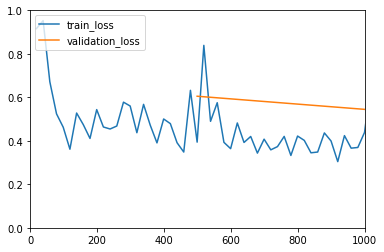

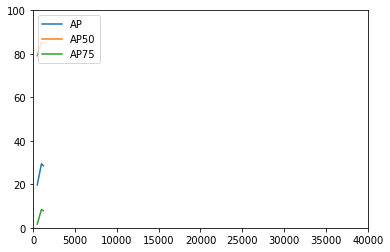

In [9]:
%run -i 'PlotTogether.py'

# run network on validation dataset

In [1]:
cfg.OUTPUT_DIR = './output'
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
#cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6  # set a custom testing threshold
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.6
predictor = DefaultPredictor(cfg)

NameError: name 'cfg' is not defined

# Visualize random

In [24]:
from detectron2.utils.visualizer import ColorMode
for d in random.sample(dataset_dicts["val"], 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=bumblebee_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2.imshow(os.path.basename(d["file_name"]),out.get_image()[:, :, ::-1])
    cv2.waitKey()
    cv2.destroyAllWindows()

tuple

10